# BCI Competition III Dataset 2a
This is a motor imagery dataset with 4 classes.

# Approaches to try for feature engineering

- CAR/Bipolar/Laplacian filter C3 and C4 channels, take FFTs for each trial with 1Hz/2Hz/4Hz resolution
- CAR/Bipolar/Laplacian filter all channels, take FFTs and determine feature importance (i.e. how discriminitive is channel C3 band power between 8-9Hz vs. channel Pz band power between 18-19 Hz), then pick a handful of most important channel-frequency features
- CAR/Bipolar/Laplacian filter C3 and C4 channels, get band power for alpha (8-12Hz) and beta (13-30Hz)
- Transform using [CSP](https://mne.tools/stable/auto_examples/decoding/decoding_csp_eeg.html) with varying numbers of components
- Deep learning: [convnets, EEGNet](https://github.com/vlawhern/arl-eegmodels)

# Explore data for subject 1

In [1]:
import os
import mne

## Read raw GDF

In [2]:
DATA_DIR = 'BCICIV_2a_gdf'

def get_data_path(subject_no, test_or_train):
    data_type_code = 'T' if test_or_train == 'train' else 'E'
    return os.path.join(DATA_DIR, 'A0{}{}.gdf'.format(subject_no, data_type_code))

In [3]:
sub1_gdf = mne.io.read_raw_gdf(get_data_path(1, 'train'), eog=['EOG-left', 'EOG-central', 'EOG-right'])

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


In [4]:
sub1_gdf

<RawGDF | A01T.gdf, 25 x 672528 (2690.1 s), ~29 kB, data not loaded>

In [5]:
sub1_gdf.__dict__

{'preload': False,
 '_last_samps': array([672527]),
 '_first_samps': array([0]),
 'info': <Info | 7 non-empty values
  bads: []
  ch_names: EEG-Fz, EEG-0, EEG-1, EEG-2, EEG-3, EEG-4, EEG-5, EEG-C3, EEG-6, ...
  chs: 22 EEG, 3 EOG
  custom_ref_applied: False
  highpass: 0.5 Hz
  lowpass: 100.0 Hz
  meas_date: 2005-01-17 12:00:00 UTC
  nchan: 25
  projs: []
  sfreq: 250.0 Hz
 >,
 'buffer_size_sec': 1.0,
 '_cals': array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1.]),
 '_raw_extras': [{'type': 'GDF',
   'subtype': 'GDF',
   'number': 1.99,
   'units': array([1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06,
          1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06,
          1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06, 1.e-06,
          1.e-06]),
   'bytes_tot': 50,
   'ch_names': ['EEG-Fz',
    'EEG',
    'EEG',
    'EEG',
    'EEG',
    'EEG',
    'EEG',
    'EEG-C3',
    'EEG',
    'EE

## Rename annotations from codes to readable types

In [6]:
class AnnotationsConverter:
    ANNOTATIONS = [
        ('276', 'idle_eyes_open'),
        ('277', 'idle_eyes_closed'),
        ('768', 'trial_start'),
        ('769', 'cue_left'),
        ('770', 'cue_right'),
        ('771', 'cue_foot'),
        ('772', 'cue_tongue'),
        ('783', 'cue_unknown'),
        ('1023', 'trial_rejected'),
        ('1072', 'idle_eye_movements'),
        ('32766', 'run_start')
    ]

    def _find_annotation_pair(name_or_id):
        for a in AnnotationsConverter.ANNOTATIONS:
            if a[0] == name_or_id or a[1] == name_or_id:
                return a
        raise RuntimeError('Attempted to convert annotation with unrecognized identifier: {}'.format(name_or_id))

    @staticmethod
    def id_to_name(annotation_id):
        return AnnotationsConverter._find_annotation_pair(annotation_id)[1]

    @staticmethod
    def name_to_id(annotation_name):
        return AnnotationsConverter._find_annotation_pair(annotation_name)[0]

In [7]:
sub1_gdf.annotations

<Annotations | 603 segments: 1023 (15), 1072 (1), 276 (1), 277 (1), 32766 ...>

In [8]:
sub1_gdf.annotations[0]

OrderedDict([('onset', 0.0),
             ('duration', 0.004),
             ('description', '32766'),
             ('orig_time',
              datetime.datetime(2005, 1, 17, 12, 0, tzinfo=datetime.timezone.utc))])

In [9]:
%matplotlib qt5
sub1_gdf.plot();

Using matplotlib as 2D backend.
Opening raw-browser...


In [10]:
sub1_gdf.annotations.rename({
    '276': 'idle_eyes_open',
    '277': 'idle_eyes_closed',
    '768': 'trial_start',
    '769': 'cue_left',
    '770': 'cue_right',
    '771': 'cue_foot',
    '772': 'cue_tongue',
    # '783': 'cue_unknown',
    '1023': 'trial_rejected',
    '1072': 'idle_eye_movements',
    '32766': 'run_start'
}).rename({'3idle_eyes_open6': 'run_start'})

<Annotations | 603 segments: cue_foot (72), cue_left (72), cue_right (72), ...>

In [11]:
sub1_gdf.annotations[0]

OrderedDict([('onset', 0.0),
             ('duration', 0.004),
             ('description', 'run_start'),
             ('orig_time',
              datetime.datetime(2005, 1, 17, 12, 0, tzinfo=datetime.timezone.utc))])

In [12]:
sub1_events, event_id = mne.events_from_annotations(sub1_gdf)
sub1_events

Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']


array([[     0,      0,      8],
       [     0,      0,      7],
       [ 29683,      0,      8],
       ...,
       [670550,      0,     10],
       [670550,      0,      9],
       [671050,      0,      2]])

In [13]:
print(sub1_gdf.ch_names)

['EEG-Fz', 'EEG-0', 'EEG-1', 'EEG-2', 'EEG-3', 'EEG-4', 'EEG-5', 'EEG-C3', 'EEG-6', 'EEG-Cz', 'EEG-7', 'EEG-C4', 'EEG-8', 'EEG-9', 'EEG-10', 'EEG-11', 'EEG-12', 'EEG-13', 'EEG-14', 'EEG-Pz', 'EEG-15', 'EEG-16', 'EOG-left', 'EOG-central', 'EOG-right']


In [14]:
sub1_gdf.rename_channels({
    'EEG-0': 'EEG-2', 'EEG-1': 'EEG-3', 'EEG-2': 'EEG-4', 'EEG-3': 'EEG-5', 'EEG-4': 'EEG-6', 
    'EEG-5': 'EEG-7', 'EEG-6': 'EEG-9', 'EEG-7': 'EEG-11', 'EEG-8': 'EEG-13', 'EEG-9': 'EEG-14',
    'EEG-10': 'EEG-15', 'EEG-11': 'EEG-16', 'EEG-12': 'EEG-17', 'EEG-13': 'EEG-18', 'EEG-14': 'EEG-19',
    'EEG-15': 'EEG-21', 'EEG-16': 'EEG-22'
});

In [15]:
print(sub1_gdf.ch_names)

['EEG-Fz', 'EEG-2', 'EEG-3', 'EEG-4', 'EEG-5', 'EEG-6', 'EEG-7', 'EEG-C3', 'EEG-9', 'EEG-Cz', 'EEG-11', 'EEG-C4', 'EEG-13', 'EEG-14', 'EEG-15', 'EEG-16', 'EEG-17', 'EEG-18', 'EEG-19', 'EEG-Pz', 'EEG-21', 'EEG-22', 'EOG-left', 'EOG-central', 'EOG-right']


Closing raw-browser...
Channels marked as bad:
none
Opening raw-browser...


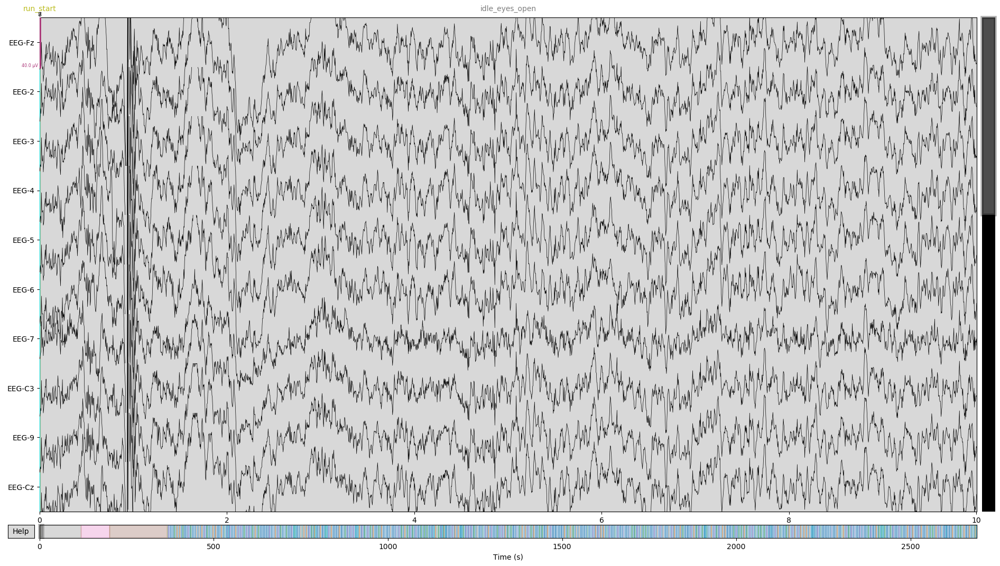

In [16]:
%matplotlib qt5
sub1_gdf.plot(events=sub1_events, duration=10, n_channels=10)

In [17]:
# Remove annotations, they're adding too much visual noise and the events already capture all the information.
sub1_gdf.set_annotations(None);

In [18]:
SUB1_SCALINGS = dict(eeg=3e-5)

Closing raw-browser...
Channels marked as bad:
none
Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


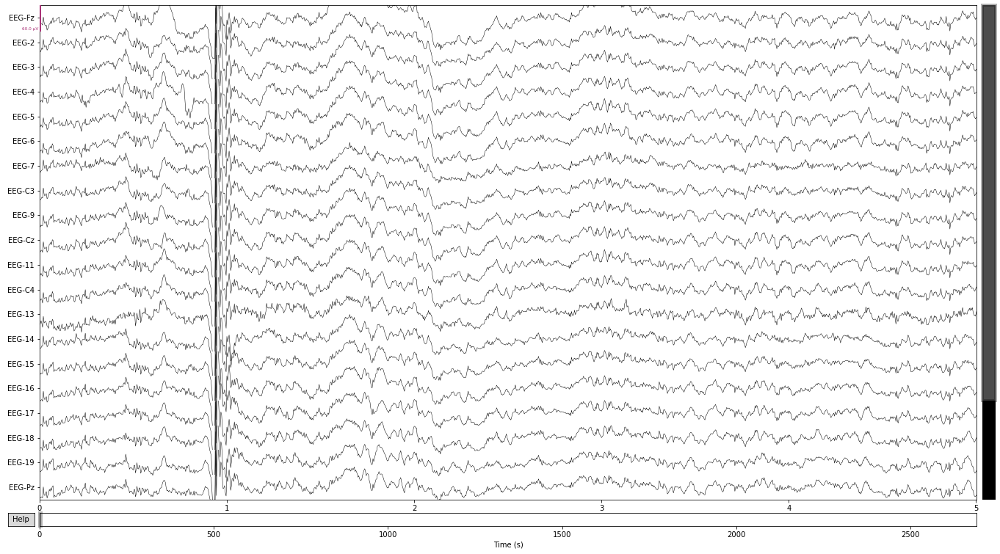

In [19]:
%matplotlib inline
sub1_gdf.plot(duration=5, scalings=SUB1_SCALINGS);

## See if bandpass filtering removes EOG artifacts

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


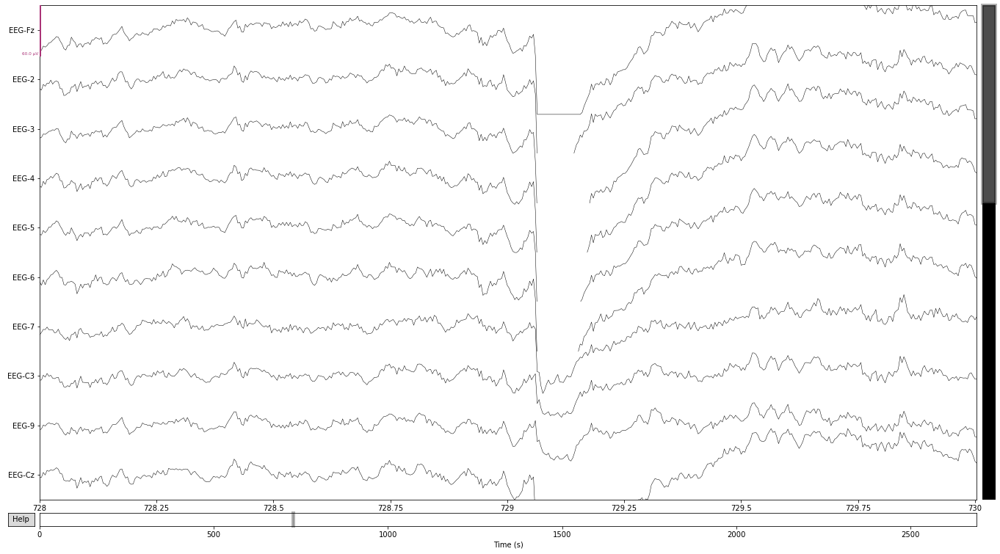

In [20]:
%matplotlib inline
sub1_gdf.plot(start=728, duration=2, scalings=SUB1_SCALINGS, n_channels=10);

In [21]:
sub1_gdf.load_data()
sub1_gdf.filter(4, 40, picks=['eeg'])

Reading 0 ... 672527  =      0.000 ...  2690.108 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 413 samples (1.652 sec)



<RawGDF | A01T.gdf, 25 x 672528 (2690.1 s), ~128.3 MB, data loaded>

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


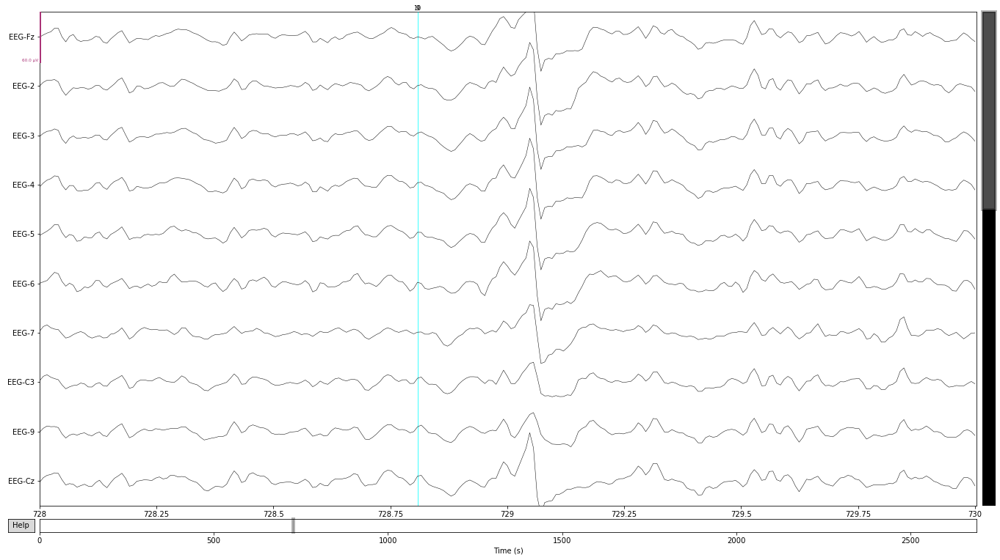

In [22]:
%matplotlib inline
sub1_gdf.plot(start=728, duration=2, scalings=SUB1_SCALINGS, n_channels=10, events=sub1_events);

**Nope**, bandpass filtering at 4 Hz or 7 Hz does not remove the artifact.

## Try removing artifacts using regression on raw data

In [23]:
_, betas = mne.preprocessing.regress_artifact(sub1_gdf, verbose='INFO')

In [24]:
betas

array([[-1.66068823e-02,  2.85807341e-02, -3.27121146e-03],
       [-5.53159819e-03,  1.92629174e-02, -5.02691586e-03],
       [-8.45660553e-03,  1.95421218e-02, -2.38690572e-03],
       [-1.11556391e-02,  1.99011097e-02, -4.62084755e-05],
       [-1.31247900e-02,  1.94483559e-02,  2.37067084e-03],
       [-1.61488423e-02,  1.92638316e-02,  5.57830085e-03],
       [ 1.70683917e-03,  1.12934659e-02, -4.30320483e-03],
       [-2.55077206e-03,  1.34997754e-02, -2.25509302e-03],
       [-5.60188940e-03,  1.46796392e-02, -3.83849448e-04],
       [-7.78162856e-03,  1.48247654e-02,  1.64766756e-03],
       [-1.02992276e-02,  1.51321726e-02,  3.85802706e-03],
       [-1.21080826e-02,  1.39209115e-02,  6.87528879e-03],
       [-1.48761296e-02,  1.23715477e-02,  1.11927833e-02],
       [-1.71040397e-03,  1.05193293e-02, -1.22741484e-04],
       [-4.09223798e-03,  1.16104381e-02,  1.16895061e-03],
       [-5.80315039e-03,  1.16097450e-02,  2.88140309e-03],
       [-7.85712364e-03,  1.17876759e-02

In [25]:
betas.shape

(22, 3)

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


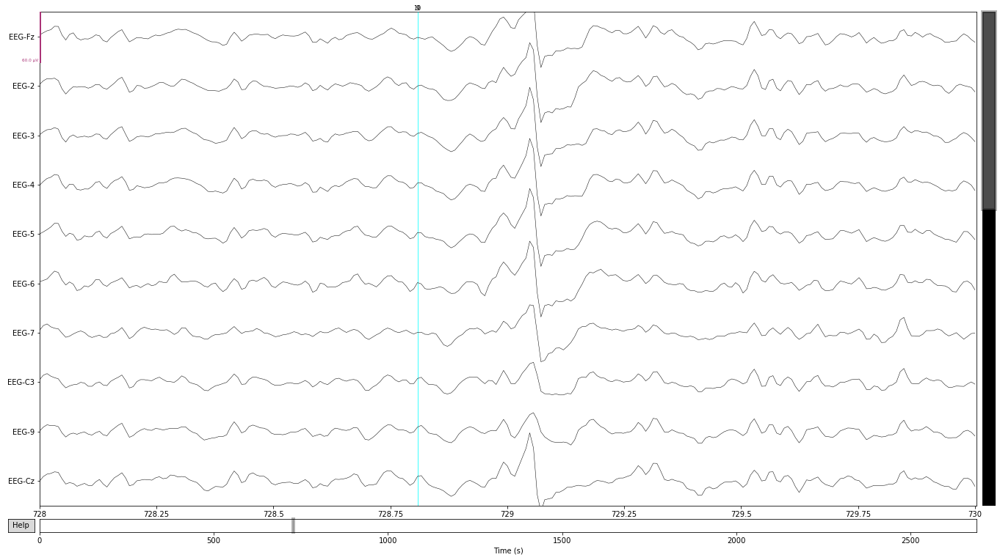

In [26]:
%matplotlib inline
_.plot(start=728, duration=2, scalings=SUB1_SCALINGS, n_channels=10, events=sub1_events);

### Try scaling up the regression coefficients

In [27]:
sub1_gdf_noeog, _ = mne.preprocessing.regress_artifact(sub1_gdf, betas=betas * 80)

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


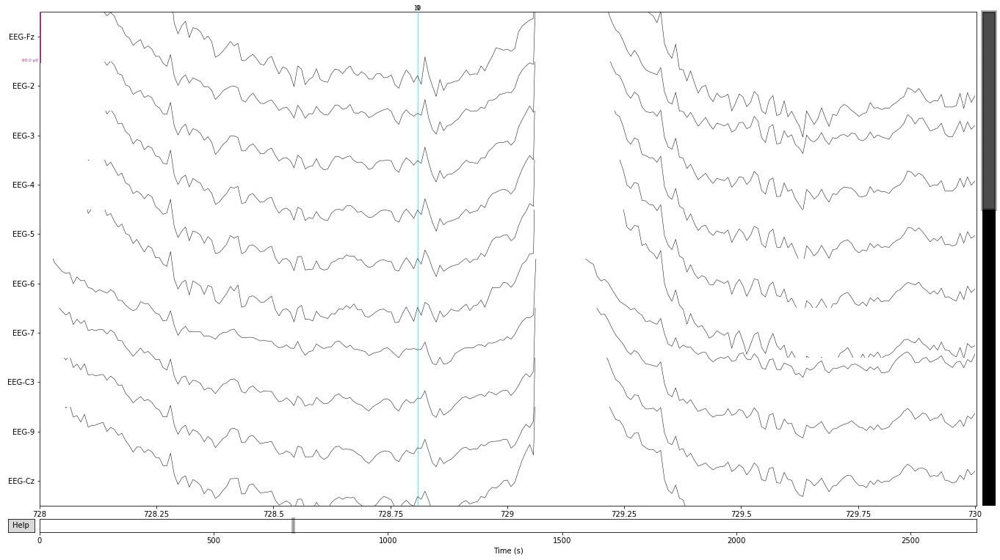

In [28]:
%matplotlib inline
sub1_gdf_noeog.plot(start=728, duration=2, scalings=SUB1_SCALINGS, n_channels=10, events=sub1_events);

Scaling up the coefficients doesn't work. It seems like the EOG channels aren't very accurately representing the effect of blink artifacts on the EEG channels. When there's a blink event, it's visible as a brief deflection in the EEG but it comes back to normal very quickly. In contrast, for the EOG channels, there's a deflection then a long, slow tail that isn't reflected in the EEG signals. So I think I'll still try applying artifact regression but accept that there won't be much of a noticeable visible change in the transformed EEG signals.

In [29]:
%matplotlib qt5
sub1_gdf.plot(start=728.5, duration=20, scalings=SUB1_SCALINGS, n_channels=26, events=sub1_events);

Opening raw-browser...


Closing raw-browser...
Channels marked as bad:
none


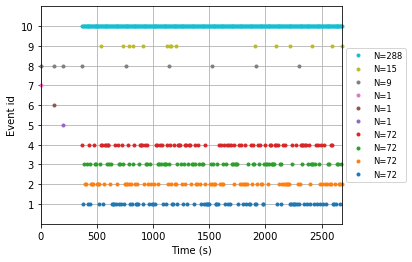

In [30]:
%matplotlib inline
mne.viz.plot_events(sub1_events, sfreq=sub1_gdf.info['sfreq']);

We can actually see that 15 trials were marked as "bad" and should be discarded (event ID 1). I didn't realize any had been marked as bad, I thought I was reading the bads info from one of the raw headers but it had all 0's and no 1's so obviously that was the wrong thing.

In [31]:
# Regress artifacts in-place.
mne.preprocessing.regress_artifact(sub1_gdf, copy=False);

## Spatial filter: CAR
We'll want to try both CAR and Laplacian and compare their performance. We'll start with CAR.

In [32]:
mne.set_eeg_reference(sub1_gdf, ref_channels='average', copy=False);

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


## Split into Epochs

In [33]:
event_id

{'cue_foot': 1,
 'cue_left': 2,
 'cue_right': 3,
 'cue_tongue': 4,
 'idle_eye_movements': 5,
 'idle_eyes_closed': 6,
 'idle_eyes_open': 7,
 'run_start': 8,
 'trial_rejected': 9,
 'trial_start': 10}

In [34]:
sub1_events

array([[     0,      0,      8],
       [     0,      0,      7],
       [ 29683,      0,      8],
       ...,
       [670550,      0,     10],
       [670550,      0,      9],
       [671050,      0,      2]])

In [35]:
sub1_events_for_epoching = sub1_events[sub1_events[:, 2] < 5]
sub1_events_for_epoching

array([[ 92368,      0,      4],
       [ 94371,      0,      1],
       [ 96289,      0,      3],
       [ 98241,      0,      2],
       [100249,      0,      2],
       [102360,      0,      3],
       [104277,      0,      1],
       [106327,      0,      4],
       [108258,      0,      3],
       [110256,      0,      1],
       [112162,      0,      2],
       [114057,      0,      2],
       [116029,      0,      2],
       [117973,      0,      4],
       [119940,      0,      3],
       [122060,      0,      3],
       [124068,      0,      2],
       [126134,      0,      2],
       [128170,      0,      1],
       [130236,      0,      2],
       [132306,      0,      3],
       [134386,      0,      4],
       [136298,      0,      4],
       [138329,      0,      1],
       [140282,      0,      2],
       [142243,      0,      4],
       [144347,      0,      4],
       [146351,      0,      3],
       [148326,      0,      4],
       [150352,      0,      4],
       [15

In [36]:
trial_event_id = {e_name: e_id for e_name, e_id in event_id.items() if e_name.startswith('cue')}
trial_event_id

{'cue_foot': 1, 'cue_left': 2, 'cue_right': 3, 'cue_tongue': 4}

In [37]:
sub1_epochs = mne.Epochs(sub1_gdf, sub1_events_for_epoching, event_id=trial_event_id, tmin=-2., tmax=4)

Not setting metadata
288 matching events found
Setting baseline interval to [-2.0, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated


In [38]:
sub1_epochs

Number of events,288
Events,cue_foot: 72cue_left: 72cue_right: 72cue_tongue: 72
Time range,-2.000 – 4.000 sec
Baseline,-2.000 – 0.000 sec


In [39]:
%matplotlib qt5
sub1_epochs.plot(n_epochs=5);

Using data from preloaded Raw for 288 events and 1501 original time points ...
0 bad epochs dropped
Opening epochs-browser...
Using data from preloaded Raw for 5 events and 1501 original time points ...


## Remove trials marked as "bad"

In [40]:
trial_rejected_events = sub1_events[sub1_events[:, 2] == 9]
trial_rejected_events

array([[133886,      0,      9],
       [182202,      0,      9],
       [196584,      0,      9],
       [204593,      0,      9],
       [226571,      0,      9],
       [281151,      0,      9],
       [287541,      0,      9],
       [289459,      0,      9],
       [301428,      0,      9],
       [476880,      0,      9],
       [523138,      0,      9],
       [553652,      0,      9],
       [603615,      0,      9],
       [648515,      0,      9],
       [670550,      0,      9]])

In [41]:
rejected_epoch_start_sample_numbers = set(trial_rejected_events[:, 0])
print(rejected_epoch_start_sample_numbers)

{523138, 648515, 196584, 603615, 226571, 476880, 204593, 289459, 301428, 287541, 553652, 670550, 182202, 133886, 281151}


In [42]:
epoch_start_sample_numbers = sub1_events[sub1_events[:, 2] == 10][:, 0]
epoch_start_sample_numbers

array([ 91868,  93871,  95789,  97741,  99749, 101860, 103777, 105827,
       107758, 109756, 111662, 113557, 115529, 117473, 119440, 121560,
       123568, 125634, 127670, 129736, 131806, 133886, 135798, 137829,
       139782, 141743, 143847, 145851, 147826, 149852, 151923, 154030,
       156122, 158213, 160256, 162320, 164340, 166312, 168275, 170200,
       172281, 174259, 176249, 178368, 180274, 182202, 184316, 186375,
       188703, 190706, 192624, 194576, 196584, 198695, 200612, 202662,
       204593, 206591, 208497, 210392, 212364, 214308, 216275, 218395,
       220403, 222469, 224505, 226571, 228641, 230721, 232633, 234664,
       236617, 238578, 240682, 242686, 244661, 246687, 248758, 250865,
       252957, 255048, 257091, 259155, 261175, 263147, 265110, 267035,
       269116, 271094, 273084, 275203, 277109, 279037, 281151, 283210,
       285538, 287541, 289459, 291411, 293419, 295530, 297447, 299497,
       301428, 303426, 305332, 307227, 309199, 311143, 313110, 315230,
      

In [43]:
rejected_epoch_indices = [i for i in range(len(epoch_start_sample_numbers)) if epoch_start_sample_numbers[i] in rejected_epoch_start_sample_numbers]
rejected_epoch_indices

[21, 45, 52, 56, 67, 94, 97, 98, 104, 191, 214, 229, 254, 276, 287]

In [44]:
sub1_epochs.drop(rejected_epoch_indices)

Dropped 15 epochs: 21, 45, 52, 56, 67, 94, 97, 98, 104, 191, 214, 229, 254, 276, 287


Number of events,273
Events,cue_foot: 68cue_left: 69cue_right: 69cue_tongue: 67
Time range,-2.000 – 4.000 sec
Baseline,-2.000 – 0.000 sec


In [45]:
sub1_epochs.get_data().shape

Using data from preloaded Raw for 273 events and 1501 original time points ...


(273, 25, 1501)

In [46]:
%matplotlib qt5
sub1_epochs.plot(n_epochs=15);

Closing epochs-browser...
Dropped 0 epochs: 
The following epochs were marked as bad and are dropped:
[]
Channels marked as bad:
none
Opening epochs-browser...
Using data from preloaded Raw for 15 events and 1501 original time points ...


## Plot PSDs

In [47]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

Closing epochs-browser...
Dropped 0 epochs: 
The following epochs were marked as bad and are dropped:
[]
Channels marked as bad:
none
Using data from preloaded Raw for 69 events and 1501 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 69 events and 1501 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 68 events and 1501 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 67 events and 1501 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling inter

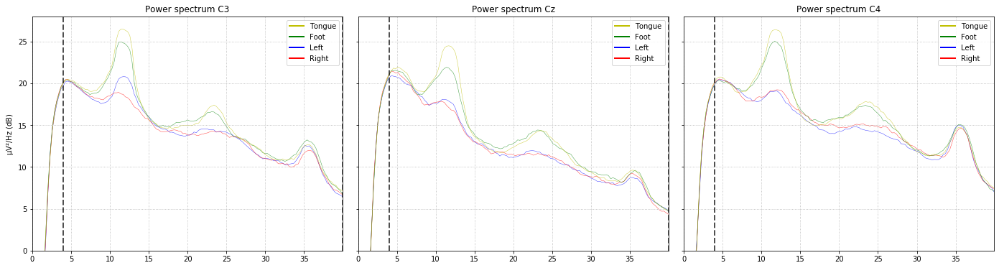

In [48]:
%matplotlib inline
fig, axs = plt.subplots(1, 3, figsize=(24, 6))
# Use tmin=.5 to wait 500ms after the cue is shown to calculate the plot, since it takes some time for 
# the subject to react to the cue and produce the signal.
sub1_epochs['cue_left'].plot_psd(tmin=.5, fmax=40., picks=['EEG-C3'], ax=axs[0], color='b', spatial_colors=False, show=False);
sub1_epochs['cue_right'].plot_psd(tmin=.5, fmax=40., picks=['EEG-C3'], ax=axs[0], color='r', spatial_colors=False, show=False);
sub1_epochs['cue_foot'].plot_psd(tmin=.5, fmax=40., picks=['EEG-C3'], ax=axs[0], color='g', spatial_colors=False, show=False);
sub1_epochs['cue_tongue'].plot_psd(tmin=.5, fmax=40., picks=['EEG-C3'], ax=axs[0], color='y', spatial_colors=False, show=False);
sub1_epochs['cue_left'].plot_psd(tmin=.5, fmax=40., picks=['EEG-Cz'], ax=axs[1], color='b', spatial_colors=False, show=False);
sub1_epochs['cue_right'].plot_psd(tmin=.5, fmax=40., picks=['EEG-Cz'], ax=axs[1], color='r', spatial_colors=False, show=False);
sub1_epochs['cue_foot'].plot_psd(tmin=.5, fmax=40., picks=['EEG-Cz'], ax=axs[1], color='g', spatial_colors=False, show=False);
sub1_epochs['cue_tongue'].plot_psd(tmin=.5, fmax=40., picks=['EEG-Cz'], ax=axs[1], color='y', spatial_colors=False, show=False);
sub1_epochs['cue_left'].plot_psd(tmin=.5, fmax=40., picks=['EEG-C4'], ax=axs[2], color='b', spatial_colors=False, show=False);
sub1_epochs['cue_right'].plot_psd(tmin=.5, fmax=40., picks=['EEG-C4'], ax=axs[2], color='r', spatial_colors=False, show=False);
sub1_epochs['cue_foot'].plot_psd(tmin=.5, fmax=40., picks=['EEG-C4'], ax=axs[2], color='g', spatial_colors=False, show=False);
sub1_epochs['cue_tongue'].plot_psd(tmin=.5, fmax=40., picks=['EEG-C4'], ax=axs[2], color='y', spatial_colors=False, show=False);
axs[0].set_title('Power spectrum C3')
axs[1].set_title('Power spectrum Cz')
axs[2].set_title('Power spectrum C4')
axs[1].yaxis.set_ticklabels([])
axs[1].set(ylabel=None)
axs[2].yaxis.set_ticklabels([])
axs[2].set(ylabel=None)
axs[0].set_ylim(bottom=0, top=28)
axs[1].set_ylim(bottom=0, top=28)
axs[2].set_ylim(bottom=0, top=28)
fig.subplots_adjust(wspace=0.05)

custom_lines = [
    Line2D([0], [0], color='y', lw=2),
    Line2D([0], [0], color='g', lw=2),
    Line2D([0], [0], color='b', lw=2),
    Line2D([0], [0], color='r', lw=2)
]
axs[0].legend(custom_lines, ['Tongue', 'Foot', 'Left', 'Right'])
axs[1].legend(custom_lines, ['Tongue', 'Foot', 'Left', 'Right'])
axs[2].legend(custom_lines, ['Tongue', 'Foot', 'Left', 'Right'])

We see great separation between the PSDs for left or right vs. foot or tongue, but differentiating between left-right and foot-tongue will be really challenging.

## Put code for reading/initial processing into configurable methods
I'd like to try spatial filtering techniques other than CAR to see whether it gives us better separation in the PSD plots. It'll be easier to do this if I create configurable methods I can use to load and preprocess the data.

In [49]:
def read_gdf(subject_no, test_or_train):
    """Reads a GDF file into an mne Raw instance.
    
    Parameters
    ----------
    subject_no : int
        The number of the subject whose data should be loaded.
    test_or_train : str
        Whether to load the subject's test data ('test') or training data ('train').

    Returns
    -------
    raw : mne.io.Raw
        A Raw instance containing the EEG timeseries data from the subject.
    events: list[list[int]]
        Events extracted from the raw instance.
    event_id: dict[str, int]
        Mapping from annotation label to its assigned event ID.
    """

    # Read GDF file.
    raw = mne.io.read_raw_gdf(get_data_path(subject_no, test_or_train), eog=['EOG-left', 'EOG-central', 'EOG-right'])

    # Rename annotations from numeric IDs to readable labels.
    raw.annotations.rename({
        '276': 'idle_eyes_open',
        '277': 'idle_eyes_closed',
        '768': 'trial_start',
        '769': 'cue_left',
        '770': 'cue_right',
        '771': 'cue_foot',
        '772': 'cue_tongue',
        # '783': 'cue_unknown',
        '1023': 'trial_rejected',
        '1072': 'idle_eye_movements',
        '32766': 'run_start'
    }).rename({'3idle_eyes_open6': 'run_start'});

    # Rename numbered channels to match numberings from dataset description diagram.
    raw.rename_channels({
        'EEG-0': 'EEG-2', 'EEG-1': 'EEG-3', 'EEG-2': 'EEG-4', 'EEG-3': 'EEG-5', 'EEG-4': 'EEG-6', 
        'EEG-5': 'EEG-7', 'EEG-6': 'EEG-9', 'EEG-7': 'EEG-11', 'EEG-8': 'EEG-13', 'EEG-9': 'EEG-14',
        'EEG-10': 'EEG-15', 'EEG-11': 'EEG-16', 'EEG-12': 'EEG-17', 'EEG-13': 'EEG-18', 'EEG-14': 'EEG-19',
        'EEG-15': 'EEG-21', 'EEG-16': 'EEG-22'
    })

    # Extract events and remove annotations from the Raw instance.
    events, event_id = mne.events_from_annotations(raw)
    raw.set_annotations(None)

    return raw, events, event_id

In [50]:
def preprocess_raw(raw, l_freq, h_freq, regress_eog_artifacts, spatial_filter_fn):
    """Performs bandpass filtering, spatial filtering, and regresses EOG artifacts on raw data.
    
    Parameters
    ----------
    raw : mne.io.Raw
        The raw EEG data.
    l_freq : double
        Low-cut frequency for the bandpass filter.
    h_freq : double
        High-cut frequency for the bandpass filter.
    regress_eog_artifacts : bool
        Whether to perform regression for EOG artifact removal.
    spatial_filter_fn : function(mne.io.Raw) -> mne.io.Raw
        A function that applies a spatial filter to the raw data.
    
    Returns
    -------
    raw : mne.io.Raw
        The raw data after preprocessing.
    """

    # Bandpass filter the raw data.
    raw.load_data()
    raw.filter(l_freq, h_freq, picks=['eeg'])

    # Regress EOG artifacts in-place.
    if regress_eog_artifacts:
        mne.preprocessing.regress_artifact(raw, copy=False);

    # Apply spatial filter function.
    raw = spatial_filter_fn(raw)

    return raw

In [51]:
def make_epochs(raw, events, event_id):
    """Epoch a raw instance, excluding rejected trials.

    Parameters
    ----------
    raw : mne.io.Raw
        The raw EEG data.
    events: list[list[int]]
        Events extracted from the raw instance.
    event_id: dict[str, int]
        Mapping from annotation label to its assigned event ID.
    
    Returns
    -------
    epochs : mne.Epochs
        Epoched data.
    """

    # Create Epochs object from trial cue events.
    cue_events = events[events[:, 2] < 5]
    trial_event_id = {e_name: e_id for e_name, e_id in event_id.items() if e_name.startswith('cue')}
    epochs = mne.Epochs(raw, cue_events, event_id=trial_event_id, tmin=-2., tmax=4)

    # Drop rejected epochs.
    trial_rejected_events = events[events[:, 2] == 9]
    rejected_epoch_start_sample_numbers = set(trial_rejected_events[:, 0])
    epoch_start_sample_numbers = events[events[:, 2] == 10][:, 0]
    rejected_epoch_indices = [i for i in range(len(epoch_start_sample_numbers)) if epoch_start_sample_numbers[i] in rejected_epoch_start_sample_numbers]
    epochs.drop(rejected_epoch_indices)

    return epochs

In [52]:
def plot_psds(epochs, max_amplitude=28):
    """Draws plots of per-condition PSDs for central electrodes.

    Parameters
    -------
    epochs : mne.Epochs
        Epoched data.
    max_amplitude : double
        The highest amplitude that should be depicted in all the plots, in uV^2/Hz.
    """

    %matplotlib inline
    fig, axs = plt.subplots(1, 3, figsize=(24, 6))
    electrode_and_axis = [('EEG-C3', axs[0]), ('EEG-Cz', axs[1]), ('EEG-C4', axs[2])]
    condition_and_color = [('cue_left', 'b'), ('cue_right', 'r'), ('cue_foot', 'g'), ('cue_tongue', 'y')]
    # Use tmin=.5 to wait 500ms after the cue is shown to calculate the plot, since it takes some time for 
    # the subject to react to the cue and produce the signal.
    tmin = .5
    fmax = 40

    for electrode, ax in electrode_and_axis:
        for condition, color in condition_and_color:
            epochs[condition].plot_psd(tmin=tmin, fmax=fmax, picks=[electrode], ax=ax, color=color, spatial_colors=False, show=False)
    
    axs[0].set_title('Power spectrum C3')
    axs[1].set_title('Power spectrum Cz')
    axs[2].set_title('Power spectrum C4')

    axs[1].yaxis.set_ticklabels([])
    axs[1].set(ylabel=None)
    axs[2].yaxis.set_ticklabels([])
    axs[2].set(ylabel=None)
    for ax in axs:
        ax.set_ylim(bottom=0, top=max_amplitude)

    fig.subplots_adjust(wspace=0.05)

    # Add custom legend.
    custom_lines = [
        Line2D([0], [0], color='y', lw=2),
        Line2D([0], [0], color='g', lw=2),
        Line2D([0], [0], color='b', lw=2),
        Line2D([0], [0], color='r', lw=2)
    ]
    for ax in axs:
        ax.legend(custom_lines, ['Tongue', 'Foot', 'Left', 'Right'])

## Compare PSD condition separation for different spatial filters

### No spatial filter

In [53]:
def spatial_filter_no_op(raw):
    return raw

In [54]:
raw, events, event_id = read_gdf(1, 'train')

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


In [55]:
raw = preprocess_raw(raw, 4, 40, True, spatial_filter_no_op)

Reading 0 ... 672527  =      0.000 ...  2690.108 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 413 samples (1.652 sec)



In [56]:
epochs = make_epochs(raw, events, event_id)

Not setting metadata
288 matching events found
Setting baseline interval to [-2.0, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Dropped 15 epochs: 21, 45, 52, 56, 67, 94, 97, 98, 104, 191, 214, 229, 254, 276, 287


In [57]:
epochs

Number of events,273
Events,cue_foot: 68cue_left: 69cue_right: 69cue_tongue: 67
Time range,-2.000 – 4.000 sec
Baseline,-2.000 – 0.000 sec


Using data from preloaded Raw for 69 events and 1501 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 69 events and 1501 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 68 events and 1501 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 67 events and 1501 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 69 eve

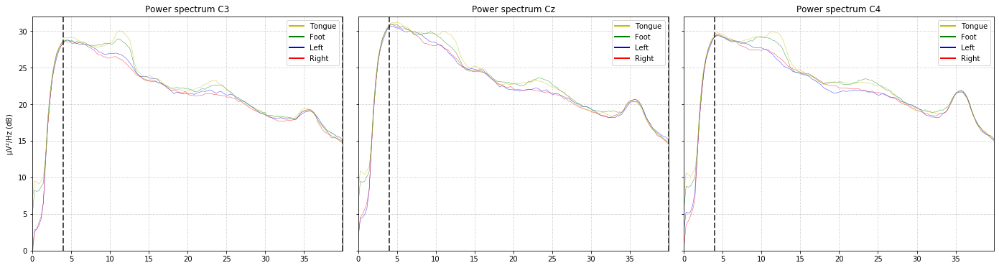

In [58]:
plot_psds(epochs, max_amplitude=32)

### Common Average Reference

In [59]:
def spatial_filter_car(raw):
    raw, _ = mne.set_eeg_reference(raw, ref_channels='average', copy=True)
    return raw

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Reading 0 ... 672527  =      0.000 ...  2690.108 secs...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 413 samples (1.652 sec)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Not setting metadata
288 matching events found
Setting baseline interval to [-2.0, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Dropped 15 epochs: 21, 45, 52, 56, 67, 94, 97, 98, 104, 191, 214, 229, 254, 276, 287
Using data from preloaded Raw for 69 events and 1501 original time points ...


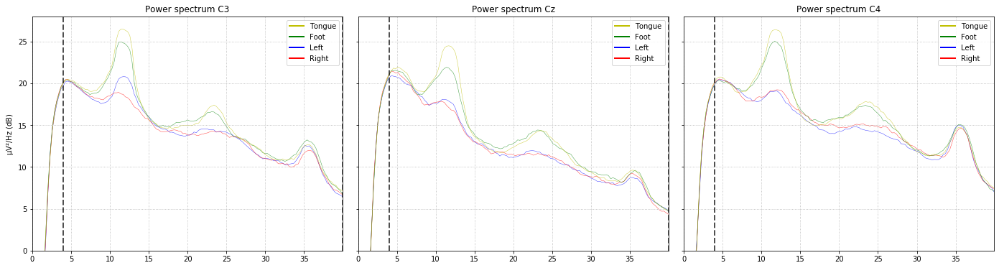

In [60]:
raw, events, event_id = read_gdf(1, 'train')
raw = preprocess_raw(raw, 4, 40, True, spatial_filter_car)
epochs = make_epochs(raw, events, event_id)
plot_psds(epochs)

### Laplacian filter

In [61]:
raw, events, event_id = read_gdf(1, 'train')
raw = preprocess_raw(raw, 4, 40, True, spatial_filter_no_op)

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Reading 0 ... 672527  =      0.000 ...  2690.108 secs...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 413 samples (1.652 sec)



Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


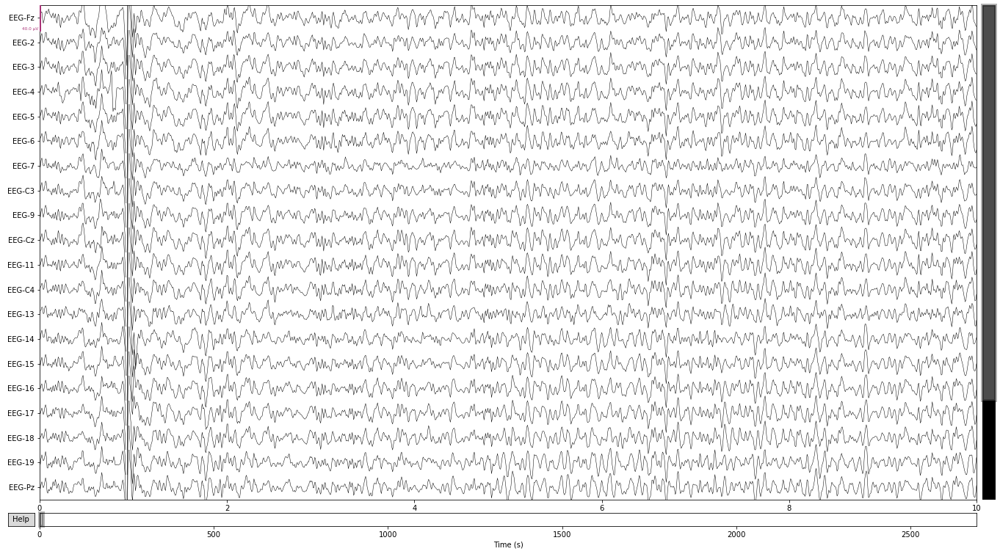

In [62]:
raw.plot();

In [63]:
raw.get_data()

array([[ 6.33435235e-07,  5.49043015e-07,  1.90367188e-06, ...,
         2.39955378e-06,  3.11786394e-06,  1.10979600e-06],
       [ 7.75686798e-08, -6.55550648e-07,  9.07170173e-07, ...,
         3.09504626e-06,  2.60898742e-06,  7.49250538e-07],
       [ 2.90429487e-07, -2.16255401e-06, -2.07903554e-06, ...,
         3.64623364e-06,  3.70748798e-06,  7.28642922e-07],
       ...,
       [ 3.17382813e-05,  2.24609375e-05,  3.36914062e-05, ...,
         6.34765625e-06, -4.39453125e-06, -4.39453125e-06],
       [-1.36718750e-05, -1.31835937e-05, -8.30078125e-06, ...,
        -3.71093750e-05, -4.78515625e-05, -4.54101562e-05],
       [-4.39453125e-05, -4.05273437e-05, -3.85742188e-05, ...,
         1.66015625e-05,  1.26953125e-05,  7.81250000e-06]])

In [64]:
raw.get_data().shape

(25, 672528)

In [65]:
import numpy as np

In [66]:
test_arr = np.asarray([[1, 2, 3], [4, 5, 6], [7, 8, 9]])
test_arr

array([[1, 2, 3],
       [4, 5, 6],
       [7, 8, 9]])

In [67]:
test_arr[0, :]

array([1, 2, 3])

In [68]:
2 * test_arr[0, :]

array([2, 4, 6])

In [69]:
2 * test_arr[0, :] - test_arr[1, :]

array([-2, -1,  0])

In [70]:
print(raw.ch_names)

['EEG-Fz', 'EEG-2', 'EEG-3', 'EEG-4', 'EEG-5', 'EEG-6', 'EEG-7', 'EEG-C3', 'EEG-9', 'EEG-Cz', 'EEG-11', 'EEG-C4', 'EEG-13', 'EEG-14', 'EEG-15', 'EEG-16', 'EEG-17', 'EEG-18', 'EEG-19', 'EEG-Pz', 'EEG-21', 'EEG-22', 'EOG-left', 'EOG-central', 'EOG-right']


![Electrode Positions Diagram](electrode-positions.png)

In [71]:
LAPLACIAN_NEIGHBORS = {
    'EEG-Fz': ['EEG-4'],
    'EEG-2': ['EEG-3', 'EEG-C3'],
    'EEG-3': ['EEG-2', 'EEG-4', 'EEG-9'],
    'EEG-4': ['EEG-Fz', 'EEG-3', 'EEG-5', 'EEG-Cz'],
    'EEG-5': ['EEG-4', 'EEG-6', 'EEG-11'],
    'EEG-6': ['EEG-5', 'EEG-C4'],
    'EEG-7': ['EEG-C3'],
    'EEG-C3': ['EEG-7', 'EEG-2', 'EEG-9', 'EEG-14'],
    'EEG-9': ['EEG-C3', 'EEG-3', 'EEG-Cz', 'EEG-15'],
    'EEG-Cz': ['EEG-9', 'EEG-4', 'EEG-11', 'EEG-16'],
    'EEG-11': ['EEG-Cz', 'EEG-5', 'EEG-C4', 'EEG-17'],
    'EEG-C4': ['EEG-11', 'EEG-6', 'EEG-13', 'EEG-18'],
    'EEG-13': ['EEG-C4'],
    'EEG-14': ['EEG-C3', 'EEG-15'],
    'EEG-15': ['EEG-14', 'EEG-9', 'EEG-16', 'EEG-19'],
    'EEG-16': ['EEG-15', 'EEG-Cz', 'EEG-17', 'EEG-Pz'],
    'EEG-17': ['EEG-16', 'EEG-11', 'EEG-18', 'EEG-21'],
    'EEG-18': ['EEG-17', 'EEG-C4'],
    'EEG-19': ['EEG-15', 'EEG-Pz'],
    'EEG-Pz': ['EEG-19', 'EEG-16', 'EEG-21', 'EEG-22'],
    'EEG-21': ['EEG-Pz', 'EEG-17'],
    'EEG-22': ['EEG-Pz']
}

In [72]:
LAPLACIAN_NEIGHBORS

{'EEG-Fz': ['EEG-4'],
 'EEG-2': ['EEG-3', 'EEG-C3'],
 'EEG-3': ['EEG-2', 'EEG-4', 'EEG-9'],
 'EEG-4': ['EEG-Fz', 'EEG-3', 'EEG-5', 'EEG-Cz'],
 'EEG-5': ['EEG-4', 'EEG-6', 'EEG-11'],
 'EEG-6': ['EEG-5', 'EEG-C4'],
 'EEG-7': ['EEG-C3'],
 'EEG-C3': ['EEG-7', 'EEG-2', 'EEG-9', 'EEG-14'],
 'EEG-9': ['EEG-C3', 'EEG-3', 'EEG-Cz', 'EEG-15'],
 'EEG-Cz': ['EEG-9', 'EEG-4', 'EEG-11', 'EEG-16'],
 'EEG-11': ['EEG-Cz', 'EEG-5', 'EEG-C4', 'EEG-17'],
 'EEG-C4': ['EEG-11', 'EEG-6', 'EEG-13', 'EEG-18'],
 'EEG-13': ['EEG-C4'],
 'EEG-14': ['EEG-C3', 'EEG-15'],
 'EEG-15': ['EEG-14', 'EEG-9', 'EEG-16', 'EEG-19'],
 'EEG-16': ['EEG-15', 'EEG-Cz', 'EEG-17', 'EEG-Pz'],
 'EEG-17': ['EEG-16', 'EEG-11', 'EEG-18', 'EEG-21'],
 'EEG-18': ['EEG-17', 'EEG-C4'],
 'EEG-19': ['EEG-15', 'EEG-Pz'],
 'EEG-Pz': ['EEG-19', 'EEG-16', 'EEG-21', 'EEG-22'],
 'EEG-21': ['EEG-Pz', 'EEG-17'],
 'EEG-22': ['EEG-Pz']}

In [73]:
%matplotlib qt5
raw.plot();

Opening raw-browser...


In [74]:
raw_arr = raw.get_data()

In [75]:
raw_arr.shape

(25, 672528)

In [76]:
raw_arr

array([[ 6.33435235e-07,  5.49043015e-07,  1.90367188e-06, ...,
         2.39955378e-06,  3.11786394e-06,  1.10979600e-06],
       [ 7.75686798e-08, -6.55550648e-07,  9.07170173e-07, ...,
         3.09504626e-06,  2.60898742e-06,  7.49250538e-07],
       [ 2.90429487e-07, -2.16255401e-06, -2.07903554e-06, ...,
         3.64623364e-06,  3.70748798e-06,  7.28642922e-07],
       ...,
       [ 3.17382813e-05,  2.24609375e-05,  3.36914062e-05, ...,
         6.34765625e-06, -4.39453125e-06, -4.39453125e-06],
       [-1.36718750e-05, -1.31835937e-05, -8.30078125e-06, ...,
        -3.71093750e-05, -4.78515625e-05, -4.54101562e-05],
       [-4.39453125e-05, -4.05273437e-05, -3.85742188e-05, ...,
         1.66015625e-05,  1.26953125e-05,  7.81250000e-06]])

In [77]:
transformed_timeseries = []
for i in range(22):
    electrode_raw = raw_arr[i, :].copy()
    neighbors = LAPLACIAN_NEIGHBORS[raw.ch_names[i]]
    first_neighbor_idx = raw.ch_names.index(neighbors[0])
    neighboring_electrodes_avg = raw_arr[first_neighbor_idx, :].copy()
    for j in range(1, len(neighbors)):
        neighbor_idx = raw.ch_names.index(neighbors[j])
        neighboring_electrodes_avg += raw_arr[neighbor_idx, :].copy()
    neighboring_electrodes_avg /= len(neighbors)
    electrode_transformed = electrode_raw - neighboring_electrodes_avg
    transformed_timeseries.append(electrode_transformed)
    print('neighbors: {}'.format(neighbors))
    print(neighboring_electrodes_avg)
raw_filtered_arr = np.asarray(transformed_timeseries)

neighbors: ['EEG-4']
[ 4.83937478e-07  5.85265060e-08  5.58768542e-07 ... -4.74736314e-07
  1.02611425e-06  7.14871530e-07]
neighbors: ['EEG-3', 'EEG-C3']
[ 1.58435061e-07 -1.82967199e-06 -1.34598740e-06 ...  3.08635839e-06
  3.00826029e-06  6.04047669e-07]
neighbors: ['EEG-2', 'EEG-4', 'EEG-9']
[ 2.61062524e-07 -1.09773317e-06 -4.61968211e-07 ...  1.86367071e-06
  2.27163603e-06  6.56388396e-07]
neighbors: ['EEG-Fz', 'EEG-3', 'EEG-5', 'EEG-Cz']
[ 4.88191362e-07 -5.12905593e-07  7.66708282e-08 ...  6.52544109e-07
  1.90199816e-06  7.47930376e-07]
neighbors: ['EEG-4', 'EEG-6', 'EEG-11']
[ 6.42909159e-07  7.64322385e-07  1.49771839e-06 ... -2.24755896e-06
  4.29586482e-08  6.02428248e-07]
neighbors: ['EEG-5', 'EEG-C4']
[ 6.91936703e-07  1.06487344e-06  1.82331089e-06 ... -3.58610167e-06
 -9.19435335e-07  5.26335648e-07]
neighbors: ['EEG-C3']
[ 2.64406341e-08 -1.49678996e-06 -6.12939262e-07 ...  2.52648315e-06
  2.30903261e-06  4.79452417e-07]
neighbors: ['EEG-7', 'EEG-2', 'EEG-9', 'EEG-1

In [78]:
raw_arr

array([[ 6.33435235e-07,  5.49043015e-07,  1.90367188e-06, ...,
         2.39955378e-06,  3.11786394e-06,  1.10979600e-06],
       [ 7.75686798e-08, -6.55550648e-07,  9.07170173e-07, ...,
         3.09504626e-06,  2.60898742e-06,  7.49250538e-07],
       [ 2.90429487e-07, -2.16255401e-06, -2.07903554e-06, ...,
         3.64623364e-06,  3.70748798e-06,  7.28642922e-07],
       ...,
       [ 3.17382813e-05,  2.24609375e-05,  3.36914062e-05, ...,
         6.34765625e-06, -4.39453125e-06, -4.39453125e-06],
       [-1.36718750e-05, -1.31835937e-05, -8.30078125e-06, ...,
        -3.71093750e-05, -4.78515625e-05, -4.54101562e-05],
       [-4.39453125e-05, -4.05273437e-05, -3.85742188e-05, ...,
         1.66015625e-05,  1.26953125e-05,  7.81250000e-06]])

In [79]:
raw_filtered_arr

array([[ 1.49497756e-07,  4.90516509e-07,  1.34490333e-06, ...,
         2.87429009e-06,  2.09174968e-06,  3.94924468e-07],
       [-8.08663810e-08,  1.17412134e-06,  2.25315757e-06, ...,
         8.68786448e-09, -3.99272876e-07,  1.45202869e-07],
       [ 2.93669633e-08, -1.06482084e-06, -1.61706732e-06, ...,
         1.78256293e-06,  1.43585195e-06,  7.22545260e-08],
       ...,
       [ 3.66870179e-09,  7.27613133e-08, -3.94210616e-08, ...,
         6.97136820e-07,  5.94123233e-07,  1.84493278e-09],
       [ 1.31552564e-08, -2.38273583e-08, -1.48555503e-07, ...,
        -2.39430047e-07, -2.88932110e-07, -6.72628940e-08],
       [-3.91775096e-08, -1.44943434e-06, -1.48617966e-06, ...,
         7.94440500e-07, -3.40574503e-08, -7.52509950e-08]])

In [80]:
raw_arr[22:, :].shape

(3, 672528)

In [81]:
raw_filtered_arr_with_eog = np.concatenate((raw_filtered_arr, raw_arr[22:, :]))
raw_filtered_arr_with_eog.shape

(25, 672528)

In [82]:
raw_filtered = mne.io.RawArray(raw_filtered_arr_with_eog, raw.info)

Creating RawArray with float64 data, n_channels=25, n_times=672528
    Range : 0 ... 672527 =      0.000 ...  2690.108 secs
Ready.


In [83]:
raw_filtered

<RawArray | 25 x 672528 (2690.1 s), ~128.3 MB, data loaded>

#### Compare raw unfiltered

Closing raw-browser...
Channels marked as bad:
none
Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


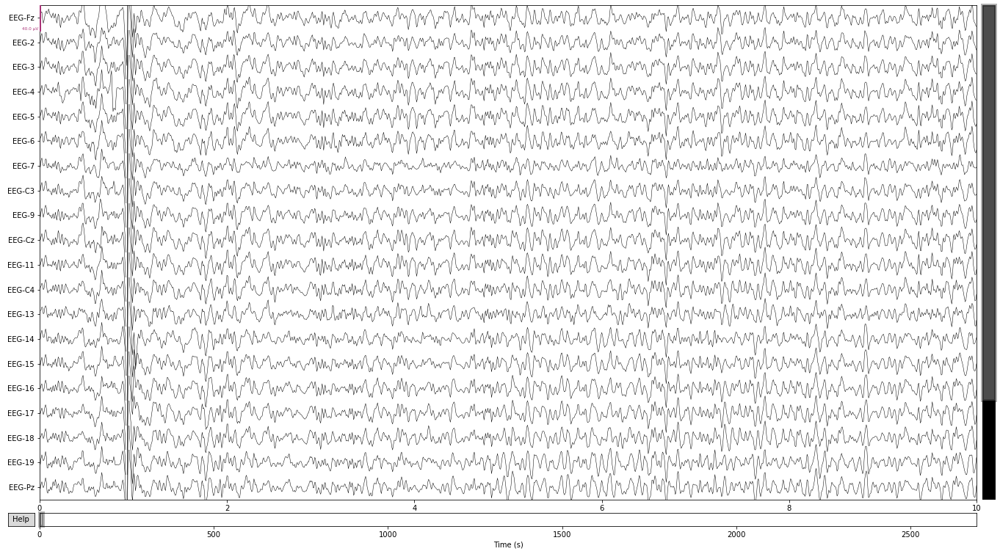

In [84]:
%matplotlib inline
raw.plot();

#### Compare Laplacian filtered

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


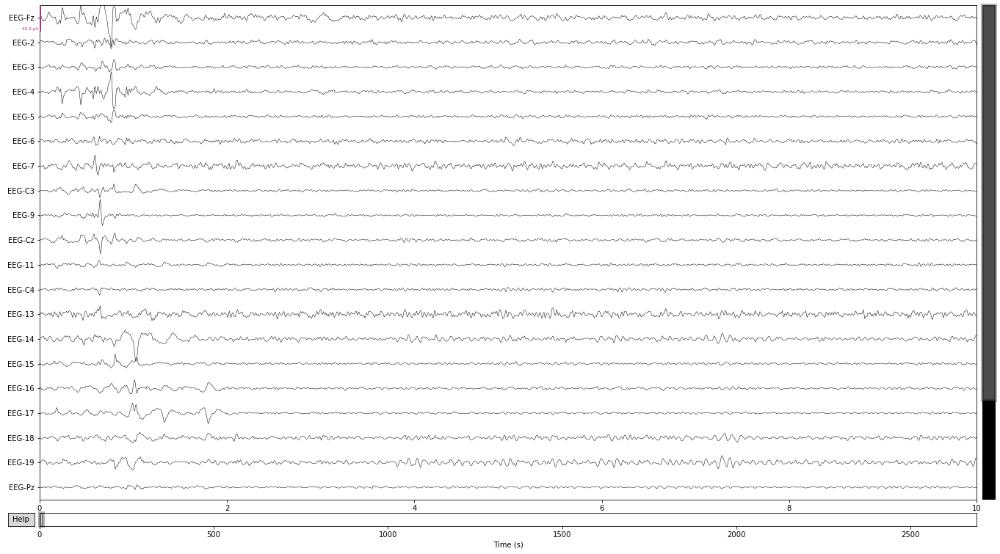

In [85]:
raw_filtered.plot();

#### Compare common average referenced

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


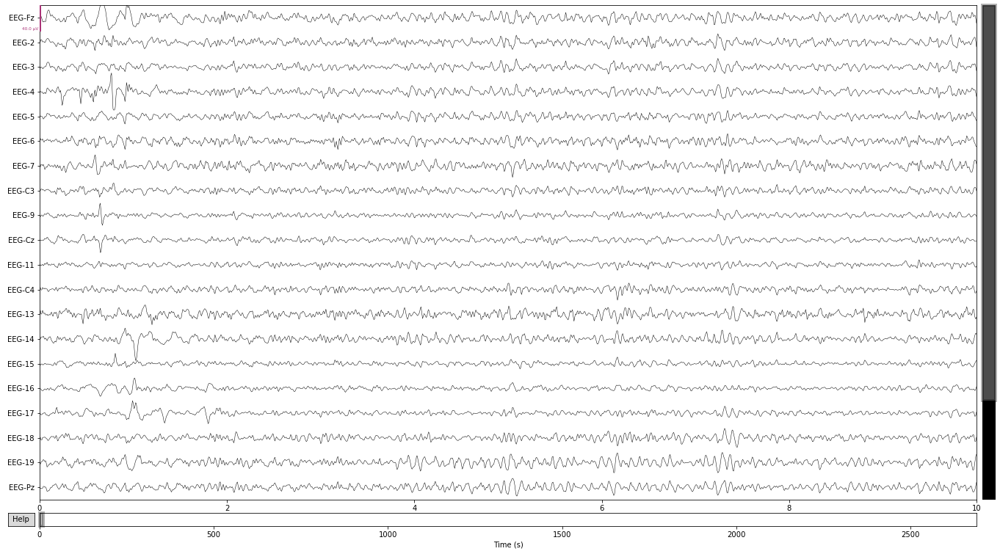

In [86]:
mne.set_eeg_reference(raw, ref_channels='average', copy=True)[0].plot();

#### Central channels raw

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


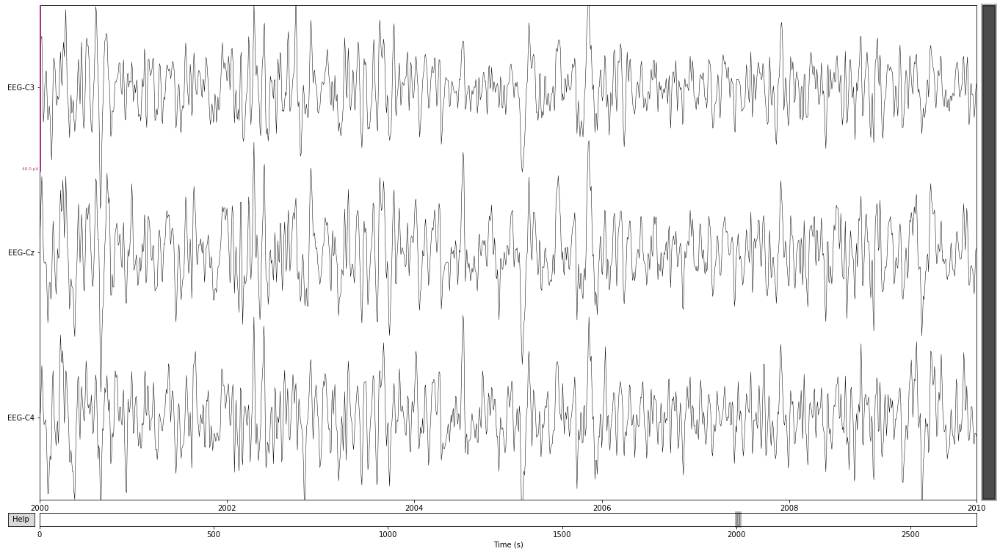

In [87]:
raw.plot(order=[7, 9, 11], start=2000.);

#### Central channels Laplacian

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


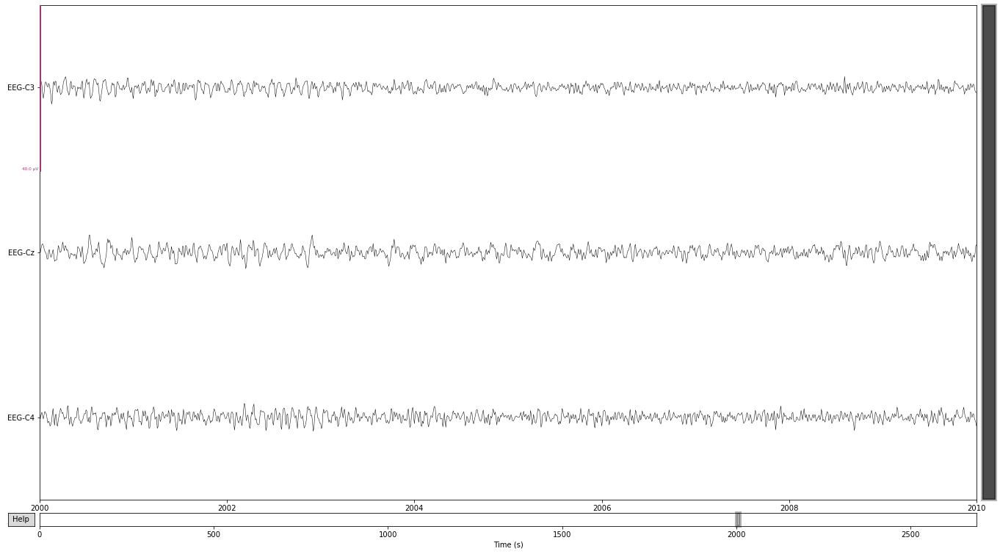

In [88]:
raw_filtered.plot(order=[7, 9, 11], start=2000.);

#### Central channels CAR

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


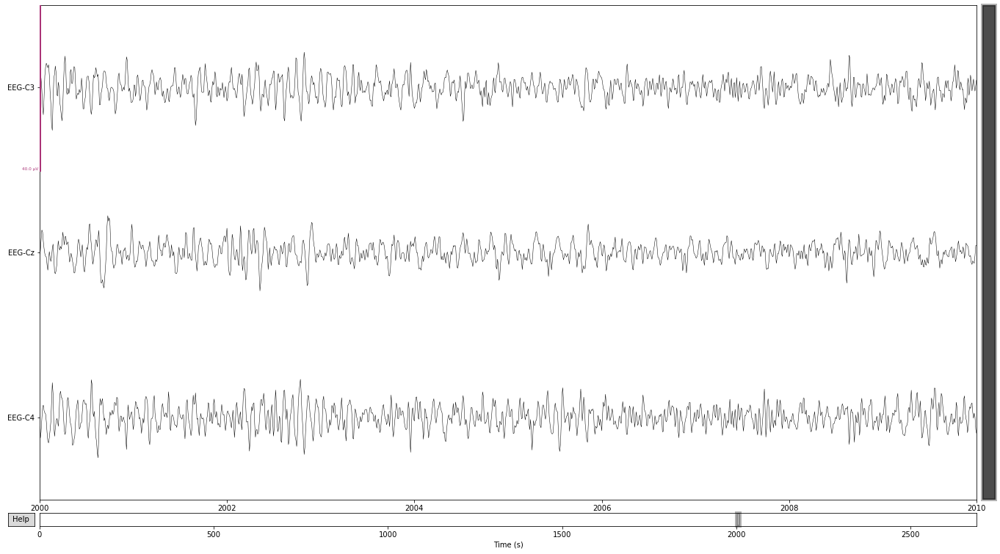

In [89]:
mne.set_eeg_reference(raw, ref_channels='average', copy=True)[0].plot(order=[7, 9, 11], start=2000.);

#### Put Laplacian filter into a method and plot PSD

In [90]:
def spatial_filter_laplacian(raw):
    raw_arr = raw.get_data()
    transformed_timeseries = []
    for i in range(22):
        electrode_raw = raw_arr[i, :].copy()
        neighbors = LAPLACIAN_NEIGHBORS[raw.ch_names[i]]
        first_neighbor_idx = raw.ch_names.index(neighbors[0])
        neighboring_electrodes_avg = raw_arr[first_neighbor_idx, :].copy()
        for j in range(1, len(neighbors)):
            neighbor_idx = raw.ch_names.index(neighbors[j])
            neighboring_electrodes_avg += raw_arr[neighbor_idx, :].copy()
        neighboring_electrodes_avg /= len(neighbors)
        electrode_transformed = electrode_raw - neighboring_electrodes_avg
        transformed_timeseries.append(electrode_transformed)
    raw_filtered_arr = np.asarray(transformed_timeseries)
    raw_filtered_arr_with_eog = np.concatenate((raw_filtered_arr, raw_arr[22:, :]))
    raw_filtered = mne.io.RawArray(raw_filtered_arr_with_eog, raw.info)
    return raw_filtered

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Reading 0 ... 672527  =      0.000 ...  2690.108 secs...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 413 samples (1.652 sec)

Creating RawArray with float64 data, n_channels=25, n_times=672528
    Range : 0 ... 672527 =      0.000 ...  2690.108 secs
Ready.
Not setting metadata
288 matching events found
Setting baseline interval to [-2.0, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Dropped 15 epochs: 21, 45, 52, 56, 67, 94, 97, 98, 104, 191, 214, 229, 254, 276, 287
Using data from preloaded Raw for 69 events and 1501 origi

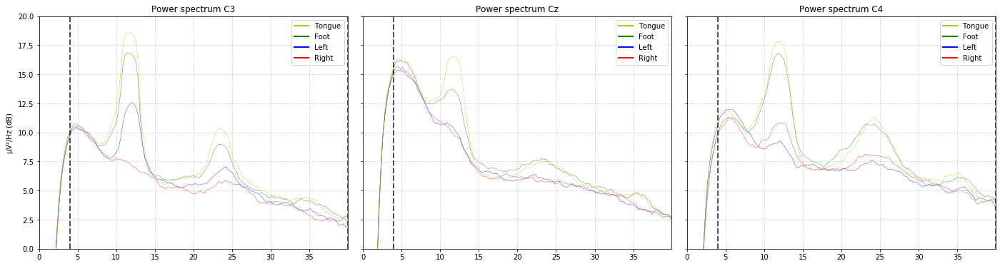

In [91]:
raw, events, event_id = read_gdf(1, 'train')
raw = preprocess_raw(raw, 4, 40, True, spatial_filter_laplacian)
epochs = make_epochs(raw, events, event_id)
plot_psds(epochs, max_amplitude=20)

### Conclusion: Laplacian filter wins by a longshot!
I put the three PSD plots into an image for easy comparison. The differentiation between conditions seen after using the Laplacian filter is so much larger than for the other two approaches (no spatial filter and common average reference).

![PSD Plots Comparison](psd-plots-comparison.png)

## Select features

In [92]:
epochs

Number of events,273
Events,cue_foot: 68cue_left: 69cue_right: 69cue_tongue: 67
Time range,-2.000 – 4.000 sec
Baseline,-2.000 – 0.000 sec


In [93]:
epochs[0]

Number of events,1
Events,cue_tongue: 1
Time range,-2.000 – 4.000 sec
Baseline,-2.000 – 0.000 sec


Enumerate potential frequency domain filters: take 2 Hz wide bins for each electrode between 4 Hz and 30 Hz (13 bins per electrode).

In [94]:
epochs[0].get_data().shape

Using data from preloaded Raw for 1 events and 1501 original time points ...
0 bad epochs dropped


(1, 25, 1501)

In [95]:
psds, freqs = mne.time_frequency.psd_multitaper(epochs, fmin=4, fmax=30, tmin=.5, picks=['eeg'])

Using data from preloaded Raw for 273 events and 1501 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows


In [96]:
psds.shape

(273, 22, 91)

In [97]:
freqs

array([ 4.28082192,  4.56621005,  4.85159817,  5.1369863 ,  5.42237443,
        5.70776256,  5.99315068,  6.27853881,  6.56392694,  6.84931507,
        7.1347032 ,  7.42009132,  7.70547945,  7.99086758,  8.27625571,
        8.56164384,  8.84703196,  9.13242009,  9.41780822,  9.70319635,
        9.98858447, 10.2739726 , 10.55936073, 10.84474886, 11.13013699,
       11.41552511, 11.70091324, 11.98630137, 12.2716895 , 12.55707763,
       12.84246575, 13.12785388, 13.41324201, 13.69863014, 13.98401826,
       14.26940639, 14.55479452, 14.84018265, 15.12557078, 15.4109589 ,
       15.69634703, 15.98173516, 16.26712329, 16.55251142, 16.83789954,
       17.12328767, 17.4086758 , 17.69406393, 17.97945205, 18.26484018,
       18.55022831, 18.83561644, 19.12100457, 19.40639269, 19.69178082,
       19.97716895, 20.26255708, 20.54794521, 20.83333333, 21.11872146,
       21.40410959, 21.68949772, 21.97488584, 22.26027397, 22.5456621 ,
       22.83105023, 23.11643836, 23.40182648, 23.68721461, 23.97

In [98]:
len(freqs)

91

In [99]:
91 / 7

13.0

In [100]:
[freqs[i] for i in range(len(freqs)) if i % 7 == 0]

[4.280821917808219,
 6.2785388127853885,
 8.276255707762557,
 10.273972602739727,
 12.271689497716896,
 14.269406392694064,
 16.267123287671232,
 18.264840182648403,
 20.262557077625573,
 22.26027397260274,
 24.25799086757991,
 26.25570776255708,
 28.253424657534246]

In [101]:
epochs.selection

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  46,  47,  48,  49,  50,  51,  53,  54,
        55,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  68,  69,
        70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  82,
        83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  95,  96,
        99, 100, 101, 102, 103, 105, 106, 107, 108, 109, 110, 111, 112,
       113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125,
       126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138,
       139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151,
       152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164,
       165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177,
       178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 18

In [102]:
len(epochs.events)

273

In [103]:
epochs.events[0]

array([92368,     0,     4])

In [104]:
event_id

{'cue_foot': 1,
 'cue_left': 2,
 'cue_right': 3,
 'cue_tongue': 4,
 'idle_eye_movements': 5,
 'idle_eyes_closed': 6,
 'idle_eyes_open': 7,
 'run_start': 8,
 'trial_rejected': 9,
 'trial_start': 10}

In [105]:
event_id_inv = {v: k for k, v in event_id.items()}
event_id_inv

{1: 'cue_foot',
 2: 'cue_left',
 3: 'cue_right',
 4: 'cue_tongue',
 5: 'idle_eye_movements',
 6: 'idle_eyes_closed',
 7: 'idle_eyes_open',
 8: 'run_start',
 9: 'trial_rejected',
 10: 'trial_start'}

In [106]:
cz_channel_index = raw.ch_names.index('EEG-Cz')
cz_channel_index

9

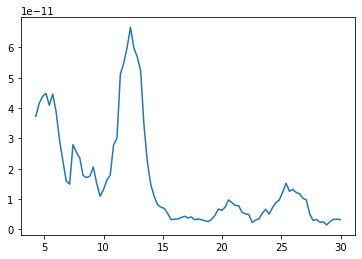

In [107]:
plt.plot(freqs, psds[0][cz_channel_index])

In [108]:
sum(psds[0][cz_channel_index][0:7]) / 7

4.1709538835207556e-11

In [109]:
psds_binned = [sum(psds[0][cz_channel_index][k:k+7]) / 7 for k in range(0, psds.shape[2], 7)]
psds_binned

[4.1709538835207556e-11,
 2.285708636605743e-11,
 1.6009165158457856e-11,
 3.682961330406982e-11,
 4.385231916399651e-11,
 6.4215845992971154e-12,
 3.712381552281775e-12,
 4.2019655617656066e-12,
 7.45045988900665e-12,
 4.37061259927853e-12,
 1.1256143272599763e-11,
 7.855669765130039e-12,
 2.6565344196159354e-12]

In [110]:
freqs_binned = [freqs[l] for l in range(0, psds.shape[2], 7)]
freqs_binned

[4.280821917808219,
 6.2785388127853885,
 8.276255707762557,
 10.273972602739727,
 12.271689497716896,
 14.269406392694064,
 16.267123287671232,
 18.264840182648403,
 20.262557077625573,
 22.26027397260274,
 24.25799086757991,
 26.25570776255708,
 28.253424657534246]

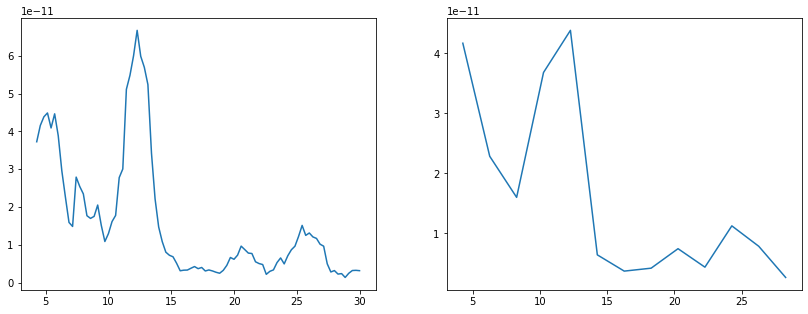

In [111]:
fig, axs = plt.subplots(1, 2, figsize=(14, 5))
axs[0].plot(freqs, psds[0][cz_channel_index])
axs[1].plot(freqs_binned, psds_binned)

The 2Hz bin resolution causes some parts of the graph to look a lot different, let's try 1Hz instead.

In [112]:
freqs

array([ 4.28082192,  4.56621005,  4.85159817,  5.1369863 ,  5.42237443,
        5.70776256,  5.99315068,  6.27853881,  6.56392694,  6.84931507,
        7.1347032 ,  7.42009132,  7.70547945,  7.99086758,  8.27625571,
        8.56164384,  8.84703196,  9.13242009,  9.41780822,  9.70319635,
        9.98858447, 10.2739726 , 10.55936073, 10.84474886, 11.13013699,
       11.41552511, 11.70091324, 11.98630137, 12.2716895 , 12.55707763,
       12.84246575, 13.12785388, 13.41324201, 13.69863014, 13.98401826,
       14.26940639, 14.55479452, 14.84018265, 15.12557078, 15.4109589 ,
       15.69634703, 15.98173516, 16.26712329, 16.55251142, 16.83789954,
       17.12328767, 17.4086758 , 17.69406393, 17.97945205, 18.26484018,
       18.55022831, 18.83561644, 19.12100457, 19.40639269, 19.69178082,
       19.97716895, 20.26255708, 20.54794521, 20.83333333, 21.11872146,
       21.40410959, 21.68949772, 21.97488584, 22.26027397, 22.5456621 ,
       22.83105023, 23.11643836, 23.40182648, 23.68721461, 23.97

In [113]:
freqs_1hz_inc = list(range(4, 30))
print(freqs_1hz_inc)

[4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]


In [114]:
psds_binned_1hz = []
curr_bin_freq = 4
curr_bin_sum = 0
curr_bin_size = 0
for f in range(len(freqs)):
    if int(freqs[f]) > curr_bin_freq:
        psds_binned_1hz.append(curr_bin_sum / curr_bin_size)
        curr_bin_sum = 0
        curr_bin_size = 0
        curr_bin_freq += 1
    curr_bin_sum += psds[0][cz_channel_index][f]
    curr_bin_size += 1
psds_binned_1hz.append(curr_bin_sum / curr_bin_size)

In [115]:
print(psds_binned_1hz)

[4.0892004062027535e-11, 4.2322689915092577e-11, 2.273925776252517e-11, 2.294545781870663e-11, 1.7446514078171297e-11, 1.4931153468672777e-11, 2.0605472450918968e-11, 4.8997718943932975e-11, 6.114331219705877e-11, 3.08840743891998e-11, 8.767270647143376e-12, 4.662320063412419e-12, 3.861116572581367e-12, 3.6008302870570814e-12, 2.840193050749518e-12, 5.223294945027673e-12, 8.61158830834759e-12, 6.579613574500941e-12, 3.390947518402466e-12, 5.105361409935577e-12, 8.538573519038036e-12, 1.3294320587771059e-11, 1.1370345685820196e-11, 5.219662824612422e-12, 2.0766432832117396e-12, 3.0914527719190827e-12]


In [116]:
len(psds_binned_1hz)

26

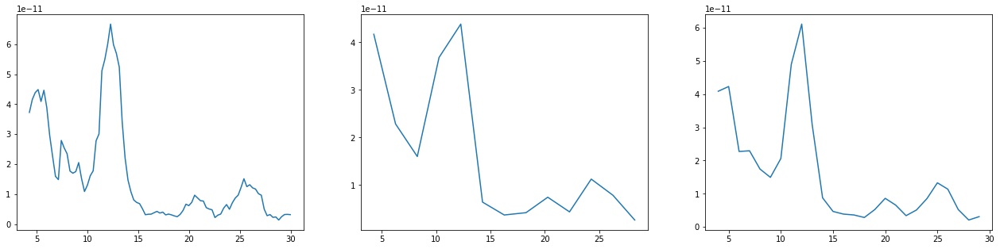

In [117]:
fig, axs = plt.subplots(1, 3, figsize=(22, 5))
axs[0].plot(freqs, psds[0][cz_channel_index])
axs[1].plot(freqs_binned, psds_binned)
axs[2].plot(freqs_1hz_inc, psds_binned_1hz)

<BarContainer object of 26 artists>

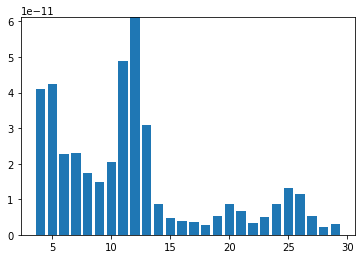

In [118]:
plt.bar(freqs_1hz_inc, psds_binned_1hz)

In [119]:
def bin_power_spectrum_1hz(psd, freqs):
    freqs_1hz_inc = list(range(4, 30))
    psds_binned_1hz = []
    curr_bin_freq = 4
    curr_bin_sum = 0
    curr_bin_size = 0
    for f in range(len(freqs)):
        if int(freqs[f]) > curr_bin_freq:
            psds_binned_1hz.append(curr_bin_sum / curr_bin_size)
            curr_bin_sum = 0
            curr_bin_size = 0
            curr_bin_freq += 1
        curr_bin_sum += psd[f]
        curr_bin_size += 1
    psds_binned_1hz.append(curr_bin_sum / curr_bin_size)

    return freqs_1hz_inc, psds_binned_1hz

In [120]:
test_freqs_binned, test_psds_binned = bin_power_spectrum_1hz(psds[0][cz_channel_index], freqs)

<BarContainer object of 26 artists>

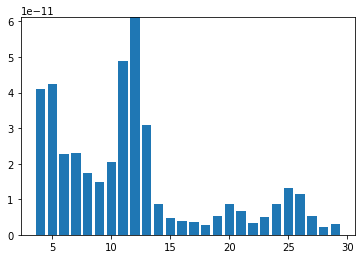

In [121]:
plt.bar(test_freqs_binned, test_psds_binned)

In [122]:
import pandas as pd

In [123]:
candidate_features_df = []
for i in range(len(psds)):
    num_electrodes = psds.shape[1]
    features_dict = {}
    for j in range(num_electrodes):
        freqs_binned, psd_binned = bin_power_spectrum_1hz(psds[i][j], freqs)
        for k in range(len(freqs_binned)):
            ch_name = raw.ch_names[j]
            freq_bin_str = str(freqs_binned[k]) + 'Hz'
            band_power = psd_binned[k]
            feature_name = '{}_{}'.format(ch_name, freq_bin_str)
            features_dict[feature_name] = band_power
    epoch_event_id = epochs.events[i][2]
    trial_label = event_id_inv[epoch_event_id]
    features_dict['target'] = trial_label
    candidate_features_df.append(features_dict)

candidate_features_df = pd.DataFrame(candidate_features_df)

In [124]:
candidate_features_df

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz,target
0,3.633164e-10,3.512303e-10,2.388951e-10,1.672270e-10,6.581872e-11,2.813283e-11,3.238987e-11,4.018868e-11,3.232259e-11,1.687450e-11,...,2.377507e-11,2.839739e-11,3.758708e-11,5.258019e-11,3.937403e-11,2.196620e-11,1.852429e-11,1.158325e-11,6.903350e-12,cue_tongue
1,1.664984e-10,1.516726e-10,1.341791e-10,9.446206e-11,7.038696e-11,5.415114e-11,3.030416e-11,2.816116e-11,2.549856e-11,2.467075e-11,...,1.623439e-11,1.551067e-11,4.206848e-11,4.209803e-11,2.791669e-11,3.320260e-11,2.196638e-11,8.948792e-12,9.398032e-12,cue_foot
2,1.690083e-10,1.474032e-10,9.857851e-11,6.231787e-11,4.497591e-11,4.091180e-11,3.756031e-11,2.646770e-11,3.230123e-11,2.684929e-11,...,2.043019e-11,1.484046e-11,1.411178e-11,2.145911e-11,2.484689e-11,2.439698e-11,1.809481e-11,1.306837e-11,1.104498e-11,cue_right
3,1.307086e-10,2.783967e-10,2.843440e-10,1.403077e-10,6.604404e-11,5.134787e-11,5.182112e-11,3.831613e-11,4.366268e-11,4.108376e-11,...,2.546706e-11,2.878457e-11,2.581472e-11,2.451731e-11,2.007613e-11,1.214048e-11,1.649184e-11,1.567312e-11,1.263191e-11,cue_left
4,3.792269e-10,2.900286e-10,1.714716e-10,1.163799e-10,5.804955e-11,4.113232e-11,4.705519e-11,6.709695e-11,7.173174e-11,5.886301e-11,...,1.785623e-11,1.920362e-11,2.977868e-11,4.655289e-11,3.072323e-11,1.437928e-11,1.942768e-11,1.784692e-11,1.092394e-11,cue_left
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268,9.509461e-11,1.382087e-10,1.446504e-10,1.134593e-10,7.371456e-11,4.923622e-11,4.031664e-11,3.673868e-11,2.522042e-11,2.462836e-11,...,2.706889e-11,1.259061e-11,1.236447e-11,2.405286e-11,2.024771e-11,8.493681e-12,1.256384e-11,1.703004e-11,1.675805e-11,cue_right
269,7.527403e-11,1.020560e-10,1.497506e-10,2.139649e-10,1.878925e-10,7.757105e-11,3.883188e-11,5.066869e-11,4.836221e-11,3.053555e-11,...,3.350054e-11,2.179766e-11,2.446719e-11,2.793619e-11,1.842850e-11,1.860878e-11,2.293906e-11,1.783428e-11,1.150329e-11,cue_left
270,1.223999e-10,7.696423e-11,6.870459e-11,8.033040e-11,6.012079e-11,4.677115e-11,1.384157e-11,1.683159e-11,2.523764e-11,1.613991e-11,...,3.097938e-11,2.177057e-11,2.638819e-11,3.225566e-11,2.388062e-11,1.508911e-11,1.285692e-11,8.235795e-12,6.086641e-12,cue_foot
271,1.185518e-10,9.814829e-11,7.653727e-11,9.321620e-11,9.998877e-11,6.298110e-11,4.443854e-11,3.210322e-11,2.629797e-11,2.662394e-11,...,2.278993e-11,4.004505e-11,4.391527e-11,3.526669e-11,2.502402e-11,2.299846e-11,1.785290e-11,1.552605e-11,1.507427e-11,cue_left


In [125]:
pd.set_option('display.max_columns', None)

In [126]:
candidate_features_df.describe()

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,EEG-Fz_14Hz,EEG-Fz_15Hz,EEG-Fz_16Hz,EEG-Fz_17Hz,EEG-Fz_18Hz,EEG-Fz_19Hz,EEG-Fz_20Hz,EEG-Fz_21Hz,EEG-Fz_22Hz,EEG-Fz_23Hz,EEG-Fz_24Hz,EEG-Fz_25Hz,EEG-Fz_26Hz,EEG-Fz_27Hz,EEG-Fz_28Hz,EEG-Fz_29Hz,EEG-2_4Hz,EEG-2_5Hz,EEG-2_6Hz,EEG-2_7Hz,EEG-2_8Hz,EEG-2_9Hz,EEG-2_10Hz,EEG-2_11Hz,EEG-2_12Hz,EEG-2_13Hz,EEG-2_14Hz,EEG-2_15Hz,EEG-2_16Hz,EEG-2_17Hz,EEG-2_18Hz,EEG-2_19Hz,EEG-2_20Hz,EEG-2_21Hz,EEG-2_22Hz,EEG-2_23Hz,EEG-2_24Hz,EEG-2_25Hz,EEG-2_26Hz,EEG-2_27Hz,EEG-2_28Hz,EEG-2_29Hz,EEG-3_4Hz,EEG-3_5Hz,EEG-3_6Hz,EEG-3_7Hz,EEG-3_8Hz,EEG-3_9Hz,EEG-3_10Hz,EEG-3_11Hz,EEG-3_12Hz,EEG-3_13Hz,EEG-3_14Hz,EEG-3_15Hz,EEG-3_16Hz,EEG-3_17Hz,EEG-3_18Hz,EEG-3_19Hz,EEG-3_20Hz,EEG-3_21Hz,EEG-3_22Hz,EEG-3_23Hz,EEG-3_24Hz,EEG-3_25Hz,EEG-3_26Hz,EEG-3_27Hz,EEG-3_28Hz,EEG-3_29Hz,EEG-4_4Hz,EEG-4_5Hz,EEG-4_6Hz,EEG-4_7Hz,EEG-4_8Hz,EEG-4_9Hz,EEG-4_10Hz,EEG-4_11Hz,EEG-4_12Hz,EEG-4_13Hz,EEG-4_14Hz,EEG-4_15Hz,EEG-4_16Hz,EEG-4_17Hz,EEG-4_18Hz,EEG-4_19Hz,EEG-4_20Hz,EEG-4_21Hz,EEG-4_22Hz,EEG-4_23Hz,EEG-4_24Hz,EEG-4_25Hz,EEG-4_26Hz,EEG-4_27Hz,EEG-4_28Hz,EEG-4_29Hz,EEG-5_4Hz,EEG-5_5Hz,EEG-5_6Hz,EEG-5_7Hz,EEG-5_8Hz,EEG-5_9Hz,EEG-5_10Hz,EEG-5_11Hz,EEG-5_12Hz,EEG-5_13Hz,EEG-5_14Hz,EEG-5_15Hz,EEG-5_16Hz,EEG-5_17Hz,EEG-5_18Hz,EEG-5_19Hz,EEG-5_20Hz,EEG-5_21Hz,EEG-5_22Hz,EEG-5_23Hz,EEG-5_24Hz,EEG-5_25Hz,EEG-5_26Hz,EEG-5_27Hz,EEG-5_28Hz,EEG-5_29Hz,EEG-6_4Hz,EEG-6_5Hz,EEG-6_6Hz,EEG-6_7Hz,EEG-6_8Hz,EEG-6_9Hz,EEG-6_10Hz,EEG-6_11Hz,EEG-6_12Hz,EEG-6_13Hz,EEG-6_14Hz,EEG-6_15Hz,EEG-6_16Hz,EEG-6_17Hz,EEG-6_18Hz,EEG-6_19Hz,EEG-6_20Hz,EEG-6_21Hz,EEG-6_22Hz,EEG-6_23Hz,EEG-6_24Hz,EEG-6_25Hz,EEG-6_26Hz,EEG-6_27Hz,EEG-6_28Hz,EEG-6_29Hz,EEG-7_4Hz,EEG-7_5Hz,EEG-7_6Hz,EEG-7_7Hz,EEG-7_8Hz,EEG-7_9Hz,EEG-7_10Hz,EEG-7_11Hz,EEG-7_12Hz,EEG-7_13Hz,EEG-7_14Hz,EEG-7_15Hz,EEG-7_16Hz,EEG-7_17Hz,EEG-7_18Hz,EEG-7_19Hz,EEG-7_20Hz,EEG-7_21Hz,EEG-7_22Hz,EEG-7_23Hz,EEG-7_24Hz,EEG-7_25Hz,EEG-7_26Hz,EEG-7_27Hz,EEG-7_28Hz,EEG-7_29Hz,EEG-C3_4Hz,EEG-C3_5Hz,EEG-C3_6Hz,EEG-C3_7Hz,EEG-C3_8Hz,EEG-C3_9Hz,EEG-C3_10Hz,EEG-C3_11Hz,EEG-C3_12Hz,EEG-C3_13Hz,EEG-C3_14Hz,EEG-C3_15Hz,EEG-C3_16Hz,EEG-C3_17Hz,EEG-C3_18Hz,EEG-C3_19Hz,EEG-C3_20Hz,EEG-C3_21Hz,EEG-C3_22Hz,EEG-C3_23Hz,EEG-C3_24Hz,EEG-C3_25Hz,EEG-C3_26Hz,EEG-C3_27Hz,EEG-C3_28Hz,EEG-C3_29Hz,EEG-9_4Hz,EEG-9_5Hz,EEG-9_6Hz,EEG-9_7Hz,EEG-9_8Hz,EEG-9_9Hz,EEG-9_10Hz,EEG-9_11Hz,EEG-9_12Hz,EEG-9_13Hz,EEG-9_14Hz,EEG-9_15Hz,EEG-9_16Hz,EEG-9_17Hz,EEG-9_18Hz,EEG-9_19Hz,EEG-9_20Hz,EEG-9_21Hz,EEG-9_22Hz,EEG-9_23Hz,EEG-9_24Hz,EEG-9_25Hz,EEG-9_26Hz,EEG-9_27Hz,EEG-9_28Hz,EEG-9_29Hz,EEG-Cz_4Hz,EEG-Cz_5Hz,EEG-Cz_6Hz,EEG-Cz_7Hz,EEG-Cz_8Hz,EEG-Cz_9Hz,EEG-Cz_10Hz,EEG-Cz_11Hz,EEG-Cz_12Hz,EEG-Cz_13Hz,EEG-Cz_14Hz,EEG-Cz_15Hz,EEG-Cz_16Hz,EEG-Cz_17Hz,EEG-Cz_18Hz,EEG-Cz_19Hz,EEG-Cz_20Hz,EEG-Cz_21Hz,EEG-Cz_22Hz,EEG-Cz_23Hz,EEG-Cz_24Hz,EEG-Cz_25Hz,EEG-Cz_26Hz,EEG-Cz_27Hz,EEG-Cz_28Hz,EEG-Cz_29Hz,EEG-11_4Hz,EEG-11_5Hz,EEG-11_6Hz,EEG-11_7Hz,EEG-11_8Hz,EEG-11_9Hz,EEG-11_10Hz,EEG-11_11Hz,EEG-11_12Hz,EEG-11_13Hz,EEG-11_14Hz,EEG-11_15Hz,EEG-11_16Hz,EEG-11_17Hz,EEG-11_18Hz,EEG-11_19Hz,EEG-11_20Hz,EEG-11_21Hz,EEG-11_22Hz,EEG-11_23Hz,EEG-11_24Hz,EEG-11_25Hz,EEG-11_26Hz,EEG-11_27Hz,EEG-11_28Hz,EEG-11_29Hz,EEG-C4_4Hz,EEG-C4_5Hz,EEG-C4_6Hz,EEG-C4_7Hz,EEG-C4_8Hz,EEG-C4_9Hz,EEG-C4_10Hz,EEG-C4_11Hz,EEG-C4_12Hz,EEG-C4_13Hz,EEG-C4_14Hz,EEG-C4_15Hz,EEG-C4_16Hz,EEG-C4_17Hz,EEG-C4_18Hz,EEG-C4_19Hz,EEG-C4_20Hz,EEG-C4_21Hz,EEG-C4_22Hz,EEG-C4_23Hz,EEG-C4_24Hz,EEG-C4_25Hz,EEG-C4_26Hz,EEG-C4_27Hz,EEG-C4_28Hz,EEG-C4_29Hz,EEG-13_4Hz,EEG-13_5Hz,EEG-13_6Hz,EEG-13_7Hz,EEG-13_8Hz,EEG-13_9Hz,EEG-13_10Hz,EEG-13_11Hz,EEG-13_12Hz,EEG-13_13Hz,EEG-13_14Hz,EEG-13_15Hz,EEG-13_16Hz,EEG-13_17Hz,EEG-13_18Hz,EEG-13_19Hz,EEG-13_20Hz,EEG-13_21Hz,EEG-13_22Hz,EEG-13_23Hz,EEG-13_24Hz,EEG-13_25Hz,EEG-13_26Hz,EEG-13_27Hz,EEG-13_28Hz,EEG-13_29Hz,EEG-14_4Hz,EEG-14_5Hz,EEG-14_6Hz,EEG-14_7Hz,EEG-14_8Hz,EEG-14_9Hz,EEG-14_10Hz,EEG-14_11Hz,EEG-14_12Hz,EEG-14_13Hz,EEG-14_14Hz,EEG-14_15Hz,EEG-14_16Hz,EEG-14_17Hz,EEG-14_18Hz,EEG-14_19Hz,EEG-14_20Hz,EEG-1

In [127]:
X = candidate_features_df.drop(columns=['target'])
y = candidate_features_df['target']

In [128]:
pd.set_option('display.max_columns', 20)

In [129]:
X

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
0,3.633164e-10,3.512303e-10,2.388951e-10,1.672270e-10,6.581872e-11,2.813283e-11,3.238987e-11,4.018868e-11,3.232259e-11,1.687450e-11,...,2.872795e-11,2.377507e-11,2.839739e-11,3.758708e-11,5.258019e-11,3.937403e-11,2.196620e-11,1.852429e-11,1.158325e-11,6.903350e-12
1,1.664984e-10,1.516726e-10,1.341791e-10,9.446206e-11,7.038696e-11,5.415114e-11,3.030416e-11,2.816116e-11,2.549856e-11,2.467075e-11,...,1.960268e-11,1.623439e-11,1.551067e-11,4.206848e-11,4.209803e-11,2.791669e-11,3.320260e-11,2.196638e-11,8.948792e-12,9.398032e-12
2,1.690083e-10,1.474032e-10,9.857851e-11,6.231787e-11,4.497591e-11,4.091180e-11,3.756031e-11,2.646770e-11,3.230123e-11,2.684929e-11,...,3.207518e-11,2.043019e-11,1.484046e-11,1.411178e-11,2.145911e-11,2.484689e-11,2.439698e-11,1.809481e-11,1.306837e-11,1.104498e-11
3,1.307086e-10,2.783967e-10,2.843440e-10,1.403077e-10,6.604404e-11,5.134787e-11,5.182112e-11,3.831613e-11,4.366268e-11,4.108376e-11,...,3.083573e-11,2.546706e-11,2.878457e-11,2.581472e-11,2.451731e-11,2.007613e-11,1.214048e-11,1.649184e-11,1.567312e-11,1.263191e-11
4,3.792269e-10,2.900286e-10,1.714716e-10,1.163799e-10,5.804955e-11,4.113232e-11,4.705519e-11,6.709695e-11,7.173174e-11,5.886301e-11,...,2.169779e-11,1.785623e-11,1.920362e-11,2.977868e-11,4.655289e-11,3.072323e-11,1.437928e-11,1.942768e-11,1.784692e-11,1.092394e-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268,9.509461e-11,1.382087e-10,1.446504e-10,1.134593e-10,7.371456e-11,4.923622e-11,4.031664e-11,3.673868e-11,2.522042e-11,2.462836e-11,...,3.603079e-11,2.706889e-11,1.259061e-11,1.236447e-11,2.405286e-11,2.024771e-11,8.493681e-12,1.256384e-11,1.703004e-11,1.675805e-11
269,7.527403e-11,1.020560e-10,1.497506e-10,2.139649e-10,1.878925e-10,7.757105e-11,3.883188e-11,5.066869e-11,4.836221e-11,3.053555e-11,...,3.652435e-11,3.350054e-11,2.179766e-11,2.446719e-11,2.793619e-11,1.842850e-11,1.860878e-11,2.293906e-11,1.783428e-11,1.150329e-11
270,1.223999e-10,7.696423e-11,6.870459e-11,8.033040e-11,6.012079e-11,4.677115e-11,1.384157e-11,1.683159e-11,2.523764e-11,1.613991e-11,...,4.258872e-11,3.097938e-11,2.177057e-11,2.638819e-11,3.225566e-11,2.388062e-11,1.508911e-11,1.285692e-11,8.235795e-12,6.086641e-12
271,1.185518e-10,9.814829e-11,7.653727e-11,9.321620e-11,9.998877e-11,6.298110e-11,4.443854e-11,3.210322e-11,2.629797e-11,2.662394e-11,...,1.912358e-11,2.278993e-11,4.004505e-11,4.391527e-11,3.526669e-11,2.502402e-11,2.299846e-11,1.785290e-11,1.552605e-11,1.507427e-11


In [130]:
y

0      cue_tongue
1        cue_foot
2       cue_right
3        cue_left
4        cue_left
          ...    
268     cue_right
269      cue_left
270      cue_foot
271      cue_left
272     cue_right
Name: target, Length: 273, dtype: object

In [131]:
from sklearn.preprocessing import LabelEncoder

In [132]:
label_encoder = LabelEncoder()
label_encoder.fit(y)

LabelEncoder()

In [133]:
label_encoder.classes_

array(['cue_foot', 'cue_left', 'cue_right', 'cue_tongue'], dtype=object)

In [134]:
y = label_encoder.transform(y)
y

array([3, 0, 2, 1, 1, 2, 0, 3, 2, 0, 1, 1, 1, 3, 2, 2, 1, 1, 0, 1, 2, 3,
       0, 1, 3, 3, 2, 3, 3, 2, 1, 2, 0, 0, 0, 3, 0, 1, 3, 2, 0, 2, 0, 3,
       0, 1, 1, 1, 3, 2, 0, 1, 0, 3, 1, 0, 0, 1, 0, 2, 3, 3, 3, 1, 3, 2,
       3, 2, 1, 0, 2, 1, 0, 0, 1, 0, 3, 3, 2, 1, 2, 3, 2, 3, 0, 2, 2, 2,
       0, 1, 2, 0, 0, 3, 1, 1, 2, 3, 3, 3, 2, 1, 0, 2, 3, 1, 3, 0, 2, 3,
       3, 1, 2, 2, 0, 3, 2, 1, 1, 3, 2, 1, 0, 2, 2, 0, 1, 3, 0, 0, 0, 0,
       1, 2, 1, 2, 1, 1, 0, 0, 2, 0, 3, 1, 3, 1, 1, 2, 3, 0, 2, 3, 0, 3,
       0, 3, 2, 2, 3, 1, 2, 2, 2, 0, 3, 1, 3, 1, 0, 1, 3, 1, 0, 1, 2, 0,
       0, 3, 1, 2, 3, 2, 0, 1, 3, 2, 3, 1, 1, 0, 0, 2, 3, 2, 2, 1, 2, 3,
       3, 2, 2, 2, 2, 3, 0, 3, 1, 2, 0, 2, 1, 3, 1, 3, 1, 1, 1, 1, 0, 3,
       2, 0, 0, 0, 3, 0, 1, 0, 1, 3, 2, 3, 3, 0, 3, 3, 0, 2, 3, 0, 1, 2,
       2, 0, 2, 3, 0, 3, 2, 0, 1, 3, 1, 0, 3, 1, 0, 1, 2, 2, 1, 3, 1, 0,
       0, 1, 0, 2, 2, 1, 0, 1, 2])

In [135]:
from sklearn.model_selection import train_test_split

In [136]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [137]:
from sklearn.preprocessing import StandardScaler

In [138]:
scaler = StandardScaler()

In [139]:
scaler.fit(X_train)

StandardScaler()

In [140]:
X_train_normalized = pd.DataFrame(scaler.transform(X_train), columns=X_train.columns)

In [141]:
X_train_normalized.describe()

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
count,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,...,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02
mean,5.321941e-17,3.109134e-16,-2.075302e-16,-3.172793e-16,1.201893e-16,5.856681e-17,2.393600e-16,-1.359769e-16,6.213175e-17,-4.565665e-16,...,7.741005e-17,-3.564936e-18,2.851949e-16,2.801021e-16,3.605678e-16,-3.055660e-16,-1.260460e-16,-7.129873e-17,-1.359769e-16,2.464899e-16
std,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,...,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00
min,-1.441833e+00,-1.562290e+00,-1.892182e+00,-1.655397e+00,-1.551038e+00,-1.328830e+00,-1.564453e+00,-1.656372e+00,-1.673505e+00,-1.835383e+00,...,-1.513556e+00,-1.603670e+00,-1.554499e+00,-1.898818e+00,-1.867625e+00,-1.809200e+00,-1.591855e+00,-1.957632e+00,-2.026370e+00,-1.986083e+00
25%,-7.305954e-01,-6.519090e-01,-6.637612e-01,-7.063659e-01,-6.640263e-01,-6.417674e-01,-6.706583e-01,-7.151698e-01,-6.944075e-01,-7.063387e-01,...,-6.224248e-01,-7.018298e-01,-7.598833e-01,-6.993493e-01,-7.400151e-01,-7.500781e-01,-6.594487e-01,-8.022516e-01,-7.418279e-01,-7.420011e-01
50%,-1.959751e-01,-2.235394e-01,-2.219181e-01,-1.543008e-01,-2.009369e-01,-2.231355e-01,-2.021413e-01,-1.491069e-01,-7.992150e-02,-1.091707e-01,...,-1.738462e-01,-1.737577e-01,-2.099554e-01,-1.512693e-01,-1.399192e-01,-2.372365e-01,-2.334090e-01,-1.761052e-01,-1.091999e-01,-1.404630e-01
75%,4.414336e-01,3.144616e-01,4.773214e-01,4.962576e-01,3.685007e-01,3.458987e-01,5.132310e-01,3.798034e-01,4.485491e-01,4.152281e-01,...,3.475277e-01,4.803738e-01,4.679377e-01,4.224622e-01,6.336648e-01,4.472217e-01,5.122920e-01,6.143041e-01,5.421775e-01,5.831629e-01
max,3.980300e+00,5.202827e+00,5.079483e+00,4.001986e+00,6.200653e+00,6.166024e+00,5.845348e+00,4.256087e+00,4.017960e+00,4.279269e+00,...,8.331941e+00,5.129979e+00,4.218289e+00,5.028918e+00,3.597353e+00,3.294313e+00,4.483300e+00,4.167074e+00,5.348109e+00,4.742866e+00


### Look at feature coefficients in a logistic regression model trained on normalized data

In [142]:
from sklearn.linear_model import LogisticRegression

In [143]:
clf = LogisticRegression()
clf.fit(X_train_normalized, y_train)

LogisticRegression()

In [144]:
clf.coef_

array([[-0.02276249,  0.06625903,  0.01352623, ...,  0.0070982 ,
        -0.02245798, -0.00675391],
       [-0.04483868, -0.07848166, -0.04397031, ..., -0.0619885 ,
        -0.0742375 ,  0.02601605],
       [ 0.00260427,  0.01358842,  0.02699107, ...,  0.06549627,
         0.07157802, -0.00763295],
       [ 0.0649969 , -0.0013658 ,  0.00345301, ..., -0.01060597,
         0.02511745, -0.01162919]])

In [145]:
clf.coef_.shape

(4, 572)

In [146]:
label_encoder.inverse_transform(clf.classes_)

array(['cue_foot', 'cue_left', 'cue_right', 'cue_tongue'], dtype=object)

In [147]:
pd.set_option('display.max_rows', 20)

In [148]:
sorted_features_df = pd.DataFrame({'coef': clf.coef_[1], 'feature': X_train.columns}).sort_values(by = 'coef', ascending = False).set_index('feature')
sorted_features_df.head(20)

,coef
feature,
EEG-14_25Hz,0.166173
EEG-C4_4Hz,0.147839
EEG-C4_5Hz,0.147637
EEG-14_13Hz,0.141091
EEG-14_26Hz,0.135827
EEG-2_13Hz,0.126682
EEG-19_13Hz,0.125806
EEG-Pz_28Hz,0.124990
EEG-2_25Hz,0.122047


This feature importance ranking doesn't make any sense, the alpha band at C3 and C4 would be expected to be at the top. The fact that some bands below 7Hz are ranked highly makes no sense, maybe normalizing spectral features individually is a mistake.

#### Plot average PSDs from training set to make sure their shape is maintained before and after normalization

In [149]:
X_train.describe()

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
count,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,...,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02
mean,1.339703e-10,1.287360e-10,1.110937e-10,8.285821e-11,6.444359e-11,5.299413e-11,4.329989e-11,3.557011e-11,2.921477e-11,2.318139e-11,...,3.377197e-11,2.917379e-11,2.700733e-11,2.499168e-11,2.266739e-11,1.981202e-11,1.721321e-11,1.486794e-11,1.299889e-11,1.168267e-11
std,6.397200e-11,5.917053e-11,4.825461e-11,3.426186e-11,3.200036e-11,2.708138e-11,1.912327e-11,1.573386e-11,1.261073e-11,9.545543e-12,...,1.688680e-11,1.240337e-11,1.229342e-11,1.120123e-11,9.837195e-12,8.650507e-12,7.227758e-12,5.361764e-12,4.807382e-12,4.423130e-12
min,4.194521e-11,3.650678e-11,1.999688e-11,2.627146e-11,1.492378e-11,1.709023e-11,1.345114e-11,9.568827e-12,8.159109e-12,5.701895e-12,...,8.271539e-12,9.328548e-12,7.941096e-12,3.771423e-12,4.337384e-12,4.197464e-12,5.734088e-12,4.395686e-12,3.279726e-12,2.918142e-12
25%,8.734000e-11,9.025080e-11,7.913774e-11,5.871237e-11,4.324331e-11,3.565410e-11,3.050416e-11,2.434357e-11,2.047789e-11,1.645448e-11,...,2.328534e-11,2.048873e-11,1.768721e-11,1.717610e-11,1.540443e-11,1.333836e-11,1.245782e-11,1.057634e-11,9.440831e-12,8.408240e-12
50%,1.214622e-10,1.155395e-10,1.004098e-10,7.758371e-11,5.802830e-11,4.696519e-11,3.944317e-11,3.322947e-11,2.820922e-11,2.214169e-11,...,3.084301e-11,2.702356e-11,2.443218e-11,2.330117e-11,2.129414e-11,1.776452e-11,1.553006e-11,1.392588e-11,1.247513e-11,1.106281e-11
75%,1.621449e-10,1.473002e-10,1.340738e-10,9.982187e-11,7.620867e-11,6.234004e-11,5.309201e-11,4.153216e-11,3.485831e-11,2.713587e-11,...,3.962713e-11,3.511837e-11,3.274667e-11,2.971291e-11,2.888656e-11,2.367183e-11,2.090743e-11,1.815413e-11,1.559936e-11,1.425615e-11
max,3.880134e-10,4.358832e-10,3.556394e-10,2.196588e-10,2.624111e-10,2.195951e-10,1.548254e-10,1.023810e-10,7.976784e-11,6.393554e-11,...,1.741488e-10,9.265673e-11,7.874546e-11,8.119239e-11,5.797399e-11,4.824407e-11,4.954301e-11,3.715951e-11,3.865026e-11,3.261281e-11


#### Get trial indices mask

In [150]:
y_train

array([0, 3, 3, 2, 1, 1, 0, 0, 1, 3, 3, 2, 0, 3, 0, 0, 1, 3, 2, 0, 2, 0,
       3, 2, 3, 2, 0, 3, 0, 2, 3, 0, 2, 1, 1, 3, 3, 1, 1, 2, 2, 0, 2, 3,
       2, 1, 1, 2, 2, 3, 0, 1, 1, 1, 2, 1, 2, 0, 2, 3, 2, 2, 0, 0, 3, 1,
       2, 1, 2, 0, 3, 1, 2, 1, 3, 3, 1, 3, 1, 1, 0, 2, 2, 2, 1, 1, 2, 0,
       0, 2, 3, 0, 2, 2, 0, 3, 0, 3, 2, 3, 1, 1, 1, 2, 3, 3, 1, 0, 0, 1,
       2, 3, 0, 0, 3, 2, 0, 0, 0, 2, 3, 3, 0, 2, 2, 0, 2, 3, 1, 3, 1, 3,
       2, 2, 1, 1, 0, 3, 2, 3, 1, 0, 2, 1, 1, 3, 2, 0, 0, 2, 2, 0, 2, 3,
       0, 0, 3, 1, 3, 2, 3, 0, 3, 0, 0, 1, 2, 3, 2, 1, 0, 1, 3, 0, 2, 1,
       2, 1, 1, 1, 1, 0, 0, 1, 2, 2, 0, 2, 2, 1, 3, 1, 0, 0, 3, 0, 3, 1,
       3, 1, 3, 2, 2, 1, 0, 0, 3, 3, 2, 1, 1, 2, 2, 1, 1, 3, 0, 0])

In [151]:
foot_trial_indices = np.where(y_train == label_encoder.transform(['cue_foot'])[0])[0]
foot_trial_indices

array([  0,   6,   7,  12,  14,  15,  19,  21,  26,  28,  31,  41,  50,
        57,  62,  63,  69,  80,  87,  88,  91,  94,  96, 107, 108, 112,
       113, 116, 117, 118, 122, 125, 136, 141, 147, 148, 151, 154, 155,
       161, 163, 164, 170, 173, 181, 182, 186, 192, 193, 195, 204, 205,
       216, 217], dtype=int64)

In [152]:
left_trial_indices = np.where(y_train == label_encoder.transform(['cue_left'])[0])[0]
right_trial_indices = np.where(y_train == label_encoder.transform(['cue_right'])[0])[0]
tongue_trial_indices = np.where(y_train == label_encoder.transform(['cue_tongue'])[0])[0]
print(len(left_trial_indices), len(right_trial_indices), len(tongue_trial_indices))

54 59 51


#### Plot average PSDs pre-normalization

In [153]:
X_train.iloc[foot_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C3')]

,EEG-C3_4Hz,EEG-C3_5Hz,EEG-C3_6Hz,EEG-C3_7Hz,EEG-C3_8Hz,EEG-C3_9Hz,EEG-C3_10Hz,EEG-C3_11Hz,EEG-C3_12Hz,EEG-C3_13Hz,...,EEG-C3_20Hz,EEG-C3_21Hz,EEG-C3_22Hz,EEG-C3_23Hz,EEG-C3_24Hz,EEG-C3_25Hz,EEG-C3_26Hz,EEG-C3_27Hz,EEG-C3_28Hz,EEG-C3_29Hz
33,9.031261e-12,1.238518e-11,9.790163e-12,9.260248e-12,9.003844e-12,5.723112e-12,7.506170e-12,9.213509e-12,9.157028e-12,9.188709e-12,...,3.344302e-12,3.933593e-12,4.185950e-12,5.577315e-12,3.791257e-12,2.540372e-12,2.938694e-12,3.535260e-12,4.463411e-12,3.357601e-12
75,7.770898e-12,9.312654e-12,8.052109e-12,9.638353e-12,1.238491e-11,1.544105e-11,5.002114e-11,9.693304e-11,7.572476e-11,1.538243e-11,...,4.888227e-12,4.472794e-12,9.155260e-12,7.776649e-12,4.856894e-12,5.070894e-12,5.366586e-12,3.225769e-12,2.349886e-12,2.221028e-12
182,5.406187e-12,6.169727e-12,8.923474e-12,6.568444e-12,4.276976e-12,4.980555e-12,1.612726e-11,3.998544e-11,3.530209e-11,5.150817e-12,...,4.848802e-12,3.050705e-12,4.022596e-12,4.395919e-12,3.486332e-12,3.698001e-12,4.602120e-12,4.919016e-12,5.967832e-12,6.769011e-12
168,1.598621e-11,9.693159e-12,1.316555e-11,1.066430e-11,4.800531e-12,8.811147e-12,1.646330e-11,2.183227e-11,1.687134e-11,5.722743e-12,...,2.162176e-12,3.663507e-12,5.709323e-12,5.246405e-12,3.401203e-12,3.328080e-12,3.237141e-12,2.521580e-12,2.481705e-12,2.675368e-12
73,7.972418e-12,1.517421e-11,1.236373e-11,4.776758e-12,2.213207e-12,5.528471e-12,4.751548e-11,9.744210e-11,6.999053e-11,5.652164e-12,...,5.777851e-12,4.864484e-12,5.747423e-12,7.159105e-12,5.767834e-12,3.631893e-12,5.445123e-12,6.799639e-12,5.546745e-12,4.176056e-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88,6.314840e-12,9.414099e-12,8.429194e-12,5.321511e-12,7.286777e-12,1.421762e-11,5.712981e-11,1.090379e-10,7.481610e-11,9.458666e-12,...,2.582475e-12,5.791524e-12,1.291440e-11,1.230933e-11,3.155973e-12,2.884747e-12,3.249005e-12,3.950749e-12,4.059493e-12,1.964508e-12
149,1.647252e-11,1.338658e-11,1.287536e-11,1.061193e-11,7.368633e-12,9.203048e-12,1.696605e-11,2.427642e-11,1.697142e-11,5.063491e-12,...,5.854849e-12,3.295728e-12,5.527640e-12,7.213662e-12,5.238102e-12,3.503030e-12,1.833025e-12,1.980247e-12,2.654242e-12,2.307201e-12
130,1.660656e-11,1.298473e-11,9.773621e-12,7.698298e-12,7.869586e-12,1.233278e-11,4.335048e-11,6.717991e-11,4.011491e-11,4.279973e-12,...,3.344460e-12,4.203837e-12,1.007546e-11,1.369621e-11,1.079815e-11,5.974440e-12,2.790378e-12,2.739796e-12,2.380540e-12,1.925498e-12
270,4.956281e-12,6.978575e-12,9.427759e-12,1.046165e-11,9.124527e-12,6.460625e-12,1.105582e-11,3.321556e-11,2.908440e-11,5.921273e-12,...,4.783797e-12,5.767195e-12,5.188189e-12,8.327255e-12,7.226585e-12,3.123751e-12,2.706544e-12,2.077236e-12,1.529682e-12,1.777211e-12


In [154]:
foot_c3_psd = X_train.iloc[foot_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C3')].mean()
left_c3_psd = X_train.iloc[left_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C3')].mean()
right_c3_psd = X_train.iloc[right_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C3')].mean()
tongue_c3_psd = X_train.iloc[tongue_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C3')].mean()
foot_cz_psd = X_train.iloc[foot_trial_indices].loc[:, X_train.columns.str.startswith('EEG-Cz')].mean()
left_cz_psd = X_train.iloc[left_trial_indices].loc[:, X_train.columns.str.startswith('EEG-Cz')].mean()
right_cz_psd = X_train.iloc[right_trial_indices].loc[:, X_train.columns.str.startswith('EEG-Cz')].mean()
tongue_cz_psd = X_train.iloc[tongue_trial_indices].loc[:, X_train.columns.str.startswith('EEG-Cz')].mean()
foot_c4_psd = X_train.iloc[foot_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C4')].mean()
left_c4_psd = X_train.iloc[left_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C4')].mean()
right_c4_psd = X_train.iloc[right_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C4')].mean()
tongue_c4_psd = X_train.iloc[tongue_trial_indices].loc[:, X_train.columns.str.startswith('EEG-C4')].mean()

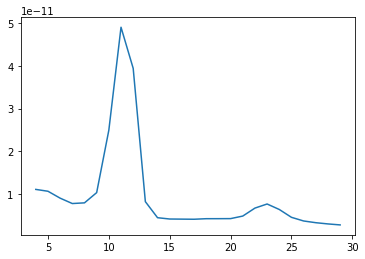

In [155]:
plt.plot(freqs_1hz_inc, foot_c3_psd)

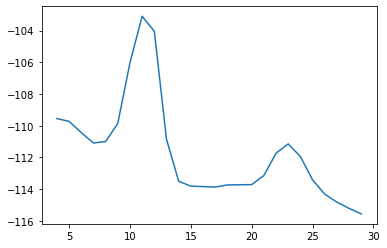

In [156]:
plt.plot(freqs_1hz_inc, 10 * np.log10(foot_c3_psd))

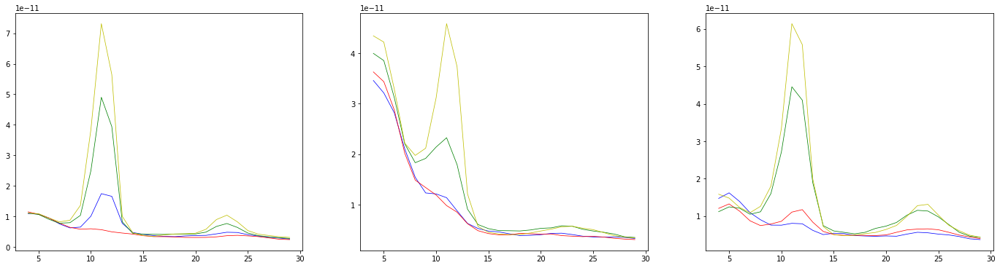

In [157]:
fig, axs = plt.subplots(1, 3, figsize=(24, 6))
axs[0].plot(freqs_1hz_inc, left_c3_psd, color='b', linewidth=.75)
axs[0].plot(freqs_1hz_inc, right_c3_psd, color='r', linewidth=.75)
axs[0].plot(freqs_1hz_inc, foot_c3_psd, color='g', linewidth=.75)
axs[0].plot(freqs_1hz_inc, tongue_c3_psd, color='y', linewidth=.75)
axs[1].plot(freqs_1hz_inc, left_cz_psd, color='b', linewidth=.75)
axs[1].plot(freqs_1hz_inc, right_cz_psd, color='r', linewidth=.75)
axs[1].plot(freqs_1hz_inc, foot_cz_psd, color='g', linewidth=.75)
axs[1].plot(freqs_1hz_inc, tongue_cz_psd, color='y', linewidth=.75)
axs[2].plot(freqs_1hz_inc, left_c4_psd, color='b', linewidth=.75)
axs[2].plot(freqs_1hz_inc, right_c4_psd, color='r', linewidth=.75)
axs[2].plot(freqs_1hz_inc, foot_c4_psd, color='g', linewidth=.75)
axs[2].plot(freqs_1hz_inc, tongue_c4_psd, color='y', linewidth=.75)

In [158]:
def log_psd(psd):
    return 10 * np.log10(psd)

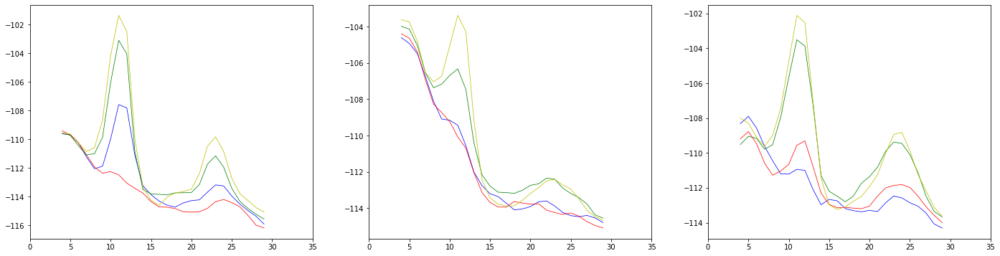

In [159]:
fig, axs = plt.subplots(1, 3, figsize=(24, 6))
axs[0].plot(freqs_1hz_inc, log_psd(left_c3_psd), color='b', linewidth=.75)
axs[0].plot(freqs_1hz_inc, log_psd(right_c3_psd), color='r', linewidth=.75)
axs[0].plot(freqs_1hz_inc, log_psd(foot_c3_psd), color='g', linewidth=.75)
axs[0].plot(freqs_1hz_inc, log_psd(tongue_c3_psd), color='y', linewidth=.75)
axs[1].plot(freqs_1hz_inc, log_psd(left_cz_psd), color='b', linewidth=.75)
axs[1].plot(freqs_1hz_inc, log_psd(right_cz_psd), color='r', linewidth=.75)
axs[1].plot(freqs_1hz_inc, log_psd(foot_cz_psd), color='g', linewidth=.75)
axs[1].plot(freqs_1hz_inc, log_psd(tongue_cz_psd), color='y', linewidth=.75)
axs[2].plot(freqs_1hz_inc, log_psd(left_c4_psd), color='b', linewidth=.75)
axs[2].plot(freqs_1hz_inc, log_psd(right_c4_psd), color='r', linewidth=.75)
axs[2].plot(freqs_1hz_inc, log_psd(foot_c4_psd), color='g', linewidth=.75)
axs[2].plot(freqs_1hz_inc, log_psd(tongue_c4_psd), color='y', linewidth=.75)

for ax in axs:
    ax.set_xlim(left=0, right=35)

Using data from preloaded Raw for 69 events and 1501 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 69 events and 1501 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 68 events and 1501 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 67 events and 1501 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows
Need more than one channel to make topography for eeg. Disabling interactivity.
Using data from preloaded Raw for 69 events and 1501 original time points ...
    Using multitaper spectrum estimation with 

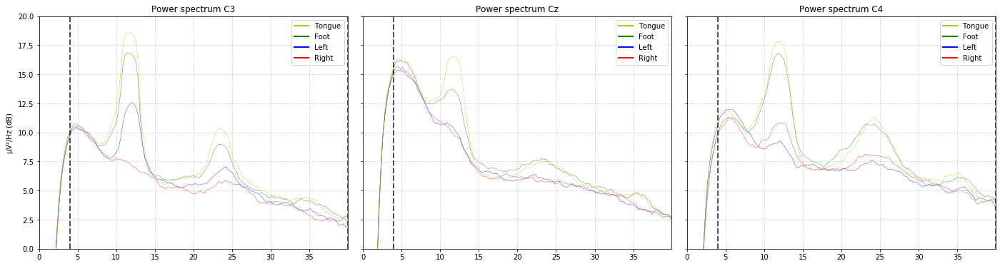

In [160]:
plot_psds(epochs, max_amplitude=20)

#### Plot average PSDs post-normalization

In [161]:
X_train_normalized.iloc[foot_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C3')]

,EEG-C3_4Hz,EEG-C3_5Hz,EEG-C3_6Hz,EEG-C3_7Hz,EEG-C3_8Hz,EEG-C3_9Hz,EEG-C3_10Hz,EEG-C3_11Hz,EEG-C3_12Hz,EEG-C3_13Hz,...,EEG-C3_20Hz,EEG-C3_21Hz,EEG-C3_22Hz,EEG-C3_23Hz,EEG-C3_24Hz,EEG-C3_25Hz,EEG-C3_26Hz,EEG-C3_27Hz,EEG-C3_28Hz,EEG-C3_29Hz
0,-0.461480,0.428289,0.132648,0.513945,0.550223,-0.643864,-0.667968,-0.794209,-0.789091,0.400025,...,-0.325321,-0.187549,-0.468271,-0.256825,-0.636137,-0.940841,-0.469110,0.185955,1.348138,0.614205
6,-0.737325,-0.371610,-0.394894,0.649189,1.634852,1.312287,1.747578,1.895971,1.938700,1.895301,...,0.637518,0.064567,1.055209,0.343996,-0.282156,0.369067,1.060496,-0.038049,-0.509195,-0.446704
7,-1.254870,-1.189836,-0.130413,-0.448880,-0.966134,-0.793335,-0.178149,0.149504,0.282274,-0.574794,...,0.612931,-0.600363,-0.518352,-0.579562,-0.737426,-0.341602,0.578872,1.187493,2.670199,3.798512
12,1.060692,-0.272549,1.157160,1.016159,-0.798180,-0.022265,-0.159056,-0.407217,-0.472976,-0.436721,...,-1.062531,-0.313834,-0.001239,-0.347224,-0.765704,-0.533089,-0.281084,-0.547729,-0.393354,-0.022610
14,-0.693220,1.154381,0.913790,-1.089744,-1.628182,-0.683044,1.605215,1.911583,1.703725,-0.453760,...,1.192314,0.247711,0.010442,0.175293,0.020439,-0.375822,1.109976,2.548654,2.300155,1.378174
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,-1.056000,-0.345200,-0.280440,-0.894893,-0.000605,1.066017,2.151467,2.267204,1.901466,0.465197,...,-0.800420,0.681169,2.207676,1.582249,-0.847164,-0.762578,-0.273610,0.486679,0.993182,-0.686147
204,1.167127,0.688993,1.069081,0.997426,0.025655,0.056622,-0.130492,-0.332260,-0.468875,-0.595877,...,1.240332,-0.485797,-0.056938,0.190198,-0.155527,-0.442528,-1.165698,-0.939535,-0.241731,-0.366267
205,1.196464,0.584374,0.127627,-0.044745,0.186358,0.686614,1.368575,0.983503,0.479492,-0.785032,...,-0.325223,-0.061190,1.337320,1.961122,1.691400,0.836782,-0.562552,-0.389787,-0.482256,-0.722560
216,-1.353337,-0.979261,0.022649,0.943671,0.588937,-0.495408,-0.466289,-0.058115,0.027487,-0.388793,...,0.572392,0.669793,-0.161007,0.494413,0.505003,-0.638859,-0.615368,-0.869336,-1.229977,-0.860975


In [162]:
foot_c3_psd = X_train_normalized.iloc[foot_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C3')].mean()
left_c3_psd = X_train_normalized.iloc[left_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C3')].mean()
right_c3_psd = X_train_normalized.iloc[right_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C3')].mean()
tongue_c3_psd = X_train_normalized.iloc[tongue_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C3')].mean()
foot_cz_psd = X_train_normalized.iloc[foot_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-Cz')].mean()
left_cz_psd = X_train_normalized.iloc[left_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-Cz')].mean()
right_cz_psd = X_train_normalized.iloc[right_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-Cz')].mean()
tongue_cz_psd = X_train_normalized.iloc[tongue_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-Cz')].mean()
foot_c4_psd = X_train_normalized.iloc[foot_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C4')].mean()
left_c4_psd = X_train_normalized.iloc[left_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C4')].mean()
right_c4_psd = X_train_normalized.iloc[right_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C4')].mean()
tongue_c4_psd = X_train_normalized.iloc[tongue_trial_indices].loc[:, X_train_normalized.columns.str.startswith('EEG-C4')].mean()

In [163]:
foot_c3_psd

EEG-C3_4Hz    -0.011981
EEG-C3_5Hz    -0.022989
EEG-C3_6Hz    -0.096036
EEG-C3_7Hz    -0.016599
EEG-C3_8Hz     0.208536
                 ...   
EEG-C3_25Hz    0.100359
EEG-C3_26Hz    0.008037
EEG-C3_27Hz    0.010681
EEG-C3_28Hz    0.067768
EEG-C3_29Hz    0.070594
Length: 26, dtype: float64

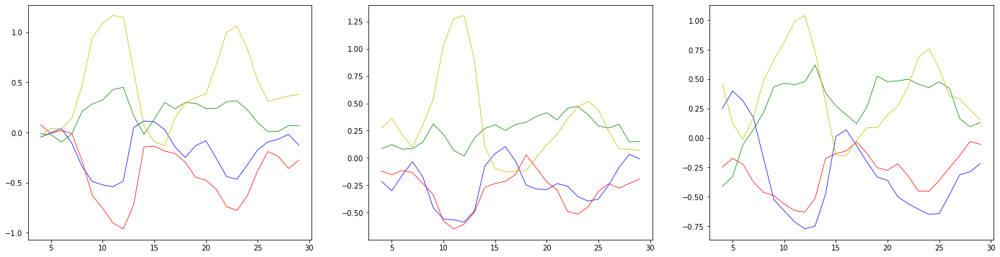

In [164]:
fig, axs = plt.subplots(1, 3, figsize=(24, 6))
axs[0].plot(freqs_1hz_inc, left_c3_psd, color='b', linewidth=.75)
axs[0].plot(freqs_1hz_inc, right_c3_psd, color='r', linewidth=.75)
axs[0].plot(freqs_1hz_inc, foot_c3_psd, color='g', linewidth=.75)
axs[0].plot(freqs_1hz_inc, tongue_c3_psd, color='y', linewidth=.75)
axs[1].plot(freqs_1hz_inc, left_cz_psd, color='b', linewidth=.75)
axs[1].plot(freqs_1hz_inc, right_cz_psd, color='r', linewidth=.75)
axs[1].plot(freqs_1hz_inc, foot_cz_psd, color='g', linewidth=.75)
axs[1].plot(freqs_1hz_inc, tongue_cz_psd, color='y', linewidth=.75)
axs[2].plot(freqs_1hz_inc, left_c4_psd, color='b', linewidth=.75)
axs[2].plot(freqs_1hz_inc, right_c4_psd, color='r', linewidth=.75)
axs[2].plot(freqs_1hz_inc, foot_c4_psd, color='g', linewidth=.75)
axs[2].plot(freqs_1hz_inc, tongue_c4_psd, color='y', linewidth=.75)

C:\Users\miles\Anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\miles\Anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\miles\Anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\miles\Anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\miles\Anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\miles\Anaconda3\lib\site-packages\pandas\core\arraylike.py:358: RuntimeWarning: invalid value encountered 

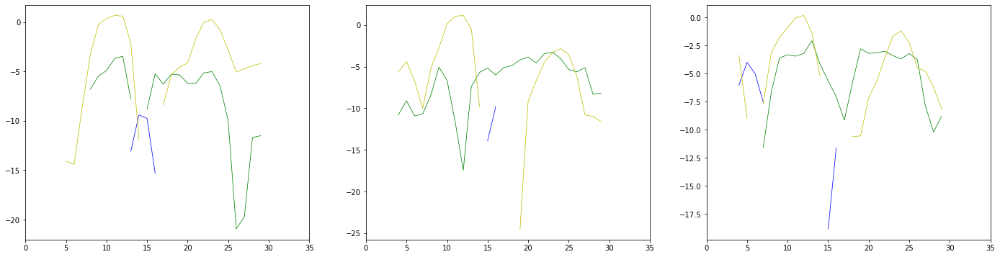

In [165]:
fig, axs = plt.subplots(1, 3, figsize=(24, 6))
axs[0].plot(freqs_1hz_inc, log_psd(left_c3_psd), color='b', linewidth=.75)
axs[0].plot(freqs_1hz_inc, log_psd(right_c3_psd), color='r', linewidth=.75)
axs[0].plot(freqs_1hz_inc, log_psd(foot_c3_psd), color='g', linewidth=.75)
axs[0].plot(freqs_1hz_inc, log_psd(tongue_c3_psd), color='y', linewidth=.75)
axs[1].plot(freqs_1hz_inc, log_psd(left_cz_psd), color='b', linewidth=.75)
axs[1].plot(freqs_1hz_inc, log_psd(right_cz_psd), color='r', linewidth=.75)
axs[1].plot(freqs_1hz_inc, log_psd(foot_cz_psd), color='g', linewidth=.75)
axs[1].plot(freqs_1hz_inc, log_psd(tongue_cz_psd), color='y', linewidth=.75)
axs[2].plot(freqs_1hz_inc, log_psd(left_c4_psd), color='b', linewidth=.75)
axs[2].plot(freqs_1hz_inc, log_psd(right_c4_psd), color='r', linewidth=.75)
axs[2].plot(freqs_1hz_inc, log_psd(foot_c4_psd), color='g', linewidth=.75)
axs[2].plot(freqs_1hz_inc, log_psd(tongue_c4_psd), color='y', linewidth=.75)

for ax in axs:
    ax.set_xlim(left=0, right=35)

#### Wow their shape is not maintained!

Their shape is completely destroyed. Normalization in the way I tried doing it is not the move for these spectrums. That explains why the logistic regressor's coefficients were so strange. Note that many values are not plotted in the log graph, because taking a log of a negative value is undefined.

#### Try feature selection on non-normalized features

In [166]:
clf = LogisticRegression()
clf.fit(X_train, y_train)

LogisticRegression()

In [167]:
sorted_features_df = pd.DataFrame({'coef': clf.coef_[1], 'feature': X_train.columns}).sort_values(by = 'coef', ascending = False).set_index('feature')
sorted_features_df.head(20)

,coef
feature,
EEG-13_4Hz,1.760242e-11
EEG-13_5Hz,1.345419e-11
EEG-13_7Hz,1.193034e-11
EEG-7_14Hz,1.060118e-11
EEG-7_15Hz,1.018224e-11
EEG-7_16Hz,9.103408e-12
EEG-13_6Hz,7.110420e-12
EEG-6_5Hz,6.302347e-12
EEG-4_7Hz,6.062587e-12


This also sucks. Could try min-max scaling as well.

### Try feature selection on min-max scaled features

In [168]:
from sklearn.preprocessing import MinMaxScaler

In [169]:
X_train

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
33,1.874923e-10,1.844196e-10,8.787869e-11,8.777859e-11,7.770641e-11,6.098390e-11,6.693801e-11,3.963040e-11,1.030721e-11,8.368240e-12,...,2.490477e-11,2.337604e-11,2.451249e-11,3.358426e-11,3.013268e-11,2.174747e-11,1.991246e-11,1.970041e-11,1.715502e-11,2.009817e-11
186,1.884545e-10,1.840589e-10,1.508426e-10,1.460186e-10,9.342703e-11,5.253867e-11,7.330870e-11,8.977228e-11,6.915053e-11,3.597230e-11,...,2.879117e-11,2.118453e-11,1.951298e-11,3.188546e-11,2.447270e-11,2.112349e-11,1.810560e-11,1.244183e-11,8.745788e-12,8.162780e-12
144,1.584691e-10,1.093366e-10,9.276250e-11,5.022645e-11,6.320311e-11,4.298587e-11,4.027509e-11,4.186263e-11,3.422099e-11,2.952519e-11,...,3.096003e-11,2.786268e-11,2.801634e-11,2.807853e-11,3.343580e-11,3.718515e-11,2.580198e-11,2.224183e-11,1.991980e-11,2.058239e-11
199,7.232276e-11,8.094841e-11,7.859471e-11,8.641585e-11,7.846077e-11,5.648015e-11,2.941492e-11,1.984648e-11,2.108265e-11,1.556850e-11,...,4.812578e-11,2.618343e-11,1.156947e-11,5.543133e-12,1.239827e-11,2.210891e-11,2.075570e-11,1.529169e-11,1.679198e-11,1.426908e-11
37,1.511970e-10,1.371752e-10,1.001444e-10,4.892101e-11,3.596526e-11,2.358621e-11,1.688615e-11,2.059103e-11,2.488555e-11,2.904417e-11,...,2.395846e-11,2.231007e-11,1.819979e-11,1.531532e-11,7.287092e-12,8.733714e-12,7.836619e-12,5.696489e-12,5.405224e-12,6.711797e-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,6.538180e-11,7.968428e-11,9.150202e-11,5.796553e-11,6.888413e-11,5.336237e-11,3.504627e-11,3.016069e-11,2.315941e-11,2.169205e-11,...,1.957711e-11,2.485019e-11,3.183802e-11,2.836910e-11,2.652670e-11,1.909031e-11,9.345490e-12,8.254590e-12,9.165257e-12,1.062376e-11
71,1.599994e-10,2.850220e-10,2.984157e-10,1.594644e-10,9.848971e-11,5.632300e-11,2.292411e-11,1.616024e-11,1.887357e-11,1.552805e-11,...,2.512909e-11,3.063276e-11,2.296247e-11,2.421218e-11,2.708549e-11,3.330570e-11,3.695973e-11,2.470348e-11,1.428353e-11,1.177392e-11
106,1.184254e-10,1.016253e-10,6.504538e-11,7.735420e-11,7.832096e-11,4.540174e-11,2.479428e-11,3.369141e-11,3.176731e-11,1.818474e-11,...,2.087055e-11,1.781813e-11,2.046381e-11,2.305287e-11,2.236760e-11,4.567610e-11,4.269583e-11,9.803900e-12,7.772957e-12,9.163276e-12
270,1.223999e-10,7.696423e-11,6.870459e-11,8.033040e-11,6.012079e-11,4.677115e-11,1.384157e-11,1.683159e-11,2.523764e-11,1.613991e-11,...,4.258872e-11,3.097938e-11,2.177057e-11,2.638819e-11,3.225566e-11,2.388062e-11,1.508911e-11,1.285692e-11,8.235795e-12,6.086641e-12


In [170]:
min_max_scaler = MinMaxScaler()
X_train_minmax = pd.DataFrame(min_max_scaler.fit_transform(X_train), columns=X_train.columns)

In [171]:
X_train_minmax

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
0,0.420573,0.370360,0.202244,0.318051,0.253680,0.216754,0.378335,0.323897,0.029998,0.045787,...,0.100274,0.168580,0.234045,0.385074,0.480927,0.398442,0.323641,0.467123,0.392284,0.578556
1,0.423354,0.369456,0.389836,0.619209,0.317201,0.175050,0.423398,0.864148,0.851732,0.519810,...,0.123704,0.142281,0.163435,0.363132,0.375403,0.384275,0.282397,0.245580,0.154537,0.176619
2,0.336708,0.182359,0.216795,0.123871,0.195078,0.127877,0.189737,0.347948,0.363948,0.409098,...,0.136779,0.222423,0.283531,0.313960,0.542510,0.748927,0.458078,0.544690,0.470450,0.594863
3,0.087779,0.111278,0.174584,0.311005,0.256728,0.194513,0.112919,0.110736,0.180474,0.169431,...,0.240264,0.202271,0.051245,0.022884,0.150287,0.406648,0.342889,0.332562,0.382020,0.382255
4,0.315694,0.252064,0.238788,0.117120,0.085020,0.032078,0.024297,0.118758,0.233581,0.400838,...,0.094569,0.155788,0.144888,0.149106,0.054994,0.102988,0.047993,0.039702,0.060092,0.127755
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,0.067722,0.108112,0.213040,0.163889,0.218033,0.179117,0.152752,0.221866,0.209476,0.274586,...,0.068156,0.186271,0.337506,0.317713,0.413697,0.338116,0.082435,0.117779,0.166396,0.259495
214,0.341130,0.622258,0.829510,0.688736,0.337657,0.193737,0.067006,0.071019,0.149625,0.168737,...,0.101627,0.255666,0.212153,0.264021,0.424115,0.660851,0.712769,0.619824,0.311101,0.298228
215,0.220997,0.163050,0.134216,0.264147,0.256163,0.139807,0.080235,0.259908,0.329683,0.214358,...,0.075954,0.101881,0.176864,0.249047,0.336155,0.941699,0.843704,0.165067,0.127033,0.210312
216,0.232482,0.101302,0.145118,0.279537,0.182624,0.146569,0.002762,0.078252,0.238498,0.179244,...,0.206883,0.259826,0.195319,0.292127,0.520508,0.446871,0.213541,0.258249,0.140119,0.106703


In [172]:
X_train_minmax.describe()

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
count,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,...,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000,218.000000
mean,0.265916,0.230933,0.271410,0.292608,0.200090,0.177299,0.211133,0.280149,0.294038,0.300161,...,0.153731,0.238158,0.269280,0.274089,0.341744,0.354501,0.262027,0.319629,0.274781,0.295155
std,0.184854,0.148157,0.143768,0.177167,0.129301,0.133732,0.135267,0.169524,0.176106,0.163918,...,0.101803,0.148850,0.173625,0.144680,0.183404,0.196394,0.164984,0.163649,0.135915,0.148954
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.131173,0.134570,0.176202,0.167751,0.114428,0.091671,0.120623,0.159190,0.172029,0.184646,...,0.090512,0.133930,0.137648,0.173140,0.206334,0.207528,0.153479,0.188643,0.174188,0.184885
50%,0.229773,0.197890,0.239579,0.265334,0.174169,0.147527,0.183853,0.254930,0.279995,0.282307,...,0.136073,0.212353,0.232911,0.252254,0.316141,0.308016,0.223607,0.290875,0.259974,0.274281
75%,0.347329,0.277416,0.339876,0.380327,0.247628,0.223450,0.280397,0.344387,0.372848,0.368068,...,0.189029,0.309497,0.350340,0.335071,0.457694,0.442131,0.346353,0.419928,0.348302,0.381820
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [173]:
# Use 1000 iterations, otherwise we get a "did not converge" warning.
clf = LogisticRegression(max_iter=1000)
clf.fit(X_train_minmax, y_train)

LogisticRegression(max_iter=1000)

In [174]:
sorted_features_df = pd.DataFrame({'coef': clf.coef_[1], 'feature': X_train.columns}).sort_values(by = 'coef', ascending = False).set_index('feature')
sorted_features_df.head(20)

,coef
feature,
EEG-14_25Hz,0.488040
EEG-C4_5Hz,0.430636
EEG-2_25Hz,0.407573
EEG-14_26Hz,0.393346
EEG-C4_7Hz,0.363650
EEG-C4_4Hz,0.363497
EEG-14_13Hz,0.345745
EEG-2_13Hz,0.342725
EEG-19_13Hz,0.331802


### The coefficient rankings may be so strange because the model is severely overfitting.

In [175]:
print('Num features: {}\nNum samples: {}'.format(X_train.shape[1], X_train.shape[0]))

Num features: 572
Num samples: 218


You want significantly more samples than features, like 20 times more. Since we have over double as many features as samples, the logistic regression model is prone to overfit. We can try to tell whether this is happening by doing cross-validation and comparing train and test scores.

In [176]:
from sklearn.model_selection import cross_validate

In [177]:
cv_results = cross_validate(clf, X_train, y_train, return_train_score=True)
cv_results

{'fit_time': array([0.02399993, 0.02600098, 0.02200127, 0.02500033, 0.02200532]),
 'score_time': array([0.01200056, 0.00699902, 0.01199961, 0.00864434, 0.00999403]),
 'test_score': array([0.27272727, 0.27272727, 0.27272727, 0.27906977, 0.25581395]),
 'train_score': array([0.27011494, 0.27011494, 0.27011494, 0.26857143, 0.27428571])}

In [178]:
cv_results = cross_validate(clf, X_train_normalized, y_train, return_train_score=True)
cv_results

{'fit_time': array([0.09782267, 0.09501266, 0.10899925, 0.09999943, 0.11000013]),
 'score_time': array([0.0120008 , 0.0099895 , 0.00899863, 0.00699973, 0.00700092]),
 'test_score': array([0.84090909, 0.81818182, 0.81818182, 0.88372093, 0.69767442]),
 'train_score': array([1., 1., 1., 1., 1.])}

In [179]:
cv_results = cross_validate(clf, X_train_minmax, y_train, return_train_score=True)
cv_results

{'fit_time': array([0.22400045, 0.2469964 , 0.28500485, 0.2069993 , 0.25299978]),
 'score_time': array([0.0129981 , 0.01200271, 0.00599623, 0.01200128, 0.0079999 ]),
 'test_score': array([0.84090909, 0.86363636, 0.77272727, 0.86046512, 0.72093023]),
 'train_score': array([1., 1., 1., 1., 1.])}

### Try doing univariate feature selection

#### Mutual information

In [180]:
from sklearn.feature_selection import mutual_info_classif

In [181]:
mi = mutual_info_classif(X_train_minmax, y_train)

In [182]:
mi.shape

(572,)

In [183]:
sorted_features_mi_df = (pd.DataFrame({'mutual_info': mi, 'feature': X_train.columns})
                            .sort_values(by = 'mutual_info', ascending = False).reset_index(drop=True))

In [184]:
pd.set_option('display.max_rows', 30)
sorted_features_mi_df.head(30)

,mutual_info,feature
0,0.642574,EEG-14_12Hz
1,0.624985,EEG-14_11Hz
2,0.593345,EEG-C3_11Hz
3,0.587757,EEG-C3_12Hz
4,0.523319,EEG-Cz_12Hz
5,0.516656,EEG-14_10Hz
6,0.497539,EEG-2_12Hz
7,0.493098,EEG-Cz_11Hz
8,0.468931,EEG-2_11Hz
9,0.463525,EEG-3_12Hz


In [185]:
sorted_features_mi_df.iloc[400:450, :]

,mutual_info,feature
400,0.004440,EEG-7_17Hz
401,0.004219,EEG-Pz_27Hz
402,0.004072,EEG-6_5Hz
403,0.003767,EEG-Fz_27Hz
404,0.003373,EEG-7_14Hz
...,...,...
445,0.000000,EEG-5_28Hz
446,0.000000,EEG-Fz_23Hz
447,0.000000,EEG-5_29Hz
448,0.000000,EEG-Fz_22Hz


#### Chi Square

In [186]:
from sklearn.feature_selection import chi2

In [187]:
chi_scores, p_values = chi2(X_train_minmax, y_train)

In [188]:
sorted_features_chi2_df = (pd.DataFrame({'chi2_stat': chi_scores, 'p': p_values, 'feature': X_train.columns})
                            .sort_values(by = 'chi2_stat', ascending = False).reset_index(drop=True))

In [189]:
sorted_features_chi2_df.head(30)

,chi2_stat,p,feature
0,35.513221,9.490458e-08,EEG-C3_11Hz
1,33.920780,2.058965e-07,EEG-14_11Hz
2,30.791710,9.403636e-07,EEG-C4_11Hz
3,30.739848,9.643021e-07,EEG-C4_12Hz
4,28.908704,2.340562e-06,EEG-C3_12Hz
5,27.206335,5.329152e-06,EEG-14_12Hz
6,26.591394,7.170669e-06,EEG-3_11Hz
7,24.901936,1.618690e-05,EEG-14_10Hz
8,23.172842,3.716782e-05,EEG-19_11Hz
9,22.809567,4.424717e-05,EEG-Cz_11Hz


#### ANOVA F-values

In [190]:
from sklearn.feature_selection import f_classif

In [191]:
f_stats, p_values = f_classif(X_train_minmax, y_train)

In [192]:
sorted_features_f_df = (pd.DataFrame({'f_stat': f_stats, 'p': p_values, 'feature': X_train.columns})
                        .sort_values(by = 'f_stat', ascending = False).reset_index(drop=True))

In [193]:
sorted_features_f_df.head(30)

,f_stat,p,feature
0,143.555414,5.463857e-51,EEG-C3_12Hz
1,142.128747,1.112580e-50,EEG-14_11Hz
2,136.710247,1.731093e-49,EEG-C3_11Hz
3,117.640657,4.945816e-45,EEG-14_12Hz
4,105.121358,7.414763e-42,EEG-3_11Hz
5,99.499917,2.343020e-40,EEG-Cz_12Hz
6,97.648332,7.490351e-40,EEG-19_11Hz
7,96.475075,1.574621e-39,EEG-Cz_11Hz
8,95.375965,3.173206e-39,EEG-2_11Hz
9,92.774848,1.697137e-38,EEG-C4_12Hz


### Random forest feature importance

In [194]:
from sklearn.ensemble import RandomForestClassifier

In [195]:
forest = RandomForestClassifier()

In [196]:
forest.fit(X_train_minmax, y_train)

RandomForestClassifier()

In [197]:
sorted_features_impurity_df = (pd.DataFrame({'impurity_importance': forest.feature_importances_, 'feature': X_train.columns})
                                .sort_values(by = 'impurity_importance', ascending = False).reset_index(drop=True))

In [198]:
sorted_features_impurity_df.head(30)

,impurity_importance,feature
0,0.025603,EEG-C4_12Hz
1,0.023373,EEG-14_10Hz
2,0.021385,EEG-C3_12Hz
3,0.021014,EEG-14_11Hz
4,0.020073,EEG-2_11Hz
5,0.017454,EEG-14_12Hz
6,0.016630,EEG-3_11Hz
7,0.015556,EEG-2_12Hz
8,0.014489,EEG-C3_11Hz
9,0.013683,EEG-18_12Hz


### Make a table comparing feature importance rankings across the techniques

In [199]:
sorted_features_impurity_df.index[sorted_features_impurity_df['feature'] == 'EEG-C3_12Hz'].tolist()[0]

2

In [200]:
feature_ranking_df = []
for feature_name in X_train.columns:
    feature_ranking_entry = {'feature': feature_name}
    rank_mi = sorted_features_mi_df.index[sorted_features_mi_df['feature'] == feature_name].tolist()[0]
    rank_chi2 = sorted_features_chi2_df.index[sorted_features_chi2_df['feature'] == feature_name].tolist()[0]
    rank_f = sorted_features_f_df.index[sorted_features_f_df['feature'] == feature_name].tolist()[0]
    rank_forest = sorted_features_impurity_df.index[sorted_features_impurity_df['feature'] == feature_name].tolist()[0]
    avg_rank = (rank_mi + rank_chi2 + rank_f + rank_forest) / 4
    feature_ranking_entry['rank_mi'] = rank_mi
    feature_ranking_entry['rank_chi2'] = rank_chi2
    feature_ranking_entry['rank_f'] = rank_f
    feature_ranking_entry['rank_forest'] = rank_forest
    feature_ranking_entry['avg_rank'] = avg_rank
    feature_ranking_df.append(feature_ranking_entry)
feature_ranking_df = pd.DataFrame(feature_ranking_df).sort_values(by = 'avg_rank', ascending = True).set_index('feature')

In [201]:
feature_ranking_df.head(30)

,rank_mi,rank_chi2,rank_f,rank_forest,avg_rank
feature,,,,,
EEG-14_11Hz,1,1,1,3,1.50
EEG-C3_12Hz,3,4,0,2,2.25
EEG-C3_11Hz,2,0,2,8,3.00
EEG-14_12Hz,0,5,3,5,3.25
EEG-C4_12Hz,10,3,9,0,5.50
EEG-14_10Hz,5,7,11,1,6.00
EEG-3_11Hz,12,6,4,6,7.00
EEG-2_11Hz,8,11,8,4,7.75
EEG-2_12Hz,6,10,10,7,8.25


### Plot chi2 feature importance for each frequency band in important EEG channels

In [202]:
import re

In [203]:
channel_to_num_appearances_in_top_30 = {}
for index, row in feature_ranking_df.head(30).iterrows():
    channel = re.search(r'EEG-(.{1,2})_\d+Hz', index).group(1)
    channel_to_num_appearances_in_top_30[channel] = (channel_to_num_appearances_in_top_30.get(channel) or 0) + 1

In [204]:
channel_to_num_appearances_in_top_30

{'14': 3,
 'C3': 4,
 'C4': 4,
 '3': 2,
 '2': 3,
 'Cz': 2,
 '19': 2,
 '18': 3,
 '9': 2,
 '7': 1,
 '11': 2,
 '5': 1,
 '17': 1}

In [205]:
feature_names = ['EEG-C3_{}Hz'.format(i) for i in range(4, 30)]
feature_names

['EEG-C3_4Hz',
 'EEG-C3_5Hz',
 'EEG-C3_6Hz',
 'EEG-C3_7Hz',
 'EEG-C3_8Hz',
 'EEG-C3_9Hz',
 'EEG-C3_10Hz',
 'EEG-C3_11Hz',
 'EEG-C3_12Hz',
 'EEG-C3_13Hz',
 'EEG-C3_14Hz',
 'EEG-C3_15Hz',
 'EEG-C3_16Hz',
 'EEG-C3_17Hz',
 'EEG-C3_18Hz',
 'EEG-C3_19Hz',
 'EEG-C3_20Hz',
 'EEG-C3_21Hz',
 'EEG-C3_22Hz',
 'EEG-C3_23Hz',
 'EEG-C3_24Hz',
 'EEG-C3_25Hz',
 'EEG-C3_26Hz',
 'EEG-C3_27Hz',
 'EEG-C3_28Hz',
 'EEG-C3_29Hz']

In [206]:
sorted_features_chi2_df.loc[sorted_features_chi2_df['feature'] == 'EEG-C3_4Hz']['chi2_stat'].tolist()[0]

0.04008454341592381

In [207]:
feature_names

['EEG-C3_4Hz',
 'EEG-C3_5Hz',
 'EEG-C3_6Hz',
 'EEG-C3_7Hz',
 'EEG-C3_8Hz',
 'EEG-C3_9Hz',
 'EEG-C3_10Hz',
 'EEG-C3_11Hz',
 'EEG-C3_12Hz',
 'EEG-C3_13Hz',
 'EEG-C3_14Hz',
 'EEG-C3_15Hz',
 'EEG-C3_16Hz',
 'EEG-C3_17Hz',
 'EEG-C3_18Hz',
 'EEG-C3_19Hz',
 'EEG-C3_20Hz',
 'EEG-C3_21Hz',
 'EEG-C3_22Hz',
 'EEG-C3_23Hz',
 'EEG-C3_24Hz',
 'EEG-C3_25Hz',
 'EEG-C3_26Hz',
 'EEG-C3_27Hz',
 'EEG-C3_28Hz',
 'EEG-C3_29Hz']

In [208]:
channel_p_vals = [sorted_features_chi2_df.loc[sorted_features_chi2_df['feature'] == feature]['chi2_stat'].tolist()[0] for feature in feature_names]
channel_p_vals

[0.04008454341592381,
 0.008548404030487596,
 0.08114644325777601,
 0.14136264152215258,
 1.991712333441888,
 12.579601480153375,
 19.670141722640743,
 35.51322088623097,
 28.908704230778596,
 6.7562004066790475,
 0.22120941879731804,
 0.22218399929281765,
 0.9311818207081193,
 0.9474047082418107,
 1.9349900366365484,
 2.293291549895662,
 2.390614382798501,
 5.412605367981046,
 13.240203943976404,
 17.005531742533506,
 7.623375585447505,
 1.741019687511106,
 0.4497051050126548,
 0.7133980297323812,
 1.8168414127572603,
 1.434321989188522]

<BarContainer object of 26 artists>

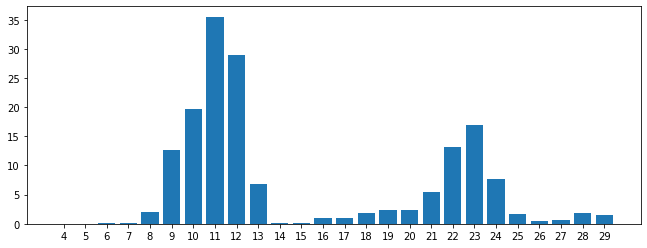

In [209]:
fig, ax = plt.subplots(figsize=(11, 4))
ax.bar(list(map(str, freqs_1hz_inc)), channel_p_vals)

In [210]:
channels_of_interest = ['C3', 'C4', 'Cz', '9', '11', '2', '14', '3', '5', '15', '17', '19']

In [211]:
import math

In [212]:
def plot_channel_band_importances():
    num_grid_cols = 2
    num_grid_rows = math.ceil(len(channels_of_interest) / num_grid_cols)
    fig, axs = plt.subplots(num_grid_rows, num_grid_cols, figsize=(24, 30))

    for i in range(len(channels_of_interest)):
        ax_i = i // 2
        ax_j = i % 2
        ch_name = channels_of_interest[i]
        freqs_1hz_inc_str = list(map(str, freqs_1hz_inc))
        feature_names = ['EEG-{}_{}Hz'.format(ch_name, f) for f in freqs_1hz_inc_str]
        channel_p_vals = [sorted_features_chi2_df.loc[sorted_features_chi2_df['feature'] == feature]['chi2_stat'].tolist()[0] for feature in feature_names]
        axs[ax_i, ax_j].bar(freqs_1hz_inc_str, channel_p_vals)
        axs[ax_i, ax_j].set_title(ch_name)
        axs[ax_i, ax_j].set_ylim(top=sorted_features_chi2_df['chi2_stat'].max() + 2)
    fig.subplots_adjust(wspace=0.05)
        

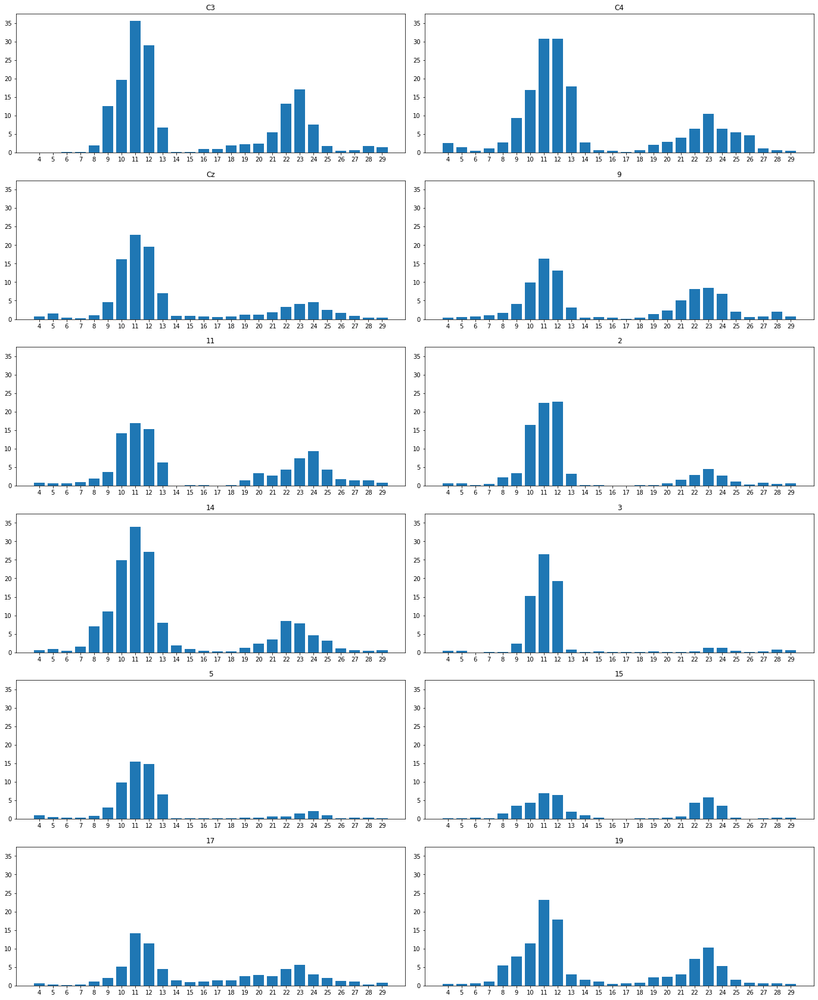

In [213]:
plot_channel_band_importances()

### 3 things to try
1. Train models with top 500, 100, 10 most useful 1Hz bin features
2. Normalize across rows rather than columns (i.e. each feature is the proportion of power in that band in that trial) and run it through the same pipeline
3. Define alpha and beta bands and use the average alpha/beta band power from selected channels as features

### 1Hz band width features, column normalization

In [214]:
X_train

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
33,1.874923e-10,1.844196e-10,8.787869e-11,8.777859e-11,7.770641e-11,6.098390e-11,6.693801e-11,3.963040e-11,1.030721e-11,8.368240e-12,...,2.490477e-11,2.337604e-11,2.451249e-11,3.358426e-11,3.013268e-11,2.174747e-11,1.991246e-11,1.970041e-11,1.715502e-11,2.009817e-11
186,1.884545e-10,1.840589e-10,1.508426e-10,1.460186e-10,9.342703e-11,5.253867e-11,7.330870e-11,8.977228e-11,6.915053e-11,3.597230e-11,...,2.879117e-11,2.118453e-11,1.951298e-11,3.188546e-11,2.447270e-11,2.112349e-11,1.810560e-11,1.244183e-11,8.745788e-12,8.162780e-12
144,1.584691e-10,1.093366e-10,9.276250e-11,5.022645e-11,6.320311e-11,4.298587e-11,4.027509e-11,4.186263e-11,3.422099e-11,2.952519e-11,...,3.096003e-11,2.786268e-11,2.801634e-11,2.807853e-11,3.343580e-11,3.718515e-11,2.580198e-11,2.224183e-11,1.991980e-11,2.058239e-11
199,7.232276e-11,8.094841e-11,7.859471e-11,8.641585e-11,7.846077e-11,5.648015e-11,2.941492e-11,1.984648e-11,2.108265e-11,1.556850e-11,...,4.812578e-11,2.618343e-11,1.156947e-11,5.543133e-12,1.239827e-11,2.210891e-11,2.075570e-11,1.529169e-11,1.679198e-11,1.426908e-11
37,1.511970e-10,1.371752e-10,1.001444e-10,4.892101e-11,3.596526e-11,2.358621e-11,1.688615e-11,2.059103e-11,2.488555e-11,2.904417e-11,...,2.395846e-11,2.231007e-11,1.819979e-11,1.531532e-11,7.287092e-12,8.733714e-12,7.836619e-12,5.696489e-12,5.405224e-12,6.711797e-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,6.538180e-11,7.968428e-11,9.150202e-11,5.796553e-11,6.888413e-11,5.336237e-11,3.504627e-11,3.016069e-11,2.315941e-11,2.169205e-11,...,1.957711e-11,2.485019e-11,3.183802e-11,2.836910e-11,2.652670e-11,1.909031e-11,9.345490e-12,8.254590e-12,9.165257e-12,1.062376e-11
71,1.599994e-10,2.850220e-10,2.984157e-10,1.594644e-10,9.848971e-11,5.632300e-11,2.292411e-11,1.616024e-11,1.887357e-11,1.552805e-11,...,2.512909e-11,3.063276e-11,2.296247e-11,2.421218e-11,2.708549e-11,3.330570e-11,3.695973e-11,2.470348e-11,1.428353e-11,1.177392e-11
106,1.184254e-10,1.016253e-10,6.504538e-11,7.735420e-11,7.832096e-11,4.540174e-11,2.479428e-11,3.369141e-11,3.176731e-11,1.818474e-11,...,2.087055e-11,1.781813e-11,2.046381e-11,2.305287e-11,2.236760e-11,4.567610e-11,4.269583e-11,9.803900e-12,7.772957e-12,9.163276e-12
270,1.223999e-10,7.696423e-11,6.870459e-11,8.033040e-11,6.012079e-11,4.677115e-11,1.384157e-11,1.683159e-11,2.523764e-11,1.613991e-11,...,4.258872e-11,3.097938e-11,2.177057e-11,2.638819e-11,3.225566e-11,2.388062e-11,1.508911e-11,1.285692e-11,8.235795e-12,6.086641e-12


In [215]:
y_train

array([0, 3, 3, 2, 1, 1, 0, 0, 1, 3, 3, 2, 0, 3, 0, 0, 1, 3, 2, 0, 2, 0,
       3, 2, 3, 2, 0, 3, 0, 2, 3, 0, 2, 1, 1, 3, 3, 1, 1, 2, 2, 0, 2, 3,
       2, 1, 1, 2, 2, 3, 0, 1, 1, 1, 2, 1, 2, 0, 2, 3, 2, 2, 0, 0, 3, 1,
       2, 1, 2, 0, 3, 1, 2, 1, 3, 3, 1, 3, 1, 1, 0, 2, 2, 2, 1, 1, 2, 0,
       0, 2, 3, 0, 2, 2, 0, 3, 0, 3, 2, 3, 1, 1, 1, 2, 3, 3, 1, 0, 0, 1,
       2, 3, 0, 0, 3, 2, 0, 0, 0, 2, 3, 3, 0, 2, 2, 0, 2, 3, 1, 3, 1, 3,
       2, 2, 1, 1, 0, 3, 2, 3, 1, 0, 2, 1, 1, 3, 2, 0, 0, 2, 2, 0, 2, 3,
       0, 0, 3, 1, 3, 2, 3, 0, 3, 0, 0, 1, 2, 3, 2, 1, 0, 1, 3, 0, 2, 1,
       2, 1, 1, 1, 1, 0, 0, 1, 2, 2, 0, 2, 2, 1, 3, 1, 0, 0, 3, 0, 3, 1,
       3, 1, 3, 2, 2, 1, 0, 0, 3, 3, 2, 1, 1, 2, 2, 1, 1, 3, 0, 0])

In [216]:
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV

In [217]:
model_params = {
    'svm': {
        'model': LinearSVC(dual=False),
        'hyperparams': {
            'C': [1e-4, 1, 30]
        }
    },
    'random_forest': {
        'model': RandomForestClassifier(),
        'hyperparams': {
            'n_estimators': [100, 200, 300],
        }
    },
    'knn': {
        'model': KNeighborsClassifier(),
        'hyperparams': {
            'n_neighbors': [1, 5, 15],
            'weights': ['uniform', 'distance']
        }
    },
    'lda': {
        'model': LinearDiscriminantAnalysis(),
        'hyperparams': {}
    },
    'xgboost': {
        'model': XGBClassifier(),
        'hyperparams': {
            'max_depth': [3, 5, 6],
            'n_estimators': [50, 100, 300]
        }
    }
}

In [218]:
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectKBest

#### Why can't we use StandardScaler?
I realized that including StandardScaler in the pipeline causes the train/test scores of all folds to be NaN, I wonder why that's happening.

In [219]:
X_train.describe()

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
count,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,...,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02
mean,1.339703e-10,1.287360e-10,1.110937e-10,8.285821e-11,6.444359e-11,5.299413e-11,4.329989e-11,3.557011e-11,2.921477e-11,2.318139e-11,...,3.377197e-11,2.917379e-11,2.700733e-11,2.499168e-11,2.266739e-11,1.981202e-11,1.721321e-11,1.486794e-11,1.299889e-11,1.168267e-11
std,6.397200e-11,5.917053e-11,4.825461e-11,3.426186e-11,3.200036e-11,2.708138e-11,1.912327e-11,1.573386e-11,1.261073e-11,9.545543e-12,...,1.688680e-11,1.240337e-11,1.229342e-11,1.120123e-11,9.837195e-12,8.650507e-12,7.227758e-12,5.361764e-12,4.807382e-12,4.423130e-12
min,4.194521e-11,3.650678e-11,1.999688e-11,2.627146e-11,1.492378e-11,1.709023e-11,1.345114e-11,9.568827e-12,8.159109e-12,5.701895e-12,...,8.271539e-12,9.328548e-12,7.941096e-12,3.771423e-12,4.337384e-12,4.197464e-12,5.734088e-12,4.395686e-12,3.279726e-12,2.918142e-12
25%,8.734000e-11,9.025080e-11,7.913774e-11,5.871237e-11,4.324331e-11,3.565410e-11,3.050416e-11,2.434357e-11,2.047789e-11,1.645448e-11,...,2.328534e-11,2.048873e-11,1.768721e-11,1.717610e-11,1.540443e-11,1.333836e-11,1.245782e-11,1.057634e-11,9.440831e-12,8.408240e-12
50%,1.214622e-10,1.155395e-10,1.004098e-10,7.758371e-11,5.802830e-11,4.696519e-11,3.944317e-11,3.322947e-11,2.820922e-11,2.214169e-11,...,3.084301e-11,2.702356e-11,2.443218e-11,2.330117e-11,2.129414e-11,1.776452e-11,1.553006e-11,1.392588e-11,1.247513e-11,1.106281e-11
75%,1.621449e-10,1.473002e-10,1.340738e-10,9.982187e-11,7.620867e-11,6.234004e-11,5.309201e-11,4.153216e-11,3.485831e-11,2.713587e-11,...,3.962713e-11,3.511837e-11,3.274667e-11,2.971291e-11,2.888656e-11,2.367183e-11,2.090743e-11,1.815413e-11,1.559936e-11,1.425615e-11
max,3.880134e-10,4.358832e-10,3.556394e-10,2.196588e-10,2.624111e-10,2.195951e-10,1.548254e-10,1.023810e-10,7.976784e-11,6.393554e-11,...,1.741488e-10,9.265673e-11,7.874546e-11,8.119239e-11,5.797399e-11,4.824407e-11,4.954301e-11,3.715951e-11,3.865026e-11,3.261281e-11


In [220]:
X_train_standard_scaled = pd.DataFrame(StandardScaler().fit_transform(X_train), columns=X_train.columns)

In [221]:
X_train_standard_scaled.describe()

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
count,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,...,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02
mean,5.321941e-17,3.109134e-16,-2.075302e-16,-3.172793e-16,1.201893e-16,5.856681e-17,2.393600e-16,-1.359769e-16,6.213175e-17,-4.565665e-16,...,7.741005e-17,-3.564936e-18,2.851949e-16,2.801021e-16,3.605678e-16,-3.055660e-16,-1.260460e-16,-7.129873e-17,-1.359769e-16,2.464899e-16
std,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,...,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00,1.002301e+00
min,-1.441833e+00,-1.562290e+00,-1.892182e+00,-1.655397e+00,-1.551038e+00,-1.328830e+00,-1.564453e+00,-1.656372e+00,-1.673505e+00,-1.835383e+00,...,-1.513556e+00,-1.603670e+00,-1.554499e+00,-1.898818e+00,-1.867625e+00,-1.809200e+00,-1.591855e+00,-1.957632e+00,-2.026370e+00,-1.986083e+00
25%,-7.305954e-01,-6.519090e-01,-6.637612e-01,-7.063659e-01,-6.640263e-01,-6.417674e-01,-6.706583e-01,-7.151698e-01,-6.944075e-01,-7.063387e-01,...,-6.224248e-01,-7.018298e-01,-7.598833e-01,-6.993493e-01,-7.400151e-01,-7.500781e-01,-6.594487e-01,-8.022516e-01,-7.418279e-01,-7.420011e-01
50%,-1.959751e-01,-2.235394e-01,-2.219181e-01,-1.543008e-01,-2.009369e-01,-2.231355e-01,-2.021413e-01,-1.491069e-01,-7.992150e-02,-1.091707e-01,...,-1.738462e-01,-1.737577e-01,-2.099554e-01,-1.512693e-01,-1.399192e-01,-2.372365e-01,-2.334090e-01,-1.761052e-01,-1.091999e-01,-1.404630e-01
75%,4.414336e-01,3.144616e-01,4.773214e-01,4.962576e-01,3.685007e-01,3.458987e-01,5.132310e-01,3.798034e-01,4.485491e-01,4.152281e-01,...,3.475277e-01,4.803738e-01,4.679377e-01,4.224622e-01,6.336648e-01,4.472217e-01,5.122920e-01,6.143041e-01,5.421775e-01,5.831629e-01
max,3.980300e+00,5.202827e+00,5.079483e+00,4.001986e+00,6.200653e+00,6.166024e+00,5.845348e+00,4.256087e+00,4.017960e+00,4.279269e+00,...,8.331941e+00,5.129979e+00,4.218289e+00,5.028918e+00,3.597353e+00,3.294313e+00,4.483300e+00,4.167074e+00,5.348109e+00,4.742866e+00


In [222]:
select_k_best = SelectKBest(score_func=chi2, k=10)
select_k_best.fit_transform(X_train_standard_scaled, y_train)

ValueError: Input X must be non-negative.

Aha! It's failing because the [chi2 test doesn't work on negative values](https://stackoverflow.com/questions/25792012/feature-selection-using-scikit-learn).

In [223]:
cv_results = []
for model_name, mp in model_params.items():
    clf_pipeline = Pipeline([('scaler', None), ('feature_selector', SelectKBest(score_func=chi2)), ('classifier', mp['model'])])
    hyperparams_pipeline = {'classifier__{}'.format(param_name): mp['hyperparams'][param_name] for param_name in mp['hyperparams']}
    hyperparams_pipeline['scaler'] = [None, MinMaxScaler()]
    hyperparams_pipeline['feature_selector__k'] = ['all', 100, 20, 5]
    clf = GridSearchCV(clf_pipeline, hyperparams_pipeline, verbose=2, return_train_score=True)
    print('Grid searching for {}'.format(model_name))
    clf.fit(X_train, y_train)
    cv_results.append({
        'model': model_name,
        'results': clf.cv_results_
    })

Grid searching for svm
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=100, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=100, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=100, scaler=None ......
[CV]  classifier__C=0.0001, 

[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=MinMaxScaler() ..
[CV]  classifier__C=1, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=MinMaxScaler() ..
[CV]  classifier__C=1, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=MinMaxScaler() ..
[CV]  classifier__C=1, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feat

[Parallel(n_jobs=1)]: Done 120 out of 120 | elapsed:    6.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s


[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.5s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.4s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=

[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.5s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.5s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.5s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.5s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.5s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=MinMaxScaler() 
[CV]

[CV]  classifier__n_estimators=300, feature_selector__k=100, scaler=MinMaxScaler(), total=   0.7s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.6s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.6s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.6s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.6s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.6s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__n_estim

[Parallel(n_jobs=1)]: Done 120 out of 120 | elapsed:  1.3min finished


Grid searching for knn
Fitting 5 folds for each of 48 candidates, totalling 240 fits
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s



[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=MinMaxScaler(), total= 

[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighb

[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=Mi

[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinM

[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neig

[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifie

[Parallel(n_jobs=1)]: Done 240 out of 240 | elapsed:   18.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=None ............................
[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=None ............................
[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=None ............................
[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=None ............................
[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=MinMaxScaler() ..................
[CV] ... feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] feature_selector__k=all, scaler=MinMaxScaler() ..................
[CV] ... feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] feature_selector__k=all, scaler=MinMaxScaler() ..................
[CV] .

[Parallel(n_jobs=1)]: Done  40 out of  40 | elapsed:    2.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   1.4s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s remaining:    0.0s


[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.7s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.7s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.7s
[CV] classifier__max_depth=3, cl

[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.7s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.8s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.8s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.7s
[CV] classifier__max_depth=3, classi

[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=all, scaler=None, total=   1.2s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=all, scaler=None, total=   1.2s
[CV

[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=M

[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] class

[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=5, classifier_

[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.6s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estima

[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier

[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20,

[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.5s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.5s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler(), total=

[Parallel(n_jobs=1)]: Done 360 out of 360 | elapsed:  3.0min finished


In [224]:
common_interesting_columns = ['param_feature_selector__k', 'param_scaler', 'rank_test_score', 'mean_test_score', 'mean_train_score']
pd.set_option('display.max_rows', 100)

##### SVM

In [225]:
interesting_columns = ['param_classifier__C'] + common_interesting_columns
svm_cv_summary = pd.DataFrame(cv_results[0]['results'])[interesting_columns].sort_values('rank_test_score')
svm_cv_summary

,param_classifier__C,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
11,1,100,MinMaxScaler(),1,0.816596,0.983947
17,30,all,MinMaxScaler(),2,0.789006,1.000000
9,1,all,MinMaxScaler(),3,0.779704,1.000000
21,30,20,MinMaxScaler(),4,0.770402,0.864683
19,30,100,MinMaxScaler(),5,0.766279,1.000000
13,1,20,MinMaxScaler(),6,0.761205,0.817649
23,30,5,MinMaxScaler(),7,0.701480,0.715586
15,1,5,MinMaxScaler(),8,0.692283,0.702962
7,0.0001,5,MinMaxScaler(),9,0.454440,0.470167
1,0.0001,all,MinMaxScaler(),10,0.380867,0.447179


##### Random Forest

In [226]:
interesting_columns = ['param_classifier__n_estimators'] + common_interesting_columns
rf_cv_summary = pd.DataFrame(cv_results[1]['results'])[interesting_columns].sort_values('rank_test_score')
rf_cv_summary

,param_classifier__n_estimators,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
11,200,100,MinMaxScaler(),1,0.793446,1.00000
3,100,100,MinMaxScaler(),2,0.789112,1.00000
19,300,100,MinMaxScaler(),3,0.788901,1.00000
17,300,all,MinMaxScaler(),4,0.784249,1.00000
13,200,20,MinMaxScaler(),5,0.765856,1.00000
5,100,20,MinMaxScaler(),6,0.761311,1.00000
1,100,all,MinMaxScaler(),7,0.752431,1.00000
21,300,20,MinMaxScaler(),8,0.747463,1.00000
9,200,all,MinMaxScaler(),8,0.747463,1.00000
15,200,5,MinMaxScaler(),10,0.701268,1.00000


##### KNN

In [227]:
interesting_columns = ['param_classifier__n_neighbors', 'param_classifier__weights'] + common_interesting_columns
knn_cv_summary = pd.DataFrame(cv_results[2]['results'])[interesting_columns].sort_values('rank_test_score')
knn_cv_summary

,param_classifier__n_neighbors,param_classifier__weights,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
27,5,distance,100,MinMaxScaler(),1,0.743235,1.000000
19,5,uniform,100,MinMaxScaler(),2,0.734038,0.810791
35,15,uniform,100,MinMaxScaler(),3,0.733615,0.747711
43,15,distance,100,MinMaxScaler(),4,0.729175,1.000000
45,15,distance,20,MinMaxScaler(),5,0.710677,1.000000
39,15,uniform,5,MinMaxScaler(),6,0.706131,0.731645
37,15,uniform,20,MinMaxScaler(),7,0.705920,0.738522
46,15,distance,5,None,8,0.702114,1.000000
47,15,distance,5,MinMaxScaler(),9,0.696829,1.000000
22,5,uniform,5,None,10,0.692706,0.783278


##### LDA

In [228]:
interesting_columns = common_interesting_columns
lda_cv_summary = pd.DataFrame(cv_results[3]['results'])[interesting_columns].sort_values('rank_test_score')
lda_cv_summary

,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
7,5,MinMaxScaler(),1,0.697252,0.700677
5,20,MinMaxScaler(),2,0.696829,0.816486
0,all,None,3,0.660254,0.957563
1,all,MinMaxScaler(),3,0.660254,0.957563
4,20,None,5,0.646406,0.784401
2,100,None,6,0.637526,0.980512
6,5,None,7,0.637104,0.674312
3,100,MinMaxScaler(),8,0.614905,0.980486


##### XGBoost

In [229]:
interesting_columns = ['param_classifier__max_depth', 'param_classifier__n_estimators'] + common_interesting_columns
xgb_cv_summary = pd.DataFrame(cv_results[4]['results'])[interesting_columns].sort_values('rank_test_score')
xgb_cv_summary

,param_classifier__max_depth,param_classifier__n_estimators,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
41,5,300,all,MinMaxScaler(),1,0.802643,1.0
40,5,300,all,None,1,0.802643,1.0
32,5,100,all,None,1,0.802643,1.0
33,5,100,all,MinMaxScaler(),1,0.802643,1.0
24,5,50,all,None,5,0.793552,1.0
51,6,50,100,MinMaxScaler(),5,0.793552,1.0
25,5,50,all,MinMaxScaler(),5,0.793552,1.0
0,3,50,all,None,8,0.789006,1.0
1,3,50,all,MinMaxScaler(),8,0.789006,1.0
19,3,300,100,MinMaxScaler(),10,0.788901,1.0


##### Classifier comparison

In [230]:
svm_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,9.750000,0.443010,0.488526
std,5.358861,0.234115,0.300400
min,1.000000,0.234038,0.233951
25%,6.750000,0.270613,0.270640
50%,11.000000,0.270613,0.270640
75%,11.000000,0.716411,0.741102
max,24.000000,0.816596,1.000000


In [231]:
rf_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,9.708333,0.510386,0.635320
std,4.164855,0.246459,0.372523
min,1.000000,0.270613,0.270640
25%,6.750000,0.270613,0.270640
50%,12.500000,0.476850,0.635320
75%,13.000000,0.754651,1.000000
max,13.000000,0.793446,1.000000


In [232]:
knn_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,24.270833,0.660166,0.915808
std,13.874421,0.043171,0.122702
min,1.000000,0.578330,0.676598
25%,12.750000,0.626929,0.781563
50%,24.500000,0.662579,1.000000
75%,36.250000,0.688081,1.000000
max,47.000000,0.743235,1.000000


In [233]:
lda_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,4.375000,0.656316,0.856500
std,2.503569,0.028991,0.128426
min,1.000000,0.614905,0.674312
25%,2.750000,0.637421,0.763470
50%,4.000000,0.653330,0.887025
75%,6.250000,0.669397,0.963294
max,8.000000,0.697252,0.980512


In [234]:
xgb_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,35.847222,0.748439,1.0
std,21.232887,0.036532,0.0
min,1.000000,0.673784,1.0
25%,18.000000,0.720058,1.0
50%,36.000000,0.752326,1.0
75%,52.750000,0.784249,1.0
max,72.000000,0.802643,1.0


I think our best classifier out of the above is an SVM with `C = 1` that uses the 20 best features. It has a train accuracy of 81.8% and a test accuracy of **76.1%**.

In [235]:
def calc_information_transfer_rate(n_classes=2, accuracy=0.5):
    error = 1 - accuracy
    return math.log2(n_classes) + accuracy * math.log2(accuracy) + error * math.log2(error / (n_classes - 1))

In [236]:
svm_itr = calc_information_transfer_rate(n_classes=4, accuracy=.761)
print('The SVM model has an information transfer rate (ITR) of {:0.2f} bits per trial.'.format(svm_itr))

The SVM model has an information transfer rate (ITR) of 0.83 bits per trial.


#### 1Hz band width features, row normalization
It fields weird to be applying normalization per frequency band. Let's instead try normalizing band powers within each trial.

In [237]:
psds.shape

(273, 22, 91)

In [238]:
candidate_features_df = []
for i in range(len(psds)):
    num_electrodes = psds.shape[1]
    features_dict = {}
    for j in range(num_electrodes):
        freqs_binned, psd_binned = bin_power_spectrum_1hz(psds[i][j], freqs)
        psd_binned /= sum(psd_binned)
        for k in range(len(freqs_binned)):
            ch_name = raw.ch_names[j]
            freq_bin_str = str(freqs_binned[k]) + 'Hz'
            band_power = psd_binned[k]
            feature_name = '{}_{}'.format(ch_name, freq_bin_str)
            features_dict[feature_name] = band_power
    epoch_event_id = epochs.events[i][2]
    trial_label = event_id_inv[epoch_event_id]
    features_dict['target'] = trial_label
    candidate_features_df.append(features_dict)

candidate_features_df = pd.DataFrame(candidate_features_df)

In [239]:
candidate_features_df.describe()

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
count,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,...,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000
mean,0.133349,0.124911,0.107634,0.081719,0.063198,0.052013,0.043334,0.036039,0.029763,0.023904,...,0.020311,0.017669,0.016355,0.015267,0.013874,0.012163,0.010579,0.009154,0.008091,0.007260
std,0.045482,0.035217,0.033043,0.023481,0.023100,0.021960,0.017350,0.014724,0.011968,0.008877,...,0.007929,0.006712,0.006827,0.006361,0.005985,0.005208,0.004491,0.003574,0.003452,0.003143
min,0.049979,0.051212,0.029843,0.033497,0.020075,0.011224,0.012630,0.007768,0.008367,0.006542,...,0.004795,0.006598,0.004609,0.002015,0.002852,0.002760,0.002283,0.002346,0.001856,0.001739
25%,0.100259,0.101688,0.083033,0.066728,0.045278,0.035468,0.031095,0.026405,0.020964,0.017035,...,0.014422,0.012535,0.011592,0.010444,0.009347,0.008054,0.007517,0.006783,0.005642,0.005017
50%,0.125177,0.117726,0.105727,0.078788,0.061435,0.049615,0.041382,0.033066,0.028426,0.023428,...,0.019855,0.016786,0.015127,0.013956,0.012914,0.011064,0.009992,0.008695,0.007659,0.006661
75%,0.160816,0.145605,0.130844,0.097663,0.075545,0.062923,0.053160,0.043084,0.036990,0.029663,...,0.024752,0.022466,0.019355,0.018850,0.017709,0.015166,0.012851,0.010851,0.009873,0.009096
max,0.298643,0.241731,0.235585,0.171712,0.180012,0.162224,0.127462,0.112519,0.076947,0.068829,...,0.064004,0.043789,0.055786,0.040435,0.037759,0.035898,0.033556,0.021661,0.023887,0.023677


In [240]:
candidate_features_df.loc[:, candidate_features_df.columns.str.startswith('EEG-C3')]

,EEG-C3_4Hz,EEG-C3_5Hz,EEG-C3_6Hz,EEG-C3_7Hz,EEG-C3_8Hz,EEG-C3_9Hz,EEG-C3_10Hz,EEG-C3_11Hz,EEG-C3_12Hz,EEG-C3_13Hz,...,EEG-C3_20Hz,EEG-C3_21Hz,EEG-C3_22Hz,EEG-C3_23Hz,EEG-C3_24Hz,EEG-C3_25Hz,EEG-C3_26Hz,EEG-C3_27Hz,EEG-C3_28Hz,EEG-C3_29Hz
0,0.034626,0.030896,0.037588,0.035712,0.030275,0.048841,0.082059,0.121423,0.127333,0.063864,...,0.021996,0.024755,0.032699,0.051948,0.056059,0.036917,0.018857,0.012999,0.005120,0.010466
1,0.030254,0.044877,0.032868,0.030530,0.035212,0.041710,0.141774,0.228915,0.147221,0.036102,...,0.005523,0.005024,0.007331,0.010168,0.013550,0.015443,0.011342,0.008305,0.007500,0.008336
2,0.070367,0.095073,0.097091,0.057370,0.032649,0.028794,0.023639,0.028965,0.040253,0.050605,...,0.032292,0.029482,0.016861,0.016415,0.015505,0.016627,0.014032,0.014802,0.022672,0.025387
3,0.045446,0.062918,0.042590,0.033311,0.043707,0.050798,0.076331,0.173986,0.153772,0.046515,...,0.010006,0.019308,0.025426,0.018986,0.015273,0.013165,0.010357,0.011535,0.009934,0.005875
4,0.067759,0.044261,0.031824,0.023762,0.028081,0.057461,0.067716,0.179017,0.203617,0.075336,...,0.006847,0.010278,0.022529,0.028293,0.019771,0.009657,0.007541,0.006632,0.007333,0.007225
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268,0.088455,0.090023,0.075299,0.064786,0.053347,0.043221,0.048679,0.071420,0.066279,0.057160,...,0.016070,0.017508,0.018706,0.021651,0.028910,0.025608,0.017984,0.018072,0.013762,0.013845
269,0.036469,0.040411,0.042082,0.040099,0.032821,0.034013,0.053789,0.130513,0.134038,0.070761,...,0.047919,0.041453,0.018969,0.039954,0.036754,0.014619,0.012784,0.011844,0.019336,0.019019
270,0.026849,0.037804,0.051071,0.056672,0.049429,0.034998,0.059891,0.179933,0.157554,0.032076,...,0.025914,0.031242,0.028105,0.045110,0.039147,0.016922,0.014662,0.011253,0.008286,0.009627
271,0.071567,0.055688,0.058601,0.041582,0.042572,0.050265,0.051540,0.092306,0.110528,0.059905,...,0.027046,0.018177,0.020932,0.027164,0.023501,0.018931,0.018892,0.023240,0.021708,0.016518


In [241]:
candidate_features_df.loc[:, candidate_features_df.columns.str.startswith('EEG-C3')].sum(axis=1)

0      1.0
1      1.0
2      1.0
3      1.0
4      1.0
      ... 
268    1.0
269    1.0
270    1.0
271    1.0
272    1.0
Length: 273, dtype: float64

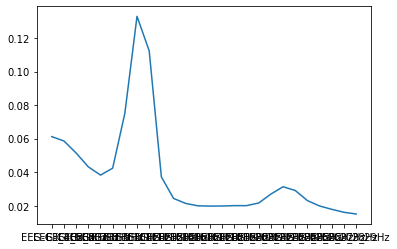

In [242]:
plt.plot(candidate_features_df.loc[:, candidate_features_df.columns.str.startswith('EEG-C3')].mean())

In [243]:
X = candidate_features_df.drop(columns=['target'])
y = candidate_features_df['target']

In [244]:
X

,EEG-Fz_4Hz,EEG-Fz_5Hz,EEG-Fz_6Hz,EEG-Fz_7Hz,EEG-Fz_8Hz,EEG-Fz_9Hz,EEG-Fz_10Hz,EEG-Fz_11Hz,EEG-Fz_12Hz,EEG-Fz_13Hz,...,EEG-22_20Hz,EEG-22_21Hz,EEG-22_22Hz,EEG-22_23Hz,EEG-22_24Hz,EEG-22_25Hz,EEG-22_26Hz,EEG-22_27Hz,EEG-22_28Hz,EEG-22_29Hz
0,0.220833,0.213487,0.145207,0.101645,0.040006,0.017100,0.019687,0.024428,0.019647,0.010257,...,0.015862,0.013127,0.015679,0.020753,0.029031,0.021740,0.012128,0.010228,0.006395,0.003812
1,0.152911,0.139295,0.123229,0.086753,0.064643,0.049732,0.027831,0.025863,0.023418,0.022657,...,0.010394,0.008608,0.008224,0.022306,0.022322,0.014802,0.017605,0.011647,0.004745,0.004983
2,0.153415,0.133803,0.089483,0.056568,0.040826,0.037137,0.034095,0.024026,0.029321,0.024372,...,0.029216,0.018609,0.013518,0.012854,0.019546,0.022632,0.022222,0.016482,0.011904,0.010060
3,0.085565,0.182246,0.186139,0.091849,0.043234,0.033614,0.033923,0.025083,0.028583,0.026895,...,0.017775,0.014681,0.016593,0.014881,0.014133,0.011573,0.006998,0.009507,0.009035,0.007282
4,0.226267,0.173047,0.102309,0.069439,0.034636,0.024542,0.028076,0.040034,0.042799,0.035121,...,0.015321,0.012608,0.013559,0.021026,0.032871,0.021693,0.010153,0.013718,0.012602,0.007713
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268,0.096772,0.140646,0.147201,0.115460,0.075015,0.050105,0.041028,0.037387,0.025665,0.025063,...,0.022075,0.016584,0.007714,0.007575,0.014736,0.012405,0.005204,0.007697,0.010434,0.010267
269,0.060409,0.081902,0.120178,0.171712,0.150788,0.062253,0.031163,0.040663,0.038812,0.024506,...,0.014756,0.013534,0.008806,0.009885,0.011286,0.007445,0.007518,0.009267,0.007205,0.004647
270,0.144266,0.090713,0.080978,0.094681,0.070861,0.055126,0.016314,0.019838,0.029746,0.019023,...,0.034049,0.024767,0.017405,0.021097,0.025788,0.019092,0.012063,0.010279,0.006584,0.004866
271,0.128613,0.106478,0.083033,0.101127,0.108474,0.068326,0.048210,0.034828,0.028530,0.028883,...,0.012687,0.015119,0.026567,0.029134,0.023397,0.016601,0.015258,0.011844,0.010300,0.010001


In [245]:
y

0      cue_tongue
1        cue_foot
2       cue_right
3        cue_left
4        cue_left
          ...    
268     cue_right
269      cue_left
270      cue_foot
271      cue_left
272     cue_right
Name: target, Length: 273, dtype: object

In [246]:
label_encoder = LabelEncoder()
label_encoder.fit(y)

LabelEncoder()

In [247]:
label_encoder.classes_

array(['cue_foot', 'cue_left', 'cue_right', 'cue_tongue'], dtype=object)

In [248]:
y = label_encoder.transform(y)
y

array([3, 0, 2, 1, 1, 2, 0, 3, 2, 0, 1, 1, 1, 3, 2, 2, 1, 1, 0, 1, 2, 3,
       0, 1, 3, 3, 2, 3, 3, 2, 1, 2, 0, 0, 0, 3, 0, 1, 3, 2, 0, 2, 0, 3,
       0, 1, 1, 1, 3, 2, 0, 1, 0, 3, 1, 0, 0, 1, 0, 2, 3, 3, 3, 1, 3, 2,
       3, 2, 1, 0, 2, 1, 0, 0, 1, 0, 3, 3, 2, 1, 2, 3, 2, 3, 0, 2, 2, 2,
       0, 1, 2, 0, 0, 3, 1, 1, 2, 3, 3, 3, 2, 1, 0, 2, 3, 1, 3, 0, 2, 3,
       3, 1, 2, 2, 0, 3, 2, 1, 1, 3, 2, 1, 0, 2, 2, 0, 1, 3, 0, 0, 0, 0,
       1, 2, 1, 2, 1, 1, 0, 0, 2, 0, 3, 1, 3, 1, 1, 2, 3, 0, 2, 3, 0, 3,
       0, 3, 2, 2, 3, 1, 2, 2, 2, 0, 3, 1, 3, 1, 0, 1, 3, 1, 0, 1, 2, 0,
       0, 3, 1, 2, 3, 2, 0, 1, 3, 2, 3, 1, 1, 0, 0, 2, 3, 2, 2, 1, 2, 3,
       3, 2, 2, 2, 2, 3, 0, 3, 1, 2, 0, 2, 1, 3, 1, 3, 1, 1, 1, 1, 0, 3,
       2, 0, 0, 0, 3, 0, 1, 0, 1, 3, 2, 3, 3, 0, 3, 3, 0, 2, 3, 0, 1, 2,
       2, 0, 2, 3, 0, 3, 2, 0, 1, 3, 1, 0, 3, 1, 0, 1, 2, 2, 1, 3, 1, 0,
       0, 1, 0, 2, 2, 1, 0, 1, 2])

In [249]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [250]:
cv_results = []
for model_name, mp in model_params.items():
    clf_pipeline = Pipeline([('scaler', None), ('feature_selector', SelectKBest(score_func=chi2)), ('classifier', mp['model'])])
    hyperparams_pipeline = {'classifier__{}'.format(param_name): mp['hyperparams'][param_name] for param_name in mp['hyperparams']}
    hyperparams_pipeline['scaler'] = [None, MinMaxScaler()]
    hyperparams_pipeline['feature_selector__k'] = ['all', 100, 20, 5]
    clf = GridSearchCV(clf_pipeline, hyperparams_pipeline, verbose=2, return_train_score=True)
    print('Grid searching for {}'.format(model_name))
    clf.fit(X_train, y_train)
    cv_results.append({
        'model': model_name,
        'results': clf.cv_results_
    })

Grid searching for svm
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=100, scaler=None ......
[CV]  classifier__C=0.00

[CV]  classifier__C=1, feature_selector__k=100, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feature_selector__k=100, scaler=MinMaxScaler() .
[CV]  classifier__C=1, feature_selector__k=100, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=20, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=20, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_sele

[CV] classifier__C=30, feature_selector__k=5, scaler=None ............
[CV]  classifier__C=30, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler() ..
[CV]  classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler() ..
[CV]  classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler() ..
[CV]  classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler() ..
[CV]  classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler() ..
[CV]  classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
Grid searching for random_forest
Fitting 5 folds for each of 24 candidates, tota

[Parallel(n_jobs=1)]: Done 120 out of 120 | elapsed:    8.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.4s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s


[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.4s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.4s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.4s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.4s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.4s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.4s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=

[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.5s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.7s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.6s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.6s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=None, total=   0.6s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=200, feature_selector__k=100, scaler=MinMaxScaler(), total=   0.6s
[CV] classifier__n_estimators=200, feature_selector__k=100, scaler=MinMaxScaler() 
[CV]

[CV]  classifier__n_estimators=300, feature_selector__k=100, scaler=MinMaxScaler(), total=   0.8s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.8s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.8s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.7s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.8s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.8s
[CV] classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__n_estim

[Parallel(n_jobs=1)]: Done 120 out of 120 | elapsed:  1.2min finished


Grid searching for knn
Fitting 5 folds for each of 48 candidates, totalling 240 fits
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=MinMaxScaler(), total=  

[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighb

[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=all, scaler=None, tot

[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=uniform, feature_selector__k=5,

[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(

[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=5, scaler=MinMaxScaler(

[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, sc

[Parallel(n_jobs=1)]: Done 240 out of 240 | elapsed:   16.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=None ............................
[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=None ............................
[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=None ............................
[CV] ............. feature_selector__k=all, scaler=None, total=   0.1s
[CV] feature_selector__k=all, scaler=MinMaxScaler() ..................
[CV] ... feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] feature_selector__k=all, scaler=MinMaxScaler() ..................
[CV] ... feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] feature_selector__k=all, scaler=MinMaxScaler() ..................
[CV] ... feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] feature_selector__k=all, scaler=MinMaxScaler() ..................
[CV] .

[Parallel(n_jobs=1)]: Done  40 out of  40 | elapsed:    2.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s


[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.6s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.6s
[CV] classifier__max_depth=3, cl

[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=all, scaler=None, t

[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.5s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScale

[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, clas

[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__max_depth=5, classifier__n_estimators=100, f

[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.5s
[CV] classifier__max_depth=5

[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total= 

[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=None, total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=20, scaler=Mi

[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.5s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.4s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=None, total=   0.4s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.4s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=20, scaler=MinMaxScaler(), total=   0.4s
[CV] classif

[Parallel(n_jobs=1)]: Done 360 out of 360 | elapsed:  3.0min finished


##### SVM

In [251]:
interesting_columns = ['param_classifier__C'] + common_interesting_columns
svm_cv_summary = pd.DataFrame(cv_results[0]['results'])[interesting_columns].sort_values('rank_test_score')
svm_cv_summary

,param_classifier__C,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
16,30,all,None,1,0.830550,1.000000
8,1,all,None,2,0.816490,0.955278
10,1,100,None,3,0.811945,0.886476
18,30,100,None,4,0.811839,0.990824
9,1,all,MinMaxScaler(),5,0.793129,1.000000
17,30,all,MinMaxScaler(),6,0.788478,1.000000
11,1,100,MinMaxScaler(),7,0.779598,0.989662
20,30,20,None,8,0.751903,0.847475
19,30,100,MinMaxScaler(),9,0.742706,1.000000
13,1,20,MinMaxScaler(),10,0.733827,0.825675


##### Random Forest

In [252]:
interesting_columns = ['param_classifier__n_estimators'] + common_interesting_columns
rf_cv_summary = pd.DataFrame(cv_results[1]['results'])[interesting_columns].sort_values('rank_test_score')
rf_cv_summary

,param_classifier__n_estimators,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
8,200,all,None,1,0.798097,1.0
16,300,all,None,2,0.793552,1.0
11,200,100,MinMaxScaler(),3,0.789006,1.0
18,300,100,None,4,0.788901,1.0
17,300,all,MinMaxScaler(),5,0.784355,1.0
9,200,all,MinMaxScaler(),6,0.779598,1.0
2,100,100,None,7,0.775159,1.0
1,100,all,MinMaxScaler(),8,0.770507,1.0
3,100,100,MinMaxScaler(),8,0.770507,1.0
10,200,100,None,8,0.770507,1.0


##### KNN

In [253]:
interesting_columns = ['param_classifier__n_neighbors', 'param_classifier__weights'] + common_interesting_columns
knn_cv_summary = pd.DataFrame(cv_results[2]['results'])[interesting_columns].sort_values('rank_test_score')
knn_cv_summary

,param_classifier__n_neighbors,param_classifier__weights,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
40,15,distance,all,None,1,0.747569,1.000000
32,15,uniform,all,None,2,0.738266,0.765977
27,5,distance,100,MinMaxScaler(),3,0.733827,1.000000
42,15,distance,100,None,4,0.733615,1.000000
34,15,uniform,100,None,5,0.729070,0.761484
19,5,uniform,100,MinMaxScaler(),6,0.728964,0.840558
43,15,distance,100,MinMaxScaler(),7,0.719873,1.000000
25,5,distance,all,MinMaxScaler(),8,0.715011,1.000000
33,15,uniform,all,MinMaxScaler(),9,0.715011,0.785537
41,15,distance,all,MinMaxScaler(),10,0.714799,1.000000


##### LDA

In [254]:
interesting_columns = common_interesting_columns
lda_cv_summary = pd.DataFrame(cv_results[3]['results'])[interesting_columns].sort_values('rank_test_score')
lda_cv_summary

,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
4,20,None,1,0.715962,0.837163
0,all,None,2,0.710782,0.979350
1,all,MinMaxScaler(),2,0.710782,0.979350
5,20,MinMaxScaler(),4,0.697040,0.807317
2,100,None,5,0.674736,0.995409
6,5,None,6,0.669345,0.690338
7,5,MinMaxScaler(),7,0.651057,0.698391
3,100,MinMaxScaler(),8,0.637632,0.988519


##### XGBoost

In [255]:
interesting_columns = ['param_classifier__max_depth', 'param_classifier__n_estimators'] + common_interesting_columns
xgb_cv_summary = pd.DataFrame(cv_results[4]['results'])[interesting_columns].sort_values('rank_test_score')
xgb_cv_summary

,param_classifier__max_depth,param_classifier__n_estimators,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
3,3,50,100,MinMaxScaler(),1,0.807400,1.0
17,3,300,all,MinMaxScaler(),2,0.807082,1.0
8,3,100,all,None,2,0.807082,1.0
9,3,100,all,MinMaxScaler(),2,0.807082,1.0
16,3,300,all,None,2,0.807082,1.0
11,3,100,100,MinMaxScaler(),6,0.802748,1.0
18,3,300,100,None,7,0.793763,1.0
10,3,100,100,None,7,0.793763,1.0
43,5,300,100,MinMaxScaler(),9,0.793552,1.0
19,3,300,100,MinMaxScaler(),9,0.793552,1.0


##### Classifier comparison

In [256]:
svm_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,12.500000,0.642781,0.729023
std,7.071068,0.160676,0.228826
min,1.000000,0.247886,0.247698
25%,6.750000,0.512711,0.529544
50%,12.500000,0.678541,0.729327
75%,18.250000,0.781818,0.963874
max,24.000000,0.830550,1.000000


In [257]:
rf_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,12.333333,0.744679,1.0
std,7.118052,0.042292,0.0
min,1.000000,0.660042,1.0
25%,6.750000,0.717733,1.0
50%,12.500000,0.754545,1.0
75%,18.250000,0.776268,1.0
max,24.000000,0.798097,1.0


In [258]:
knn_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,24.270833,0.675225,0.922345
std,13.880554,0.038507,0.113807
min,1.000000,0.601163,0.694929
25%,12.750000,0.637315,0.794711
50%,24.500000,0.674419,1.000000
75%,36.000000,0.710544,1.000000
max,47.000000,0.747569,1.000000


In [259]:
lda_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,4.375000,0.683417,0.871979
std,2.559994,0.029663,0.131145
min,1.000000,0.637632,0.690338
25%,2.000000,0.664773,0.780085
50%,4.500000,0.685888,0.908256
75%,6.250000,0.710782,0.981642
max,8.000000,0.715962,0.995409


In [260]:
xgb_cv_summary.describe().drop('count')

,rank_test_score,mean_test_score,mean_train_score
mean,35.666667,0.743007,1.0
std,21.465334,0.051375,0.0
min,1.000000,0.641649,1.0
25%,15.000000,0.708510,1.0
50%,36.500000,0.761311,1.0
75%,54.250000,0.780021,1.0
max,72.000000,0.807400,1.0


Normalizing the frequency spectrums doesn't seem to improve the performance of the best performing models, but it does increase the floor (prevent models from performing extremely poorly). So I think going forward, normalizing the spectrum is the right way to extract PSD features. Each feature will represent the proportion of power in that given frequency band.

I think our best classifier out of the above is an SVM with `C = 1` that uses the 20 best features. It has a train accuracy of 75.0% and a test accuracy of **73.0%**. This one doesn't use the MinMaxScaler.

### Alpha/beta band powers

In [261]:
epochs[0]

Number of events,1
Events,cue_tongue: 1
Time range,-2.000 – 4.000 sec
Baseline,-2.000 – 0.000 sec


In [262]:
raw.ch_names.index('EEG-C3')

7

In [263]:
epochs[0].get_data().shape

Using data from preloaded Raw for 1 events and 1501 original time points ...


(1, 25, 1501)

In [264]:
epochs[0].get_data()[0][raw.ch_names.index('EEG-C3')].shape

Using data from preloaded Raw for 1 events and 1501 original time points ...


(1501,)

In [265]:
orig_signal = epochs[0].get_data()[0][raw.ch_names.index('EEG-C3')]

Using data from preloaded Raw for 1 events and 1501 original time points ...


In [266]:
alpha_filtered_signal = mne.filter.filter_data(orig_signal, raw.info['sfreq'], 9, 13)

Setting up band-pass filter from 9 - 13 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 9.00
- Lower transition bandwidth: 2.25 Hz (-6 dB cutoff frequency: 7.88 Hz)
- Upper passband edge: 13.00 Hz
- Upper transition bandwidth: 3.25 Hz (-6 dB cutoff frequency: 14.62 Hz)
- Filter length: 367 samples (1.468 sec)



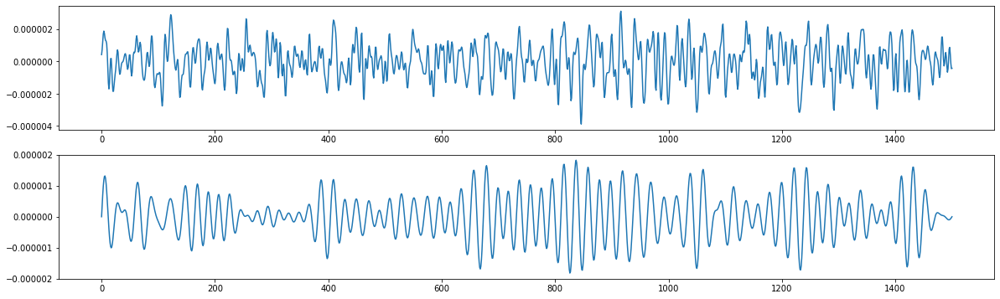

In [267]:
_, axs = plt.subplots(2, 1, figsize=(20, 6))
axs[0].plot(orig_signal)
axs[1].plot(alpha_filtered_signal)

In [268]:
psds_orig, freqs = mne.time_frequency.psd_array_multitaper(orig_signal, raw.info['sfreq'])
psds_alpha, _ = mne.time_frequency.psd_array_multitaper(alpha_filtered_signal, raw.info['sfreq'])

    Using multitaper spectrum estimation with 7 DPSS windows
    Using multitaper spectrum estimation with 7 DPSS windows


In [269]:
import matplotlib.ticker as plticker

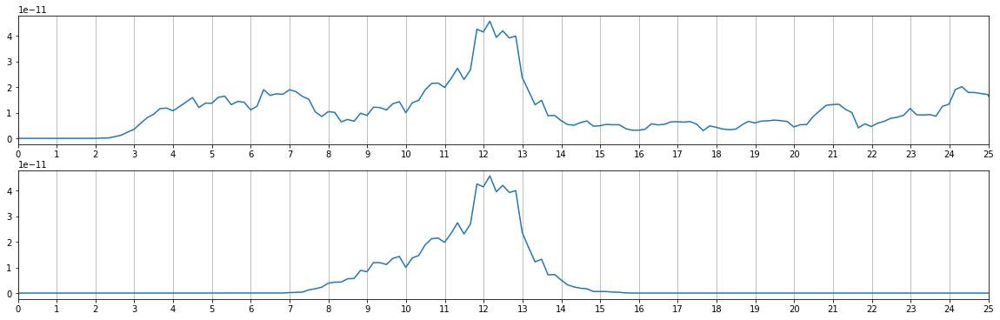

In [270]:
_, axs = plt.subplots(2, 1, figsize=(20, 6))
axs[0].plot(freqs, psds_orig)
axs[1].plot(freqs, psds_alpha)
for ax in axs:
    ax.set_xlim(left=0, right=25)
    ax.grid(axis='x')
    loc = plticker.MultipleLocator(base=1.0)
    ax.xaxis.set_major_locator(loc)

In [271]:
import scipy

In [272]:
butter3 = scipy.signal.butter(3, [9, 13], btype='bandpass', fs=raw.info['sfreq'])
butter6 = scipy.signal.butter(6, [9, 13], btype='bandpass', fs=raw.info['sfreq'])
butter9 = scipy.signal.butter(9, [9, 13], btype='bandpass', fs=raw.info['sfreq'])
butter12 = scipy.signal.butter(12, [9, 13], btype='bandpass', fs=raw.info['sfreq'])

In [273]:
alpha_filtered_signal_b3 = scipy.signal.lfilter(butter3[0], butter3[1], orig_signal)
alpha_filtered_signal_b6 = scipy.signal.lfilter(butter6[0], butter6[1], orig_signal)
alpha_filtered_signal_b9 = scipy.signal.lfilter(butter9[0], butter9[1], orig_signal)
alpha_filtered_signal_b12 = scipy.signal.lfilter(butter12[0], butter12[1], orig_signal)

In [274]:
psds_alpha_b3, _ = mne.time_frequency.psd_array_multitaper(alpha_filtered_signal_b3, raw.info['sfreq'])
psds_alpha_b6, _ = mne.time_frequency.psd_array_multitaper(alpha_filtered_signal_b6, raw.info['sfreq'])
psds_alpha_b9, _ = mne.time_frequency.psd_array_multitaper(alpha_filtered_signal_b9, raw.info['sfreq'])
psds_alpha_b12, _ = mne.time_frequency.psd_array_multitaper(alpha_filtered_signal_b12, raw.info['sfreq'])

    Using multitaper spectrum estimation with 7 DPSS windows
    Using multitaper spectrum estimation with 7 DPSS windows
    Using multitaper spectrum estimation with 7 DPSS windows
    Using multitaper spectrum estimation with 7 DPSS windows


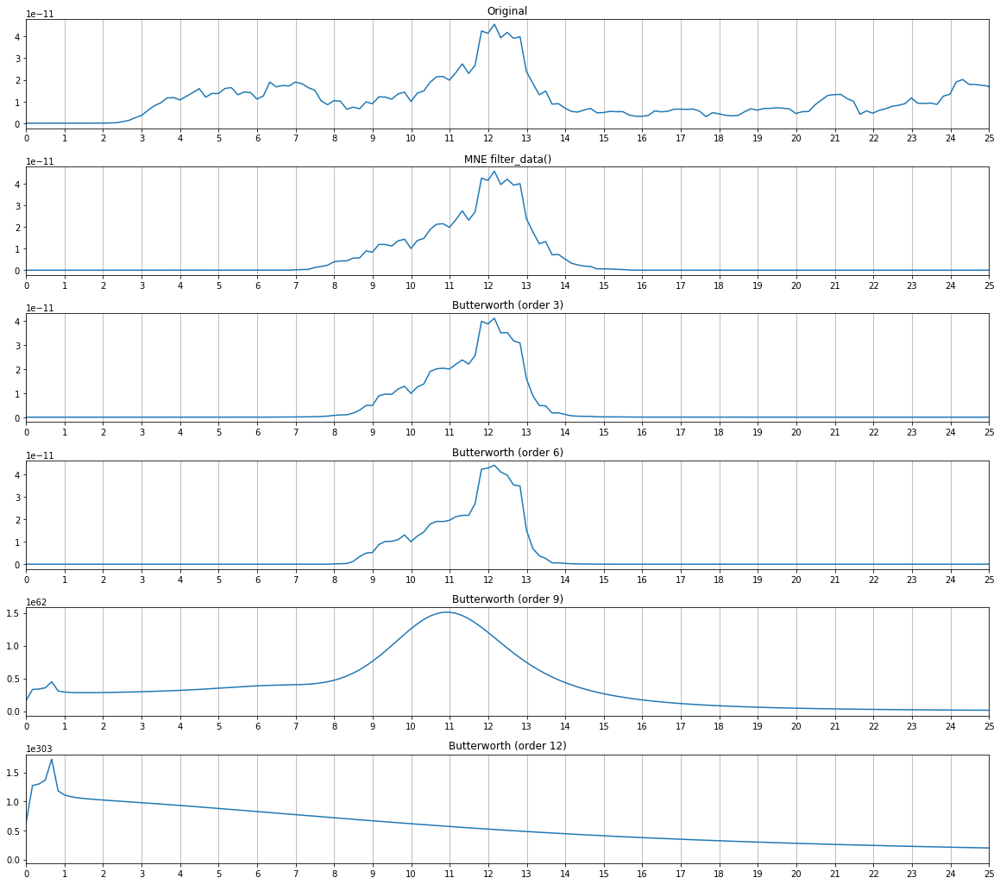

In [275]:
fig, axs = plt.subplots(6, 1, figsize=(20, 18))
axs[0].plot(freqs, psds_orig)
axs[0].set_title('Original')
axs[1].plot(freqs, psds_alpha)
axs[1].set_title('MNE filter_data()')
axs[2].plot(freqs, psds_alpha_b3)
axs[2].set_title('Butterworth (order 3)')
axs[3].plot(freqs, psds_alpha_b6)
axs[3].set_title('Butterworth (order 6)')
axs[4].plot(freqs, psds_alpha_b9)
axs[4].set_title('Butterworth (order 9)')
axs[5].plot(freqs, psds_alpha_b12)
axs[5].set_title('Butterworth (order 12)')
for ax in axs:
    ax.set_xlim(left=0, right=25)
    ax.grid(axis='x')
    loc = plticker.MultipleLocator(base=1.0)
    ax.xaxis.set_major_locator(loc)
fig.subplots_adjust(hspace=.35)

In [276]:
# Define subbands of interest within alpha/beta based on per-channel chi2 feature importance plots
alpha_band = [9, 13]
beta_band = [21, 25]

In [277]:
def band_power(signal, fs, band):
    signal_filtered = mne.filter.filter_data(signal, fs, band[0], band[1], verbose='WARNING')
    return np.sqrt((signal_filtered ** 2).mean())

In [278]:
band_power(orig_signal, raw.info['sfreq'], alpha_band)

6.869411400624736e-07

In [279]:
band_power(orig_signal, raw.info['sfreq'], beta_band)

5.291679542243059e-07

In [280]:
channels_of_interest

['C3', 'C4', 'Cz', '9', '11', '2', '14', '3', '5', '15', '17', '19']

In [281]:
epochs_data = epochs.get_data()
epochs_data.shape

Using data from preloaded Raw for 273 events and 1501 original time points ...


(273, 25, 1501)

In [282]:
features_df = []
for i in range(len(epochs_data)):
    features_dict = {}
    for ch_name in channels_of_interest:
        channel_index = raw.ch_names.index('EEG-{}'.format(ch_name))
        channel_timeseries = epochs_data[i][channel_index]
        alpha_power = band_power(channel_timeseries, raw.info['sfreq'], alpha_band)
        beta_power = band_power(channel_timeseries, raw.info['sfreq'], beta_band)
        features_dict['{}_alpha'.format(ch_name)] = alpha_power
        features_dict['{}_beta'.format(ch_name)] = beta_power
    epoch_event_id = epochs.events[i][2]
    trial_label = event_id_inv[epoch_event_id]
    features_dict['target'] = trial_label
    features_df.append(features_dict)

features_df = pd.DataFrame(features_df)

In [283]:
features_df

,C3_alpha,C3_beta,C4_alpha,C4_beta,Cz_alpha,Cz_beta,9_alpha,9_beta,11_alpha,11_beta,...,3_beta,5_alpha,5_beta,15_alpha,15_beta,17_alpha,17_beta,19_alpha,19_beta,target
0,6.869411e-07,5.291680e-07,7.468519e-07,6.977376e-07,7.928937e-07,4.998495e-07,4.341704e-07,4.219397e-07,4.269812e-07,5.301347e-07,...,5.328677e-07,5.210424e-07,5.100019e-07,4.335227e-07,4.546413e-07,3.833613e-07,2.396301e-07,1.087917e-06,6.900851e-07,cue_tongue
1,9.082367e-07,4.161522e-07,9.778961e-07,5.948691e-07,7.225007e-07,4.615519e-07,4.035625e-07,3.915318e-07,5.966150e-07,4.355281e-07,...,3.902642e-07,6.531133e-07,4.392053e-07,4.956393e-07,3.899927e-07,3.095816e-07,2.221691e-07,1.166806e-06,5.830431e-07,cue_foot
2,4.373643e-07,3.361386e-07,6.491375e-07,4.996280e-07,6.134295e-07,4.177922e-07,3.365386e-07,3.447492e-07,3.786525e-07,4.306626e-07,...,4.583819e-07,5.046200e-07,4.602563e-07,3.946645e-07,3.503907e-07,2.606328e-07,2.209306e-07,7.812648e-07,5.081221e-07,cue_right
3,9.750854e-07,4.396969e-07,6.746592e-07,4.565517e-07,6.464602e-07,4.372652e-07,4.790444e-07,3.703752e-07,4.286705e-07,3.782517e-07,...,4.344759e-07,5.609836e-07,3.995548e-07,4.719630e-07,3.710964e-07,2.894247e-07,2.143259e-07,1.172876e-06,5.189957e-07,cue_left
4,8.785042e-07,4.294029e-07,7.318443e-07,4.866995e-07,6.224761e-07,4.291568e-07,3.985149e-07,3.295373e-07,5.352861e-07,3.766497e-07,...,4.043243e-07,5.570499e-07,3.915595e-07,4.843605e-07,3.482801e-07,2.749103e-07,2.230185e-07,1.074363e-06,5.182280e-07,cue_left
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268,6.257280e-07,3.512474e-07,5.010603e-07,4.585873e-07,5.601572e-07,3.502247e-07,3.041901e-07,2.894889e-07,3.951495e-07,3.302902e-07,...,3.882889e-07,4.907242e-07,3.606751e-07,3.985283e-07,2.922658e-07,3.135210e-07,2.457503e-07,1.004950e-06,5.550540e-07,cue_right
269,7.804998e-07,4.393602e-07,5.151510e-07,4.027170e-07,6.435905e-07,4.201624e-07,4.091194e-07,3.397713e-07,3.640434e-07,3.158194e-07,...,4.201414e-07,4.791381e-07,3.358742e-07,4.714798e-07,3.303383e-07,3.384997e-07,2.546643e-07,1.192741e-06,6.191457e-07,cue_left
270,5.946745e-07,3.979376e-07,7.363662e-07,5.497742e-07,5.679158e-07,3.901596e-07,3.189341e-07,3.509037e-07,3.670576e-07,3.680092e-07,...,4.251510e-07,5.730263e-07,4.239948e-07,4.527172e-07,2.846797e-07,4.379188e-07,3.004598e-07,1.058668e-06,5.316090e-07,cue_foot
271,5.350910e-07,3.327197e-07,5.216032e-07,5.078676e-07,6.980341e-07,3.388887e-07,3.476243e-07,2.990130e-07,3.588970e-07,3.333047e-07,...,3.671602e-07,4.261667e-07,4.381967e-07,4.317216e-07,3.177433e-07,3.751784e-07,2.433769e-07,1.059033e-06,5.253264e-07,cue_left


In [284]:
features_df.describe()

,C3_alpha,C3_beta,C4_alpha,C4_beta,Cz_alpha,Cz_beta,9_alpha,9_beta,11_alpha,11_beta,...,3_alpha,3_beta,5_alpha,5_beta,15_alpha,15_beta,17_alpha,17_beta,19_alpha,19_beta
count,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,...,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02,2.730000e+02
mean,6.002333e-07,3.921144e-07,6.232472e-07,4.848004e-07,6.268509e-07,3.989790e-07,3.568825e-07,3.335816e-07,4.279248e-07,3.858228e-07,...,6.249339e-07,4.266584e-07,5.407795e-07,4.085127e-07,4.135696e-07,3.394391e-07,3.406036e-07,2.344787e-07,1.068460e-06,5.595235e-07
std,1.673469e-07,5.218752e-08,1.707701e-07,7.269773e-08,1.094034e-07,4.162109e-08,5.824564e-08,3.975147e-08,1.028612e-07,5.984770e-08,...,1.029832e-07,4.357467e-08,8.802398e-08,4.338825e-08,6.415951e-08,3.945016e-08,4.847488e-08,2.707029e-08,2.218260e-07,6.392466e-08
min,2.952682e-07,2.630848e-07,3.302009e-07,3.272256e-07,3.981467e-07,2.982378e-07,2.467192e-07,2.345434e-07,2.445701e-07,2.678023e-07,...,3.471378e-07,3.266382e-07,3.543805e-07,3.060407e-07,2.912075e-07,2.598518e-07,2.442071e-07,1.692647e-07,6.080010e-07,3.870566e-07
25%,4.618977e-07,3.529099e-07,4.883027e-07,4.311617e-07,5.459644e-07,3.685467e-07,3.140323e-07,3.040303e-07,3.542000e-07,3.405638e-07,...,5.452319e-07,4.011583e-07,4.789584e-07,3.794983e-07,3.619918e-07,3.123905e-07,3.062796e-07,2.164803e-07,8.975928e-07,5.170726e-07
50%,5.915660e-07,3.930368e-07,5.972791e-07,4.793597e-07,6.179240e-07,3.975248e-07,3.503847e-07,3.296107e-07,4.068812e-07,3.782517e-07,...,6.209997e-07,4.223491e-07,5.307136e-07,4.057558e-07,4.051833e-07,3.344921e-07,3.371034e-07,2.299499e-07,1.056487e-06,5.561542e-07
75%,7.300210e-07,4.280646e-07,7.363662e-07,5.333596e-07,7.021566e-07,4.252612e-07,3.948140e-07,3.565428e-07,4.881140e-07,4.230286e-07,...,6.954634e-07,4.516787e-07,5.967996e-07,4.275181e-07,4.541212e-07,3.584303e-07,3.691705e-07,2.502481e-07,1.219475e-06,6.064922e-07
max,1.038266e-06,5.686345e-07,1.305749e-06,6.996771e-07,9.392134e-07,5.546737e-07,5.717049e-07,4.596170e-07,8.823075e-07,5.829789e-07,...,1.078150e-06,5.747634e-07,7.984366e-07,5.340926e-07,6.693100e-07,4.913898e-07,5.222723e-07,3.485461e-07,1.703204e-06,7.502020e-07


In [285]:
X = features_df.drop(columns=['target'])
y = features_df['target']

In [286]:
y = label_encoder.transform(y)

In [287]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [288]:
y_train

array([0, 3, 3, 2, 1, 1, 0, 0, 1, 3, 3, 2, 0, 3, 0, 0, 1, 3, 2, 0, 2, 0,
       3, 2, 3, 2, 0, 3, 0, 2, 3, 0, 2, 1, 1, 3, 3, 1, 1, 2, 2, 0, 2, 3,
       2, 1, 1, 2, 2, 3, 0, 1, 1, 1, 2, 1, 2, 0, 2, 3, 2, 2, 0, 0, 3, 1,
       2, 1, 2, 0, 3, 1, 2, 1, 3, 3, 1, 3, 1, 1, 0, 2, 2, 2, 1, 1, 2, 0,
       0, 2, 3, 0, 2, 2, 0, 3, 0, 3, 2, 3, 1, 1, 1, 2, 3, 3, 1, 0, 0, 1,
       2, 3, 0, 0, 3, 2, 0, 0, 0, 2, 3, 3, 0, 2, 2, 0, 2, 3, 1, 3, 1, 3,
       2, 2, 1, 1, 0, 3, 2, 3, 1, 0, 2, 1, 1, 3, 2, 0, 0, 2, 2, 0, 2, 3,
       0, 0, 3, 1, 3, 2, 3, 0, 3, 0, 0, 1, 2, 3, 2, 1, 0, 1, 3, 0, 2, 1,
       2, 1, 1, 1, 1, 0, 0, 1, 2, 2, 0, 2, 2, 1, 3, 1, 0, 0, 3, 0, 3, 1,
       3, 1, 3, 2, 2, 1, 0, 0, 3, 3, 2, 1, 1, 2, 2, 1, 1, 3, 0, 0])

In [289]:
chi_scores, p_values = chi2(X_train, y_train)

In [290]:
sorted_features_chi2_df = (pd.DataFrame({'chi2_stat': chi_scores, 'p': p_values, 'feature': X_train.columns})
                            .sort_values(by = 'chi2_stat', ascending = False).reset_index(drop=True))

In [291]:
sorted_features_chi2_df.head(30)

,chi2_stat,p,feature
0,1.208992e-05,1.0,14_alpha
1,5.794779e-06,1.0,C3_alpha
2,4.705458e-06,1.0,C4_alpha
3,4.114292e-06,1.0,19_alpha
4,3.570897e-06,1.0,2_alpha
5,1.935661e-06,1.0,11_alpha
6,1.510043e-06,1.0,Cz_alpha
7,1.112821e-06,1.0,3_alpha
8,9.309230e-07,1.0,5_alpha
9,8.012658e-07,1.0,9_alpha


In [292]:
min_max_scaler = MinMaxScaler()
X_train_minmax = pd.DataFrame(min_max_scaler.fit_transform(X_train), columns=X_train.columns)

In [293]:
chi_scores, p_values = chi2(X_train_minmax, y_train)

In [294]:
sorted_features_chi2_df = (pd.DataFrame({'chi2_stat': chi_scores, 'p': p_values, 'feature': X_train.columns})
                            .sort_values(by = 'chi2_stat', ascending = False).reset_index(drop=True))

In [295]:
sorted_features_chi2_df.head(30)

,chi2_stat,p,feature
0,15.249468,0.001615,C3_alpha
1,13.063436,0.004501,14_alpha
2,10.229412,0.016713,C4_alpha
3,8.893656,0.030739,2_alpha
4,8.620764,0.034782,19_alpha
5,7.918269,0.047731,9_alpha
6,7.566349,0.055878,Cz_alpha
7,7.529171,0.056814,11_alpha
8,6.056936,0.108873,C3_beta
9,6.056516,0.108893,5_alpha


In [296]:
cv_results = []
for model_name, mp in model_params.items():
    clf_pipeline = Pipeline([('scaler', None), ('feature_selector', SelectKBest(score_func=chi2)), ('classifier', mp['model'])])
    hyperparams_pipeline = {'classifier__{}'.format(param_name): mp['hyperparams'][param_name] for param_name in mp['hyperparams']}
    hyperparams_pipeline['scaler'] = [None, MinMaxScaler()]
    hyperparams_pipeline['feature_selector__k'] = ['all', 10, 5]
    clf = GridSearchCV(clf_pipeline, hyperparams_pipeline, verbose=2, return_train_score=True)
    print('Grid searching for {}'.format(model_name))
    clf.fit(X_train, y_train)
    cv_results.append({
        'model': model_name,
        'results': clf.cv_results_
    })

Grid searching for svm
Fitting 5 folds for each of 18 candidates, totalling 90 fits
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=None ......
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=all, scaler=MinMaxScaler(), total=   0

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=5, scaler=None ........
[CV]  classifier__C=0.0001, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=5, scaler=None ........
[CV]  classifier__C=0.0001, feature_sel

[CV]  classifier__C=30, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=30, feature_selector__k=10, scaler=MinMaxScaler() .
[CV]  classifier__C=30, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=30, feature_selector__k=10, scaler=MinMaxScaler() .
[CV]  classifier__C=30, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=None ............
[CV]  classifier__C=30, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=None ............
[CV]  classifier__C=30, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=None ............
[CV]  classifier__C=30, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=30, feature_selector__k=5, scaler=None ............
[CV]  classifier__C=30, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=30, 

[Parallel(n_jobs=1)]: Done  90 out of  90 | elapsed:    1.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.2s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.2s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s


[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.2s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.2s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=None, total=   0.2s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__n_estimators=100, feature_sele

[CV]  classifier__n_estimators=200, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__n_estimators=200, feature_selector__k=5, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__n_estimators=200, feature_selector__k=5, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__n_estimators=200, feature_selector__k=5, scaler=None 
[CV]  classifier__n_estimators=200, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__n_estimators=200, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=200, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__n_estimators=200, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=200, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__n_estimators=200, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  cl

[Parallel(n_jobs=1)]: Done  90 out of  90 | elapsed:   29.5s finished


Grid searching for knn
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, fe

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=uniform, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neig

[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=1, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(

[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None 
[CV]  classifier__n_neighbors=5, classifier__weights=distance, feature_selector__k=all, scaler=None, total=   0.0s
[CV] classifier__n_neighb

[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=uniform, feature_selector__k=10, scaler=MinMaxScaler(), total=  

[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, classifier__weights=distance, feature_selector__k=5, scaler=MinMaxScaler(), total=  

[Parallel(n_jobs=1)]: Done 180 out of 180 | elapsed:    2.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV] ... feature_selector__k=all, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=10, scaler=None .............................
[CV] .............. feature_selector__k=10, scaler=None, total=   0.0s
[CV] feature_selector__k=10, scaler=None .............................
[CV] .............. feature_selector__k=10, scaler=None, total=   0.0s
[CV] feature_selector__k=10, scaler=None .............................
[CV] .............. feature_selector__k=10, scaler=None, total=   0.0s
[CV] feature_selector__k=10, scaler=None .............................
[CV] .............. feature_selector__k=10, scaler=None, total=   0.0s
[CV] feature_selector__k=10, scaler=None .............................
[CV] .............. feature_selector__k=10, scaler=None, total=   0.0s
[CV] feature_selector__k=10, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=10, scaler=MinMaxScaler() ...................
[CV] .

[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, cl

[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=10, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=10, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=10, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=10, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=100, feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__max_depth=3, classifier_

[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.4s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.4s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.4s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.4s
[CV] classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=300, feature_selector__k=5, scaler=None, total=   0.4s
[CV] c

[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=5, classifier__n_estimators=100, feature_selector__k=all, scaler=None 
[C

[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=None, total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=None 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=None, total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=5, classifier__n_estimators=300, feature_selector__k=all, scaler=MinMaxScaler(

[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=None, total=   0.1s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=50, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier_

[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=6, classifier__n_estimators=100, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__max_depth=6, classifier__n_estima

[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s
[CV] classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=6, classifier__n_estimators=300, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.5s


[Parallel(n_jobs=1)]: Done 270 out of 270 | elapsed:  1.3min finished


##### SVM

In [297]:
interesting_columns = ['param_classifier__C'] + common_interesting_columns
svm_cv_summary = pd.DataFrame(cv_results[0]['results'])[interesting_columns].sort_values('rank_test_score')
svm_cv_summary

,param_classifier__C,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
9,1,10,MinMaxScaler(),1,0.605814,0.664007
15,30,10,MinMaxScaler(),2,0.601586,0.675461
11,1,5,MinMaxScaler(),3,0.550317,0.610069
7,1,all,MinMaxScaler(),4,0.541543,0.724782
17,30,5,MinMaxScaler(),5,0.527484,0.613491
13,30,all,MinMaxScaler(),6,0.527378,0.746581
14,30,10,None,7,0.270613,0.270640
12,30,all,None,7,0.270613,0.270640
10,1,5,None,7,0.270613,0.270640
0,0.0001,all,None,7,0.270613,0.270640


##### Random Forest

In [298]:
interesting_columns = ['param_classifier__n_estimators'] + common_interesting_columns
rf_cv_summary = pd.DataFrame(cv_results[1]['results'])[interesting_columns].sort_values('rank_test_score')
rf_cv_summary

,param_classifier__n_estimators,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
7,200,all,MinMaxScaler(),1,0.619239,1.000000
13,300,all,MinMaxScaler(),2,0.578436,1.000000
15,300,10,MinMaxScaler(),3,0.573150,1.000000
1,100,all,MinMaxScaler(),4,0.568816,1.000000
9,200,10,MinMaxScaler(),5,0.568499,1.000000
3,100,10,MinMaxScaler(),6,0.554757,1.000000
5,100,5,MinMaxScaler(),7,0.518076,1.000000
11,200,5,MinMaxScaler(),8,0.504334,1.000000
17,300,5,MinMaxScaler(),9,0.499683,1.000000
8,200,10,None,10,0.307188,0.311947


##### KNN

In [299]:
interesting_columns = ['param_classifier__n_neighbors', 'param_classifier__weights'] + common_interesting_columns
knn_cv_summary = pd.DataFrame(cv_results[2]['results'])[interesting_columns].sort_values('rank_test_score')
knn_cv_summary

,param_classifier__n_neighbors,param_classifier__weights,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
24,15,uniform,all,None,1,0.578013,0.634161
30,15,distance,all,None,2,0.573256,1.000000
33,15,distance,10,MinMaxScaler(),3,0.555180,1.000000
27,15,uniform,10,MinMaxScaler(),4,0.550634,0.622647
19,5,distance,all,MinMaxScaler(),5,0.550529,1.000000
32,15,distance,10,None,6,0.546089,1.000000
28,15,uniform,5,None,7,0.545877,0.596315
26,15,uniform,10,None,8,0.545772,0.614673
31,15,distance,all,MinMaxScaler(),9,0.541543,1.000000
25,15,uniform,all,MinMaxScaler(),10,0.536998,0.614686


##### LDA

In [300]:
interesting_columns = common_interesting_columns
lda_cv_summary = pd.DataFrame(cv_results[3]['results'])[interesting_columns].sort_values('rank_test_score')
lda_cv_summary

,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
2,10,None,1,0.591966,0.685800
3,10,MinMaxScaler(),2,0.577907,0.676558
5,5,MinMaxScaler(),3,0.541332,0.623836
4,5,None,4,0.541121,0.621550
0,all,None,5,0.532135,0.727094
1,all,MinMaxScaler(),5,0.532135,0.727094


##### XGBoost

In [301]:
interesting_columns = ['param_classifier__max_depth', 'param_classifier__n_estimators'] + common_interesting_columns
xgb_cv_summary = pd.DataFrame(cv_results[4]['results'])[interesting_columns].sort_values('rank_test_score')
xgb_cv_summary

,param_classifier__max_depth,param_classifier__n_estimators,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
6,3,100,all,None,1,0.586998,1.0
7,3,100,all,MinMaxScaler(),1,0.586998,1.0
31,5,300,all,MinMaxScaler(),3,0.582452,1.0
30,5,300,all,None,3,0.582452,1.0
12,3,300,all,None,5,0.578118,1.0
13,3,300,all,MinMaxScaler(),5,0.578118,1.0
51,6,300,10,MinMaxScaler(),7,0.577801,1.0
0,3,50,all,None,8,0.573362,1.0
1,3,50,all,MinMaxScaler(),8,0.573362,1.0
33,5,300,10,MinMaxScaler(),10,0.573256,1.0


##### Classifier comparison
These suck compared to the more narrow banded feature ones. 

I guess the best one here is the SVM with 10 features, which has a train accuracy of 66.4% and a test accuracy of **60.6%**.

## Manually create a channel montage
Since no channel position information is provided, we can manually place the channels based on the diagram in the dataset description.

This will be useful for visualizing spatial filters like PCA, ICA, and CSP.

In [302]:
biosemi_montage = mne.channels.make_standard_montage('biosemi16')
biosemi_montage

<DigMontage | 0 extras (headshape), 0 HPIs, 3 fiducials, 16 channels>

Creating RawArray with float64 data, n_channels=16, n_times=1
    Range : 0 ... 0 =      0.000 ...     0.000 secs
Ready.


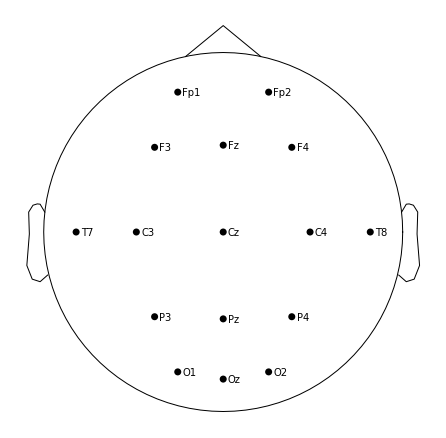

In [303]:
biosemi_montage.plot();

In [304]:
biosemi_montage.remove_fiducials()

<DigMontage | 0 extras (headshape), 0 HPIs, 0 fiducials, 16 channels>

In [305]:
biosemi_montage.get_positions()

{'ch_pos': OrderedDict([('Fp1',
               array([-0.02933873,  0.09029533, -0.00331545])),
              ('Fp2', array([ 0.02933873,  0.09029533, -0.00331545])),
              ('F4', array([0.05177571, 0.06393767, 0.0475    ])),
              ('Fz', array([4.18445162e-18, 6.83372810e-02, 6.59925452e-02])),
              ('F3', array([-0.05177571,  0.06393767,  0.0475    ])),
              ('T7', array([-0.09494213, -0.        , -0.00331545])),
              ('C3', array([-0.06833728, -0.        ,  0.06599255])),
              ('Cz', array([0.   , 0.   , 0.095])),
              ('C4', array([0.06833728, 0.        , 0.06599255])),
              ('T8', array([ 0.09494213,  0.        , -0.00331545])),
              ('P4', array([ 0.05177571, -0.06393767,  0.0475    ])),
              ('Pz',
               array([ 4.18445162e-18, -6.83372810e-02,  6.59925452e-02])),
              ('P3', array([-0.05177571, -0.06393767,  0.0475    ])),
              ('O1', array([-0.02933873, -0.0902953

In [306]:
-6.83372810e-02

-0.068337281

In [307]:
custom_montage = mne.channels.make_dig_montage({
    'Fz': [4.18445162e-18, 6.83372810e-02, 6.59925452e-02],
    '2': [-0.066, 0.035, 0.06],
    '3': [-0.03286864, 0.037, 0.06],
    '4': [0., 0.038, 0.06],
    '5': [0.0345, 0.037, 0.06],
    '6': [0.066, 0.035, 0.06],
    '7': [-0.09, 0.,  0.04],
    'C3': [-0.06833728, 0.,  0.06599255],
    '9': [-0.03416864, 0., 0.06],
    'Cz': [0., 0., 0.095],
    '11': [0.036, 0., 0.06],
    'C4': [0.06833728, 0., 0.06599255],
    '13': [0.09, 0., 0.04],
    '14': [-0.065, -0.0325, 0.05],
    '15': [-0.032, -0.035, 0.05],
    '16': [0., -0.037, 0.06],
    '17': [0.034, -0.035, 0.05],
    '18': [0.0645, -0.033, 0.05],
    '19': [-0.032, -0.066337281, 6.59925452e-02],
    'Pz': [4.18445162e-18, -6.83372810e-02, 6.59925452e-02],
    '21': [0.033, -0.067, 6.59925452e-02],
    '22': [4.18445162e-18, -0.095, 6.59925452e-02]
})

Creating RawArray with float64 data, n_channels=22, n_times=1
    Range : 0 ... 0 =      0.000 ...     0.000 secs
Ready.


<ipython-input-308-de29eb8cc37c>:1: RuntimeWarning: Fiducial point nasion not found, assuming identity unknown to head transformation
  custom_montage.plot();


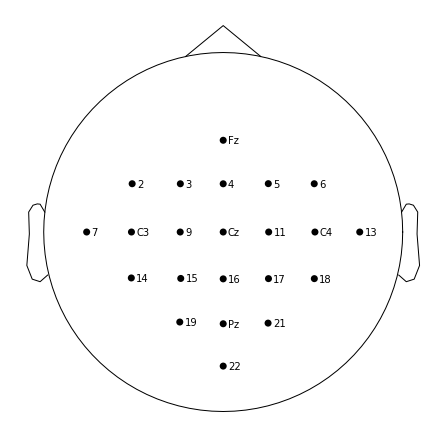

In [308]:
custom_montage.plot();

Looking at the 10-20 electrode system compared to the image provided in the dataset description, I would guess that these are the actual channels being used (highlighted in red boxes):

![Channels highlighted in 10-20 diagram](electrodes-10-20-highlighted.png)

In [309]:
montage_10_20 = mne.channels.make_standard_montage('standard_1020')

4 duplicate electrode labels found:
T7/T3, T8/T4, P7/T5, P8/T6
Plotting 90 unique labels.
Creating RawArray with float64 data, n_channels=90, n_times=1
    Range : 0 ... 0 =      0.000 ...     0.000 secs
Ready.


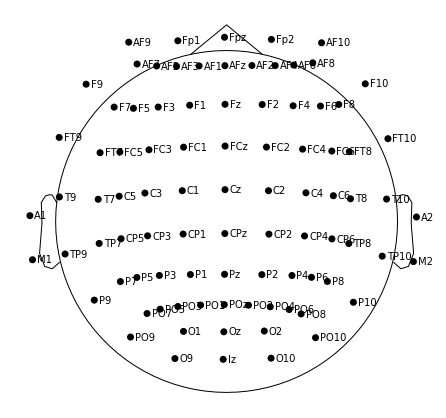

In [310]:
montage_10_20.plot();

In [311]:
data_10_20 = montage_10_20.get_positions()
data_10_20

{'ch_pos': OrderedDict([('Fp1', array([-0.0294367,  0.0839171, -0.00699  ])),
              ('Fpz', array([ 0.0001123,  0.088247 , -0.001713 ])),
              ('Fp2', array([ 0.0298723,  0.0848959, -0.00708  ])),
              ('AF9', array([-0.0489708,  0.0640872, -0.047683 ])),
              ('AF7', array([-0.0548397,  0.0685722, -0.01059  ])),
              ('AF5', array([-0.0454307,  0.0728622,  0.005978 ])),
              ('AF3', array([-0.0337007,  0.0768371,  0.021227 ])),
              ('AF1', array([-0.0184717,  0.0799041,  0.032752 ])),
              ('AFz', array([0.0002313, 0.080771 , 0.035417 ])),
              ('AF2', array([0.0198203, 0.0803019, 0.032764 ])),
              ('AF4', array([0.0357123, 0.0777259, 0.021956 ])),
              ('AF6', array([0.0465843, 0.0738078, 0.006034 ])),
              ('AF8', array([ 0.0557433,  0.0696568, -0.010755 ])),
              ('AF10', array([ 0.0504352,  0.0638698, -0.048005 ])),
              ('F9', array([-0.0701019,  0.041652

In [312]:
channels_used = 'Fz FC3 FC1 FCz FC2 FC4 C5 C3 C1 Cz C2 C4 C6 CP3 CP1 CPz CP2 CP4 P1 Pz P2 POz'

In [313]:
from collections import OrderedDict

In [314]:
ch_pos_filtered = OrderedDict()
for ch in channels_used.split():
    ch_pos_filtered[ch] = data_10_20['ch_pos'][ch]

In [315]:
ch_pos_filtered

OrderedDict([('Fz', array([0.0003122, 0.058512 , 0.066462 ])),
             ('FC3', array([-0.0601819,  0.0227162,  0.055544 ])),
             ('FC1', array([-0.0340619,  0.0260111,  0.079987 ])),
             ('FCz', array([0.0003761, 0.02739  , 0.088668 ])),
             ('FC2', array([0.0347841, 0.0264379, 0.078808 ])),
             ('FC4', array([0.0622931, 0.0237228, 0.05563  ])),
             ('C5', array([-0.0802801, -0.0137597,  0.02916  ])),
             ('C3', array([-0.0653581, -0.0116317,  0.064358 ])),
             ('C1', array([-0.036158 , -0.0099839,  0.089752 ])),
             ('Cz', array([ 0.0004009, -0.009167 ,  0.100244 ])),
             ('C2', array([ 0.037672 , -0.0096241,  0.088412 ])),
             ('C4', array([ 0.0671179, -0.0109003,  0.06358  ])),
             ('C6', array([ 0.0834559, -0.0127763,  0.029208 ])),
             ('CP3', array([-0.0635562, -0.0470088,  0.065624 ])),
             ('CP1', array([-0.0355131, -0.0472919,  0.091315 ])),
             ('

In [316]:
study_montage = mne.channels.make_dig_montage(ch_pos=ch_pos_filtered, nasion=data_10_20['nasion'], lpa=data_10_20['lpa'], rpa=data_10_20['rpa'])

Creating RawArray with float64 data, n_channels=22, n_times=1
    Range : 0 ... 0 =      0.000 ...     0.000 secs
Ready.


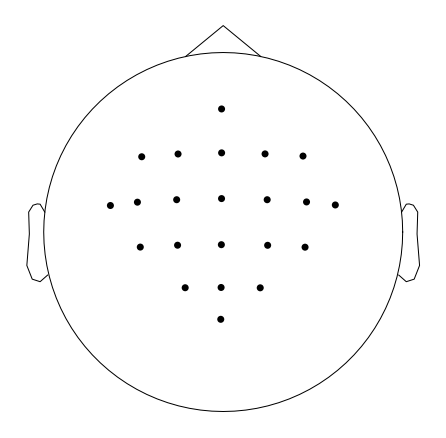

In [317]:
study_montage.plot(show_names=False);

In [318]:
study_montage.rename_channels({
    'FC3': '2', 'FC1': '3', 'FCz': '4', 'FC2': '5', 'FC4': '6',
    'C5': '7', 'C1': '9', 'C2': '11', 'C6': '13',
    'CP3': '14', 'CP1': '15', 'CPz': '16', 'CP2': '17', 'CP4': '18',
    'P1': '19', 'P2': '21',
    'POz': '22'
})

Creating RawArray with float64 data, n_channels=22, n_times=1
    Range : 0 ... 0 =      0.000 ...     0.000 secs
Ready.


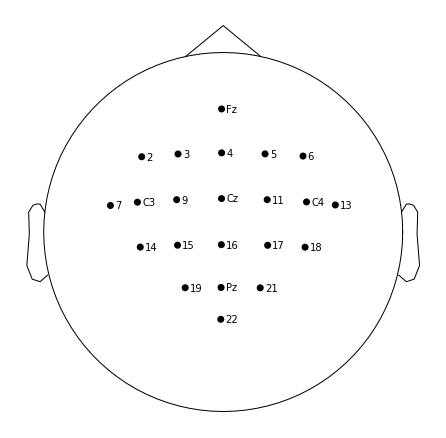

In [319]:
study_montage.plot();

## Pipeline-ify preprocessing steps

Pre-pipeline steps:
1. Read file into an `mne.Raw` structure
1. Rename annotations from numeric codes to readable descriptions
1. Rename EEG channels to match diagram from dataset description
1. Extract annotations into events, then remove annotations from Raw instance
1. Epoch data (`mne.Raw` -> `mne.Epochs`)
1. Apply bandpass filter
1. Regress EOG artifacts
1. Remove trials marked as bad
1. Set channel montage
1. Split into X and y arrays
1. Fit a LabelEncoder
1. Split into train and test sets

Steps in the pipeline are:
1. Apply spatial filter _(none, CAR, Laplacian)_
1. Compute 1Hz resolution PSD between 4Hz and 30Hz, normalizing each bin as a proportion of the total power within the 4-30Hz band
1. Scale features _(no scaling or min-max)_
1. Select K best features _(chi2, mutual info, f score, all, 50, 10)_
1. Train a classifier _(SVM, Random Forest, Decision Tree, KNN, LDA, XGBoost, Logistic Regression, GaussianNB, CategoricalNB, MLPClassifier)_

### Data preparation function

In [320]:
def prepare_subject_training_data(subject_no, baseline_normalize=True, regress_eog_artifacts=True):
    # 1. Read file into an mne.Raw structure
    raw = mne.io.read_raw_gdf(get_data_path(subject_no, 'train'), eog=['EOG-left', 'EOG-central', 'EOG-right'])

    # 2. Rename annotations from numeric codes to readable descriptions
    raw.annotations.rename({
        '276': 'idle_eyes_open',
        '277': 'idle_eyes_closed',
        '768': 'trial_start',
        '769': 'cue_left',
        '770': 'cue_right',
        '771': 'cue_foot',
        '772': 'cue_tongue',
        # '783': 'cue_unknown',
        '1023': 'trial_rejected',
        '1072': 'idle_eye_movements',
        '32766': 'run_start'
    }).rename({'3idle_eyes_open6': 'run_start'});

    # 3. Rename EEG channels to match diagram from dataset description
    raw.rename_channels({
        'EEG-0': '2', 'EEG-1': '3', 'EEG-2': '4', 'EEG-3': '5', 'EEG-4': '6', 
        'EEG-5': '7', 'EEG-6': '9', 'EEG-7': '11', 'EEG-8': '13', 'EEG-9': '14',
        'EEG-10': '15', 'EEG-11': '16', 'EEG-12': '17', 'EEG-13': '18', 'EEG-14': '19',
        'EEG-15': '21', 'EEG-16': '22', 'EEG-Fz': 'Fz', 'EEG-C3': 'C3', 'EEG-Cz': 'Cz',
        'EEG-C4': 'C4', 'EEG-Pz': 'Pz'
    })

    # 4. Extract annotations into events, then remove annotations from Raw instance
    events, event_id = mne.events_from_annotations(raw)
    raw.set_annotations(None)
    event_id_inv = {v: k for k, v in event_id.items()}

    # 5. Epoch data (mne.Raw -> mne.Epochs)
    cue_event_ids = {e_id for e_name, e_id in event_id.items() if e_name.startswith('cue')}
    cue_events = np.array([event for event in events if event[2] in cue_event_ids])
    trial_event_id = {e_name: e_id for e_name, e_id in event_id.items() if e_name.startswith('cue')}
    baseline = (None, 0) if baseline_normalize else None
    epochs = mne.Epochs(raw, cue_events, event_id=trial_event_id, tmin=-2., tmax=4, baseline=baseline, preload=True)

    # 6. Apply bandpass filter
    epochs.filter(4, 30, picks=['eeg'])

    # 7. Regress EOG artifacts
    if regress_eog_artifacts:
        mne.preprocessing.regress_artifact(epochs, copy=False)
    epochs.drop_channels(['EOG-left', 'EOG-central', 'EOG-right'])

    # 8. Remove trials marked as bad
    trial_rejected_events = events[events[:, 2] == event_id['trial_rejected']]
    rejected_epoch_start_sample_numbers = set(trial_rejected_events[:, 0])
    epoch_start_sample_numbers = events[events[:, 2] == event_id['trial_start']][:, 0]
    rejected_epoch_indices = [i for i in range(len(epoch_start_sample_numbers)) if epoch_start_sample_numbers[i] in rejected_epoch_start_sample_numbers]
    epochs.drop(rejected_epoch_indices)

    # 9. Set channel montage
    epochs.set_montage(study_montage)

    # 10. Split into X and y arrays
    X = epochs.get_data(picks=['eeg'], tmin=.5)
    y = [event_id_inv[epochs.events[i][2]] for i in range(len(epochs))]

    # 11. Fit a LabelEncoder
    label_encoder = LabelEncoder()
    y = label_encoder.fit_transform(y)

    # 12. Split into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    return epochs, cue_events, label_encoder, X_train, X_test, y_train, y_test

In [321]:
epochs, events, label_encoder, X_train, X_test, y_train, y_test = prepare_subject_training_data(1, baseline_normalize=True, regress_eog_artifacts=True)

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Not setting metadata
288 matching events found
Setting baseline interval to [-2.0, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 288 events and 1501 original time points ...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


0 bad epochs dropped
Setting up band-pass filter from 4 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 413 samples (1.652 sec)

Dropped 15 epochs: 21, 45, 52, 56, 67, 94, 97, 98, 104, 191, 214, 229, 254, 276, 287


Opening epochs-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


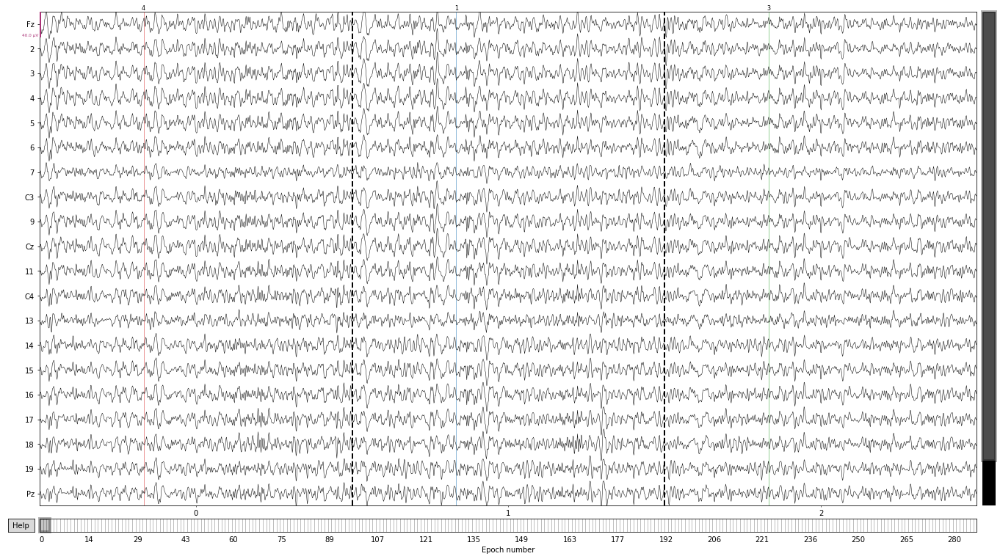

In [322]:
epochs.plot(n_epochs=3, events=events);

    Using multitaper spectrum estimation with 7 DPSS windows


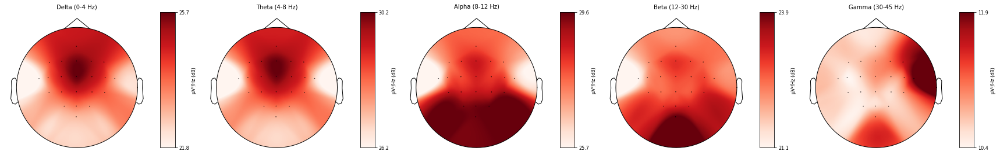

In [323]:
_, axs = plt.subplots(1, 5, figsize=(24, 6))
epochs.plot_psd_topomap(tmin=.5, axes=axs);

In [324]:
label_encoder.classes_

array(['cue_foot', 'cue_left', 'cue_right', 'cue_tongue'], dtype='<U10')

In [325]:
X_train[0]

array([[ 7.95401882e-06,  1.11932422e-05,  1.32026029e-05, ...,
        -4.84778334e-06, -3.44462879e-06, -2.08984340e-06],
       [ 7.70830264e-06,  1.21986086e-05,  1.48989548e-05, ...,
        -1.05760454e-06, -4.62209966e-07,  1.54569402e-07],
       [ 8.27964080e-06,  1.24852823e-05,  1.50963549e-05, ...,
        -3.37040745e-06, -1.80970201e-06, -3.03005674e-07],
       ...,
       [ 7.35990190e-06,  1.06989589e-05,  1.30570839e-05, ...,
         6.18973938e-07,  5.38851000e-07,  9.47424317e-07],
       [ 6.84487951e-06,  9.41559288e-06,  1.12010894e-05, ...,
         2.88443609e-06,  2.46971106e-06,  2.15590639e-06],
       [ 3.90537452e-06,  6.35991026e-06,  8.73141133e-06, ...,
         2.03620322e-06, -3.22840952e-07, -1.81663306e-06]])

In [326]:
X_train.shape

(218, 22, 876)

In [327]:
X_test.shape

(55, 22, 876)

In [328]:
y_train

array([0, 3, 3, 2, 1, 1, 0, 0, 1, 3, 3, 2, 0, 3, 0, 0, 1, 3, 2, 0, 2, 0,
       3, 2, 3, 2, 0, 3, 0, 2, 3, 0, 2, 1, 1, 3, 3, 1, 1, 2, 2, 0, 2, 3,
       2, 1, 1, 2, 2, 3, 0, 1, 1, 1, 2, 1, 2, 0, 2, 3, 2, 2, 0, 0, 3, 1,
       2, 1, 2, 0, 3, 1, 2, 1, 3, 3, 1, 3, 1, 1, 0, 2, 2, 2, 1, 1, 2, 0,
       0, 2, 3, 0, 2, 2, 0, 3, 0, 3, 2, 3, 1, 1, 1, 2, 3, 3, 1, 0, 0, 1,
       2, 3, 0, 0, 3, 2, 0, 0, 0, 2, 3, 3, 0, 2, 2, 0, 2, 3, 1, 3, 1, 3,
       2, 2, 1, 1, 0, 3, 2, 3, 1, 0, 2, 1, 1, 3, 2, 0, 0, 2, 2, 0, 2, 3,
       0, 0, 3, 1, 3, 2, 3, 0, 3, 0, 0, 1, 2, 3, 2, 1, 0, 1, 3, 0, 2, 1,
       2, 1, 1, 1, 1, 0, 0, 1, 2, 2, 0, 2, 2, 1, 3, 1, 0, 0, 3, 0, 3, 1,
       3, 1, 3, 2, 2, 1, 0, 0, 3, 3, 2, 1, 1, 2, 2, 1, 1, 3, 0, 0],
      dtype=int64)

In [329]:
y_test

array([1, 1, 1, 1, 3, 0, 3, 1, 0, 0, 2, 1, 3, 2, 1, 2, 3, 3, 3, 3, 0, 2,
       1, 0, 0, 0, 0, 0, 3, 3, 2, 1, 1, 1, 0, 0, 1, 2, 2, 3, 3, 1, 2, 1,
       3, 1, 2, 0, 3, 3, 2, 0, 3, 0, 3], dtype=int64)

### Processing pipeline

#### Spatial filters

In [330]:
X_train[0].shape

(22, 876)

In [331]:
epochs.info

<Info | 8 non-empty values
 bads: []
 ch_names: Fz, 2, 3, 4, 5, 6, 7, C3, 9, Cz, 11, C4, 13, 14, 15, 16, 17, 18, ...
 chs: 22 EEG
 custom_ref_applied: False
 dig: 25 items (3 Cardinal, 22 EEG)
 highpass: 4.0 Hz
 lowpass: 30.0 Hz
 meas_date: 2005-01-17 12:00:00 UTC
 nchan: 22
 projs: []
 sfreq: 250.0 Hz
>

In [332]:
raw = mne.io.RawArray(X_train[0], epochs.info, verbose=False)

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


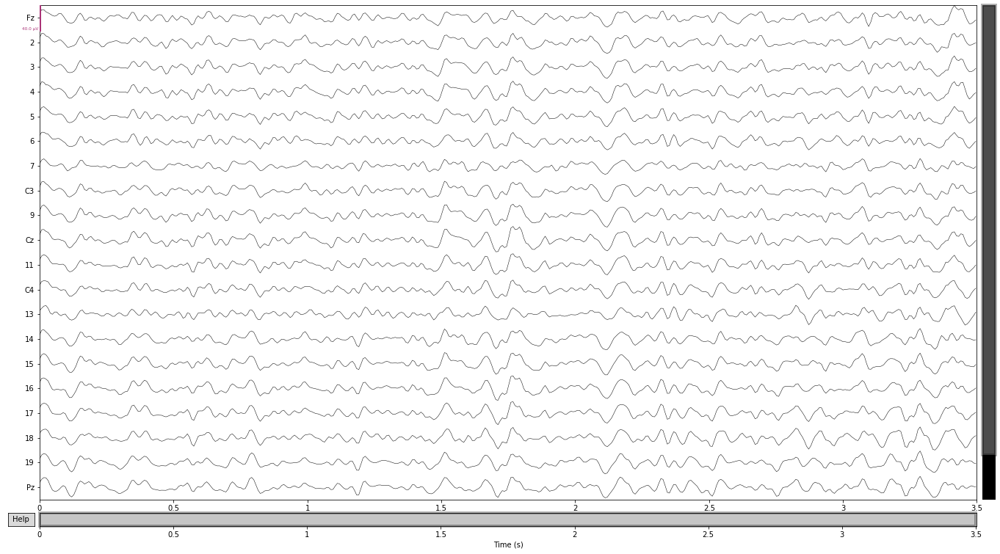

In [333]:
raw.plot();

Effective window size : 3.504 (s)


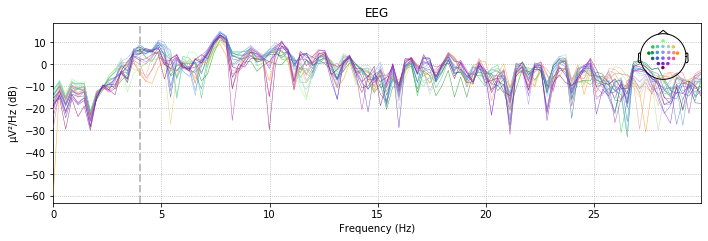

In [334]:
raw.plot_psd(fmax=30.);

In [335]:
np.expand_dims(X_train[0], 0).shape

(1, 22, 876)

In [336]:
def plot_psd_topo(epoch_data, info):
    epoch = mne.EpochsArray(np.expand_dims(epoch_data, 0), info, verbose=False)
    _, axs = plt.subplots(1, 5, figsize=(24, 6))
    epoch.plot_psd_topomap(axes=axs);

    Using multitaper spectrum estimation with 7 DPSS windows


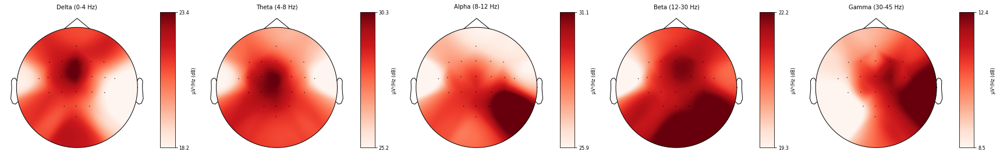

In [337]:
plot_psd_topo(X_train[0], epochs.info)

In [338]:
raw = mne.preprocessing.compute_current_source_density(raw, lambda2=1e-05, stiffness=4, n_legendre_terms=50)

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm


Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


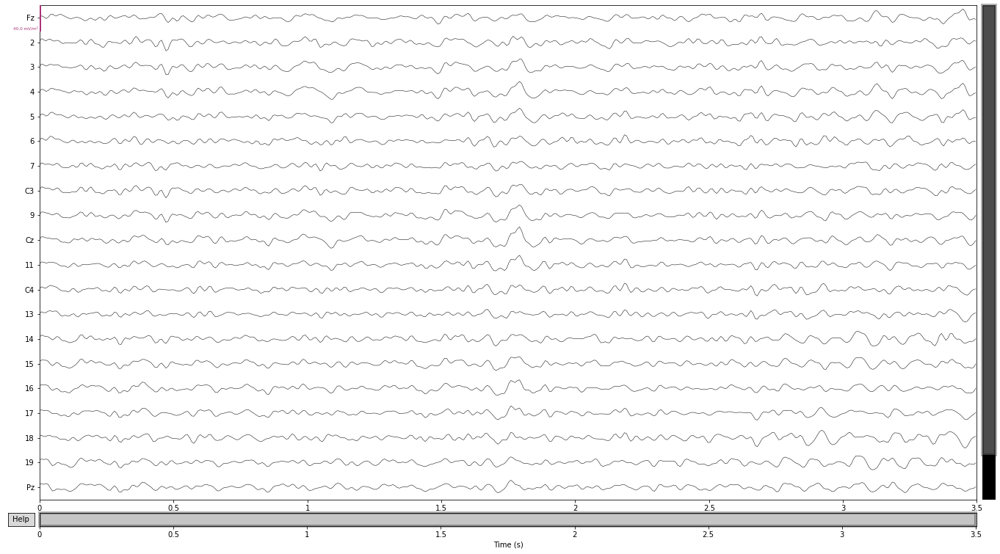

In [339]:
raw.plot();

Effective window size : 3.504 (s)


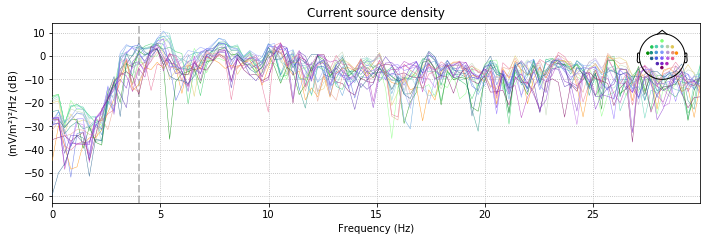

In [340]:
raw.plot_psd(fmax=30.);

In [341]:
LAPLACIAN_NEIGHBORS = {
    'Fz': ['4'],
    '2': ['3', 'C3'],
    '3': ['2', '4', '9'],
    '4': ['Fz', '3', '5', 'Cz'],
    '5': ['4', '6', '11'],
    '6': ['5', 'C4'],
    '7': ['C3'],
    'C3': ['7', '2', '9', '14'],
    '9': ['C3', '3', 'Cz', '15'],
    'Cz': ['9', '4', '11', '16'],
    '11': ['Cz', '5', 'C4', '17'],
    'C4': ['11', '6', '13', '18'],
    '13': ['C4'],
    '14': ['C3', '15'],
    '15': ['14', '9', '16', '19'],
    '16': ['15', 'Cz', '17', 'Pz'],
    '17': ['16', '11', '18', '21'],
    '18': ['17', 'C4'],
    '19': ['15', 'Pz'],
    'Pz': ['19', '16', '21', '22'],
    '21': ['Pz', '17'],
    '22': ['Pz']
}

In [342]:
def spatial_filter_laplacian_hjorth_estimate(epoch_data, info):
    transformed_timeseries = []
    for i in range(len(epoch_data)):
        electrode_raw = epoch_data[i, :].copy()
        neighbors = LAPLACIAN_NEIGHBORS[info.ch_names[i]]
        first_neighbor_idx = info.ch_names.index(neighbors[0])
        neighboring_electrodes_avg = epoch_data[first_neighbor_idx, :].copy()
        for j in range(1, len(neighbors)):
            neighbor_idx = info.ch_names.index(neighbors[j])
            neighboring_electrodes_avg += epoch_data[neighbor_idx, :].copy()
        neighboring_electrodes_avg /= len(neighbors)
        electrode_transformed = electrode_raw - neighboring_electrodes_avg
        transformed_timeseries.append(electrode_transformed)
    return np.asarray(transformed_timeseries)

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


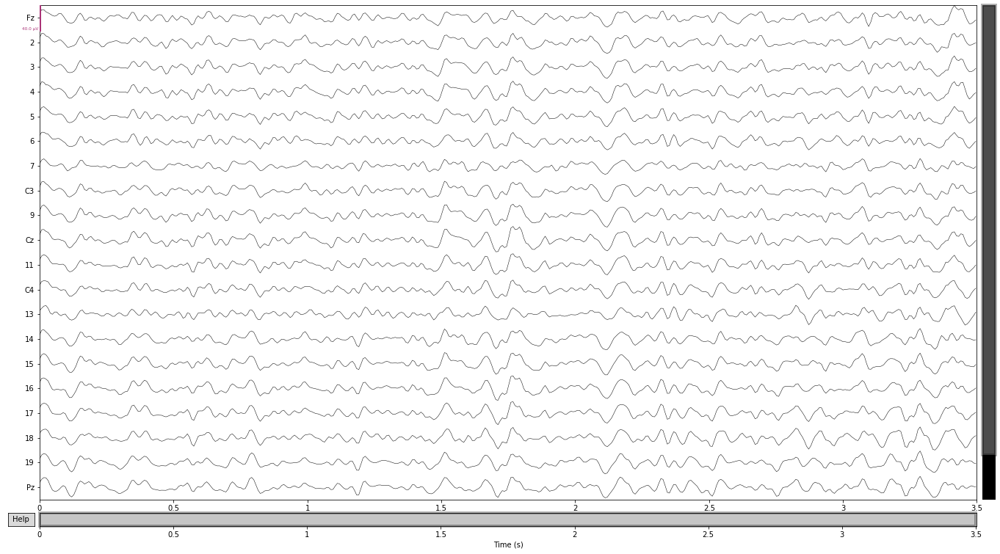

In [343]:
mne.io.RawArray(X_train[0], epochs.info, verbose=False).plot();

Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


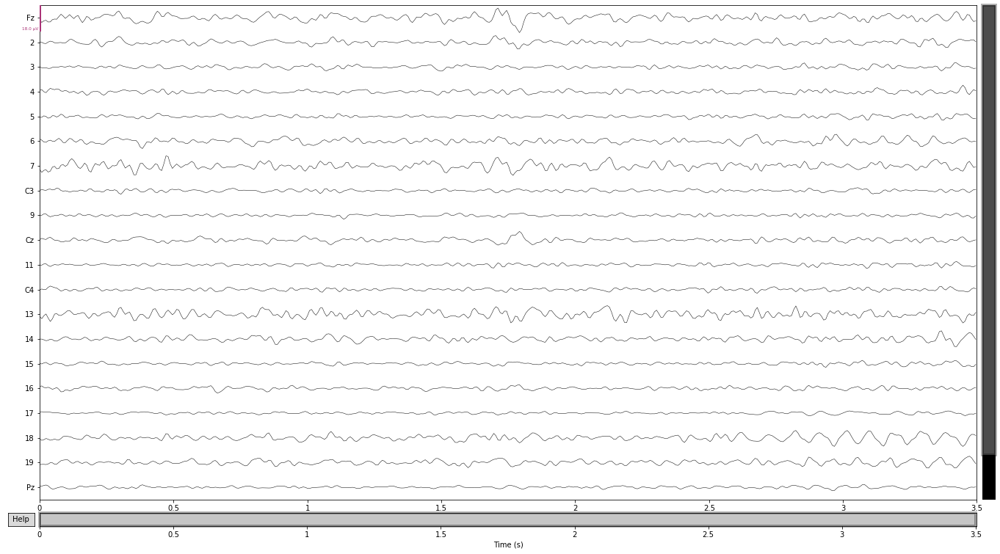

In [344]:
mne.io.RawArray(spatial_filter_laplacian_hjorth_estimate(X_train[0], epochs.info), epochs.info, verbose=False).plot(scalings=dict(eeg=9e-6));

    Using multitaper spectrum estimation with 7 DPSS windows


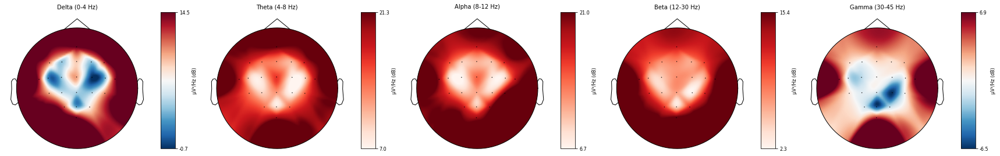

In [345]:
plot_psd_topo(spatial_filter_laplacian_hjorth_estimate(X_train[0], epochs.info), epochs.info)

In [346]:
def spatial_filter_surface_laplacian(epoch_data, info, lambda2=1e-05, stiffness=4):
    raw = mne.io.RawArray(epoch_data, info, verbose=False)
    raw = mne.preprocessing.compute_current_source_density(raw, lambda2=lambda2, stiffness=stiffness, n_legendre_terms=50)
    return raw.get_data()

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


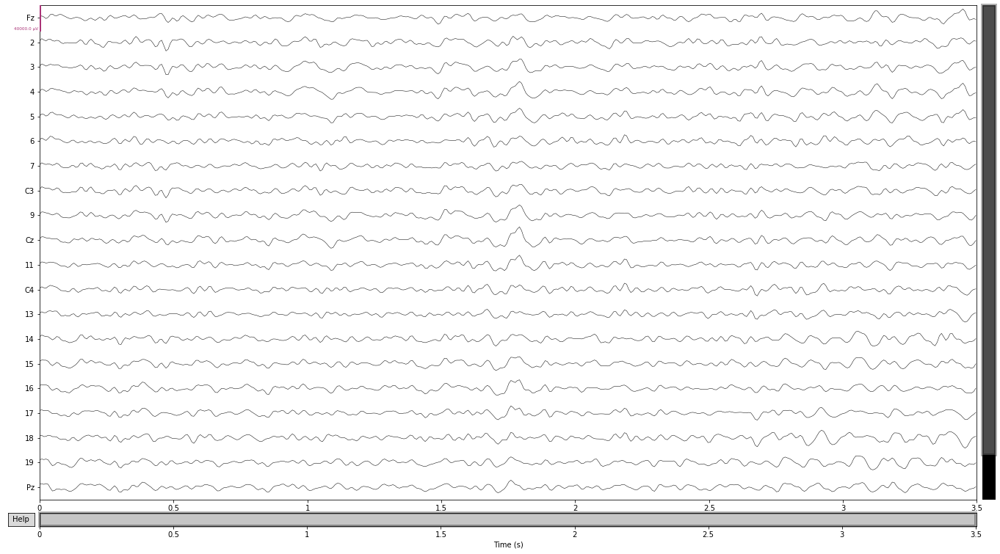

In [347]:
mne.io.RawArray(spatial_filter_surface_laplacian(X_train[0], epochs.info), epochs.info, verbose=False).plot(scalings=dict(eeg=2e-2));

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
    Using multitaper spectrum estimation with 7 DPSS windows


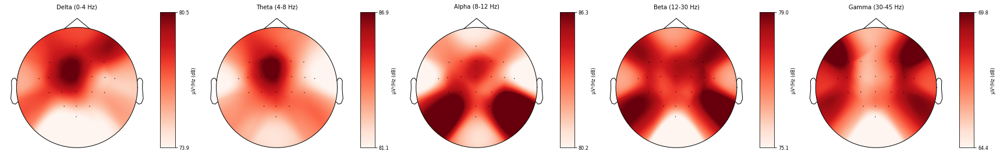

In [348]:
plot_psd_topo(spatial_filter_surface_laplacian(X_train[0], epochs.info), epochs.info)

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


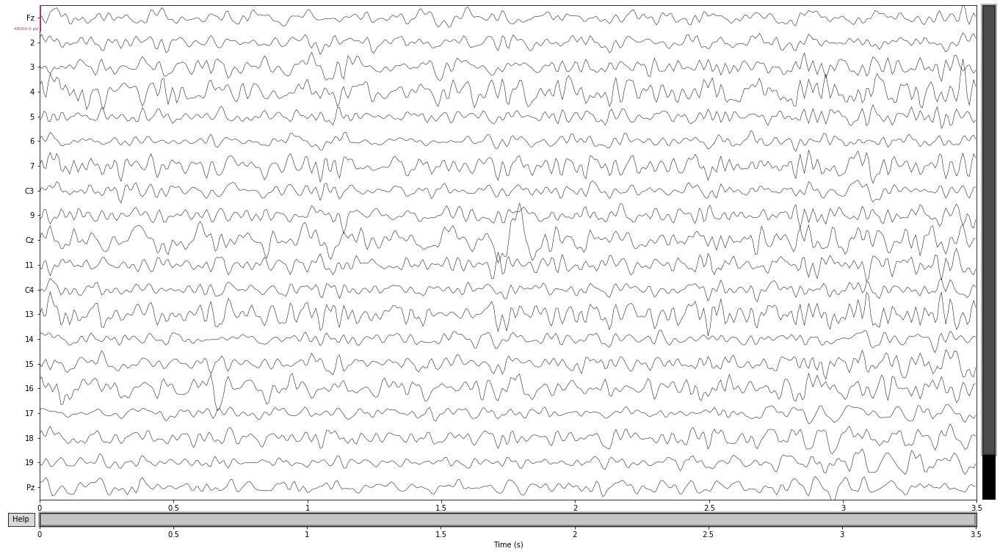

In [349]:
mne.io.RawArray(spatial_filter_surface_laplacian(X_train[0], epochs.info, lambda2=1e-08), epochs.info, verbose=False).plot(scalings=dict(eeg=2e-2));

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
    Using multitaper spectrum estimation with 7 DPSS windows


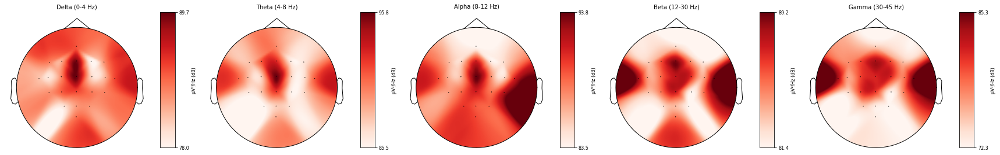

In [350]:
plot_psd_topo(spatial_filter_surface_laplacian(X_train[0], epochs.info, lambda2=1e-08), epochs.info)

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
    Using multitaper spectrum estimation with 7 DPSS windows


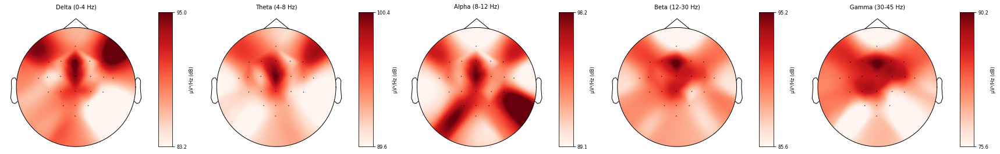

In [351]:
plot_psd_topo(spatial_filter_surface_laplacian(X_train[0], epochs.info, lambda2=1e-08, stiffness=2), epochs.info)

In [352]:
def spatial_filter_car(epoch_data):
    raw = mne.io.RawArray(epoch_data, epochs.info, verbose=False)
    raw, _ = mne.set_eeg_reference(raw, ref_channels='average', copy=True)
    return raw.get_data()

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Opening raw-browser...


C:\Users\miles\Anaconda3\lib\site-packages\matplotlib\colors.py:235: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  c = np.array(c)


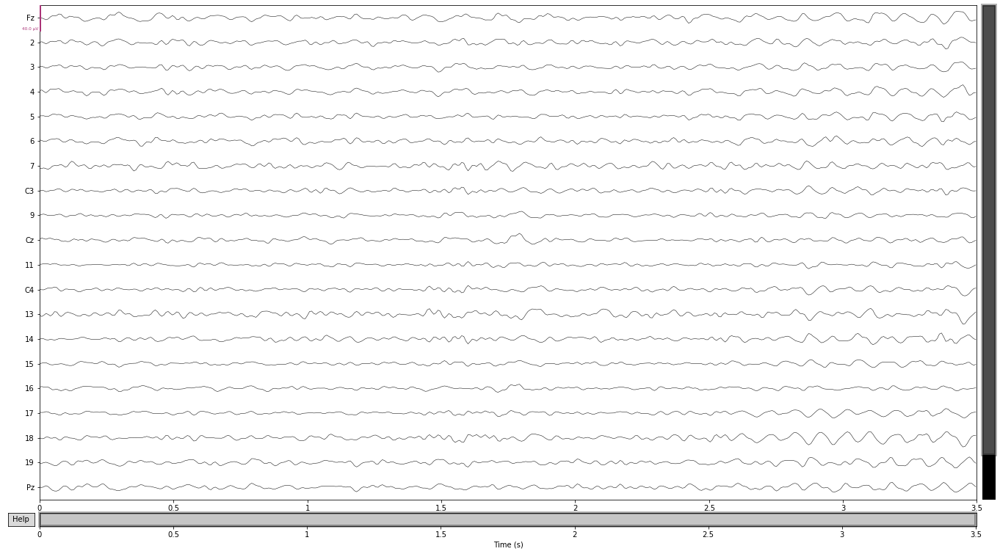

In [353]:
mne.io.RawArray(spatial_filter_car(X_train[0]), epochs.info, verbose=False).plot();

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
    Using multitaper spectrum estimation with 7 DPSS windows


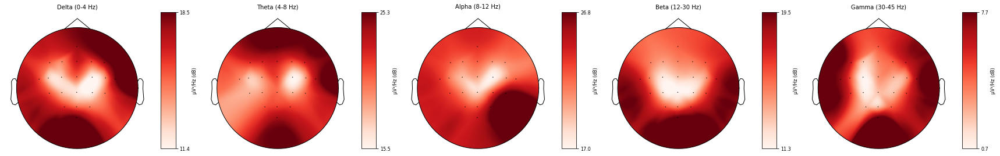

In [354]:
plot_psd_topo(spatial_filter_car(X_train[0]), epochs.info)

#### Frequency domain features

In [355]:
psds, freqs = mne.time_frequency.psd_array_multitaper(X_train[0], epochs.info['sfreq'], fmax=30, verbose=False)

In [356]:
epochs.ch_names.index('C3')

7

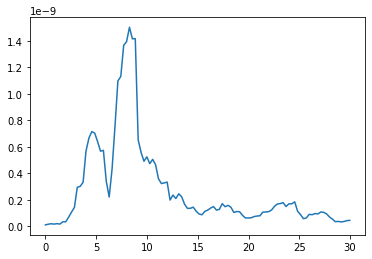

In [357]:
plt.plot(freqs, psds[epochs.ch_names.index('C3')])

In [358]:
len(psds)

22

In [359]:
num_electrodes = len(psds)
features_dict = {}
for j in range(num_electrodes):
    freqs_binned, psd_binned = bin_power_spectrum_1hz(psds[j], freqs)
    psd_binned /= sum(psd_binned)
    for k in range(len(freqs_binned)):
        ch_name = raw.ch_names[j]
        freq_bin_str = str(freqs_binned[k]) + 'Hz'
        band_power = psd_binned[k]
        feature_name = '{}_{}'.format(ch_name, freq_bin_str)
        features_dict[feature_name] = band_power

features_series = pd.Series(features_dict)

In [360]:
features_series

Fz_4Hz     0.026534
Fz_5Hz     0.059867
Fz_6Hz     0.096034
Fz_7Hz     0.126687
Fz_8Hz     0.124669
             ...   
22_25Hz    0.012699
22_26Hz    0.007950
22_27Hz    0.007054
22_28Hz    0.004110
22_29Hz    0.004990
Length: 572, dtype: float64

In [361]:
c3_series = features_series[[feature_name.startswith('C3') for feature_name in features_series.index]]
c3_series

C3_4Hz     0.030472
C3_5Hz     0.071611
C3_6Hz     0.063519
C3_7Hz     0.168772
C3_8Hz     0.195538
C3_9Hz     0.075250
C3_10Hz    0.065067
C3_11Hz    0.045361
C3_12Hz    0.028925
C3_13Hz    0.025975
C3_14Hz    0.017698
C3_15Hz    0.013937
C3_16Hz    0.018351
C3_17Hz    0.020370
C3_18Hz    0.016132
C3_19Hz    0.010641
C3_20Hz    0.009604
C3_21Hz    0.013584
C3_22Hz    0.019792
C3_23Hz    0.022533
C3_24Hz    0.021023
C3_25Hz    0.010009
C3_26Hz    0.012385
C3_27Hz    0.012665
C3_28Hz    0.005596
C3_29Hz    0.005189
dtype: float64

In [362]:
normalized_psds = psds[epochs.ch_names.index('C3')] / np.sum(psds[epochs.ch_names.index('C3')])

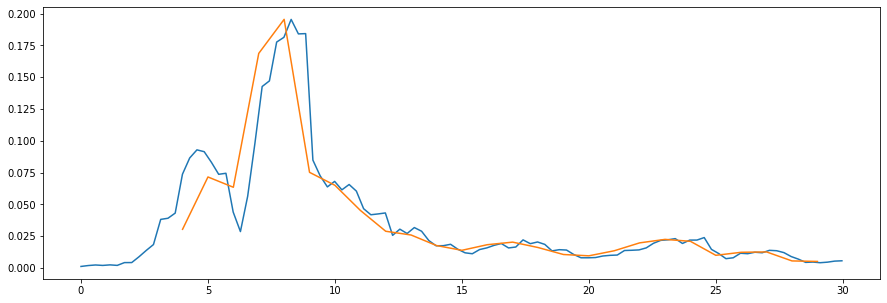

In [363]:
_, ax = plt.subplots(1, figsize=(15, 5))
ax.plot(freqs, normalized_psds * 3.8)
ax.plot(freqs_1hz_inc, c3_series)

In [364]:
def create_frequency_domain_features(epoch_data, info, normalize_band_power_within_trials=False):
    psds, freqs = mne.time_frequency.psd_array_multitaper(epoch_data, info['sfreq'], fmax=30, verbose=False)
    num_electrodes = len(psds)
    features_dict = {}
    for j in range(num_electrodes):
        freqs_binned, psd_binned = bin_power_spectrum_1hz(psds[j], freqs)
        if normalize_band_power_within_trials:
            psd_binned /= sum(psd_binned)
        for k in range(len(freqs_binned)):
            ch_name = raw.ch_names[j]
            freq_bin_str = str(freqs_binned[k]) + 'Hz'
            band_power = psd_binned[k]
            feature_name = '{}_{}'.format(ch_name, freq_bin_str)
            features_dict[feature_name] = band_power
    return features_dict

In [365]:
X_train.shape

(218, 22, 876)

In [366]:
test_features_df = pd.DataFrame([create_frequency_domain_features(epoch_data, epochs.info) for epoch_data in X_train])
test_features_df

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
0,1.657919e-10,3.740691e-10,6.000543e-10,7.915816e-10,7.789707e-10,4.398683e-10,3.622329e-10,2.743713e-10,2.638117e-10,3.391952e-10,...,7.627788e-11,7.208500e-11,9.244172e-11,1.119964e-10,1.286918e-10,1.113027e-10,6.968249e-11,6.183062e-11,3.602606e-11,4.373383e-11
1,2.687402e-10,1.203160e-09,1.175289e-09,8.559957e-10,5.865200e-10,8.927039e-10,1.397703e-09,2.335242e-09,2.072938e-09,9.598216e-10,...,1.717405e-10,2.017800e-10,1.135174e-10,7.620300e-11,1.232455e-10,1.639104e-10,1.405320e-10,1.074141e-10,7.067017e-11,8.414785e-11
2,3.121145e-10,1.350690e-09,1.348704e-09,8.092228e-10,7.401921e-10,9.211692e-10,6.389275e-10,5.108571e-10,4.089036e-10,2.697193e-10,...,2.047834e-10,1.386768e-10,1.015961e-10,1.013657e-10,1.128237e-10,1.348049e-10,1.572025e-10,1.228999e-10,5.828157e-11,7.996189e-11
3,3.368697e-10,1.103668e-09,1.224642e-09,1.005692e-09,6.420588e-10,7.993426e-10,7.204935e-10,3.881042e-10,2.653144e-10,2.446010e-10,...,1.894729e-10,2.098746e-10,1.898087e-10,7.905404e-11,4.118207e-11,6.091789e-11,1.065214e-10,1.260514e-10,1.132781e-10,1.183966e-10
4,6.155744e-10,1.589786e-09,1.179306e-09,9.281876e-10,5.640449e-10,3.522382e-10,4.672508e-10,3.188971e-10,3.460618e-10,2.643997e-10,...,1.903775e-10,1.269972e-10,7.354209e-11,1.105925e-10,1.371771e-10,7.346121e-11,4.236416e-11,5.928310e-11,5.909955e-11,4.731206e-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,3.935222e-10,1.037679e-09,6.716100e-10,3.989655e-10,4.222780e-10,4.890753e-10,4.022979e-10,3.405077e-10,2.452145e-10,2.072684e-10,...,1.219753e-10,1.039058e-10,1.016778e-10,9.171155e-11,7.942185e-11,6.434885e-11,6.574971e-11,7.111470e-11,7.830837e-11,1.416266e-10
214,3.306628e-10,9.721630e-10,9.031764e-10,8.534269e-10,7.735955e-10,4.936495e-10,4.570725e-10,3.408264e-10,2.699617e-10,2.334665e-10,...,1.493152e-10,1.138404e-10,7.747357e-11,1.279701e-10,1.651960e-10,1.297571e-10,1.101812e-10,8.264758e-11,7.199715e-11,6.749554e-11
215,3.508780e-10,1.481051e-09,1.263527e-09,9.268946e-10,6.843116e-10,3.882528e-10,6.040670e-10,1.548390e-09,1.414990e-09,3.598366e-10,...,2.819644e-10,1.894109e-10,9.202116e-11,9.023391e-11,1.143826e-10,9.410902e-11,1.239357e-10,1.085066e-10,9.467723e-11,6.992526e-11
216,2.975044e-10,7.382814e-10,7.155395e-10,4.437488e-10,3.467220e-10,3.247025e-10,4.042972e-10,4.005448e-10,1.782484e-10,1.530811e-10,...,2.418712e-10,2.143151e-10,1.980218e-10,1.265381e-10,1.456988e-10,1.343854e-10,1.205047e-10,8.068500e-11,5.322095e-11,7.306150e-11


In [367]:
test_features_df.describe()

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
count,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,...,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02,2.180000e+02
mean,4.012916e-10,8.914489e-10,8.522223e-10,7.936366e-10,6.991411e-10,6.082170e-10,5.917513e-10,5.969429e-10,4.676114e-10,2.922824e-10,...,1.816825e-10,1.575543e-10,1.435060e-10,1.349412e-10,1.279494e-10,1.165230e-10,1.060031e-10,9.924671e-11,8.946782e-11,8.128877e-11
std,1.740203e-10,3.533843e-10,3.522074e-10,3.504960e-10,3.199404e-10,2.748744e-10,3.161213e-10,3.864358e-10,2.970135e-10,1.659302e-10,...,7.039833e-11,6.046049e-11,6.472125e-11,6.157326e-11,6.114635e-11,5.233861e-11,4.609172e-11,4.301834e-11,3.827663e-11,3.209772e-11
min,1.159906e-10,2.478852e-10,1.948816e-10,2.077635e-10,1.953522e-10,1.754232e-10,1.279351e-10,9.296212e-11,1.209951e-10,8.251156e-11,...,6.138530e-11,4.126995e-11,3.492936e-11,3.012316e-11,2.214633e-11,1.715479e-11,1.533322e-11,2.741691e-11,3.602606e-11,2.468613e-11
25%,2.729752e-10,6.448672e-10,6.026758e-10,5.629060e-10,4.748978e-10,4.321653e-10,4.079825e-10,3.406208e-10,2.639500e-10,1.944842e-10,...,1.344419e-10,1.143971e-10,9.817184e-11,9.828081e-11,9.047767e-11,8.186539e-11,7.583862e-11,6.971727e-11,6.252624e-11,5.859113e-11
50%,3.642697e-10,8.365865e-10,7.803496e-10,7.432113e-10,6.444468e-10,5.425405e-10,5.058298e-10,4.756668e-10,3.943525e-10,2.491691e-10,...,1.719749e-10,1.479631e-10,1.252221e-10,1.278195e-10,1.167121e-10,1.074839e-10,9.651621e-11,8.936087e-11,8.075450e-11,7.527425e-11
75%,5.100071e-10,1.065930e-09,1.024522e-09,9.651075e-10,8.360787e-10,7.365598e-10,7.136076e-10,7.601614e-10,5.718978e-10,3.388442e-10,...,2.182778e-10,1.955206e-10,1.736177e-10,1.537561e-10,1.540506e-10,1.382410e-10,1.230606e-10,1.222648e-10,1.094346e-10,9.835330e-11
max,1.036364e-09,2.211835e-09,2.250526e-09,2.069423e-09,1.976300e-09,1.969841e-09,2.554758e-09,2.335242e-09,2.072938e-09,1.068783e-09,...,4.575809e-10,3.773747e-10,4.213502e-10,5.135059e-10,5.410388e-10,3.998811e-10,3.285977e-10,2.768515e-10,3.158242e-10,2.315819e-10


In [368]:
c3_psd = test_features_df.loc[:, test_features_df.columns.str.startswith('C3')].iloc[0, :]
c3_psd

C3_4Hz     2.250663e-10
C3_5Hz     5.289093e-10
C3_6Hz     4.691468e-10
C3_7Hz     1.246539e-09
C3_8Hz     1.444230e-09
C3_9Hz     5.557901e-10
C3_10Hz    4.805824e-10
C3_11Hz    3.350322e-10
C3_12Hz    2.136373e-10
C3_13Hz    1.918490e-10
C3_14Hz    1.307175e-10
C3_15Hz    1.029368e-10
C3_16Hz    1.355365e-10
C3_17Hz    1.504528e-10
C3_18Hz    1.191522e-10
C3_19Hz    7.859255e-11
C3_20Hz    7.093118e-11
C3_21Hz    1.003268e-10
C3_22Hz    1.461795e-10
C3_23Hz    1.664256e-10
C3_24Hz    1.552772e-10
C3_25Hz    7.392842e-11
C3_26Hz    9.147718e-11
C3_27Hz    9.354154e-11
C3_28Hz    4.133165e-11
C3_29Hz    3.832717e-11
Name: 0, dtype: float64

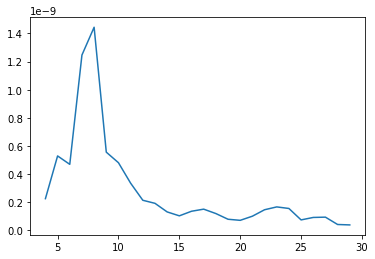

In [369]:
plt.plot(freqs_1hz_inc, c3_psd)

#### Scale features

In [370]:
test_features_df

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
0,1.657919e-10,3.740691e-10,6.000543e-10,7.915816e-10,7.789707e-10,4.398683e-10,3.622329e-10,2.743713e-10,2.638117e-10,3.391952e-10,...,7.627788e-11,7.208500e-11,9.244172e-11,1.119964e-10,1.286918e-10,1.113027e-10,6.968249e-11,6.183062e-11,3.602606e-11,4.373383e-11
1,2.687402e-10,1.203160e-09,1.175289e-09,8.559957e-10,5.865200e-10,8.927039e-10,1.397703e-09,2.335242e-09,2.072938e-09,9.598216e-10,...,1.717405e-10,2.017800e-10,1.135174e-10,7.620300e-11,1.232455e-10,1.639104e-10,1.405320e-10,1.074141e-10,7.067017e-11,8.414785e-11
2,3.121145e-10,1.350690e-09,1.348704e-09,8.092228e-10,7.401921e-10,9.211692e-10,6.389275e-10,5.108571e-10,4.089036e-10,2.697193e-10,...,2.047834e-10,1.386768e-10,1.015961e-10,1.013657e-10,1.128237e-10,1.348049e-10,1.572025e-10,1.228999e-10,5.828157e-11,7.996189e-11
3,3.368697e-10,1.103668e-09,1.224642e-09,1.005692e-09,6.420588e-10,7.993426e-10,7.204935e-10,3.881042e-10,2.653144e-10,2.446010e-10,...,1.894729e-10,2.098746e-10,1.898087e-10,7.905404e-11,4.118207e-11,6.091789e-11,1.065214e-10,1.260514e-10,1.132781e-10,1.183966e-10
4,6.155744e-10,1.589786e-09,1.179306e-09,9.281876e-10,5.640449e-10,3.522382e-10,4.672508e-10,3.188971e-10,3.460618e-10,2.643997e-10,...,1.903775e-10,1.269972e-10,7.354209e-11,1.105925e-10,1.371771e-10,7.346121e-11,4.236416e-11,5.928310e-11,5.909955e-11,4.731206e-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,3.935222e-10,1.037679e-09,6.716100e-10,3.989655e-10,4.222780e-10,4.890753e-10,4.022979e-10,3.405077e-10,2.452145e-10,2.072684e-10,...,1.219753e-10,1.039058e-10,1.016778e-10,9.171155e-11,7.942185e-11,6.434885e-11,6.574971e-11,7.111470e-11,7.830837e-11,1.416266e-10
214,3.306628e-10,9.721630e-10,9.031764e-10,8.534269e-10,7.735955e-10,4.936495e-10,4.570725e-10,3.408264e-10,2.699617e-10,2.334665e-10,...,1.493152e-10,1.138404e-10,7.747357e-11,1.279701e-10,1.651960e-10,1.297571e-10,1.101812e-10,8.264758e-11,7.199715e-11,6.749554e-11
215,3.508780e-10,1.481051e-09,1.263527e-09,9.268946e-10,6.843116e-10,3.882528e-10,6.040670e-10,1.548390e-09,1.414990e-09,3.598366e-10,...,2.819644e-10,1.894109e-10,9.202116e-11,9.023391e-11,1.143826e-10,9.410902e-11,1.239357e-10,1.085066e-10,9.467723e-11,6.992526e-11
216,2.975044e-10,7.382814e-10,7.155395e-10,4.437488e-10,3.467220e-10,3.247025e-10,4.042972e-10,4.005448e-10,1.782484e-10,1.530811e-10,...,2.418712e-10,2.143151e-10,1.980218e-10,1.265381e-10,1.456988e-10,1.343854e-10,1.205047e-10,8.068500e-11,5.322095e-11,7.306150e-11


In [371]:
MinMaxScaler().fit_transform(test_features_df)

array([[0.0541099 , 0.06425009, 0.19710251, ..., 0.13796689, 0.        ,
        0.09206423],
       [0.1659649 , 0.48640492, 0.47693434, ..., 0.32071408, 0.12381823,
        0.28739939],
       [0.21309174, 0.56152391, 0.56129467, ..., 0.38279772, 0.0795413 ,
        0.26716715],
       ...,
       [0.25520893, 0.62790113, 0.51985926, ..., 0.32509413, 0.20961958,
        0.2186566 ],
       [0.19721763, 0.24969902, 0.2532821 , ..., 0.21355534, 0.06145461,
        0.23381513],
       [0.20564824, 0.40421404, 0.29345592, ..., 0.44413966, 0.37131   ,
        0.36543076]])

#### Select k best features

In [372]:
select_k_best = SelectKBest(score_func=chi2, k=10)

In [373]:
k_best_transformed = select_k_best.fit_transform(test_features_df, y_train)
k_best_transformed

array([[2.74371286e-10, 2.77225581e-10, 3.61606105e-10, ...,
        1.03506223e-09, 4.18950290e-10, 9.22929650e-10],
       [2.33524211e-09, 2.56723566e-09, 3.13880521e-09, ...,
        1.38623869e-09, 1.17627308e-09, 9.31511878e-10],
       [5.10857132e-10, 6.36812922e-10, 6.80699055e-10, ...,
        1.40711997e-09, 1.20184874e-09, 1.75081955e-09],
       ...,
       [1.54838995e-09, 1.72797101e-09, 1.65330984e-09, ...,
        4.18186264e-10, 4.69537333e-10, 6.25950547e-10],
       [4.00544792e-10, 4.29537367e-10, 4.50991301e-10, ...,
        2.70401947e-10, 3.57979432e-10, 7.40669751e-10],
       [4.80427345e-10, 6.07198626e-10, 5.40288988e-10, ...,
        4.14960409e-10, 6.52374725e-10, 5.20967808e-10]])

In [374]:
k_best_transformed.shape

(218, 10)

In [375]:
test_features_df.columns[select_k_best.get_support()]

Index(['Fz_11Hz', '3_11Hz', '4_11Hz', 'C3_11Hz', '14_10Hz', '14_11Hz',
       '14_12Hz', '18_11Hz', '18_12Hz', '19_10Hz'],
      dtype='object')

#### Train a classifier

In [376]:
svm = LinearSVC(dual=False)

In [377]:
cv_results = cross_validate(svm, k_best_transformed, y_train, return_train_score=True)
cv_results

{'fit_time': array([0.00099754, 0.00099564, 0.00099897, 0.00099921, 0.00100017]),
 'score_time': array([0.00100183, 0.00099969, 0.00100207, 0.00099945, 0.        ]),
 'test_score': array([0.27272727, 0.27272727, 0.27272727, 0.27906977, 0.25581395]),
 'train_score': array([0.27011494, 0.27011494, 0.27011494, 0.26857143, 0.27428571])}

#### Put it all into a Pipeline

In [378]:
from sklearn.base import BaseEstimator, TransformerMixin

In [379]:
class SpatialFilterCAR(BaseEstimator, TransformerMixin):
    def __init__(self):
        super().__init__()

    @staticmethod
    def _spatial_filter_car(epoch_data):
        raw = mne.io.RawArray(epoch_data, epochs.info, verbose=False)
        raw, _ = mne.set_eeg_reference(raw, ref_channels='average', copy=True, verbose=False)
        return raw.get_data()

    def fit(self, X, y=None, **fit_params):
        return self

    def transform(self, X, y=None, **fit_params):
        return [SpatialFilterCAR._spatial_filter_car(epoch_data) for epoch_data in X]

In [380]:
class SpatialFilterHjorthLaplacian(BaseEstimator, TransformerMixin):
    def __init__(self):
        super().__init__()

    @staticmethod
    def _spatial_filter_laplacian_hjorth_estimate(epoch_data, info):
        transformed_timeseries = []
        for i in range(len(epoch_data)):
            electrode_raw = epoch_data[i, :].copy()
            neighbors = LAPLACIAN_NEIGHBORS[info.ch_names[i]]
            first_neighbor_idx = info.ch_names.index(neighbors[0])
            neighboring_electrodes_avg = epoch_data[first_neighbor_idx, :].copy()
            for j in range(1, len(neighbors)):
                neighbor_idx = info.ch_names.index(neighbors[j])
                neighboring_electrodes_avg += epoch_data[neighbor_idx, :].copy()
            neighboring_electrodes_avg /= len(neighbors)
            electrode_transformed = electrode_raw - neighboring_electrodes_avg
            transformed_timeseries.append(electrode_transformed)
        return np.asarray(transformed_timeseries)

    def fit(self, X, y=None, **fit_params):
        return self

    def transform(self, X, y=None, **fit_params):
        return [SpatialFilterHjorthLaplacian._spatial_filter_laplacian_hjorth_estimate(epoch_data, epochs.info) for epoch_data in X]

In [381]:
class SpatialFilterSurfaceLaplacian(BaseEstimator, TransformerMixin):
    def __init__(self, lambda2=1e-05, stiffness=4):
        super().__init__()
        self.lambda2 = lambda2
        self.stiffness = stiffness

    def _spatial_filter_surface_laplacian(self, epoch_data, info):
        raw = mne.io.RawArray(epoch_data, info, verbose=False)
        raw = mne.preprocessing.compute_current_source_density(raw, lambda2=self.lambda2, stiffness=self.stiffness, n_legendre_terms=50)
        return raw.get_data()

    def fit(self, X, y=None, **fit_params):
        return self

    def transform(self, X, y=None, **fit_params):
        return [self._spatial_filter_surface_laplacian(epoch_data, epochs.info) for epoch_data in X]

In [382]:
test_pipeline = Pipeline([('spatial_filter', SpatialFilterSurfaceLaplacian())])

In [383]:
test_pipeline

Pipeline(steps=[('spatial_filter', SpatialFilterSurfaceLaplacian())])

In [384]:
X_transformed = test_pipeline.fit_transform(X_train, y_train)

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

In [385]:
len(X_transformed)

218

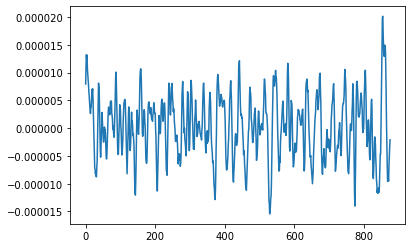

In [386]:
plt.plot(X_train[0][0])

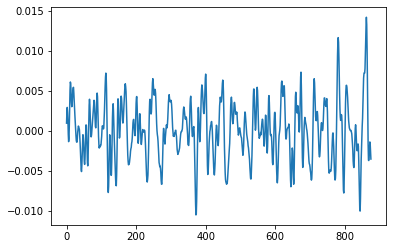

In [387]:
plt.plot(X_transformed[0][0])

In [388]:
class FrequencyDomainTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        super().__init__()

    @staticmethod
    def _create_frequency_domain_features(epoch_data, info):
        psds, freqs = mne.time_frequency.psd_array_multitaper(epoch_data, info['sfreq'], fmax=30, verbose=False)
        num_electrodes = len(psds)
        features_dict = {}
        for j in range(num_electrodes):
            freqs_binned, psd_binned = bin_power_spectrum_1hz(psds[j], freqs)
            psd_binned /= sum(psd_binned)
            for k in range(len(freqs_binned)):
                ch_name = raw.ch_names[j]
                freq_bin_str = str(freqs_binned[k]) + 'Hz'
                band_power = psd_binned[k]
                feature_name = '{}_{}'.format(ch_name, freq_bin_str)
                features_dict[feature_name] = band_power
        return features_dict

    def fit(self, X, y=None, **fit_params):
        return self

    def transform(self, X, y=None, **fit_params):
        return pd.DataFrame([FrequencyDomainTransformer._create_frequency_domain_features(epoch_data, epochs.info) for epoch_data in X])

In [389]:
test_pipeline = Pipeline([('frequency_domain_transformer', FrequencyDomainTransformer())])

In [390]:
X_transformed = test_pipeline.fit_transform(X_transformed, y_train)

In [391]:
X_transformed

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
0,0.043801,0.159566,0.114390,0.075804,0.072852,0.072895,0.059384,0.039209,0.034854,0.044464,...,0.010817,0.008960,0.010581,0.011980,0.010147,0.009212,0.008948,0.009978,0.010648,0.013385
1,0.015363,0.113870,0.095455,0.046054,0.026876,0.028453,0.093979,0.201951,0.170012,0.047525,...,0.015775,0.012162,0.007104,0.011573,0.017674,0.014965,0.014575,0.014862,0.006439,0.009962
2,0.059830,0.133847,0.130977,0.077180,0.062517,0.107160,0.115174,0.067107,0.029051,0.021496,...,0.017337,0.010289,0.007481,0.007181,0.005618,0.002856,0.005599,0.009046,0.013071,0.016676
3,0.032751,0.123898,0.115061,0.098779,0.058948,0.091441,0.097823,0.079696,0.059136,0.025700,...,0.017863,0.013316,0.013646,0.013305,0.009801,0.012894,0.018485,0.018215,0.011092,0.006684
4,0.050823,0.192289,0.120591,0.063841,0.033390,0.025857,0.030347,0.022578,0.021548,0.021538,...,0.017861,0.016778,0.027770,0.038155,0.030987,0.017487,0.017441,0.018902,0.017513,0.009965
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,0.046858,0.173607,0.137399,0.112188,0.105274,0.076899,0.064703,0.044527,0.030924,0.024787,...,0.016845,0.020060,0.019021,0.024727,0.020006,0.011375,0.010742,0.022391,0.021828,0.016005
214,0.054128,0.075237,0.104247,0.120215,0.115990,0.086340,0.049751,0.045428,0.058806,0.045915,...,0.032181,0.034174,0.015622,0.020828,0.017642,0.009270,0.012273,0.011336,0.012260,0.015085
215,0.030469,0.125807,0.081026,0.064013,0.044375,0.025951,0.039246,0.181205,0.195704,0.043943,...,0.018235,0.018912,0.023670,0.033798,0.035810,0.025146,0.022169,0.010425,0.006655,0.004822
216,0.058170,0.139725,0.124625,0.090559,0.053789,0.041429,0.067539,0.085435,0.049910,0.018690,...,0.031541,0.035858,0.028960,0.021334,0.015720,0.011990,0.012780,0.007060,0.006825,0.010861


In [392]:
pipeline = Pipeline([
    ('spatial_filter', None),
    ('frequency_domain_transformer', FrequencyDomainTransformer()),
    ('scaler', None),
    ('select_k_best', SelectKBest(score_func=chi2, k=30)),
    ('classifier', LinearSVC())
])

## Run grid search on the pipeline

### Grid search for optimal preprocessing
Adding preprocessing steps like spatial filtering and extracting frequency domain features to the pipeline makes it more expensive to run, so let's start by using only one classifier, an SVM, and trying to find the best performing preprocessing params.

In [398]:
hyperparams = {
    'spatial_filter': [
        None, SpatialFilterCAR(), SpatialFilterHjorthLaplacian(),
        SpatialFilterSurfaceLaplacian(lambda2=1e-03, stiffness=3),
        SpatialFilterSurfaceLaplacian(lambda2=1e-05, stiffness=4),
        SpatialFilterSurfaceLaplacian(lambda2=1e-08, stiffness=4),
        SpatialFilterSurfaceLaplacian(lambda2=1e-08, stiffness=2)
    ],
    'scaler': [None, MinMaxScaler()],
}

In [397]:
clf = GridSearchCV(pipeline, hyperparams, verbose=2, return_train_score=True)
clf.fit(X_train, y_train)

Fitting 5 folds for each of 14 candidates, totalling 70 fits
[CV] scaler=None, spatial_filter=None ................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV] ................. scaler=None, spatial_filter=None, total=   2.7s
[CV] scaler=None, spatial_filter=None ................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.7s remaining:    0.0s


[CV] ................. scaler=None, spatial_filter=None, total=   2.7s
[CV] scaler=None, spatial_filter=None ................................
[CV] ................. scaler=None, spatial_filter=None, total=   2.7s
[CV] scaler=None, spatial_filter=None ................................
[CV] ................. scaler=None, spatial_filter=None, total=   2.7s
[CV] scaler=None, spatial_filter=None ................................
[CV] ................. scaler=None, spatial_filter=None, total=   2.7s
[CV] scaler=None, spatial_filter=SpatialFilterCAR() ..................
[CV] ... scaler=None, spatial_filter=SpatialFilterCAR(), total=   3.3s
[CV] scaler=None, spatial_filter=SpatialFilterCAR() ..................
[CV] ... scaler=None, spatial_filter=SpatialFilterCAR(), total=   3.3s
[CV] scaler=None, spatial_filter=SpatialFilterCAR() ..................
[CV] ... scaler=None, spatial_filter=SpatialFilterCAR(), total=   3.6s
[CV] scaler=None, spatial_filter=SpatialFilterCAR() ..................
[CV] .

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV]  scaler=None, spatial_filter=SpatialFilterSurfaceLaplacian(), total=  10.3s
[CV] scaler=None, spatial_filter=SpatialFilterSurfaceLaplacian() .....
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin de

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV]  scaler=None, spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08), total=  10.3s
[CV] scaler=None, spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08) 
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

[CV]  scaler=None, spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08), total=  10.3s
[CV] scaler=None, spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08, stiffness=2) 
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius: 

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV]  scaler=MinMaxScaler(), 

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV]  scaler=MinMaxScaler(), spatial_filter=SpatialFilterSurfaceLaplacian(), total=559.9min
[CV] scaler=MinMaxScaler(), spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08) 
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:      

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV]  scaler=MinMaxScaler(), spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08), total=   9.6s
[CV] scaler=MinMaxScaler(), spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08) 
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device c

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

[CV]  scaler=MinMaxScaler(), spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08, stiffness=2), total=   9.7s
[CV] scaler=MinMaxScaler(), spatial_filter=SpatialFilterSurfaceLaplacian(lambda2=1e-08, stiffness=2) 
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

[Parallel(n_jobs=1)]: Done  70 out of  70 | elapsed: 587.4min finished


Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

GridSearchCV(estimator=Pipeline(steps=[('spatial_filter', None),
                                       ('frequency_domain_transformer',
                                        FrequencyDomainTransformer()),
                                       ('scaler', None),
                                       ('select_k_best',
                                        SelectKBest(k=30,
                                                    score_func=<function chi2 at 0x00000266AAAC22F0>)),
                                       ('classifier', LinearSVC())]),
             param_grid={'scaler': [None, MinMaxScaler()],
                         'spatial_filter': [None, SpatialFilterCAR(),
                                            SpatialFilterHjorthLaplacian(),
                                            SpatialFilterSurfaceLaplacian(lambda2=0.001,
                                                                          stiffness=3),
                                            SpatialFilterSurface

In [410]:
common_columns_no_k = common_interesting_columns.copy()
common_columns_no_k.remove('param_feature_selector__k')
interesting_columns = ['param_spatial_filter'] + common_columns_no_k
interesting_columns

['param_spatial_filter',
 'param_scaler',
 'rank_test_score',
 'mean_test_score',
 'mean_train_score']

In [413]:
pd.DataFrame(clf.cv_results_)[interesting_columns].sort_values('rank_test_score')

,param_spatial_filter,param_scaler,rank_test_score,mean_test_score,mean_train_score
12,SpatialFilterSurfaceLaplacian(lambda2=1e-08),MinMaxScaler(),1,0.770296,0.853235
2,SpatialFilterHjorthLaplacian(),None,2,0.761522,0.800453
13,"SpatialFilterSurfaceLaplacian(lambda2=1e-08, s...",MinMaxScaler(),3,0.743129,0.834877
5,SpatialFilterSurfaceLaplacian(lambda2=1e-08),None,4,0.738372,0.748854
9,SpatialFilterHjorthLaplacian(),MinMaxScaler(),5,0.729598,0.868118
6,"SpatialFilterSurfaceLaplacian(lambda2=1e-08, s...",None,6,0.715645,0.762601
8,SpatialFilterCAR(),MinMaxScaler(),7,0.705920,0.821077
11,SpatialFilterSurfaceLaplacian(),MinMaxScaler(),8,0.692178,0.794693
1,SpatialFilterCAR(),None,9,0.678541,0.726982
10,"SpatialFilterSurfaceLaplacian(lambda2=0.001, s...",MinMaxScaler(),10,0.678330,0.772906


Looks like the surface Laplacian filter has some potential, we can do a more intense grid search on it to see whether we can find an effective pair of parameters.

In [417]:
pipeline = Pipeline([
    ('laplacian', SpatialFilterSurfaceLaplacian()),
    ('frequency_domain_transformer', FrequencyDomainTransformer()),
    ('scaler', MinMaxScaler()),
    ('select_k_best', SelectKBest(score_func=chi2, k=30)),
    ('classifier', LinearSVC())
])

In [420]:
hyperparams = {
    'laplacian__lambda2': [0, 1e-10, 1e-09, 1e-08, 1e-07, 1e-05, 1e-03, 1e-02, 1, 2],
    'laplacian__stiffness': [0, 1, 2, 3, 4, 5, 6, 7, 8]
}

In [421]:
clf = GridSearchCV(pipeline, hyperparams, verbose=2, return_train_score=True)
clf.fit(X_train, y_train)

Fitting 5 folds for each of 90 candidates, totalling 450 fits
[CV] laplacian__lambda2=0, laplacian__stiffness=0 ....................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   16.9s remaining:    0.0s


Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] ..... laplacian__lambda2=0, laplacian__stiffness=1, total=   9.7s
[CV] laplacian__lambda2=0, laplacian__stiffness=1 ....................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] ..... laplacian__lambda2=0, laplacian__stiffness=2, total=   9.8s
[CV] laplacian__lambda2=0, laplacian__stiffness=2 ....................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] ..... laplacian__lambda2=0, laplacian__stiffness=5, total=  10.1s
[CV] laplacian__lambda2=0, laplacian__stiffness=5 ....................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] ..... laplacian__lambda2=0, laplacian__stiffness=5, total=   9.7s
[CV] laplacian__lambda2=0, laplacian__stiffness=6 ....................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-10, laplacian__stiffness=0, total=   9.7s
[CV] laplacian__lambda2=1e-10, laplacian__stiffness=0 ................
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-10, laplacian__stiffness=0, total=   9.0s
[CV] laplacian__lambda2=1e-10, laplacian__stiffness=0 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-10, laplacian__stiffness=3, total=   9.0s
[CV] laplacian__lambda2=1e-10, laplacian__stiffness=4 ................
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-10, laplacian__stiffness=4, total=   9.0s
[CV] laplacian__lambda2=1e-10, laplacian__stiffness=4 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-10, laplacian__stiffness=7, total=  10.8s
[CV] laplacian__lambda2=1e-10, laplacian__stiffness=7 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-10, laplacian__stiffness=8, total=   9.7s
[CV] laplacian__lambda2=1e-10, laplacian__stiffness=8 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-09, laplacian__stiffness=2, total=   9.7s
[CV] laplacian__lambda2=1e-09, laplacian__stiffness=2 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-09, laplacian__stiffness=3, total=  10.3s
[CV] laplacian__lambda2=1e-09, laplacian__stiffness=3 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-09, laplacian__stiffness=6, total=  12.4s
[CV] laplacian__lambda2=1e-09, laplacian__stiffness=6 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-09, laplacian__stiffness=6, total=   9.7s
[CV] laplacian__lambda2=1e-09, laplacian__stiffness=7 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-08, laplacian__stiffness=1, total=   9.4s
[CV] laplacian__lambda2=1e-08, laplacian__stiffness=1 ................
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-08, laplacian__stiffness=1, total=   9.3s
[CV] laplacian__lambda2=1e-08, laplacian__stiffness=1 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-08, laplacian__stiffness=4, total=  10.3s
[CV] laplacian__lambda2=1e-08, laplacian__stiffness=5 ................
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-08, laplacian__stiffness=5, total=  10.2s
[CV] laplacian__lambda2=1e-08, laplacian__stiffness=5 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-08, laplacian__stiffness=8, total=  10.1s
[CV] laplacian__lambda2=1e-08, laplacian__stiffness=8 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-07, laplacian__stiffness=0, total=  10.4s
[CV] laplacian__lambda2=1e-07, laplacian__stiffness=0 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-07, laplacian__stiffness=3, total=   9.3s
[CV] laplacian__lambda2=1e-07, laplacian__stiffness=3 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-07, laplacian__stiffness=4, total=   9.4s
[CV] laplacian__lambda2=1e-07, laplacian__stiffness=4 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-07, laplacian__stiffness=7, total=   9.6s
[CV] laplacian__lambda2=1e-07, laplacian__stiffness=7 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-07, laplacian__stiffness=7, total=   9.2s
[CV] laplacian__lambda2=1e-07, laplacian__stiffness=8 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-05, laplacian__stiffness=2, total=   9.2s
[CV] laplacian__lambda2=1e-05, laplacian__stiffness=2 ................
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-05, laplacian__stiffness=2, total=   9.3s
[CV] laplacian__lambda2=1e-05, laplacian__stiffness=2 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-05, laplacian__stiffness=5, total=   9.3s
[CV] laplacian__lambda2=1e-05, laplacian__stiffness=6 ................
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=1e-05, laplacian__stiffness=6, total=   9.3s
[CV] laplacian__lambda2=1e-05, laplacian__stiffness=6 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=0.001, laplacian__stiffness=0, total=   9.2s
[CV] laplacian__lambda2=0.001, laplacian__stiffness=0 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=0.001, laplacian__stiffness=1, total=   9.5s
[CV] laplacian__lambda2=0.001, laplacian__stiffness=1 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=0.001, laplacian__stiffness=4, total=  10.5s
[CV] laplacian__lambda2=0.001, laplacian__stiffness=4 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=0.001, laplacian__stiffness=5, total=  10.3s
[CV] laplacian__lambda2=0.001, laplacian__stiffness=5 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=0.001, laplacian__stiffness=8, total=  10.3s
[CV] laplacian__lambda2=0.001, laplacian__stiffness=8 ................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] . laplacian__lambda2=0.001, laplacian__stiffness=8, total=  10.6s
[CV] laplacian__lambda2=0.01, laplacian__stiffness=0 .................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] .. laplacian__lambda2=0.01, laplacian__stiffness=3, total=  10.5s
[CV] laplacian__lambda2=0.01, laplacian__stiffness=3 .................
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] .. laplacian__lambda2=0.01, laplacian__stiffness=3, total=  10.4s
[CV] laplacian__lambda2=0.01, laplacian__stiffness=3 .................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] .. laplacian__lambda2=0.01, laplacian__stiffness=6, total=   9.6s
[CV] laplacian__lambda2=0.01, laplacian__stiffness=7 .................
Fitted sphere radiu

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
[CV] .. laplacian__lambda2=0.01, laplacian__stiffness=7, total=   9.4s
[CV] laplacian__lambda2=0.01, laplacian__stiffness=7 .................
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:    

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\miles\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\miles\Anaconda3\lib\site-packages\sklearn\pipeline.py", line 330, in fit
    Xt = self._fit(X, y, **fit_params_steps)
  File "C:\Users\miles\Anaconda3\lib\site-packages\sklearn\pipeline.py", line 296, in _fit
    **fit_params_steps[name])
  File "C:\Users\miles\Anaconda3\lib\site-packages\joblib\memory.py", line 352, in __call__
    return self.func(*args, **kwargs)
  File "C:\Users\miles\Anaconda3\lib\site-packages\sklearn\pipeline.py", line 740, in _fit_transform_one
    res = transformer.fit_transform(X, y, **fit_params)
  File "C:\Users\miles\Anaconda


[CV] ..... laplacian__lambda2=1, laplacian__stiffness=2, total=   0.0s
[CV] laplacian__lambda2=1, laplacian__stiffness=2 ....................
[CV] ..... laplacian__lambda2=1, laplacian__stiffness=2, total=   0.0s
[CV] laplacian__lambda2=1, laplacian__stiffness=2 ....................
[CV] ..... laplacian__lambda2=1, laplacian__stiffness=2, total=   0.0s
[CV] laplacian__lambda2=1, laplacian__stiffness=2 ....................
[CV] ..... laplacian__lambda2=1, laplacian__stiffness=2, total=   0.0s
[CV] laplacian__lambda2=1, laplacian__stiffness=2 ....................
[CV] ..... laplacian__lambda2=1, laplacian__stiffness=2, total=   0.0s
[CV] laplacian__lambda2=1, laplacian__stiffness=3 ....................
[CV] ..... laplacian__lambda2=1, laplacian__stiffness=3, total=   0.0s
[CV] laplacian__lambda2=1, laplacian__stiffness=3 ....................
[CV] ..... laplacian__lambda2=1, laplacian__stiffness=3, total=   0.0s
[CV] laplacian__lambda2=1, laplacian__stiffness=3 ....................
[CV] 

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\miles\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\miles\Anaconda3\lib\site-packages\sklearn\pipeline.py", line 330, in fit
    Xt = self._fit(X, y, **fit_params_steps)
  File "C:\Users\miles\Anaconda3\lib\site-packages\sklearn\pipeline.py", line 296, in _fit
    **fit_params_steps[name])
  File "C:\Users\miles\Anaconda3\lib\site-packages\joblib\memory.py", line 352, in __call__
    return self.func(*args, **kwargs)
  File "C:\Users\miles\Anaconda3\lib\site-packages\sklearn\pipeline.py", line 740, in _fit_transform_one
    res = transformer.fit_transform(X, y, **fit_params)
  File "C:\Users\miles\Anaconda

[CV] ..... laplacian__lambda2=2, laplacian__stiffness=0, total=   0.0s
[CV] laplacian__lambda2=2, laplacian__stiffness=0 ....................
[CV] ..... laplacian__lambda2=2, laplacian__stiffness=0, total=   0.0s
[CV] laplacian__lambda2=2, laplacian__stiffness=0 ....................
[CV] ..... laplacian__lambda2=2, laplacian__stiffness=0, total=   0.0s
[CV] laplacian__lambda2=2, laplacian__stiffness=1 ....................
[CV] ..... laplacian__lambda2=2, laplacian__stiffness=1, total=   0.0s
[CV] laplacian__lambda2=2, laplacian__stiffness=1 ....................
[CV] ..... laplacian__lambda2=2, laplacian__stiffness=1, total=   0.0s
[CV] laplacian__lambda2=2, laplacian__stiffness=1 ....................
[CV] ..... laplacian__lambda2=2, laplacian__stiffness=1, total=   0.0s
[CV] laplacian__lambda2=2, laplacian__stiffness=1 ....................
[CV] ..... laplacian__lambda2=2, laplacian__stiffness=1, total=   0.0s
[CV] laplacian__lambda2=2, laplacian__stiffness=1 ....................
[CV] .

[Parallel(n_jobs=1)]: Done 450 out of 450 | elapsed: 105.9min finished


Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:        

Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9

Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:    -0.7 9.9 58.4 mm
Fitted sphere radius:         85.2 mm
Origin head coordinates:      -0.7 9.9 58.4 mm
Origin device coordinates:   

GridSearchCV(estimator=Pipeline(steps=[('laplacian',
                                        SpatialFilterSurfaceLaplacian()),
                                       ('frequency_domain_transformer',
                                        FrequencyDomainTransformer()),
                                       ('scaler', None),
                                       ('select_k_best',
                                        SelectKBest(k=30,
                                                    score_func=<function chi2 at 0x00000266AAAC22F0>)),
                                       ('classifier', LinearSVC())]),
             param_grid={'laplacian__lambda2': [0, 1e-10, 1e-09, 1e-08, 1e-07,
                                                1e-05, 0.001, 0.01, 1, 2],
                         'laplacian__stiffness': [0, 1, 2, 3, 4, 5, 6, 7, 8]},
             return_train_score=True, verbose=2)

In [427]:
interesting_columns = [
    'param_laplacian__lambda2', 'param_laplacian__stiffness', 
    'rank_test_score', 'mean_test_score', 'mean_train_score'
]

In [428]:
pd.DataFrame(clf.cv_results_)[interesting_columns].sort_values('rank_test_score')

,param_laplacian__lambda2,param_laplacian__stiffness,rank_test_score,mean_test_score,mean_train_score
1,0,1,1,0.756554,0.800447
28,0.0,1,1,0.756554,0.800447
37,0.0,1,1,0.756554,0.800447
19,0.0,1,1,0.756554,0.800447
46,0.00001,1,1,0.756554,0.800447
55,0.001,1,1,0.756554,0.800447
10,0.0,1,1,0.756554,0.800447
64,0.01,1,8,0.752008,0.796998
56,0.001,2,9,0.743129,0.774069
65,0.01,2,10,0.742706,0.782095


#### Looks like my unscaled Hjorth Laplacian estimate is the best.
None of these actual surface Laplacians beat the mean test score of 76.1% acheived by my Hjorth estimate.

### Update preprocessing method with spatial filter
We'll run this method prior to grid searching for the best model. I'm also going to change it to not perform baseline normalization, I think that this might only be useful for ERP studies.

In [393]:
def prepare_subject_data(subject_no, train_or_test='train', baseline_normalize=False, 
                         regress_eog_artifacts=True, normalize_band_power_within_trials=True):
    # 1. Read file into an mne.Raw structure
    raw = mne.io.read_raw_gdf(
        get_data_path(subject_no, train_or_test), eog=['EOG-left', 'EOG-central', 'EOG-right'], preload=True
    )

    # 2. Rename annotations from numeric codes to readable descriptions
    raw.annotations.rename({
        '276': 'idle_eyes_open',
        '277': 'idle_eyes_closed',
        '768': 'trial_start',
        '769': 'cue_left',
        '770': 'cue_right',
        '771': 'cue_foot',
        '772': 'cue_tongue',
        # '783': 'cue_unknown',
        '1023': 'trial_rejected',
        '1072': 'idle_eye_movements',
        '32766': 'run_start'
    }).rename({'3idle_eyes_open6': 'run_start'});

    # 3. Rename EEG channels to match diagram from dataset description
    raw.rename_channels({
        'EEG-0': '2', 'EEG-1': '3', 'EEG-2': '4', 'EEG-3': '5', 'EEG-4': '6', 
        'EEG-5': '7', 'EEG-6': '9', 'EEG-7': '11', 'EEG-8': '13', 'EEG-9': '14',
        'EEG-10': '15', 'EEG-11': '16', 'EEG-12': '17', 'EEG-13': '18', 'EEG-14': '19',
        'EEG-15': '21', 'EEG-16': '22', 'EEG-Fz': 'Fz', 'EEG-C3': 'C3', 'EEG-Cz': 'Cz',
        'EEG-C4': 'C4', 'EEG-Pz': 'Pz'
    })

    # 4. Extract annotations into events, then remove annotations from Raw instance
    events, event_id = mne.events_from_annotations(raw)
    raw.set_annotations(None)
    event_id_inv = {v: k for k, v in event_id.items()}
    
    # 5. Apply bandpass filter
    raw.filter(4, 30, picks=['eeg'])
    
    # 6. Apply spatial filter (Laplacian Hjorth estimate)
    raw = spatial_filter_laplacian(raw)

    # 7. Epoch data (mne.Raw -> mne.Epochs)
    cue_event_ids = {e_id for e_name, e_id in event_id.items() if e_name.startswith('cue')}
    cue_events = np.array([event for event in events if event[2] in cue_event_ids])
    trial_event_id = {e_name: e_id for e_name, e_id in event_id.items() if e_name.startswith('cue')}
    baseline = (None, 0) if baseline_normalize else None
    epochs = mne.Epochs(raw, cue_events, event_id=trial_event_id, tmin=-2., tmax=4, baseline=baseline, preload=True)

    # 8. Regress EOG artifacts
    if regress_eog_artifacts:
        mne.preprocessing.regress_artifact(epochs, copy=False)
    epochs.drop_channels(['EOG-left', 'EOG-central', 'EOG-right'])
    
    # 9. Set channel montage
    epochs.set_montage(study_montage)

    # 10. Remove trials marked as bad
    trial_rejected_events = events[events[:, 2] == event_id['trial_rejected']]
    rejected_epoch_start_sample_numbers = set(trial_rejected_events[:, 0])
    epoch_start_sample_numbers = events[events[:, 2] == event_id['trial_start']][:, 0]
    rejected_epoch_indices = [i for i in range(len(epoch_start_sample_numbers)) if epoch_start_sample_numbers[i] in rejected_epoch_start_sample_numbers]
    epochs.drop(rejected_epoch_indices)
    
    # 11. Split into X and y arrays
    X = epochs.get_data(picks=['eeg'], tmin=.5)
    y = [event_id_inv[epochs.events[i][2]] for i in range(len(epochs))]
    
    # 12. Fit a LabelEncoder
    label_encoder = LabelEncoder()
    y = label_encoder.fit_transform(y)
    
    # 13. Transform into frequency domain features
    X = pd.DataFrame([create_frequency_domain_features(
        epoch_data, epochs.info, normalize_band_power_within_trials) for epoch_data in X])

    # 12. Split into train and test sets
#     X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    return epochs, cue_events, label_encoder, X, y

## Grid search for best model

In [394]:
epochs, events, label_encoder, X, y = prepare_subject_data(1)

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Reading 0 ... 672527  =      0.000 ...  2690.108 secs...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 413 samples (1.652 sec)

Creating RawArray with float64 data, n_channels=25, n_times=672528
    Range : 0 ... 672527 =      0.000 ...  2690.108 secs
Ready.
Not setting metadata
288 matching events found
No baseline correction applied
0 projection items activated
Using data 

In [395]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [396]:
X_train

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
33,0.057505,0.191364,0.091203,0.092259,0.082700,0.064554,0.070550,0.041798,0.010694,0.008533,...,0.020297,0.019191,0.020473,0.027407,0.024194,0.017819,0.016218,0.016370,0.014144,0.016427
186,0.046069,0.144100,0.117718,0.114074,0.073713,0.041618,0.058388,0.072435,0.056136,0.028523,...,0.019628,0.014168,0.012530,0.020746,0.016124,0.013969,0.012423,0.008449,0.005666,0.005140
144,0.072471,0.131979,0.111887,0.060682,0.076902,0.052805,0.049744,0.051349,0.042102,0.036074,...,0.014927,0.013632,0.013835,0.014249,0.016943,0.018114,0.011863,0.010647,0.010130,0.010186
199,0.040419,0.115114,0.111585,0.124065,0.112351,0.081002,0.042509,0.028817,0.030005,0.022037,...,0.032261,0.018376,0.008357,0.003750,0.008277,0.015036,0.014352,0.010655,0.011318,0.009433
37,0.063260,0.162461,0.118665,0.058209,0.043215,0.028199,0.019696,0.024232,0.029352,0.034160,...,0.021789,0.021007,0.016640,0.014025,0.006472,0.007701,0.007166,0.005390,0.005214,0.006246
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,0.046320,0.100849,0.116237,0.074335,0.088895,0.068537,0.045046,0.038714,0.029108,0.026934,...,0.018552,0.024951,0.031915,0.027917,0.026016,0.018713,0.009402,0.008470,0.008976,0.010212
71,0.038308,0.224251,0.235194,0.126091,0.078247,0.045098,0.018282,0.012714,0.015179,0.012433,...,0.018904,0.023021,0.017397,0.018196,0.020186,0.025443,0.028919,0.019151,0.010860,0.008444
106,0.060198,0.132224,0.083927,0.099486,0.101757,0.059122,0.031681,0.043665,0.041808,0.024107,...,0.017030,0.014046,0.016746,0.018692,0.017958,0.037183,0.034951,0.008086,0.006300,0.007405
270,0.058739,0.099786,0.088451,0.103174,0.077631,0.060765,0.018131,0.021983,0.032753,0.021019,...,0.034458,0.024880,0.016887,0.020911,0.026479,0.020281,0.013019,0.010339,0.006352,0.004711


Classifiers to train: Logistic Regression, LDA, SVM, KNN, GaussianNB, Decision Tree, Random Forest, XGBoost, MLPClassifier

In [397]:
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier

In [398]:
model_params = {
    'logistic_regression': {
        'model': LogisticRegression(solver='liblinear'),
        'hyperparams': {
            'C': [1e-4, 1, 30]
        }
    },
    'lda': {
        'model': LinearDiscriminantAnalysis(),
        'hyperparams': {}
    },
    'svm': {
        'model': LinearSVC(dual=False),
        'hyperparams': {
            'C': [.1, 1, 5, 10, 15]
        }
    },
    'knn': {
        'model': KNeighborsClassifier(weights='uniform'),
        'hyperparams': {
            'n_neighbors': [5, 15, 30]
        }
    },
    'bayes': {
        'model': GaussianNB(),
        'hyperparams': {}
    },
    'decision_tree': {
        'model': DecisionTreeClassifier(),
        'hyperparams': {}
    },
    'random_forest': {
        'model': RandomForestClassifier(),
        'hyperparams': {
            'n_estimators': [5, 10, 15, 50],
        }
    },    
    'xgboost': {
        'model': XGBClassifier(),
        'hyperparams': {
            'max_depth': [2, 3, 4],
            'n_estimators': [5, 10, 15, 50]
        }
    },
    'mlp': {
        'model': MLPClassifier(),
        'hyperparams': {
            'hidden_layer_sizes': [(5,), (10,), (30,), (100,), (5,5,), (10,5), (30,10,), (60,20,)]
        }
    }
}

In [399]:
cv_results = []
for model_name, mp in model_params.items():
    clf_pipeline = Pipeline([
        ('scaler', None), 
        ('feature_selector', SelectKBest(score_func=chi2)),
        ('classifier', mp['model'])
    ])
    hyperparams_pipeline = {'classifier__{}'.format(param_name): mp['hyperparams'][param_name] for param_name in mp['hyperparams']}
    hyperparams_pipeline['scaler'] = [None, MinMaxScaler()]
    hyperparams_pipeline['feature_selector__k'] = [50, 25, 10, 5]
    clf = GridSearchCV(clf_pipeline, hyperparams_pipeline, verbose=2, return_train_score=True)
    print('Grid searching for {}'.format(model_name))
    clf.fit(X_train, y_train)
    cv_results.append({
        'model': model_name,
        'results': clf.cv_results_
    })

Grid searching for logistic_regression
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=None .......
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=None .......
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=None .......
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=None .......
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=None .......


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__C=0.0001, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.0001, feature_selector__k=25, scaler=None .......
[CV]  classifier__C=0.0001, feature

[CV]  classifier__C=1, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feature_selector__k=10, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=10, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=10, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=10, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=10, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=10, scaler=MinMaxScaler() ..
[CV]  classifier__C=1, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feature_select

[CV] classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler() ..
[CV]  classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler() ..
[CV]  classifier__C=30, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s


[Parallel(n_jobs=1)]: Done 120 out of 120 | elapsed:    5.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Grid searching for lda
Fitting 5 folds for each of 8 candidates, totalling 40 fits
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ..............

[Parallel(n_jobs=1)]: Done  40 out of  40 | elapsed:    1.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Fitting 5 folds for each of 40 candidates, totalling 200 fits
[CV] classifier__C=0.1, feature_selector__k=50, scaler=None ..........
[CV]  classifier__C=0.1, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.1, feature_selector__k=50, scaler=None ..........
[CV]  classifier__C=0.1, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.1, feature_selector__k=50, scaler=None ..........
[CV]  classifier__C=0.1, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.1, feature_selector__k=50, scaler=None ..........
[CV]  classifier__C=0.1, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.1, feature_selector__k=50, scaler=None ..........
[CV]  classifier__C=0.1, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__C=0.1, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__C=0.1, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=0.1, feature_selector__k=50

[CV]  classifier__C=1, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feature_selector__k=25, scaler=MinMaxScaler() ..
[CV]  classifier__C=1, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=1, feature_selector__k=25, scaler=MinMaxScaler() ..
[CV]  classifier__C=1, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__C=1, feature_selector__k=25, scaler=MinMaxScaler() ..
[CV]  classifier__C=1, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__C=1, feature_selector__k=10, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=10, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier__C=1, feature_selector__k=10, scaler=None ............
[CV]  classifier__C=1, feature_selector__k=10, scaler=None, total=   0.0s
[CV] classifier_

[CV]  classifier__C=5, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=5, feature_selector__k=5, scaler=None .............
[CV]  classifier__C=5, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=5, feature_selector__k=5, scaler=None .............
[CV]  classifier__C=5, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__C=5, feature_selector__k=5, scaler=MinMaxScaler() ...
[CV]  classifier__C=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=5, feature_selector__k=5, scaler=MinMaxScaler() ...
[CV]  classifier__C=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=5, feature_selector__k=5, scaler=MinMaxScaler() ...
[CV]  classifier__C=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=5, feature_selector__k=5, scaler=MinMaxScaler() ...
[CV]  classifier__C=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=5, f

[CV]  classifier__C=15, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=15, feature_selector__k=50, scaler=MinMaxScaler() .
[CV]  classifier__C=15, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__C=15, feature_selector__k=50, scaler=MinMaxScaler() .
[CV]  classifier__C=15, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__C=15, feature_selector__k=25, scaler=None ...........
[CV]  classifier__C=15, feature_selector__k=25, scaler=None, total=   0.0s
[CV] classifier__C=15, feature_selector__k=25, scaler=None ...........
[CV]  classifier__C=15, feature_selector__k=25, scaler=None, total=   0.0s
[CV] classifier__C=15, feature_selector__k=25, scaler=None ...........
[CV]  classifier__C=15, feature_selector__k=25, scaler=None, total=   0.0s
[CV] classifier__C=15, feature_selector__k=25, scaler=None ...........
[CV]  classifier__C=15, feature_selector__k=25, scaler=None, total=   0.0s
[CV] classifier__C=

[Parallel(n_jobs=1)]: Done 200 out of 200 | elapsed:    9.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__n_neighbors=5, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=5, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=5, feature_selector__k

[CV]  classifier__n_neighbors=15, feature_selector__k=25, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=15, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=15, feature

[CV]  classifier__n_neighbors=30, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=30, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=30, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=30, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=30, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=30, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_neighbors=30, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_neighbors=30, feature_selector__k=5, scaler=None ..
[CV]  classifier__n_neighbors=30, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=30, feature_selector__k=5, scaler=None ..
[CV]  classifier__n_neighbors=30, feature_selector__k=5, scaler=None, total=   0.0s
[CV] classifier__n_neighbors=30, feature_selector__k=5, scaler=None ..

[Parallel(n_jobs=1)]: Done 120 out of 120 | elapsed:    6.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .

[Parallel(n_jobs=1)]: Done  40 out of  40 | elapsed:    1.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=None .............................
[CV] .............. feature_selector__k=50, scaler=None, total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .... feature_selector__k=50, scaler=MinMaxScaler(), total=   0.0s
[CV] feature_selector__k=50, scaler=MinMaxScaler() ...................
[CV] .

[Parallel(n_jobs=1)]: Done  40 out of  40 | elapsed:    1.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Fitting 5 folds for each of 32 candidates, totalling 160 fits
[CV] classifier__n_estimators=5, feature_selector__k=50, scaler=None .
[CV]  classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__n_estimators=5, feature_selector__k=50, scaler=None .
[CV]  classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__n_estimators=5, feature_selector__k=50, scaler=None .
[CV]  classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__n_estimators=5, feature_selector__k=50, scaler=None .
[CV]  classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.0s
[CV] classifier__n_estimators=5, feature_selector__k=50, scaler=None .
[CV]  classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__n_estimators=5, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=5, feature_selector__k=50, scaler=MinMaxScaler(

[CV]  classifier__n_estimators=10, feature_selector__k=25, scaler=None, total=   0.1s
[CV] classifier__n_estimators=10, feature_selector__k=25, scaler=None 
[CV]  classifier__n_estimators=10, feature_selector__k=25, scaler=None, total=   0.1s
[CV] classifier__n_estimators=10, feature_selector__k=25, scaler=None 
[CV]  classifier__n_estimators=10, feature_selector__k=25, scaler=None, total=   0.0s
[CV] classifier__n_estimators=10, feature_selector__k=25, scaler=None 
[CV]  classifier__n_estimators=10, feature_selector__k=25, scaler=None, total=   0.1s
[CV] classifier__n_estimators=10, feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=10, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.0s
[CV] classifier__n_estimators=10, feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=10, feature_selector__k=25, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__n_estimators=10, feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  cl

[CV] classifier__n_estimators=15, feature_selector__k=10, scaler=None 
[CV]  classifier__n_estimators=15, feature_selector__k=10, scaler=None, total=   0.1s
[CV] classifier__n_estimators=15, feature_selector__k=10, scaler=None 
[CV]  classifier__n_estimators=15, feature_selector__k=10, scaler=None, total=   0.1s
[CV] classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxSc

[CV]  classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__n_estimators=50, feature_selector__k=5, scaler=None .
[CV]  classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__n_estimators=50, feature_selector__k=5, scaler=None .
[CV]  classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler()

[Parallel(n_jobs=1)]: Done 160 out of 160 | elapsed:   17.8s finished


Fitting 5 folds for each of 96 candidates, totalling 480 fits
[CV] classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV]  classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=5, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, 

[CV]  classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=50, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier_

[CV]  classifier__max_depth=2, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimato

[CV]  classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=50, scaler=None 
[CV]  classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier_

[CV]  classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=2, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScal

[CV]  classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler(), tot

[CV] classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScale

[CV] classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=15, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, clas

[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=3, classifier__n_estimators=50, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=3, 

[CV]  classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=4, classifier__n_estimators=5, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=4, classifie

[CV]  classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=4, classifier__n_estimators=10, feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estima

[CV]  classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=15, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=15, 

[CV]  classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=5, scaler=None 
[CV]  classifier__max_depth=4, classifier__n_estimators=50, feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__max_depth=4, classif

[Parallel(n_jobs=1)]: Done 480 out of 480 | elapsed:   59.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Grid searching for mlp
Fitting 5 folds for each of 64 candidates, totalling 320 fits
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None, total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.1s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(30,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.4s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(100,), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler() 

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)



[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(5, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler() 
[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(10, 5), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=None, total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(30, 10), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.2s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=50, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=25, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=10, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=None, total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s
[CV] classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler() 


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
[Parallel(n_jobs=1)]: Done 320 out of 320 | elapsed:  1.2min finished


[CV]  classifier__hidden_layer_sizes=(60, 20), feature_selector__k=5, scaler=MinMaxScaler(), total=   0.3s


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


### CV Scores

#### LogisticRegression

In [400]:
interesting_columns = ['param_classifier__C'] + common_interesting_columns
logistic_regression_cv_summary = pd.DataFrame(cv_results[0]['results'])[interesting_columns].sort_values('rank_test_score')
logistic_regression_cv_summary

,param_classifier__C,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
16,30,50,None,1,0.788901,0.866962
18,30,25,None,2,0.784355,0.817655
9,1,50,MinMaxScaler(),3,0.775264,0.865833
17,30,50,MinMaxScaler(),4,0.766173,0.957583
19,30,25,MinMaxScaler(),5,0.756660,0.870430
11,1,25,MinMaxScaler(),6,0.724947,0.785557
20,30,10,None,7,0.697040,0.752282
8,1,50,None,8,0.678858,0.714430
22,30,5,None,9,0.673784,0.704105
21,30,10,MinMaxScaler(),10,0.664799,0.743067


#### LDA

In [401]:
interesting_columns = common_interesting_columns
lda_cv_summary = pd.DataFrame(cv_results[1]['results'])[interesting_columns].sort_values('rank_test_score')
lda_cv_summary

,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
0,50,None,1,0.752643,0.919744
1,50,MinMaxScaler(),2,0.715645,0.916302
3,25,MinMaxScaler(),2,0.715645,0.834864
2,25,None,4,0.706660,0.835987
4,10,None,5,0.669767,0.764900
5,10,MinMaxScaler(),6,0.669450,0.739632
6,5,None,7,0.655497,0.692644
7,5,MinMaxScaler(),8,0.646617,0.693780


#### SVM

In [402]:
interesting_columns = ['param_classifier__C'] + common_interesting_columns
svm_cv_summary = pd.DataFrame(cv_results[2]['results'])[interesting_columns].sort_values('rank_test_score')
svm_cv_summary

,param_classifier__C,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
32,15,50,None,1,0.798309,0.918588
24,10,50,None,2,0.793763,0.902522
16,5,50,None,3,0.793658,0.880722
34,15,25,None,4,0.784355,0.844039
18,5,25,None,5,0.779704,0.819954
26,10,25,None,6,0.775159,0.833708
8,1,50,None,6,0.775159,0.818791
1,0.1,50,MinMaxScaler(),8,0.770719,0.866975
9,1,50,MinMaxScaler(),9,0.756871,0.923172
10,1,25,None,10,0.743023,0.772906


#### KNN

In [403]:
interesting_columns = ['param_classifier__n_neighbors'] + common_interesting_columns
knn_cv_summary = pd.DataFrame(cv_results[3]['results'])[interesting_columns].sort_values('rank_test_score')
knn_cv_summary

,param_classifier__n_neighbors,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
1,5,50,MinMaxScaler(),1,0.742918,0.813077
9,15,50,MinMaxScaler(),2,0.719979,0.754575
3,5,25,MinMaxScaler(),3,0.711205,0.798200
8,15,50,None,4,0.702114,0.721320
0,5,50,None,5,0.701903,0.818883
17,30,50,MinMaxScaler(),6,0.701691,0.753412
16,30,50,None,6,0.701691,0.712138
18,30,25,None,8,0.697357,0.708709
2,5,25,None,9,0.697040,0.813064
11,15,25,MinMaxScaler(),10,0.692812,0.731639


#### Bayes

In [404]:
interesting_columns = common_interesting_columns
bayes_cv_summary = pd.DataFrame(cv_results[4]['results'])[interesting_columns].sort_values('rank_test_score')
bayes_cv_summary

,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
0,50,None,1,0.729175,0.744263
2,25,None,2,0.724736,0.746535
1,50,MinMaxScaler(),3,0.706237,0.744243
3,25,MinMaxScaler(),4,0.701586,0.724736
4,10,None,5,0.692706,0.702975
7,5,MinMaxScaler(),6,0.660677,0.688066
5,10,MinMaxScaler(),7,0.660359,0.686890
6,5,None,8,0.651057,0.665117


#### DecisionTree

In [405]:
interesting_columns = common_interesting_columns
decision_tree_cv_summary = pd.DataFrame(cv_results[5]['results'])[interesting_columns].sort_values('rank_test_score')
decision_tree_cv_summary

,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
1,50,MinMaxScaler(),1,0.683510,1.0
7,5,MinMaxScaler(),2,0.678436,1.0
3,25,MinMaxScaler(),3,0.674207,1.0
0,50,None,4,0.669556,1.0
2,25,None,5,0.660254,1.0
6,5,None,6,0.636892,1.0
4,10,None,7,0.609302,1.0
5,10,MinMaxScaler(),8,0.567970,1.0


#### RandomForest

In [406]:
interesting_columns = ['param_classifier__n_estimators'] + common_interesting_columns
random_forest_cv_summary = pd.DataFrame(cv_results[6]['results'])[interesting_columns].sort_values('rank_test_score')
random_forest_cv_summary

,param_classifier__n_estimators,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
24,50,50,None,1,0.798097,1.000000
25,50,50,MinMaxScaler(),2,0.765962,1.000000
26,50,25,None,3,0.756554,0.998851
19,15,25,MinMaxScaler(),4,0.752326,0.994266
10,10,25,None,5,0.742812,0.994273
17,15,50,MinMaxScaler(),6,0.738795,0.993117
18,15,25,None,7,0.738689,0.991974
16,15,50,None,8,0.733827,0.997708
8,10,50,None,9,0.729704,0.991974
27,50,25,MinMaxScaler(),10,0.720296,1.000000


#### XGBoost

In [407]:
interesting_columns = ['param_classifier__max_depth', 'param_classifier__n_estimators'] + common_interesting_columns
xgb_cv_summary = pd.DataFrame(cv_results[7]['results'])[interesting_columns].sort_values('rank_test_score')
xgb_cv_summary

,param_classifier__max_depth,param_classifier__n_estimators,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
90,4,50,25,None,1,0.802326,1.000000
48,3,15,50,None,2,0.798309,1.000000
24,2,50,50,None,3,0.793869,1.000000
56,3,50,50,None,4,0.789218,1.000000
82,4,15,25,None,5,0.788584,1.000000
58,3,50,25,None,6,0.784144,1.000000
74,4,10,25,None,7,0.783827,0.995409
16,2,15,50,None,8,0.780021,0.991980
88,4,50,50,None,9,0.779915,1.000000
80,4,15,50,None,10,0.779704,1.000000


#### MLP

In [408]:
interesting_columns = ['param_classifier__hidden_layer_sizes'] + common_interesting_columns
mlp_cv_summary = pd.DataFrame(cv_results[8]['results'])[interesting_columns].sort_values('rank_test_score')
mlp_cv_summary

,param_classifier__hidden_layer_sizes,param_feature_selector__k,param_scaler,rank_test_score,mean_test_score,mean_train_score
25,"(100,)",50,MinMaxScaler(),1,0.789218,0.911698
57,"(60, 20)",50,MinMaxScaler(),2,0.789112,0.935783
17,"(30,)",50,MinMaxScaler(),3,0.775476,0.858929
27,"(100,)",25,MinMaxScaler(),4,0.752537,0.830279
24,"(100,)",50,None,5,0.738372,0.777517
19,"(30,)",25,MinMaxScaler(),6,0.733827,0.764880
9,"(10,)",50,MinMaxScaler(),7,0.729387,0.783218
56,"(60, 20)",50,None,8,0.729281,0.778634
59,"(60, 20)",25,MinMaxScaler(),9,0.729175,0.832578
49,"(30, 10)",50,MinMaxScaler(),10,0.716173,0.865787


### Model Summaries

#### LogisticRegression

In [409]:
logistic_regression_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.608659,0.648600
std,0.144258,0.179151
min,0.234038,0.239672
25%,0.520666,0.524933
50%,0.651110,0.687491
75%,0.704017,0.760601
max,0.788901,0.957583


#### LDA

In [410]:
lda_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.691490,0.799732
std,0.036652,0.091072
min,0.646617,0.692644
25%,0.665962,0.728169
50%,0.688214,0.799882
75%,0.715645,0.856066
max,0.752643,0.919744


#### SVM

In [411]:
svm_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.690917,0.771602
std,0.070996,0.115920
min,0.513953,0.517182
25%,0.646485,0.692353
50%,0.696934,0.756864
75%,0.742944,0.870131
max,0.798309,0.985084


#### KNN

In [412]:
knn_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.681074,0.732885
std,0.028946,0.044100
min,0.623467,0.659363
25%,0.658060,0.701230
50%,0.685835,0.719606
75%,0.701691,0.756005
max,0.742918,0.818883


#### Bayes

In [413]:
bayes_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.690817,0.712853
std,0.030228,0.031424
min,0.651057,0.665117
25%,0.660597,0.687772
50%,0.697146,0.713856
75%,0.710862,0.744248
max,0.729175,0.746535


#### DecisionTree

In [414]:
decision_tree_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.647516,1.0
std,0.040554,0.0
min,0.567970,1.0
25%,0.629995,1.0
50%,0.664905,1.0
75%,0.675264,1.0
max,0.683510,1.0


#### RandomForest

In [415]:
random_forest_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.691282,0.984947
std,0.048902,0.016967
min,0.591226,0.943803
25%,0.651216,0.977051
50%,0.685518,0.991974
75%,0.730735,0.998851
max,0.798097,1.000000


#### XGBoost

In [416]:
xgb_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.724804,0.954779
std,0.042427,0.058591
min,0.655391,0.784381
25%,0.683298,0.925163
50%,0.733668,0.985084
75%,0.756897,1.000000
max,0.802326,1.000000


#### MLP

In [417]:
mlp_cv_summary.describe().drop(index='count', columns='rank_test_score')

,mean_test_score,mean_train_score
mean,0.575330,0.598860
std,0.132799,0.153778
min,0.270402,0.280972
25%,0.495428,0.502926
50%,0.595930,0.604851
75%,0.670587,0.702967
max,0.789218,0.935783


### Most promising models

The most promising models are:
- Logistic regression [C=30, k=25, scaled=N] | train 81.8% test 78.4%
- SVM [C=5, k=25, scaled=N] | train 82.0% test 78.0%
- Bayes [k=25, scaled=N] | train 74.7% test 72.5%
- MLP [hidden_layer=(30,), k=50, scaled=Y] | train 85.7% test 77.5%

In [418]:
chi_scores, p_values = chi2(X_train, y_train)

In [419]:
sorted_features_chi2_df = (pd.DataFrame({'chi2_stat': chi_scores, 'p': p_values, 'feature': X_train.columns})
                            .sort_values(by = 'chi2_stat', ascending = False).reset_index(drop=True))

In [420]:
sorted_features_chi2_df.head(30)

,chi2_stat,p,feature
0,8.225493,0.041574,C3_11Hz
1,8.119528,0.043605,14_11Hz
2,5.488967,0.139300,C3_12Hz
3,5.250635,0.154338,C4_11Hz
4,4.745721,0.191392,2_11Hz
5,4.581289,0.205153,14_12Hz
6,4.305779,0.230283,C4_12Hz
7,3.430855,0.329841,11_11Hz
8,3.281472,0.350230,3_11Hz
9,3.170342,0.366100,Cz_11Hz


#### There are some suspicious features being selected
Seems that when chi2 scores are computed for unscaled (via min-max) frequency features, some theta band features are slipping in (14_5Hz, 14_6Hz, C4_5Hz, C3_5Hz, C3_6Hz). This doesn't make physiological sense, let's go back to min-max scaling at least for feature selection and make sure we're not still getting these out-of-alpha/beta band features.

In [421]:
epochs, events, label_encoder, X, y = prepare_subject_data(1, normalize_band_power_within_trials=False)

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Reading 0 ... 672527  =      0.000 ...  2690.108 secs...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 413 samples (1.652 sec)

Creating RawArray with float64 data, n_channels=25, n_times=672528
    Range : 0 ... 672527 =      0.000 ...  2690.108 secs
Ready.
Not setting metadata
288 matching events found
No baseline correction applied
0 projection items activated
Using data 

In [422]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [423]:
X_train_minmax = pd.DataFrame(min_max_scaler.fit_transform(X_train), columns=X_train.columns)

In [424]:
chi_scores, p_values = chi2(X_train_minmax, y_train)

In [425]:
sorted_features_chi2_df = (pd.DataFrame({'chi2_stat': chi_scores, 'p': p_values, 'feature': X_train.columns})
                            .sort_values(by = 'chi2_stat', ascending = False).reset_index(drop=True))

In [426]:
sorted_features_chi2_df.head(30)

,chi2_stat,p,feature
0,35.542505,9.356164e-08,C3_11Hz
1,33.806976,2.176061e-07,14_11Hz
2,30.751241,9.589917e-07,C4_11Hz
3,30.722056,9.726543e-07,C4_12Hz
4,28.887797,2.364356e-06,C3_12Hz
5,27.034938,5.788894e-06,14_12Hz
6,26.421502,7.783130e-06,3_11Hz
7,24.706566,1.778282e-05,14_10Hz
8,23.316790,3.468573e-05,19_11Hz
9,22.977942,4.081280e-05,Cz_11Hz


#### My hypothesis for why these theta-band features are being selected
I notice that we don't see these theta-band features showing up in the top 30 selected chi2 features I computed earlier, when the input was the output of the trial PSD with min-max scaling per feature. 

Since I've now normalized the power bands within each trial, and the power at 4-6 Hz probably doesn't change much, the proportion of the power that comes from these frequencies is probably affected by the alpha and beta bands. I.e. 4Hz power might always be the same for every trial, so for trials where 11Hz power is high, the proportional power of the 4Hz band would be lower.

#### Test the hypothesis
I can test this hypothesis by re-computing the features but not performing within-trial band power normalization, then looking at the variance of the produced features.

In [427]:
epochs, events, label_encoder, X, y = prepare_subject_data(1, normalize_band_power_within_trials=False)

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Reading 0 ... 672527  =      0.000 ...  2690.108 secs...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 413 samples (1.652 sec)

Creating RawArray with float64 data, n_channels=25, n_times=672528
    Range : 0 ... 672527 =      0.000 ...  2690.108 secs
Ready.
Not setting metadata
288 matching events found
No baseline correction applied
0 projection items activated
Using data 

In [428]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [429]:
X_train

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
33,5.435615e-11,1.808849e-10,8.620864e-11,8.720696e-11,7.817122e-11,6.101914e-11,6.668676e-11,3.950922e-11,1.010822e-11,8.065663e-12,...,2.481375e-11,2.346143e-11,2.502805e-11,3.350579e-11,2.957748e-11,2.178340e-11,1.982712e-11,2.001211e-11,1.729059e-11,2.008221e-11
186,5.826759e-11,1.822580e-10,1.488893e-10,1.442802e-10,9.323218e-11,5.263885e-11,7.384892e-11,9.161533e-11,7.100071e-11,3.607637e-11,...,2.894678e-11,2.089437e-11,1.847909e-11,3.059540e-11,2.377827e-11,2.059988e-11,1.832056e-11,1.245987e-11,8.356334e-12,7.580036e-12
144,5.929542e-11,1.079847e-10,9.154596e-11,4.964997e-11,6.292137e-11,4.320511e-11,4.070007e-11,4.201373e-11,3.444739e-11,2.951532e-11,...,3.010119e-11,2.748879e-11,2.789883e-11,2.873330e-11,3.416728e-11,3.652832e-11,2.392335e-11,2.147087e-11,2.042699e-11,2.054121e-11
199,2.810169e-11,8.003343e-11,7.757987e-11,8.625632e-11,7.811213e-11,5.631664e-11,2.955462e-11,2.003527e-11,2.086117e-11,1.532150e-11,...,4.719774e-11,2.688357e-11,1.222675e-11,5.486094e-12,1.210911e-11,2.199759e-11,2.099651e-11,1.558860e-11,1.655801e-11,1.380094e-11
37,5.322314e-11,1.366856e-10,9.983788e-11,4.897406e-11,3.635855e-11,2.372525e-11,1.657132e-11,2.038757e-11,2.469475e-11,2.874026e-11,...,2.399295e-11,2.313179e-11,1.832347e-11,1.544411e-11,7.126230e-12,8.480128e-12,7.890984e-12,5.935703e-12,5.741038e-12,6.877510e-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,3.620380e-11,7.882309e-11,9.085048e-11,5.810039e-11,6.948014e-11,5.356849e-11,3.520770e-11,3.025906e-11,2.275054e-11,2.105152e-11,...,1.886029e-11,2.536531e-11,3.244530e-11,2.838132e-11,2.644792e-11,1.902353e-11,9.558234e-12,8.611271e-12,9.124792e-12,1.038123e-11
71,4.790484e-11,2.804310e-10,2.941156e-10,1.576801e-10,9.784919e-11,5.639575e-11,2.286205e-11,1.589948e-11,1.898200e-11,1.554837e-11,...,2.518655e-11,3.067135e-11,2.317889e-11,2.424266e-11,2.689481e-11,3.389855e-11,3.852914e-11,2.551564e-11,1.446836e-11,1.125068e-11
106,4.616432e-11,1.013994e-10,6.436170e-11,7.629349e-11,7.803462e-11,4.533957e-11,2.429519e-11,3.348597e-11,3.206129e-11,1.848734e-11,...,2.035197e-11,1.678596e-11,2.001253e-11,2.233786e-11,2.146129e-11,4.443510e-11,4.176864e-11,9.662758e-12,7.528333e-12,8.849845e-12
270,4.494787e-11,7.635707e-11,6.768381e-11,7.895003e-11,5.940402e-11,4.649789e-11,1.387423e-11,1.682183e-11,2.506319e-11,1.608358e-11,...,4.161381e-11,3.004664e-11,2.039319e-11,2.525393e-11,3.197804e-11,2.449272e-11,1.572262e-11,1.248572e-11,7.671358e-12,5.689103e-12


In [430]:
features_variance = X_train.var().sort_values(ascending=False)

##### Top 50 features by variance

In [431]:
features_variance[:50]

14_11Hz    2.006350e-20
14_12Hz    1.065816e-20
18_11Hz    9.594945e-21
14_10Hz    8.982879e-21
22_10Hz    7.868122e-21
22_9Hz     7.157744e-21
18_12Hz    6.617026e-21
13_11Hz    6.395821e-21
18_10Hz    6.143632e-21
22_11Hz    5.879249e-21
7_11Hz     5.188748e-21
22_12Hz    4.448997e-21
13_12Hz    4.103142e-21
22_8Hz     3.924341e-21
18_9Hz     3.553796e-21
19_11Hz    3.553490e-21
Fz_5Hz     3.376823e-21
21_11Hz    3.189358e-21
21_10Hz    3.156117e-21
7_12Hz     2.876161e-21
13_10Hz    2.715831e-21
19_10Hz    2.687291e-21
22_13Hz    2.611867e-21
7_10Hz     2.558232e-21
2_11Hz     2.424766e-21
Fz_6Hz     2.259380e-21
22_5Hz     1.946316e-21
19_12Hz    1.847422e-21
21_12Hz    1.799783e-21
22_7Hz     1.760367e-21
21_9Hz     1.650071e-21
14_9Hz     1.583327e-21
13_8Hz     1.548431e-21
13_9Hz     1.542453e-21
13_5Hz     1.436277e-21
22_14Hz    1.429723e-21
22_6Hz     1.413913e-21
7_5Hz      1.381501e-21
7_9Hz      1.374696e-21
13_6Hz     1.358665e-21
2_12Hz     1.356330e-21
7_8Hz      1.252

##### Bottom 50 features by variance

In [432]:
features_variance[-50:]

Pz_17Hz    1.642054e-24
11_28Hz    1.625059e-24
9_20Hz     1.584804e-24
9_17Hz     1.565177e-24
Cz_28Hz    1.490553e-24
15_28Hz    1.485969e-24
Cz_29Hz    1.442631e-24
11_29Hz    1.442605e-24
9_27Hz     1.417618e-24
16_28Hz    1.378983e-24
Pz_19Hz    1.378622e-24
Pz_16Hz    1.377490e-24
11_4Hz     1.325066e-24
15_29Hz    1.321197e-24
9_4Hz      1.314236e-24
C3_28Hz    1.307327e-24
16_29Hz    1.240687e-24
9_18Hz     1.211035e-24
Pz_20Hz    1.210780e-24
9_19Hz     1.205544e-24
C3_29Hz    1.145033e-24
17_14Hz    9.484234e-25
17_4Hz     9.409573e-25
9_28Hz     9.196201e-25
9_29Hz     8.572121e-25
Pz_4Hz     7.654618e-25
17_15Hz    7.434816e-25
Pz_21Hz    6.760397e-25
17_24Hz    6.343761e-25
17_16Hz    6.165667e-25
17_23Hz    6.134005e-25
Pz_22Hz    5.906455e-25
Pz_23Hz    5.793764e-25
17_17Hz    5.588715e-25
17_20Hz    5.536916e-25
17_18Hz    5.295101e-25
Pz_25Hz    5.074308e-25
17_21Hz    4.964192e-25
Pz_24Hz    4.955560e-25
17_19Hz    4.837573e-25
17_25Hz    4.709145e-25
Pz_26Hz    4.419

The "problem channel" that's appearing multiple times in the top 30 chi2 features is channel #14, so let's see where it lands in terms of variance.

In [433]:
features_variance.keys().get_loc('14_4Hz')

306

In [434]:
features_variance.keys().get_loc('14_5Hz')

137

In [435]:
features_variance.keys().get_loc('14_6Hz')

155

In [436]:
[features_variance.keys().get_loc('C3_8Hz'), features_variance.keys().get_loc('C3_9Hz'), 
 features_variance.keys().get_loc('C3_10Hz'), features_variance.keys().get_loc('C3_11Hz'), 
 features_variance.keys().get_loc('C3_12Hz')]

[360, 266, 94, 45, 63]

So it seems like a lot of the relevant alpha band features are high in variance, but there are also some theta band features in the top 50. And it's not necessarily true that low variance features are less useful than high variance features, so eliminating features based on variance probably isn't a good way to solve this problem.

Instead we should select features before performing within-trial power band normalization. In fact, within-trial normalization might not be needed/useful. We can see how models perform with and without this normalization.

##### Confirm that min-max scaling is needed to get a good chi2 ranking

In [437]:
chi_scores, p_values = chi2(X_train, y_train)

In [438]:
sorted_features_chi2_df = (pd.DataFrame({'chi2_stat': chi_scores, 'p': p_values, 'feature': X_train.columns})
                            .sort_values(by = 'chi2_stat', ascending = False).reset_index(drop=True))

In [439]:
sorted_features_chi2_df.head(30)

,chi2_stat,p,feature
0,1.857856e-08,1.0,14_11Hz
1,1.224956e-08,1.0,14_12Hz
2,1.022752e-08,1.0,14_10Hz
3,9.412232e-09,1.0,18_11Hz
4,7.940225e-09,1.0,18_12Hz
5,5.428871e-09,1.0,19_11Hz
6,5.313835e-09,1.0,7_11Hz
7,5.192785e-09,1.0,18_10Hz
8,4.682850e-09,1.0,2_11Hz
9,4.375617e-09,1.0,13_11Hz


In [440]:
X_train_minmax = pd.DataFrame(MinMaxScaler().fit_transform(X_train), columns=X_train.columns)

In [441]:
chi_scores, p_values = chi2(X_train_minmax, y_train)

In [442]:
sorted_features_chi2_df = (pd.DataFrame({'chi2_stat': chi_scores, 'p': p_values, 'feature': X_train_minmax.columns})
                            .sort_values(by = 'chi2_stat', ascending = False).reset_index(drop=True))

In [443]:
sorted_features_chi2_df.head(30)

,chi2_stat,p,feature
0,35.542505,9.356164e-08,C3_11Hz
1,33.806976,2.176061e-07,14_11Hz
2,30.751241,9.589917e-07,C4_11Hz
3,30.722056,9.726543e-07,C4_12Hz
4,28.887797,2.364356e-06,C3_12Hz
5,27.034938,5.788894e-06,14_12Hz
6,26.421502,7.783130e-06,3_11Hz
7,24.706566,1.778282e-05,14_10Hz
8,23.316790,3.468573e-05,19_11Hz
9,22.977942,4.081280e-05,Cz_11Hz


Yep, min-max scaling is needed.

In [444]:
feature_selector = SelectKBest(score_func=chi2, k=30)
feature_selector.fit(X_train_minmax, y_train)

SelectKBest(k=30, score_func=<function chi2 at 0x000001AF93573950>)

In [445]:
_, _, _, X_trial_norm, _ = prepare_subject_data(1, normalize_band_power_within_trials=True)

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Reading 0 ... 672527  =      0.000 ...  2690.108 secs...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 413 samples (1.652 sec)

Creating RawArray with float64 data, n_channels=25, n_times=672528
    Range : 0 ... 672527 =      0.000 ...  2690.108 secs
Ready.
Not setting metadata
288 matching events found
No baseline correction applied
0 projection items activated
Using data 

In [446]:
X_train_trial_norm, X_test_trial_norm, y_train_trial_norm, y_test_trial_norm = train_test_split(
    X_trial_norm, y, test_size=0.2, random_state=42)

In [447]:
X_train_trial_norm

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
33,0.057505,0.191364,0.091203,0.092259,0.082700,0.064554,0.070550,0.041798,0.010694,0.008533,...,0.020297,0.019191,0.020473,0.027407,0.024194,0.017819,0.016218,0.016370,0.014144,0.016427
186,0.046069,0.144100,0.117718,0.114074,0.073713,0.041618,0.058388,0.072435,0.056136,0.028523,...,0.019628,0.014168,0.012530,0.020746,0.016124,0.013969,0.012423,0.008449,0.005666,0.005140
144,0.072471,0.131979,0.111887,0.060682,0.076902,0.052805,0.049744,0.051349,0.042102,0.036074,...,0.014927,0.013632,0.013835,0.014249,0.016943,0.018114,0.011863,0.010647,0.010130,0.010186
199,0.040419,0.115114,0.111585,0.124065,0.112351,0.081002,0.042509,0.028817,0.030005,0.022037,...,0.032261,0.018376,0.008357,0.003750,0.008277,0.015036,0.014352,0.010655,0.011318,0.009433
37,0.063260,0.162461,0.118665,0.058209,0.043215,0.028199,0.019696,0.024232,0.029352,0.034160,...,0.021789,0.021007,0.016640,0.014025,0.006472,0.007701,0.007166,0.005390,0.005214,0.006246
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,0.046320,0.100849,0.116237,0.074335,0.088895,0.068537,0.045046,0.038714,0.029108,0.026934,...,0.018552,0.024951,0.031915,0.027917,0.026016,0.018713,0.009402,0.008470,0.008976,0.010212
71,0.038308,0.224251,0.235194,0.126091,0.078247,0.045098,0.018282,0.012714,0.015179,0.012433,...,0.018904,0.023021,0.017397,0.018196,0.020186,0.025443,0.028919,0.019151,0.010860,0.008444
106,0.060198,0.132224,0.083927,0.099486,0.101757,0.059122,0.031681,0.043665,0.041808,0.024107,...,0.017030,0.014046,0.016746,0.018692,0.017958,0.037183,0.034951,0.008086,0.006300,0.007405
270,0.058739,0.099786,0.088451,0.103174,0.077631,0.060765,0.018131,0.021983,0.032753,0.021019,...,0.034458,0.024880,0.016887,0.020911,0.026479,0.020281,0.013019,0.010339,0.006352,0.004711


In [448]:
X_train_best30 = feature_selector.transform(X_train_minmax)
X_train_best30 = pd.DataFrame(X_train_best30, columns=X_train.columns[feature_selector.get_support()])
X_train_best30

,2_10Hz,2_11Hz,2_12Hz,3_10Hz,3_11Hz,3_12Hz,5_11Hz,5_12Hz,7_11Hz,C3_10Hz,...,C4_11Hz,C4_12Hz,C4_13Hz,14_10Hz,14_11Hz,14_12Hz,18_11Hz,18_12Hz,19_11Hz,19_12Hz
0,0.133471,0.070764,0.071600,0.088579,0.047891,0.091516,0.066240,0.084079,0.204295,0.048649,...,0.039010,0.037755,0.125953,0.060374,0.050562,0.076188,0.179949,0.061264,0.109648,0.073719
1,0.151416,0.250830,0.471038,0.219072,0.603093,0.889144,1.000000,0.807556,0.822327,0.189296,...,0.791795,0.616680,0.213994,0.208878,0.733406,0.980451,0.769770,0.625422,0.771648,1.000000
2,0.265174,0.358534,0.471325,0.230811,0.076874,0.084458,0.242524,0.292666,0.434669,0.277158,...,0.344116,0.363398,0.353502,0.281177,0.369504,0.314378,0.218590,0.208575,0.658414,0.503621
3,0.087375,0.061874,0.093998,0.136251,0.023964,0.044477,0.272398,0.167487,0.081748,0.003981,...,0.258320,0.209004,0.264031,0.043934,0.026755,0.045306,0.234331,0.204866,0.107410,0.052923
4,0.069230,0.027264,0.056865,0.093590,0.040658,0.075239,0.115568,0.065088,0.048313,0.018448,...,0.028352,0.057142,0.074966,0.028088,0.008190,0.011036,0.032629,0.036987,0.065034,0.060438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,0.104960,0.059664,0.040763,0.056091,0.032586,0.069797,0.010140,0.069691,0.288434,0.021005,...,0.006363,0.013191,0.056482,0.015589,0.012701,0.014396,0.000000,0.000000,0.058838,0.052175
214,0.055108,0.092894,0.177270,0.099732,0.153799,0.321587,0.057536,0.098388,0.087355,0.036702,...,0.032877,0.059073,0.135170,0.024024,0.107217,0.227688,0.013850,0.016478,0.131385,0.200615
215,0.330498,0.471117,0.643113,0.404410,0.697029,0.729763,0.419131,0.553137,0.727793,0.302421,...,0.225693,0.338005,0.354009,0.294720,0.693135,0.785034,0.230515,0.324223,0.691754,0.863929
216,0.280721,0.307636,0.290465,0.235723,0.380471,0.409178,0.109946,0.098499,0.164213,0.082405,...,0.158218,0.150331,0.242268,0.161854,0.255219,0.271725,0.116736,0.088871,0.244907,0.282881


In [449]:
X_train_trial_norm_best30 = feature_selector.transform(X_train_trial_norm)
X_train_trial_norm_best30 = pd.DataFrame(X_train_trial_norm_best30, 
                                         columns=X_train.columns[feature_selector.get_support()])
X_train_trial_norm_best30

,2_10Hz,2_11Hz,2_12Hz,3_10Hz,3_11Hz,3_12Hz,5_11Hz,5_12Hz,7_11Hz,C3_10Hz,...,C4_11Hz,C4_12Hz,C4_13Hz,14_10Hz,14_11Hz,14_12Hz,18_11Hz,18_12Hz,19_11Hz,19_12Hz
0,0.063317,0.058021,0.045902,0.037732,0.034221,0.036372,0.041789,0.045913,0.083086,0.053329,...,0.052471,0.045651,0.048180,0.073214,0.081118,0.100874,0.139536,0.049472,0.069744,0.050019
1,0.043122,0.100783,0.130597,0.032603,0.101054,0.122143,0.187427,0.134775,0.139801,0.073657,...,0.216152,0.144523,0.022036,0.062641,0.275557,0.310439,0.286655,0.228284,0.213516,0.225392
2,0.069259,0.141596,0.132534,0.064045,0.039407,0.031267,0.079313,0.084021,0.105730,0.102280,...,0.161785,0.145591,0.056387,0.137007,0.232417,0.169484,0.158030,0.145926,0.211276,0.136371
3,0.044851,0.050609,0.052842,0.053973,0.029497,0.026058,0.086236,0.051199,0.045119,0.027449,...,0.140130,0.099080,0.049580,0.055485,0.048806,0.065277,0.153812,0.130671,0.076144,0.045664
4,0.047795,0.038705,0.047164,0.027085,0.022237,0.022237,0.072935,0.044947,0.022335,0.032945,...,0.039337,0.054840,0.030980,0.045732,0.028634,0.032368,0.080464,0.079884,0.046401,0.044798
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,0.060248,0.058470,0.037589,0.040078,0.038928,0.040352,0.018259,0.041659,0.115681,0.044772,...,0.022498,0.025849,0.027219,0.042407,0.047052,0.048755,0.025787,0.016973,0.067800,0.064909
214,0.025901,0.052061,0.065795,0.032979,0.055482,0.081165,0.034622,0.046656,0.042207,0.040631,...,0.050741,0.066318,0.054692,0.031037,0.130812,0.225788,0.045920,0.042882,0.093264,0.119667
215,0.088133,0.191942,0.186023,0.069975,0.151871,0.133257,0.111061,0.127841,0.164329,0.094837,...,0.121240,0.150933,0.062642,0.090477,0.271398,0.259791,0.189624,0.255416,0.189542,0.193486
216,0.095064,0.160717,0.111850,0.049058,0.095594,0.084250,0.056358,0.047805,0.094255,0.061052,...,0.101555,0.083714,0.052106,0.099683,0.199215,0.180690,0.107384,0.079455,0.135376,0.133130


In [450]:
normalization_comparison_pipeline = Pipeline([('model', LogisticRegression())])
hyperparams_pipeline = {
    'model': [
        LogisticRegression(C=30, solver='liblinear'),
        LinearSVC(C=5, dual=False),
        GaussianNB(),
        MLPClassifier(hidden_layer_sizes=(30,))
    ]
}
clf = GridSearchCV(normalization_comparison_pipeline, hyperparams_pipeline, verbose=2, return_train_score=True)
clf.fit(X_train_best30, y_train)
non_norm_results = clf.cv_results_

clf = GridSearchCV(normalization_comparison_pipeline, hyperparams_pipeline, verbose=2, return_train_score=True)
clf.fit(X_train_trial_norm_best30, y_train)
norm_results = clf.cv_results_

Fitting 5 folds for each of 4 candidates, totalling 20 fits
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LinearSVC(C=5, dual=False) ................................
[CV] ................. model=LinearSVC(C=5, dual=False), total=   0.0s
[CV] model=LinearSVC(C=5, dual=False) ................................
[CV] .......

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
[CV] model=MLPClassifier(hidden_layer_sizes=(30,)) ...................
[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
[CV] model=MLPClassifier(hidden_layer_sizes=(30,)) ...................


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
[CV] model=MLPClassifier(hidden_layer_sizes=(30,)) ...................
[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
[CV] model=MLPClassifier(hidden_layer_sizes=(30,)) ...................


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
Fitting 5 folds for each of 4 candidates, totalling 20 fits
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LogisticRegression(C=30, solver='liblinear') ..............
[CV]  model=LogisticRegression(C=30, solver='liblinear'), total=   0.0s
[CV] model=LinearSVC(C=5, dual=False) ................................
[CV] ................. model=LinearSVC(C=5, dual=False), total=   0.0s
[CV] model=L

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
[CV] model=MLPClassifier(hidden_layer_sizes=(30,)) ...................
[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
[CV] model=MLPClassifier(hidden_layer_sizes=(30,)) ...................


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
[CV] model=MLPClassifier(hidden_layer_sizes=(30,)) ...................
[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s
[CV] model=MLPClassifier(hidden_layer_sizes=(30,)) ...................
[CV] .... model=MLPClassifier(hidden_layer_sizes=(30,)), total=   0.2s


C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    1.0s finished


In [451]:
pd.DataFrame(non_norm_results, columns=['param_model', 'mean_test_score', 'mean_train_score'])

,param_model,mean_test_score,mean_train_score
0,"LogisticRegression(C=30, solver='liblinear')",0.784144,0.879580
1,"LinearSVC(C=5, dual=False)",0.788901,0.889911
2,GaussianNB(),0.752008,0.763737
3,"MLPClassifier(hidden_layer_sizes=(30,))",0.747357,0.814220


In [452]:
pd.DataFrame(norm_results, columns=['param_model', 'mean_test_score', 'mean_train_score'])

,param_model,mean_test_score,mean_train_score
0,"LogisticRegression(C=30, solver='liblinear')",0.775264,0.815389
1,"LinearSVC(C=5, dual=False)",0.775370,0.825688
2,GaussianNB(),0.706342,0.731626
3,"MLPClassifier(hidden_layer_sizes=(30,))",0.633298,0.677675


Test performance is about the same between the two, but the model trained on the per-trial normalized features seems to exhibit less overfitting, so let's prefer that approach.

### Plot train/test scores varying over single hyperparameter

To find the best hyperparameter for each of these models while staying cognizant of overfitting, we can plot a graph of the model's train and test score for each hyperparameter value in a range. We'll hold the number of features selected at 30 and vary each model's hyperparameter (the most promising models happen to only have one hyperparam each).

In [453]:
X_train_best30 = X_train_trial_norm_best30

In [454]:
X_train_best30

,2_10Hz,2_11Hz,2_12Hz,3_10Hz,3_11Hz,3_12Hz,5_11Hz,5_12Hz,7_11Hz,C3_10Hz,...,C4_11Hz,C4_12Hz,C4_13Hz,14_10Hz,14_11Hz,14_12Hz,18_11Hz,18_12Hz,19_11Hz,19_12Hz
0,0.063317,0.058021,0.045902,0.037732,0.034221,0.036372,0.041789,0.045913,0.083086,0.053329,...,0.052471,0.045651,0.048180,0.073214,0.081118,0.100874,0.139536,0.049472,0.069744,0.050019
1,0.043122,0.100783,0.130597,0.032603,0.101054,0.122143,0.187427,0.134775,0.139801,0.073657,...,0.216152,0.144523,0.022036,0.062641,0.275557,0.310439,0.286655,0.228284,0.213516,0.225392
2,0.069259,0.141596,0.132534,0.064045,0.039407,0.031267,0.079313,0.084021,0.105730,0.102280,...,0.161785,0.145591,0.056387,0.137007,0.232417,0.169484,0.158030,0.145926,0.211276,0.136371
3,0.044851,0.050609,0.052842,0.053973,0.029497,0.026058,0.086236,0.051199,0.045119,0.027449,...,0.140130,0.099080,0.049580,0.055485,0.048806,0.065277,0.153812,0.130671,0.076144,0.045664
4,0.047795,0.038705,0.047164,0.027085,0.022237,0.022237,0.072935,0.044947,0.022335,0.032945,...,0.039337,0.054840,0.030980,0.045732,0.028634,0.032368,0.080464,0.079884,0.046401,0.044798
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,0.060248,0.058470,0.037589,0.040078,0.038928,0.040352,0.018259,0.041659,0.115681,0.044772,...,0.022498,0.025849,0.027219,0.042407,0.047052,0.048755,0.025787,0.016973,0.067800,0.064909
214,0.025901,0.052061,0.065795,0.032979,0.055482,0.081165,0.034622,0.046656,0.042207,0.040631,...,0.050741,0.066318,0.054692,0.031037,0.130812,0.225788,0.045920,0.042882,0.093264,0.119667
215,0.088133,0.191942,0.186023,0.069975,0.151871,0.133257,0.111061,0.127841,0.164329,0.094837,...,0.121240,0.150933,0.062642,0.090477,0.271398,0.259791,0.189624,0.255416,0.189542,0.193486
216,0.095064,0.160717,0.111850,0.049058,0.095594,0.084250,0.056358,0.047805,0.094255,0.061052,...,0.101555,0.083714,0.052106,0.099683,0.199215,0.180690,0.107384,0.079455,0.135376,0.133130


In [455]:
def plot_fit_graph(model_name, hyperparam_possibilities, train_scores, test_scores, include_markers=True):
    _, ax = plt.subplots(1, figsize=(13, 6))
    ax.set_title(model_name)
    marker = 'o' if include_markers else None
    ax.plot(hyperparam_possibilities, train_scores, marker=marker, label='train')
    ax.plot(hyperparam_possibilities, test_scores, marker=marker, label='test')
    ax.legend()
    ax.grid()
    ax.set_ylim(bottom=.6, top=1.02);

#### Logistic Regression: C parameter

In [456]:
# Logistic regression
C_possibilities = np.arange(1, 61)
train_scores = []
test_scores = []
for C in C_possibilities:
    clf = LogisticRegression(C=C, solver='liblinear')
    scores = cross_validate(clf, X_train_best30, y_train, return_train_score=True)
    train_scores.append(scores['train_score'].mean())
    test_scores.append(scores['test_score'].mean())

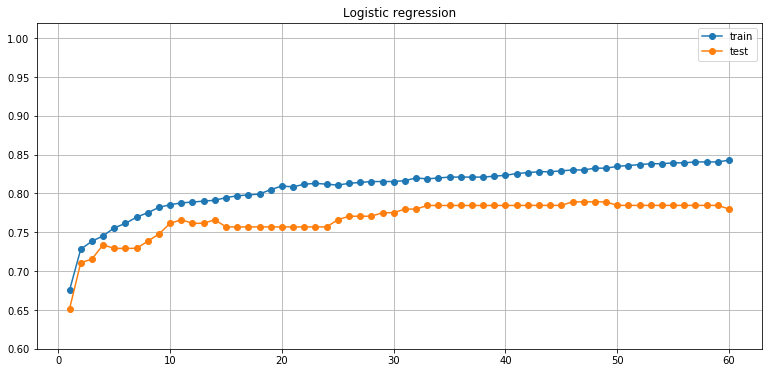

In [457]:
plot_fit_graph('Logistic regression', C_possibilities, train_scores, test_scores)

#### SVM: C parameter

In [458]:
# SVM
C_possibilities = np.arange(1, 61)
train_scores = []
test_scores = []
for C in C_possibilities:
    clf = LinearSVC(C=C, dual=False)
    scores = cross_validate(clf, X_train_best30, y_train, return_train_score=True)
    train_scores.append(scores['train_score'].mean())
    test_scores.append(scores['test_score'].mean())

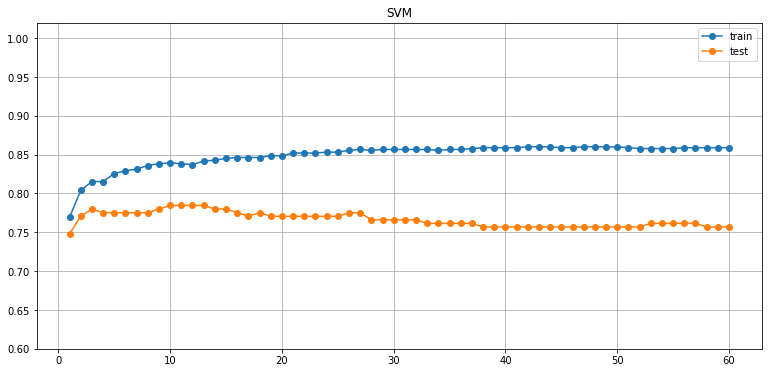

In [459]:
plot_fit_graph('SVM', C_possibilities, train_scores, test_scores)

#### MLP: hidden layer size

In [460]:
# MLP
hidden_layer_size_possibilities = np.arange(1, 200)
train_scores = []
test_scores = []
for n in hidden_layer_size_possibilities:
    clf = MLPClassifier(hidden_layer_sizes=(n,))
    scores = cross_validate(clf, X_train_best30, y_train, return_train_score=True)
    train_scores.append(scores['train_score'].mean())
    test_scores.append(scores['test_score'].mean())

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

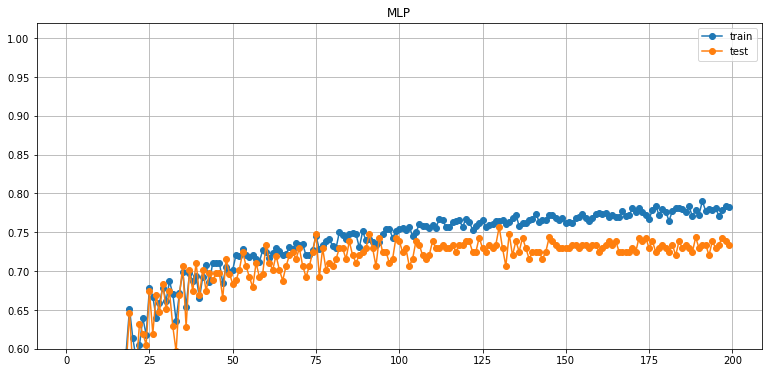

In [461]:
plot_fit_graph('MLP', hidden_layer_size_possibilities, train_scores, test_scores)

#### MLP (scaled data)

In [462]:
# MLP
hidden_layer_size_possibilities = np.arange(1, 200)
train_scores = []
test_scores = []
X_train_best30_minmax = MinMaxScaler().fit_transform(X_train_best30)
for n in hidden_layer_size_possibilities:
    clf = MLPClassifier(hidden_layer_sizes=(n,))
    scores = cross_validate(clf, X_train_best30_minmax, y_train, return_train_score=True)
    train_scores.append(scores['train_score'].mean())
    test_scores.append(scores['test_score'].mean())

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\miles\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, Conv

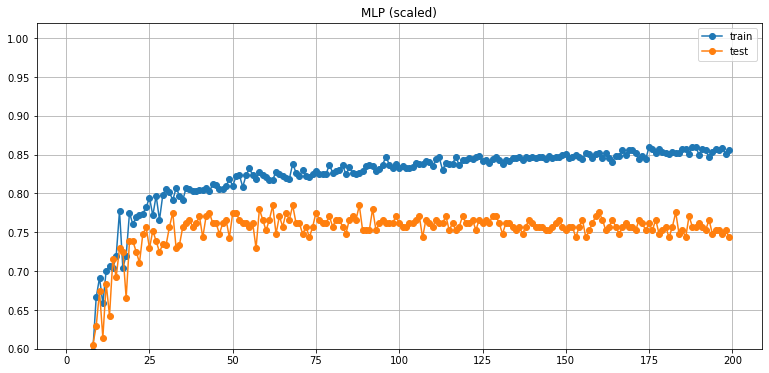

In [463]:
plot_fit_graph('MLP (scaled)', hidden_layer_size_possibilities, train_scores, test_scores)

#### SVM with C = 10 wins!
It's close between the best logistic regression and the best SVM model. SVM seems to be more common in the BCI literature so I'll favor that since the two have near-equal performance. With scaled data, the MLP is able to perform about as well using a hidden layer with ~60 neurons, but it's a much more complex model and since it's performance isn't actually _better_ we should favor the simpler linear approach.

## Find the best # of features to use

### Plot # of features vs. performance

In [464]:
X.shape[1]

572

In [465]:
n_features = X.shape[1]
n_features_possibilities = list(range(1, n_features + 1))
train_scores = []
test_scores = []
for k in n_features_possibilities:
    feature_selector = SelectKBest(score_func=chi2, k=k)
    feature_selector.fit(X_train_minmax, y_train)
    X_train_best_k = feature_selector.transform(X_train_trial_norm)
    X_train_best_k = pd.DataFrame(X_train_best_k, columns=X_train_minmax.columns[feature_selector.get_support()])
    clf = LinearSVC(C=10, dual=False)
    scores = cross_validate(clf, X_train_best_k, y_train, return_train_score=True)
    train_scores.append(scores['train_score'].mean())
    test_scores.append(scores['test_score'].mean())

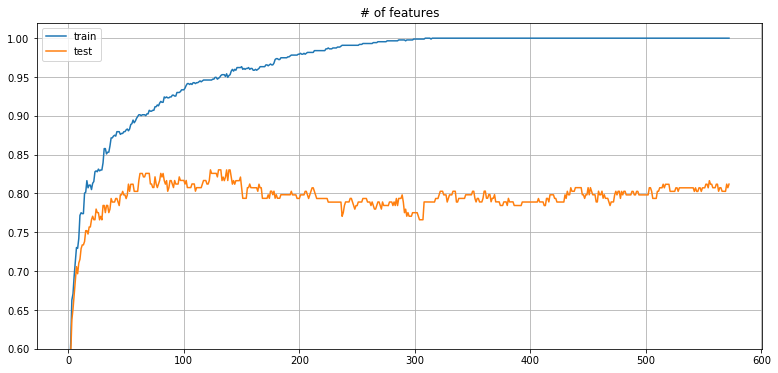

In [466]:
plot_fit_graph('# of features', n_features_possibilities, train_scores, test_scores, include_markers=False)

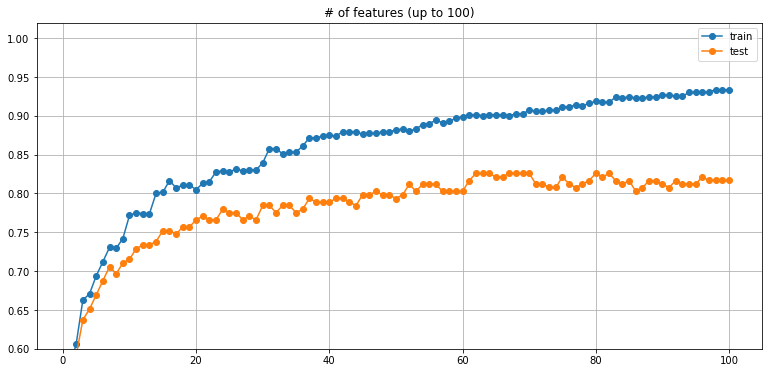

In [467]:
plot_fit_graph('# of features (up to 100)', n_features_possibilities[:100], train_scores[:100], test_scores[:100])

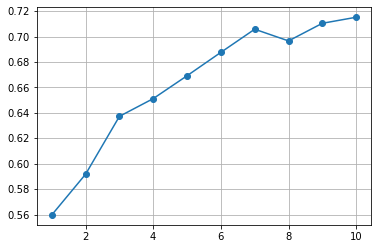

In [468]:
plt.plot(list(range(1, 11)), test_scores[:10], marker='o')
plt.grid()

Looks like the ideal # of features is **62**. But this model suffers from overfitting more than a model with fewer features.

### Try using principal components as features
The most useful features are likely highly correlated, so if we use principal components instead we may be able to capture more information using the same or even fewer features.

In [469]:
from sklearn.decomposition import PCA

In [470]:
X_train_minmax

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
0,0.287735,0.369685,0.202817,0.323305,0.251986,0.212283,0.373893,0.318819,0.025635,0.044302,...,0.100997,0.169424,0.255477,0.390956,0.486493,0.409663,0.330813,0.491255,0.421159,0.591180
1,0.316879,0.373198,0.393736,0.626896,0.312070,0.171457,0.423916,0.873738,0.877547,0.526832,...,0.126195,0.138341,0.162233,0.352690,0.375136,0.382490,0.295590,0.254347,0.154807,0.156126
2,0.324537,0.183159,0.219074,0.123528,0.191149,0.125499,0.192392,0.345491,0.366151,0.413807,...,0.133233,0.218189,0.296351,0.328208,0.574626,0.748200,0.426582,0.537015,0.514662,0.607153
3,0.092115,0.111642,0.176534,0.318248,0.251751,0.189374,0.114548,0.111425,0.176074,0.169295,...,0.237467,0.210861,0.073212,0.022555,0.151064,0.414581,0.358153,0.352493,0.399319,0.372603
4,0.279293,0.256594,0.244330,0.119932,0.085181,0.030599,0.023867,0.115177,0.229707,0.400455,...,0.095992,0.165433,0.160017,0.153482,0.055382,0.104226,0.051747,0.049689,0.076839,0.131679
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,0.152483,0.108545,0.216955,0.168478,0.217315,0.175986,0.154031,0.220307,0.202507,0.268004,...,0.064700,0.192477,0.361084,0.323580,0.426399,0.346298,0.090728,0.133619,0.177717,0.253603
214,0.239667,0.624387,0.836082,0.698174,0.330489,0.189760,0.067804,0.067380,0.149783,0.173204,...,0.103270,0.256725,0.229149,0.269165,0.434980,0.687821,0.768064,0.663896,0.337021,0.283858
215,0.226698,0.166310,0.136273,0.265253,0.251441,0.135897,0.077814,0.254673,0.332768,0.223832,...,0.073794,0.088594,0.184066,0.244121,0.330645,0.929736,0.843803,0.166603,0.130123,0.200313
216,0.217635,0.102235,0.146392,0.279384,0.177117,0.141540,0.005030,0.077203,0.234862,0.182423,...,0.203423,0.249161,0.189486,0.282461,0.532588,0.471868,0.234850,0.255158,0.134387,0.090325


In [471]:
pca = PCA()
pca.fit(X_train_minmax)

PCA()

#### Explained variance

In [472]:
pca.explained_variance_ratio_

array([1.49265923e-01, 4.38280262e-02, 3.66438983e-02, 3.42799657e-02,
       2.92529937e-02, 2.20909036e-02, 1.95488931e-02, 1.91008990e-02,
       1.65121628e-02, 1.53609940e-02, 1.37363402e-02, 1.36212251e-02,
       1.31183857e-02, 1.18959429e-02, 1.16045718e-02, 1.13778602e-02,
       1.03676780e-02, 1.00915485e-02, 9.98350550e-03, 9.80902298e-03,
       9.74018183e-03, 9.43897549e-03, 9.17804432e-03, 9.03463191e-03,
       8.93830125e-03, 8.49841850e-03, 8.33356029e-03, 8.06432987e-03,
       7.98295486e-03, 7.85935842e-03, 7.79475951e-03, 7.69774563e-03,
       7.58929216e-03, 7.38314871e-03, 7.17100721e-03, 6.91325697e-03,
       6.73581554e-03, 6.67540666e-03, 6.59700928e-03, 6.38274753e-03,
       6.20863053e-03, 6.08630314e-03, 5.96333909e-03, 5.78491291e-03,
       5.65054182e-03, 5.58812179e-03, 5.56703299e-03, 5.45842013e-03,
       5.33266666e-03, 5.23663327e-03, 5.13312139e-03, 5.07027053e-03,
       4.99844973e-03, 4.93214874e-03, 4.71823606e-03, 4.68722846e-03,
      

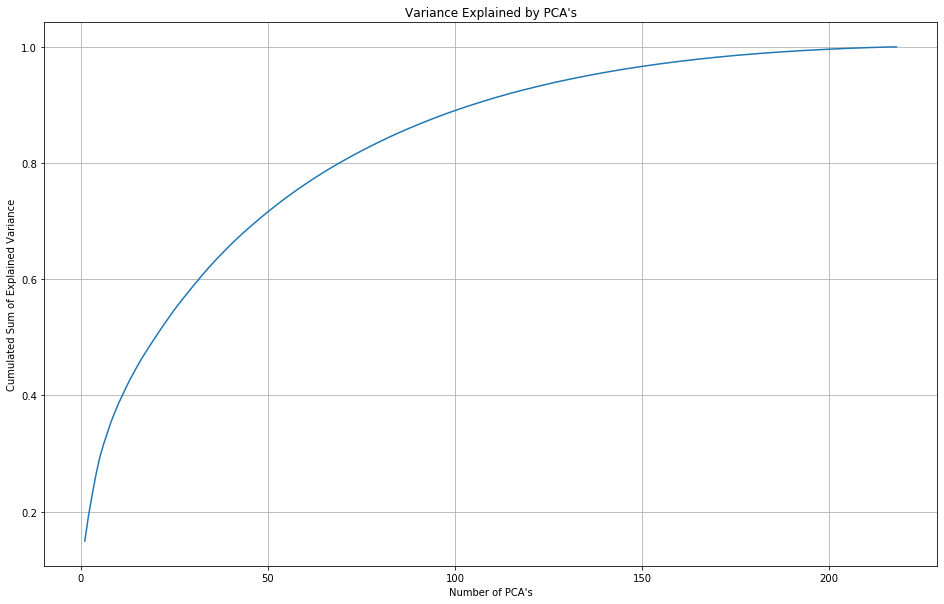

In [473]:
_, ax = plt.subplots(1, figsize=(16, 10))
ax.plot(list(range(1, len(pca.explained_variance_ratio_) + 1)), np.cumsum(pca.explained_variance_ratio_))
ax.set_xlabel("Number of PCA's")
ax.set_ylabel("Cumulated Sum of Explained Variance")
ax.set_title("Variance Explained by PCA's")
ax.grid()

#### Plot PC1 vs. PC2

In [475]:
X_train_pca = pca.transform(X_train_minmax)

In [477]:
X_train_pca = pd.DataFrame(X_train_pca)

In [478]:
X_train_pca

,0,1,2,3,4,5,6,7,8,9,...,208,209,210,211,212,213,214,215,216,217
0,-0.748308,0.034409,0.043429,0.716031,-0.249223,0.308591,-0.135895,-0.539693,0.664383,-0.282907,...,-0.000397,0.155828,0.013801,-0.054739,0.055456,-0.012497,0.002501,0.019384,-0.059956,6.036838e-16
1,2.809649,-1.431826,0.038166,-1.621334,-0.481892,-0.191983,-1.235539,2.230471,0.376683,-0.490878,...,0.004267,-0.045977,-0.039823,0.040591,-0.013799,-0.016353,-0.008896,-0.022257,-0.030891,4.128642e-16
2,1.063709,0.334362,-0.410106,0.048868,0.677050,-0.373865,-0.272214,-0.118778,0.257594,0.884258,...,0.010514,0.003627,-0.049464,0.027453,-0.046336,0.060515,0.038608,-0.039876,0.028964,5.342948e-16
3,-0.797580,0.495105,-0.031572,0.447368,-0.194893,0.719597,0.339991,0.362479,0.500579,-0.243459,...,0.052860,-0.128045,0.117516,0.085911,-0.143339,-0.048388,-0.002904,-0.007874,0.013849,5.689893e-16
4,-1.800214,0.488847,0.108660,-0.797915,-0.006071,-0.643294,-0.806750,-0.260650,-1.132129,0.560792,...,-0.076177,0.007237,-0.044734,-0.010710,-0.000987,-0.018162,0.007938,0.035682,-0.006623,3.417405e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,-1.815892,-0.361278,0.638418,0.604324,-0.551910,-0.740563,-0.516594,-0.219526,0.389506,0.207190,...,-0.154947,-0.059398,-0.087087,-0.057193,0.041335,-0.052068,0.069395,-0.090693,0.037967,4.302114e-16
214,-1.402234,-0.351544,-0.497131,0.068066,1.334094,0.317626,-0.212041,-0.392125,0.078151,-0.446683,...,0.022325,-0.009083,-0.045412,0.071919,0.022986,-0.044586,-0.009918,0.165769,0.029581,7.077672e-16
215,0.955948,-1.370283,0.223108,-0.335121,0.336490,-0.701850,0.766698,-0.328107,0.072919,0.117596,...,-0.034334,0.086942,-0.005347,-0.029897,0.065154,-0.016815,-0.009374,0.039099,-0.034203,4.579670e-16
216,-0.439263,-0.194487,-0.473327,0.428826,-0.573277,0.414107,0.248901,-0.567377,-0.283150,-0.191621,...,-0.021219,0.097866,-0.033192,0.059966,-0.026589,0.052568,0.094892,-0.009308,0.026878,6.036838e-16


In [481]:
remove_cue_prefix_from_labels = np.vectorize(lambda x: x[4:])

In [483]:
labels_no_cue = remove_cue_prefix_from_labels(label_encoder.inverse_transform(y_train))
labels_no_cue

array(['foot', 'tongue', 'tongue', 'right', 'left', 'left', 'foot',
       'foot', 'left', 'tongue', 'tongue', 'right', 'foot', 'tongue',
       'foot', 'foot', 'left', 'tongue', 'right', 'foot', 'right', 'foot',
       'tongue', 'right', 'tongue', 'right', 'foot', 'tongue', 'foot',
       'right', 'tongue', 'foot', 'right', 'left', 'left', 'tongue',
       'tongue', 'left', 'left', 'right', 'right', 'foot', 'right',
       'tongue', 'right', 'left', 'left', 'right', 'right', 'tongue',
       'foot', 'left', 'left', 'left', 'right', 'left', 'right', 'foot',
       'right', 'tongue', 'right', 'right', 'foot', 'foot', 'tongue',
       'left', 'right', 'left', 'right', 'foot', 'tongue', 'left',
       'right', 'left', 'tongue', 'tongue', 'left', 'tongue', 'left',
       'left', 'foot', 'right', 'right', 'right', 'left', 'left', 'right',
       'foot', 'foot', 'right', 'tongue', 'foot', 'right', 'right',
       'foot', 'tongue', 'foot', 'tongue', 'right', 'tongue', 'left',
       'left', '

In [484]:
X_train_pca['label'] = pd.Series(labels_no_cue)
X_train_pca

,0,1,2,3,4,5,6,7,8,9,...,209,210,211,212,213,214,215,216,217,label
0,-0.748308,0.034409,0.043429,0.716031,-0.249223,0.308591,-0.135895,-0.539693,0.664383,-0.282907,...,0.155828,0.013801,-0.054739,0.055456,-0.012497,0.002501,0.019384,-0.059956,6.036838e-16,foot
1,2.809649,-1.431826,0.038166,-1.621334,-0.481892,-0.191983,-1.235539,2.230471,0.376683,-0.490878,...,-0.045977,-0.039823,0.040591,-0.013799,-0.016353,-0.008896,-0.022257,-0.030891,4.128642e-16,tongue
2,1.063709,0.334362,-0.410106,0.048868,0.677050,-0.373865,-0.272214,-0.118778,0.257594,0.884258,...,0.003627,-0.049464,0.027453,-0.046336,0.060515,0.038608,-0.039876,0.028964,5.342948e-16,tongue
3,-0.797580,0.495105,-0.031572,0.447368,-0.194893,0.719597,0.339991,0.362479,0.500579,-0.243459,...,-0.128045,0.117516,0.085911,-0.143339,-0.048388,-0.002904,-0.007874,0.013849,5.689893e-16,right
4,-1.800214,0.488847,0.108660,-0.797915,-0.006071,-0.643294,-0.806750,-0.260650,-1.132129,0.560792,...,0.007237,-0.044734,-0.010710,-0.000987,-0.018162,0.007938,0.035682,-0.006623,3.417405e-16,left
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,-1.815892,-0.361278,0.638418,0.604324,-0.551910,-0.740563,-0.516594,-0.219526,0.389506,0.207190,...,-0.059398,-0.087087,-0.057193,0.041335,-0.052068,0.069395,-0.090693,0.037967,4.302114e-16,left
214,-1.402234,-0.351544,-0.497131,0.068066,1.334094,0.317626,-0.212041,-0.392125,0.078151,-0.446683,...,-0.009083,-0.045412,0.071919,0.022986,-0.044586,-0.009918,0.165769,0.029581,7.077672e-16,left
215,0.955948,-1.370283,0.223108,-0.335121,0.336490,-0.701850,0.766698,-0.328107,0.072919,0.117596,...,0.086942,-0.005347,-0.029897,0.065154,-0.016815,-0.009374,0.039099,-0.034203,4.579670e-16,tongue
216,-0.439263,-0.194487,-0.473327,0.428826,-0.573277,0.414107,0.248901,-0.567377,-0.283150,-0.191621,...,0.097866,-0.033192,0.059966,-0.026589,0.052568,0.094892,-0.009308,0.026878,6.036838e-16,foot


In [485]:
import seaborn as sns

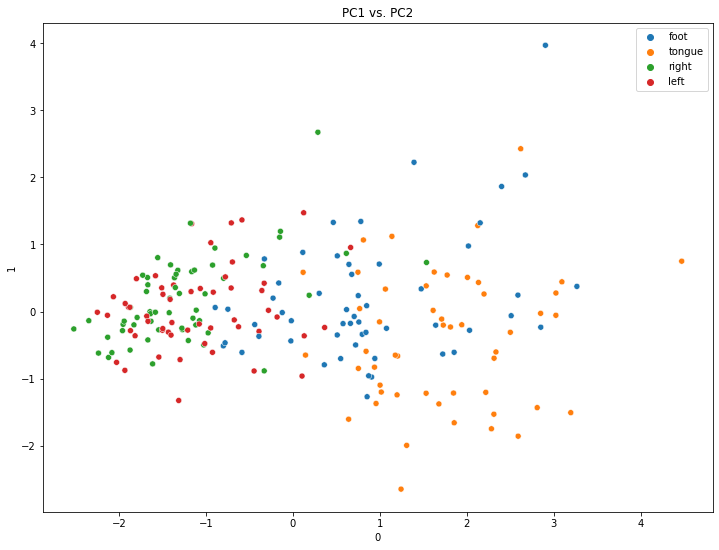

In [488]:
fig, ax = plt.subplots(1, figsize=(12, 9))
sns.scatterplot(x=0, y=1, hue='label', data=X_train_pca, ax=ax)
ax.set_title('PC1 vs. PC2')
ax.legend()

#### Try SVM model with different numbers of PCs

In [490]:
X_train_pca = X_train_pca.drop(columns=['label'])
X_train_pca

,0,1,2,3,4,5,6,7,8,9,...,208,209,210,211,212,213,214,215,216,217
0,-0.748308,0.034409,0.043429,0.716031,-0.249223,0.308591,-0.135895,-0.539693,0.664383,-0.282907,...,-0.000397,0.155828,0.013801,-0.054739,0.055456,-0.012497,0.002501,0.019384,-0.059956,6.036838e-16
1,2.809649,-1.431826,0.038166,-1.621334,-0.481892,-0.191983,-1.235539,2.230471,0.376683,-0.490878,...,0.004267,-0.045977,-0.039823,0.040591,-0.013799,-0.016353,-0.008896,-0.022257,-0.030891,4.128642e-16
2,1.063709,0.334362,-0.410106,0.048868,0.677050,-0.373865,-0.272214,-0.118778,0.257594,0.884258,...,0.010514,0.003627,-0.049464,0.027453,-0.046336,0.060515,0.038608,-0.039876,0.028964,5.342948e-16
3,-0.797580,0.495105,-0.031572,0.447368,-0.194893,0.719597,0.339991,0.362479,0.500579,-0.243459,...,0.052860,-0.128045,0.117516,0.085911,-0.143339,-0.048388,-0.002904,-0.007874,0.013849,5.689893e-16
4,-1.800214,0.488847,0.108660,-0.797915,-0.006071,-0.643294,-0.806750,-0.260650,-1.132129,0.560792,...,-0.076177,0.007237,-0.044734,-0.010710,-0.000987,-0.018162,0.007938,0.035682,-0.006623,3.417405e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,-1.815892,-0.361278,0.638418,0.604324,-0.551910,-0.740563,-0.516594,-0.219526,0.389506,0.207190,...,-0.154947,-0.059398,-0.087087,-0.057193,0.041335,-0.052068,0.069395,-0.090693,0.037967,4.302114e-16
214,-1.402234,-0.351544,-0.497131,0.068066,1.334094,0.317626,-0.212041,-0.392125,0.078151,-0.446683,...,0.022325,-0.009083,-0.045412,0.071919,0.022986,-0.044586,-0.009918,0.165769,0.029581,7.077672e-16
215,0.955948,-1.370283,0.223108,-0.335121,0.336490,-0.701850,0.766698,-0.328107,0.072919,0.117596,...,-0.034334,0.086942,-0.005347,-0.029897,0.065154,-0.016815,-0.009374,0.039099,-0.034203,4.579670e-16
216,-0.439263,-0.194487,-0.473327,0.428826,-0.573277,0.414107,0.248901,-0.567377,-0.283150,-0.191621,...,-0.021219,0.097866,-0.033192,0.059966,-0.026589,0.052568,0.094892,-0.009308,0.026878,6.036838e-16


In [494]:
n_pcs = X_train_pca.shape[1]
n_features_possibilities = list(range(1, n_pcs + 1))
train_scores = []
test_scores = []
for k in n_features_possibilities:
    feature_selector = SelectKBest(score_func=mutual_info_classif, k=k)
    feature_selector.fit(X_train_pca, y_train)
    X_train_best_k = feature_selector.transform(X_train_pca)
    X_train_best_k = pd.DataFrame(X_train_best_k, columns=X_train_pca.columns[feature_selector.get_support()])
    clf = LinearSVC(C=10, dual=False)
    scores = cross_validate(clf, X_train_best_k, y_train, return_train_score=True)
    train_scores.append(scores['train_score'].mean())
    test_scores.append(scores['test_score'].mean())

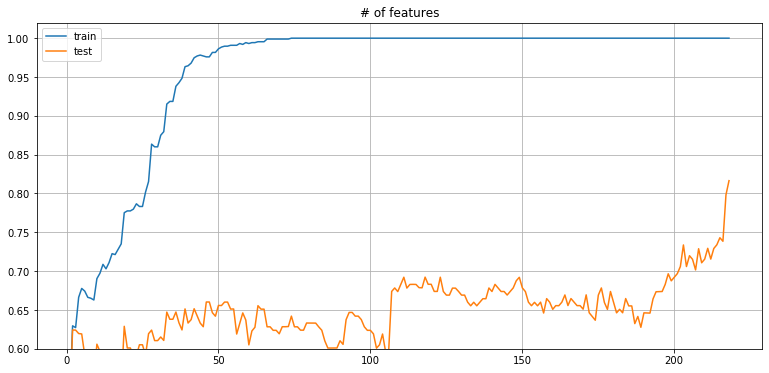

In [495]:
plot_fit_graph('# of features', n_features_possibilities, train_scores, test_scores, include_markers=False)

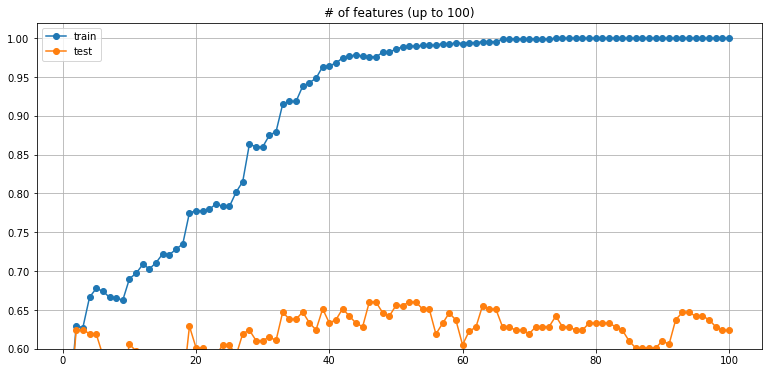

In [496]:
plot_fit_graph('# of features (up to 100)', n_features_possibilities[:100], train_scores[:100], test_scores[:100])

# Start-up code to run
Every time I start this notebook, I don't want to have to run the whole thing since the grid searches take a lot of time. So here I'll collect the minimal amount of code needed to read in the subject data.

In [21]:
import os
import numpy as np
import pandas as pd
import mne
from collections import OrderedDict
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, GridSearchCV, cross_validate
from sklearn.svm import LinearSVC
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.pipeline import Pipeline

In [3]:
DATA_DIR = 'BCICIV_2a_gdf'

def get_data_path(subject_no, test_or_train):
    data_type_code = 'T' if test_or_train == 'train' else 'E'
    return os.path.join(DATA_DIR, 'A0{}{}.gdf'.format(subject_no, data_type_code))

In [4]:
LAPLACIAN_NEIGHBORS = {
    'Fz': ['4'],
    '2': ['3', 'C3'],
    '3': ['2', '4', '9'],
    '4': ['Fz', '3', '5', 'Cz'],
    '5': ['4', '6', '11'],
    '6': ['5', 'C4'],
    '7': ['C3'],
    'C3': ['7', '2', '9', '14'],
    '9': ['C3', '3', 'Cz', '15'],
    'Cz': ['9', '4', '11', '16'],
    '11': ['Cz', '5', 'C4', '17'],
    'C4': ['11', '6', '13', '18'],
    '13': ['C4'],
    '14': ['C3', '15'],
    '15': ['14', '9', '16', '19'],
    '16': ['15', 'Cz', '17', 'Pz'],
    '17': ['16', '11', '18', '21'],
    '18': ['17', 'C4'],
    '19': ['15', 'Pz'],
    'Pz': ['19', '16', '21', '22'],
    '21': ['Pz', '17'],
    '22': ['Pz']
}

In [5]:
def spatial_filter_laplacian(raw):
    raw_arr = raw.get_data()
    transformed_timeseries = []
    for i in range(22):
        electrode_raw = raw_arr[i, :].copy()
        neighbors = LAPLACIAN_NEIGHBORS[raw.ch_names[i]]
        first_neighbor_idx = raw.ch_names.index(neighbors[0])
        neighboring_electrodes_avg = raw_arr[first_neighbor_idx, :].copy()
        for j in range(1, len(neighbors)):
            neighbor_idx = raw.ch_names.index(neighbors[j])
            neighboring_electrodes_avg += raw_arr[neighbor_idx, :].copy()
        neighboring_electrodes_avg /= len(neighbors)
        electrode_transformed = electrode_raw - neighboring_electrodes_avg
        transformed_timeseries.append(electrode_transformed)
    raw_filtered_arr = np.asarray(transformed_timeseries)
    raw_filtered_arr_with_eog = np.concatenate((raw_filtered_arr, raw_arr[22:, :]))
    raw_filtered = mne.io.RawArray(raw_filtered_arr_with_eog, raw.info)
    return raw_filtered

In [6]:
def bin_power_spectrum_1hz(psd, freqs):
    freqs_1hz_inc = list(range(4, 30))
    psds_binned_1hz = []
    curr_bin_freq = 4
    curr_bin_sum = 0
    curr_bin_size = 0
    for f in range(len(freqs)):
        if int(freqs[f]) > curr_bin_freq:
            psds_binned_1hz.append(curr_bin_sum / curr_bin_size)
            curr_bin_sum = 0
            curr_bin_size = 0
            curr_bin_freq += 1
        curr_bin_sum += psd[f]
        curr_bin_size += 1
    psds_binned_1hz.append(curr_bin_sum / curr_bin_size)

    return freqs_1hz_inc, psds_binned_1hz

In [15]:
def create_frequency_domain_features(epoch_data, info, normalize_band_power_within_trials=False):
    psds, freqs = mne.time_frequency.psd_array_multitaper(epoch_data, info['sfreq'], fmax=30, verbose=False)
    num_electrodes = len(psds)
    features_dict = {}
    for j in range(num_electrodes):
        freqs_binned, psd_binned = bin_power_spectrum_1hz(psds[j], freqs)
        if normalize_band_power_within_trials:
            psd_binned /= sum(psd_binned)
        for k in range(len(freqs_binned)):
            ch_name = info.ch_names[j]
            freq_bin_str = str(freqs_binned[k]) + 'Hz'
            band_power = psd_binned[k]
            feature_name = '{}_{}'.format(ch_name, freq_bin_str)
            features_dict[feature_name] = band_power
    return features_dict

In [11]:
def create_study_montage():
    montage_10_20 = mne.channels.make_standard_montage('standard_1020')
    data_10_20 = montage_10_20.get_positions()
    channels_used = 'Fz FC3 FC1 FCz FC2 FC4 C5 C3 C1 Cz C2 C4 C6 CP3 CP1 CPz CP2 CP4 P1 Pz P2 POz'
    ch_pos_filtered = OrderedDict()
    for ch in channels_used.split():
        ch_pos_filtered[ch] = data_10_20['ch_pos'][ch]
    study_montage = mne.channels.make_dig_montage(
        ch_pos=ch_pos_filtered, nasion=data_10_20['nasion'], lpa=data_10_20['lpa'], rpa=data_10_20['rpa'])
    study_montage.rename_channels({
        'FC3': '2', 'FC1': '3', 'FCz': '4', 'FC2': '5', 'FC4': '6',
        'C5': '7', 'C1': '9', 'C2': '11', 'C6': '13',
        'CP3': '14', 'CP1': '15', 'CPz': '16', 'CP2': '17', 'CP4': '18',
        'P1': '19', 'P2': '21',
        'POz': '22'
    })
    return study_montage

In [13]:
def prepare_subject_data(subject_no, train_or_test='train', baseline_normalize=False, 
                         regress_eog_artifacts=True, normalize_band_power_within_trials=True):
    # 1. Read file into an mne.Raw structure
    raw = mne.io.read_raw_gdf(
        get_data_path(subject_no, train_or_test), eog=['EOG-left', 'EOG-central', 'EOG-right'], preload=True
    )

    # 2. Rename annotations from numeric codes to readable descriptions
    raw.annotations.rename({
        '276': 'idle_eyes_open',
        '277': 'idle_eyes_closed',
        '768': 'trial_start',
        '769': 'cue_left',
        '770': 'cue_right',
        '771': 'cue_foot',
        '772': 'cue_tongue',
        # '783': 'cue_unknown',
        '1023': 'trial_rejected',
        '1072': 'idle_eye_movements',
        '32766': 'run_start'
    }).rename({'3idle_eyes_open6': 'run_start'});

    # 3. Rename EEG channels to match diagram from dataset description
    raw.rename_channels({
        'EEG-0': '2', 'EEG-1': '3', 'EEG-2': '4', 'EEG-3': '5', 'EEG-4': '6', 
        'EEG-5': '7', 'EEG-6': '9', 'EEG-7': '11', 'EEG-8': '13', 'EEG-9': '14',
        'EEG-10': '15', 'EEG-11': '16', 'EEG-12': '17', 'EEG-13': '18', 'EEG-14': '19',
        'EEG-15': '21', 'EEG-16': '22', 'EEG-Fz': 'Fz', 'EEG-C3': 'C3', 'EEG-Cz': 'Cz',
        'EEG-C4': 'C4', 'EEG-Pz': 'Pz'
    })

    # 4. Extract annotations into events, then remove annotations from Raw instance
    events, event_id = mne.events_from_annotations(raw)
    raw.set_annotations(None)
    event_id_inv = {v: k for k, v in event_id.items()}
    
    # 5. Apply bandpass filter
    raw.filter(4, 30, picks=['eeg'])
    
    # 6. Apply spatial filter (Laplacian Hjorth estimate)
    raw = spatial_filter_laplacian(raw)

    # 7. Epoch data (mne.Raw -> mne.Epochs)
    cue_event_ids = {e_id for e_name, e_id in event_id.items() if e_name.startswith('cue')}
    cue_events = np.array([event for event in events if event[2] in cue_event_ids])
    trial_event_id = {e_name: e_id for e_name, e_id in event_id.items() if e_name.startswith('cue')}
    baseline = (None, 0) if baseline_normalize else None
    epochs = mne.Epochs(raw, cue_events, event_id=trial_event_id, tmin=-2., tmax=4, baseline=baseline, preload=True)

    # 8. Regress EOG artifacts
    if regress_eog_artifacts:
        mne.preprocessing.regress_artifact(epochs, copy=False)
    epochs.drop_channels(['EOG-left', 'EOG-central', 'EOG-right'])
    
    # 9. Set channel montage
    study_montage = create_study_montage()
    epochs.set_montage(study_montage)

    # 10. Remove trials marked as bad
    trial_rejected_events = events[events[:, 2] == event_id['trial_rejected']]
    rejected_epoch_start_sample_numbers = set(trial_rejected_events[:, 0])
    epoch_start_sample_numbers = events[events[:, 2] == event_id['trial_start']][:, 0]
    rejected_epoch_indices = [i for i in range(len(epoch_start_sample_numbers)) if epoch_start_sample_numbers[i] in rejected_epoch_start_sample_numbers]
    epochs.drop(rejected_epoch_indices)
    
    # 11. Split into X and y arrays
    X = epochs.get_data(picks=['eeg'], tmin=.5)
    y = [event_id_inv[epochs.events[i][2]] for i in range(len(epochs))]
    
    # 12. Fit a LabelEncoder
    label_encoder = LabelEncoder()
    y = label_encoder.fit_transform(y)
    
    # 13. Transform into frequency domain features
    X = pd.DataFrame([create_frequency_domain_features(
        epoch_data, epochs.info, normalize_band_power_within_trials) for epoch_data in X])

    # 12. Split into train and test sets
#     X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    return epochs, cue_events, label_encoder, X, y

In [16]:
epochs, events, label_encoder, X, y = prepare_subject_data(1, normalize_band_power_within_trials=True)

Extracting EDF parameters from C:\Users\miles\Documents\eeg-ml\bci-competition-iv-2a\BCICIV_2a_gdf\A01T.gdf...
GDF file detected
Setting channel info structure...
Could not determine channel type of the following channels, they will be set as EEG:
EEG-Fz, EEG, EEG, EEG, EEG, EEG, EEG, EEG-C3, EEG, EEG-Cz, EEG, EEG-C4, EEG, EEG, EEG, EEG, EEG, EEG, EEG, EEG-Pz, EEG, EEG
Creating raw.info structure...
Reading 0 ... 672527  =      0.000 ...  2690.108 secs...


C:\Users\miles\Anaconda3\lib\site-packages\mne\io\edf\edf.py:1123: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  etmode = np.fromstring(etmode, UINT8).tolist()[0]
C:\Users\miles\Anaconda3\lib\contextlib.py:119: RuntimeWarning: Channel names are not unique, found duplicates for: {'EEG'}. Applying running numbers for duplicates.
  next(self.gen)


Used Annotations descriptions: ['cue_foot', 'cue_left', 'cue_right', 'cue_tongue', 'idle_eye_movements', 'idle_eyes_closed', 'idle_eyes_open', 'run_start', 'trial_rejected', 'trial_start']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 413 samples (1.652 sec)

Creating RawArray with float64 data, n_channels=25, n_times=672528
    Range : 0 ... 672527 =      0.000 ...  2690.108 secs
Ready.
Not setting metadata
288 matching events found
No baseline correction applied
0 projection items activated
Using data 

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [20]:
X_train

,Fz_4Hz,Fz_5Hz,Fz_6Hz,Fz_7Hz,Fz_8Hz,Fz_9Hz,Fz_10Hz,Fz_11Hz,Fz_12Hz,Fz_13Hz,...,22_20Hz,22_21Hz,22_22Hz,22_23Hz,22_24Hz,22_25Hz,22_26Hz,22_27Hz,22_28Hz,22_29Hz
33,0.057505,0.191364,0.091203,0.092259,0.082700,0.064554,0.070550,0.041798,0.010694,0.008533,...,0.020297,0.019191,0.020473,0.027407,0.024194,0.017819,0.016218,0.016370,0.014144,0.016427
186,0.046069,0.144100,0.117718,0.114074,0.073713,0.041618,0.058388,0.072435,0.056136,0.028523,...,0.019628,0.014168,0.012530,0.020746,0.016124,0.013969,0.012423,0.008449,0.005666,0.005140
144,0.072471,0.131979,0.111887,0.060682,0.076902,0.052805,0.049744,0.051349,0.042102,0.036074,...,0.014927,0.013632,0.013835,0.014249,0.016943,0.018114,0.011863,0.010647,0.010130,0.010186
199,0.040419,0.115114,0.111585,0.124065,0.112351,0.081002,0.042509,0.028817,0.030005,0.022037,...,0.032261,0.018376,0.008357,0.003750,0.008277,0.015036,0.014352,0.010655,0.011318,0.009433
37,0.063260,0.162461,0.118665,0.058209,0.043215,0.028199,0.019696,0.024232,0.029352,0.034160,...,0.021789,0.021007,0.016640,0.014025,0.006472,0.007701,0.007166,0.005390,0.005214,0.006246
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,0.046320,0.100849,0.116237,0.074335,0.088895,0.068537,0.045046,0.038714,0.029108,0.026934,...,0.018552,0.024951,0.031915,0.027917,0.026016,0.018713,0.009402,0.008470,0.008976,0.010212
71,0.038308,0.224251,0.235194,0.126091,0.078247,0.045098,0.018282,0.012714,0.015179,0.012433,...,0.018904,0.023021,0.017397,0.018196,0.020186,0.025443,0.028919,0.019151,0.010860,0.008444
106,0.060198,0.132224,0.083927,0.099486,0.101757,0.059122,0.031681,0.043665,0.041808,0.024107,...,0.017030,0.014046,0.016746,0.018692,0.017958,0.037183,0.034951,0.008086,0.006300,0.007405
270,0.058739,0.099786,0.088451,0.103174,0.077631,0.060765,0.018131,0.021983,0.032753,0.021019,...,0.034458,0.024880,0.016887,0.020911,0.026479,0.020281,0.013019,0.010339,0.006352,0.004711


In [31]:
clf = Pipeline([
    ('feature_selector', SelectKBest(score_func=chi2, k=40)), 
    ('classifier', LinearSVC(C=10, dual=False))
])

In [32]:
cv_results = cross_validate(clf, X_train, y_train, return_train_score=True)
cv_results

{'fit_time': array([0.01563692, 0.01562643, 0.015625  , 0.0156281 , 0.00651765]),
 'score_time': array([0.        , 0.        , 0.        , 0.        , 0.01563978]),
 'test_score': array([0.86363636, 0.70454545, 0.75      , 0.79069767, 0.88372093]),
 'train_score': array([0.86206897, 0.86781609, 0.8908046 , 0.89714286, 0.88      ])}

In [33]:
cv_results['train_score'].mean()

0.8795665024630542

In [34]:
cv_results['test_score'].mean()

0.7985200845665963